# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

  0% 0.00/255k [00:00<?, ?B/s]
100% 255k/255k [00:00<00:00, 113MB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

  0% 0.00/66.1k [00:00<?, ?B/s]
100% 66.1k/66.1k [00:00<00:00, 76.5MB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [00:09<00:00, 110MB/s]
100% 1.09G/1.09G [00:09<00:00, 119MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 1.9 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ViTConfig, ViTModel, ViTFeatureExtractor
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 13.7 MB/s eta 0:00:00


In [ ]:
import timm

In [ ]:
from transformers import ResNetConfig, ResNetModel
from transformers import AutoImageProcessor, ConvNextImageProcessor, ConvNextModel

In [ ]:
from torchsummary import summary
import torch.nn.functional as F

In [ ]:
import torchvision.models as models

In [ ]:
from scipy.stats import spearmanr

# Preprocess & Split

In [ ]:
df_vehicle = pd.read_csv("/content/vehicle.csv")
df_vehicle["image_file"] =df_vehicle["image_file"].apply(lambda file: "/content/vehicle" +"/"+ file) # Create image path
df_vehicle["memorability_wo_fa_correction"] = df_vehicle["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_vehicle.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,8001,/content/vehicle/000000002258.jpg,vehicle,airplane,480.0,640.0,coco,airplane,1.0,68,1,99,0.686869,0.676768
1,8002,/content/vehicle/000000003035.jpg,vehicle,airplane,425.0,640.0,coco,truck,1.0,72,3,96,0.750000,0.718750
2,8003,/content/vehicle/000000025559.jpg,vehicle,airplane,480.0,640.0,coco,airplane,1.0,78,1,108,0.722222,0.712963
3,8004,/content/vehicle/000000032093.jpg,vehicle,airplane,427.0,640.0,coco,airplane,1.0,67,3,107,0.626168,0.598131
4,8005,/content/vehicle/000000035485.jpg,vehicle,airplane,360.0,640.0,coco,airplane,1.0,96,12,120,0.800000,0.700000


Image shape: (2000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 118.69407742081208
Standard deviation of pixel values: 70.280178979011


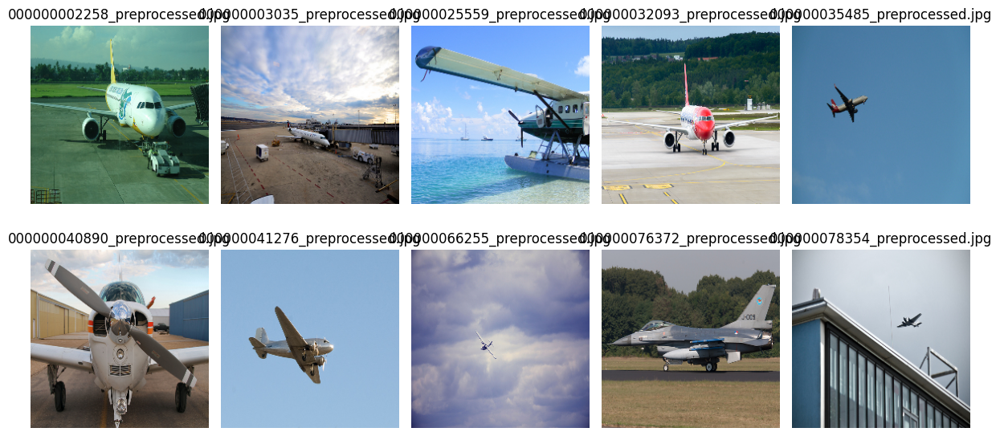

In [ ]:
# Sample data (replace this with your DataFrame)
df_vehicle= pd.DataFrame({
    'image_file': df_vehicle["image_file"],
    'memoscore': df_vehicle["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_vehicle['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_vehicle.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_vehicle.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_vehicle.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_vehicle.head()

,image_file,memoscore,preprocessed_image_path
0,/content/vehicle/000000002258.jpg,0.686869,/content/vehicle/000000002258_preprocessed.jpg
1,/content/vehicle/000000003035.jpg,0.750000,/content/vehicle/000000003035_preprocessed.jpg
2,/content/vehicle/000000025559.jpg,0.722222,/content/vehicle/000000025559_preprocessed.jpg
3,/content/vehicle/000000032093.jpg,0.626168,/content/vehicle/000000032093_preprocessed.jpg
4,/content/vehicle/000000035485.jpg,0.800000,/content/vehicle/000000035485_preprocessed.jpg


In [ ]:
del df_vehicle["image_file"]

In [ ]:
df_vehicle.head()

,memoscore,preprocessed_image_path
0,0.686869,/content/vehicle/000000002258_preprocessed.jpg
1,0.750000,/content/vehicle/000000003035_preprocessed.jpg
2,0.722222,/content/vehicle/000000025559_preprocessed.jpg
3,0.626168,/content/vehicle/000000032093_preprocessed.jpg
4,0.800000,/content/vehicle/000000035485_preprocessed.jpg


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_vehicle.drop('memoscore', axis=1)), pd.DataFrame(df_vehicle['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 1800
Validation set size: 100
Test set size: 100


In [ ]:
X_train.head()

,preprocessed_image_path
453,/content/vehicle/000000377572_preprocessed.jpg
637,/content/vehicle/n02878222_51618_preprocessed.jpg
313,/content/vehicle/n04231693_6347_preprocessed.jpg
1302,/content/vehicle/n04349306_7700_preprocessed.jpg
860,/content/vehicle/n03670208_12615_preprocessed.jpg


In [ ]:
merged_train_vehicle= pd.concat([X_train, y_train], axis=1)
merged_train_vehicle

,preprocessed_image_path,memoscore
453,/content/vehicle/000000377572_preprocessed.jpg,0.587719
637,/content/vehicle/n02878222_51618_preprocessed.jpg,0.649485
313,/content/vehicle/n04231693_6347_preprocessed.jpg,0.681818
1302,/content/vehicle/n04349306_7700_preprocessed.jpg,0.851852
860,/content/vehicle/n03670208_12615_preprocessed.jpg,0.883495
...,...,...
85,/content/vehicle/n02691156_4134_preprocessed.jpg,0.673913
100,/content/vehicle/000000012876_preprocessed.jpg,0.838095
784,/content/vehicle/n03541923_2423_preprocessed.jpg,0.855769
1404,/content/vehicle/n03594945_6810_preprocessed.jpg,0.712871


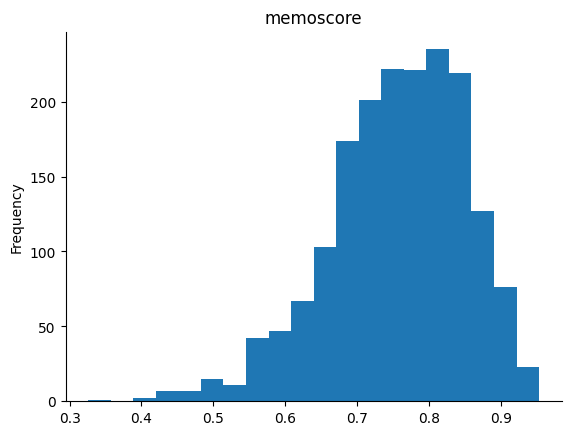

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_train_vehicle['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_val_vehicle = pd.concat([X_val, y_val], axis=1)
merged_val_vehicle

,preprocessed_image_path,memoscore
1260,/content/vehicle/n04349306_2956_preprocessed.jpg,0.795699
836,/content/vehicle/n03541923_628_preprocessed.jpg,0.833333
853,/content/vehicle/n03670208_1086_preprocessed.jpg,0.905263
1733,/content/vehicle/n04335435_13812_preprocessed.jpg,0.728155
786,/content/vehicle/n03541923_2456_preprocessed.jpg,0.810000
...,...,...
24,/content/vehicle/000000166086_preprocessed.jpg,0.752000
564,/content/vehicle/n02878222_13661_preprocessed.jpg,0.685714
402,/content/vehicle/n04166281_1290_preprocessed.jpg,0.825243
1505,/content/vehicle/n04461696_6970_preprocessed.jpg,0.736000


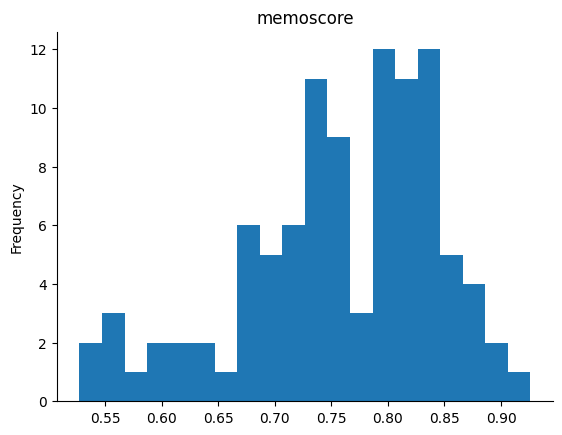

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_val_vehicle['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_test_vehicle = pd.concat([X_test, y_test], axis=1)
merged_test_vehicle

,preprocessed_image_path,memoscore
1629,/content/vehicle/000000080203_preprocessed.jpg,0.852941
887,/content/vehicle/n03670208_285_preprocessed.jpg,0.870968
137,/content/vehicle/n02834778_12224_preprocessed.jpg,0.864078
1046,/content/vehicle/n02932891_110_preprocessed.jpg,0.710280
23,/content/vehicle/000000164487_preprocessed.jpg,0.686869
...,...,...
1363,/content/vehicle/n03594945_18118_preprocessed.jpg,0.758242
1819,/content/vehicle/000000303016_preprocessed.jpg,0.723810
1319,/content/vehicle/n04349306_9235_preprocessed.jpg,0.857143
1075,/content/vehicle/n02932891_3159_preprocessed.jpg,0.571429


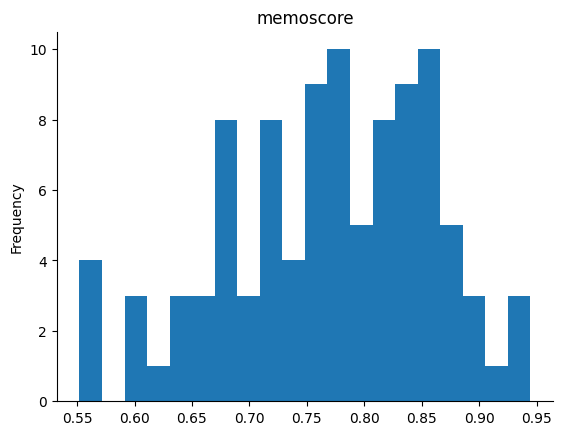

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_test_vehicle['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_vehicle = '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/vehicle_Vit+Res.csv'
merged_train_vehicle.to_csv(csv_train_vehicle, index=False)

In [ ]:
csv_val_vehicle = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/vehicle_Vit+Res.csv'
merged_val_vehicle.to_csv(csv_val_vehicle, index=False)

In [ ]:
csv_test_vehicle = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/vehicle_Vit+Res.csv'
merged_test_vehicle.to_csv(csv_test_vehicle, index=False)

#Load Dataset

In [ ]:
df_train_vehicle = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/vehicle_Vit+Res.csv")
df_val_vehicle = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/vehicle_Vit+Res.csv')
df_test_vehicle = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/vehicle_Vit+Res.csv')

In [ ]:
df_train_vehicle.head()

,preprocessed_image_path,memoscore
0,/content/vehicle/000000377572_preprocessed.jpg,0.587719
1,/content/vehicle/n02878222_51618_preprocessed.jpg,0.649485
2,/content/vehicle/n04231693_6347_preprocessed.jpg,0.681818
3,/content/vehicle/n04349306_7700_preprocessed.jpg,0.851852
4,/content/vehicle/n03670208_12615_preprocessed.jpg,0.883495


In [ ]:
df_train_vehicle.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  1800 non-null   object 
 1   memoscore                1800 non-null   float64
dtypes: float64(1), object(1)
memory usage: 28.2+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_vehicle(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_vehicle(df_train_vehicle, trans_transform=trans_transform, res_transform=res_transform)
train_dl = DataLoader(train_ds, batch_size=16, shuffle= False)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 179MB/s]


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

In [ ]:
print(trans_layer_norm )

LayerNorm((768,), eps=1e-12, elementwise_affine=True)


In [ ]:
print(layers_trans)

[ViTEmbeddings(
  (patch_embeddings): ViTPatchEmbeddings(
    (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
  )
  (dropout): Dropout(p=0.0, inplace=False)
), ViTEncoder(
  (layer): ModuleList(
    (0-11): 12 x ViTLayer(
      (attention): ViTAttention(
        (attention): ViTSelfAttention(
          (query): Linear(in_features=768, out_features=768, bias=True)
          (key): Linear(in_features=768, out_features=768, bias=True)
          (value): Linear(in_features=768, out_features=768, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
        (output): ViTSelfOutput(
          (dense): Linear(in_features=768, out_features=768, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
      )
      (intermediate): ViTIntermediate(
        (dense): Linear(in_features=768, out_features=3072, bias=True)
        (intermediate_act_fn): GELUActivation()
      )
      (output): ViTOutput(
        (dense): Linear(in_features=3072, ou

In [ ]:
# Merge the two models
class model_merge_vehicle(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model = model_merge_vehicle(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model = to_device(model, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)



 Epoch: (1/50) Loss = 0.0413346141576767

 Epoch: (1/50) Loss_rmse = 0.20330916345119476

 Epoch: (1/50) R^2 = -7.627902984619141

 Epoch: (1/50) MAE = 0.18906885385513306

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6990291

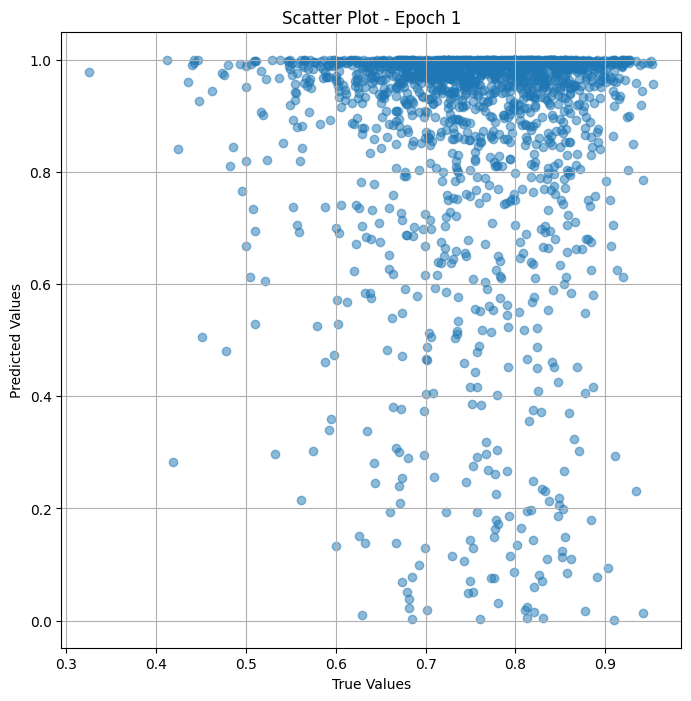


 Epoch: (2/50) Loss = 0.027127427980303764

 Epoch: (2/50) Loss_rmse = 0.16470405459403992

 Epoch: (2/50) R^2 = -4.662392616271973

 Epoch: (2/50) MAE = 0.14240089058876038

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.69902

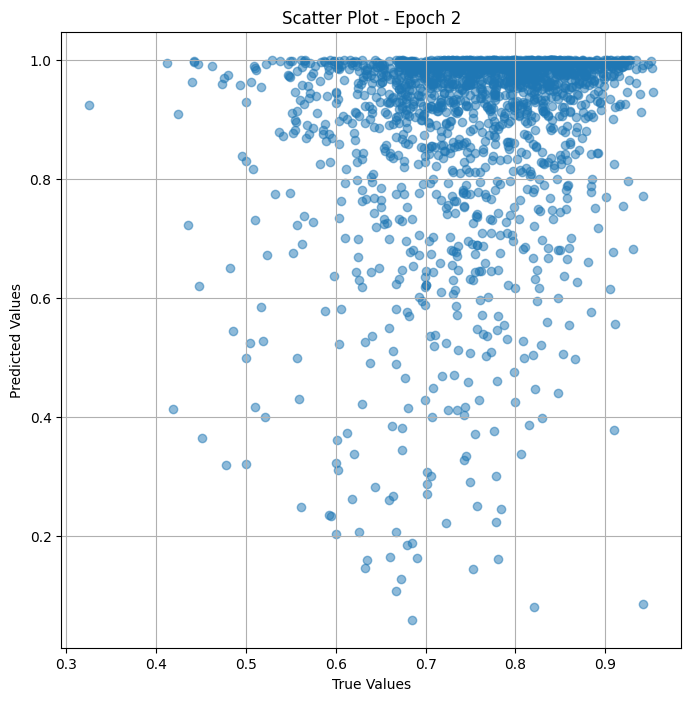


 Epoch: (3/50) Loss = 0.017794940620660782

 Epoch: (3/50) Loss_rmse = 0.1333976835012436

 Epoch: (3/50) R^2 = -2.714393377304077

 Epoch: (3/50) MAE = 0.10607170313596725

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.699029

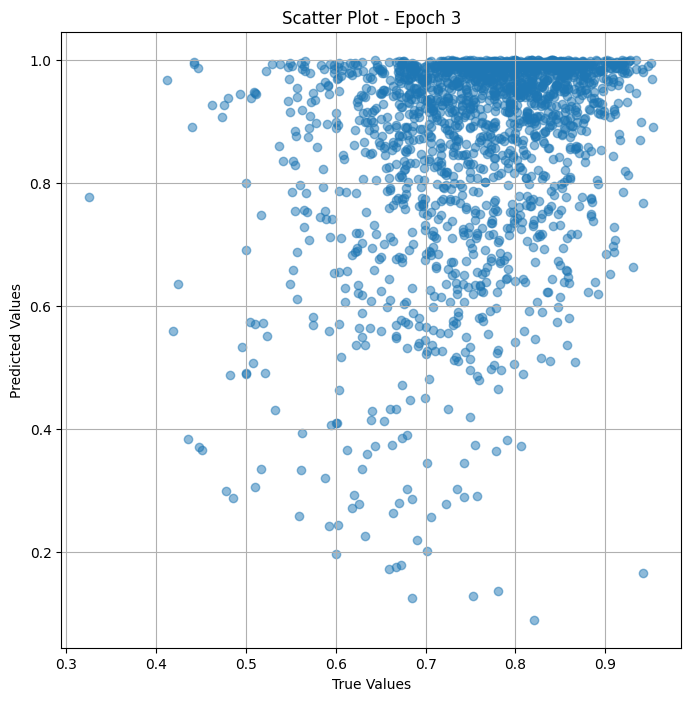


 Epoch: (4/50) Loss = 0.015017429366707802

 Epoch: (4/50) Loss_rmse = 0.12254562228918076

 Epoch: (4/50) R^2 = -2.1346347332000732

 Epoch: (4/50) MAE = 0.09979505836963654

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6990

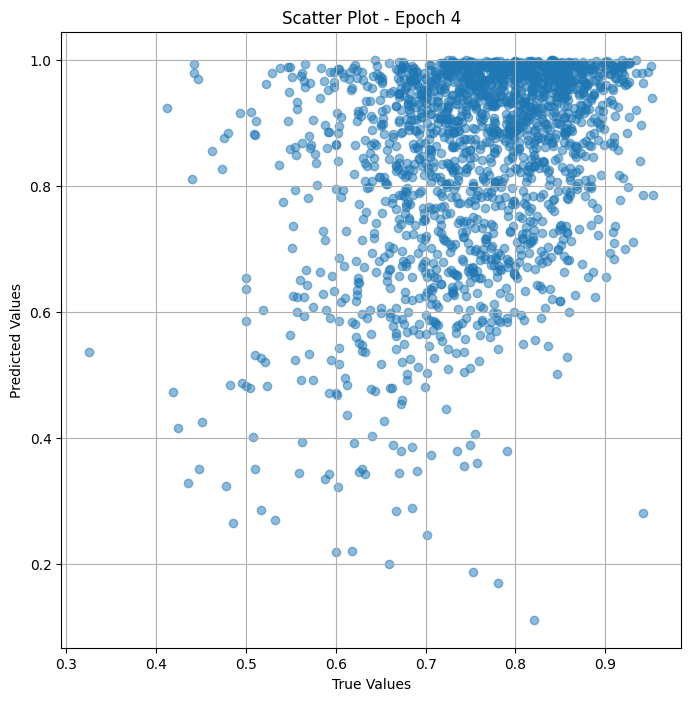


 Epoch: (5/50) Loss = 0.013949105516076088

 Epoch: (5/50) Loss_rmse = 0.11810632795095444

 Epoch: (5/50) R^2 = -1.9116401672363281

 Epoch: (5/50) MAE = 0.09688936918973923

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6990

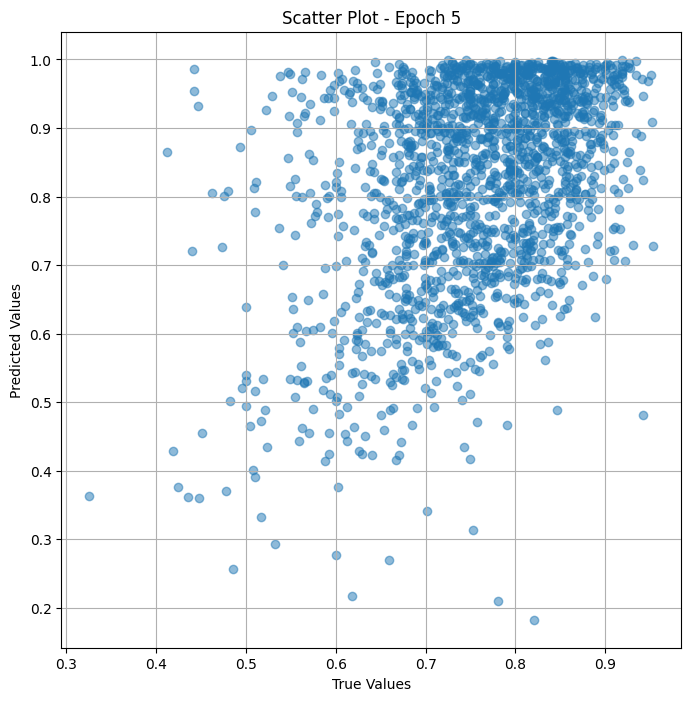


 Epoch: (6/50) Loss = 0.012359636835753918

 Epoch: (6/50) Loss_rmse = 0.11117390543222427

 Epoch: (6/50) R^2 = -1.5798654556274414

 Epoch: (6/50) MAE = 0.08621066063642502

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6990

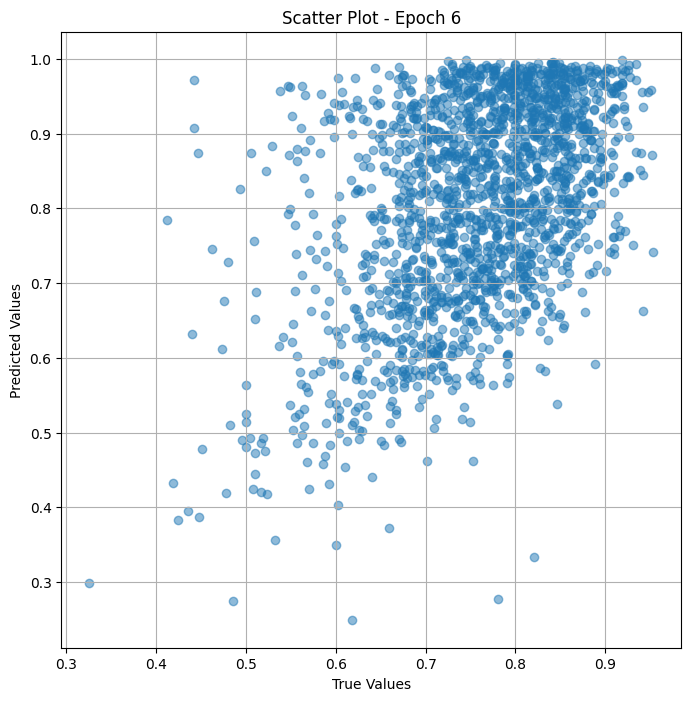


 Epoch: (7/50) Loss = 0.011083110235631466

 Epoch: (7/50) Loss_rmse = 0.10527635365724564

 Epoch: (7/50) R^2 = -1.3134121894836426

 Epoch: (7/50) MAE = 0.08149375021457672

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6990

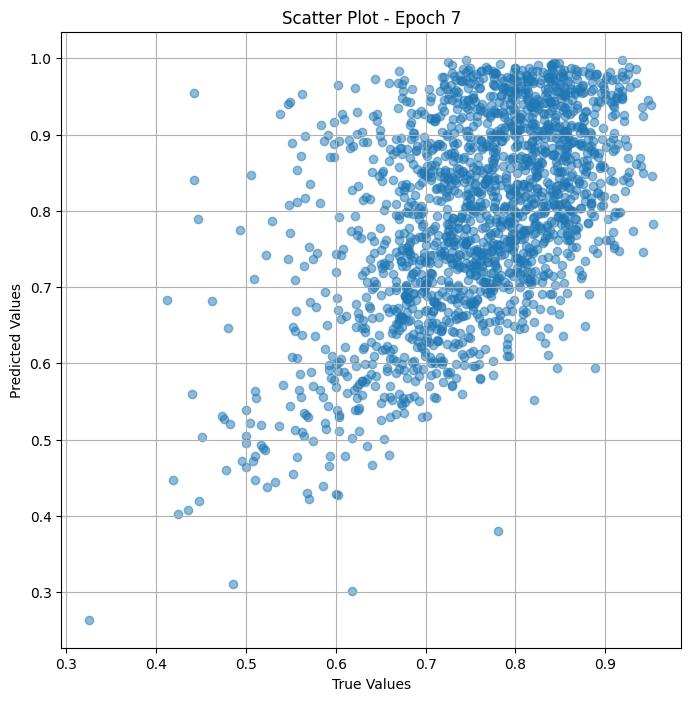


 Epoch: (8/50) Loss = 0.009848264046013355

 Epoch: (8/50) Loss_rmse = 0.09923841804265976

 Epoch: (8/50) R^2 = -1.0556588172912598

 Epoch: (8/50) MAE = 0.07629482448101044

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6990

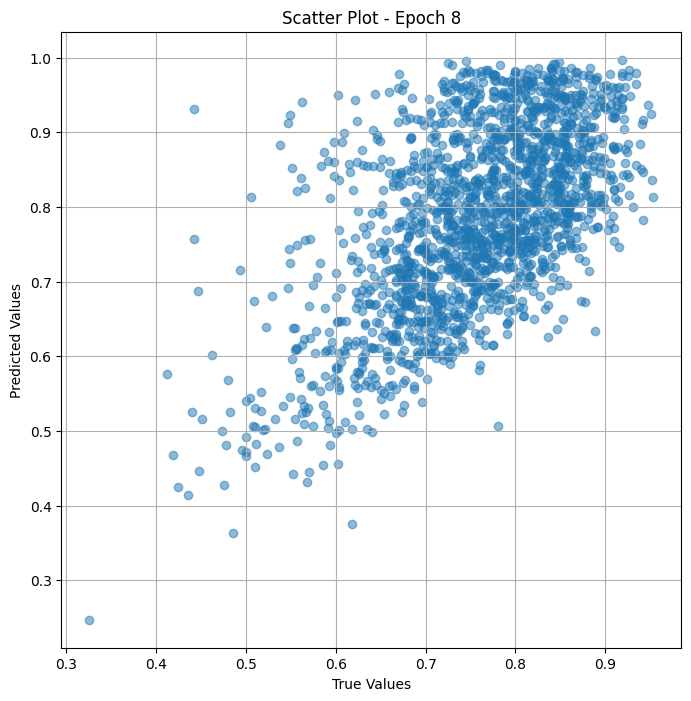


 Epoch: (9/50) Loss = 0.008331692777574062

 Epoch: (9/50) Loss_rmse = 0.09127810597419739

 Epoch: (9/50) R^2 = -0.7391002178192139

 Epoch: (9/50) MAE = 0.0694059506058693

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.69902

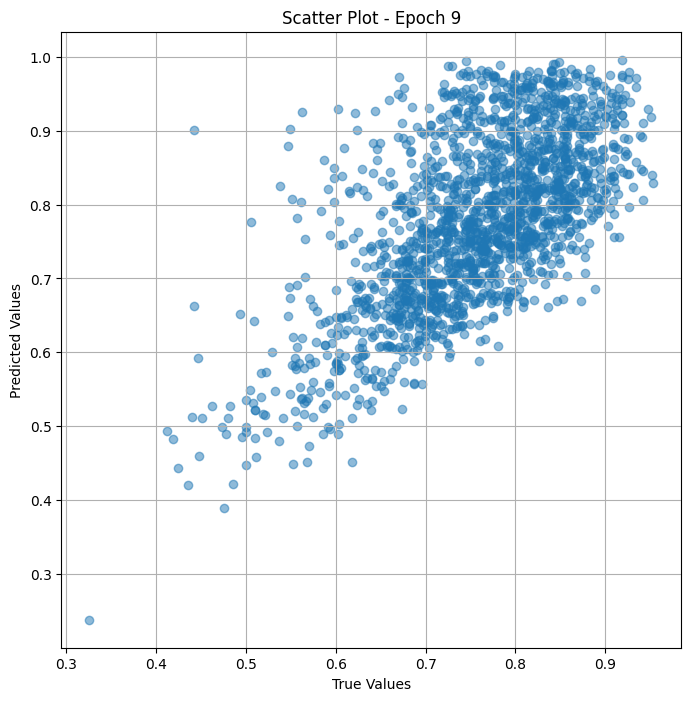


 Epoch: (10/50) Loss = 0.006692923605442047

 Epoch: (10/50) Loss_rmse = 0.08181028813123703

 Epoch: (10/50) R^2 = -0.39703476428985596

 Epoch: (10/50) MAE = 0.06026466190814972

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

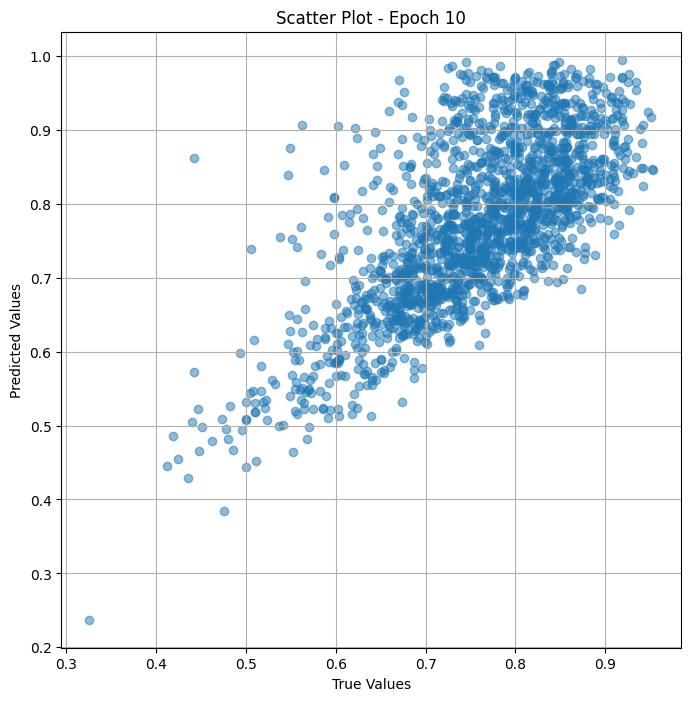


 Epoch: (11/50) Loss = 0.005236372351646423

 Epoch: (11/50) Loss_rmse = 0.07236278057098389

 Epoch: (11/50) R^2 = -0.09300434589385986

 Epoch: (11/50) MAE = 0.049791254103183746

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

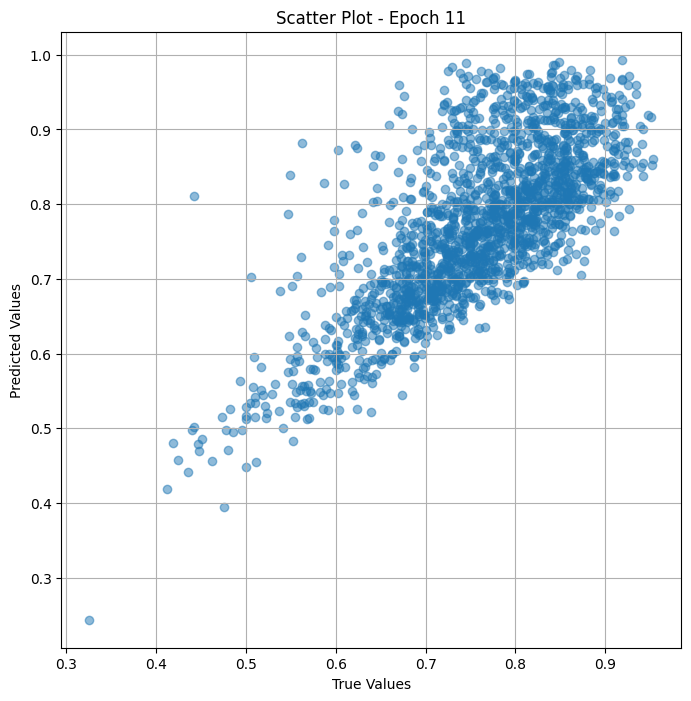


 Epoch: (12/50) Loss = 0.00414300337433815

 Epoch: (12/50) Loss_rmse = 0.0643661692738533

 Epoch: (12/50) R^2 = 0.13521802425384521

 Epoch: (12/50) MAE = 0.03962542116641998

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.69

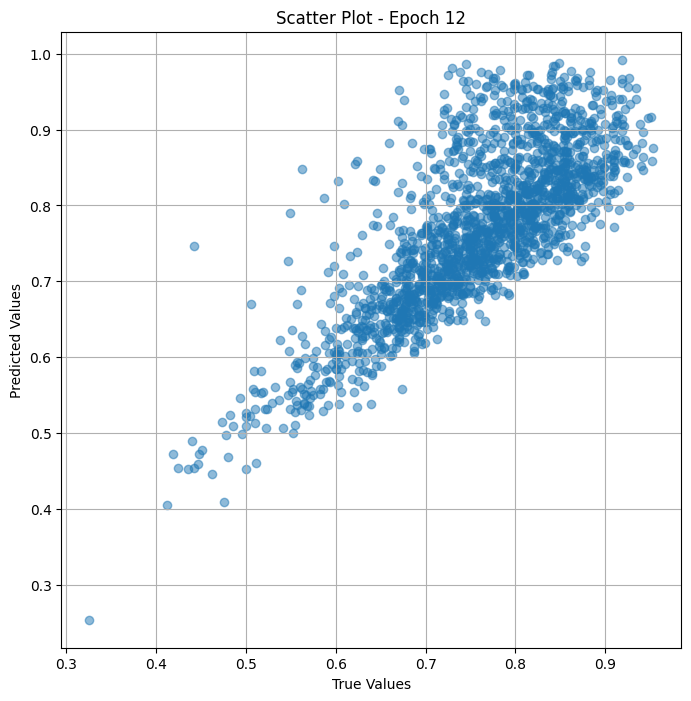


 Epoch: (13/50) Loss = 0.003382569644600153

 Epoch: (13/50) Loss_rmse = 0.05815986171364784

 Epoch: (13/50) R^2 = 0.2939457297325134

 Epoch: (13/50) MAE = 0.032311953604221344

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

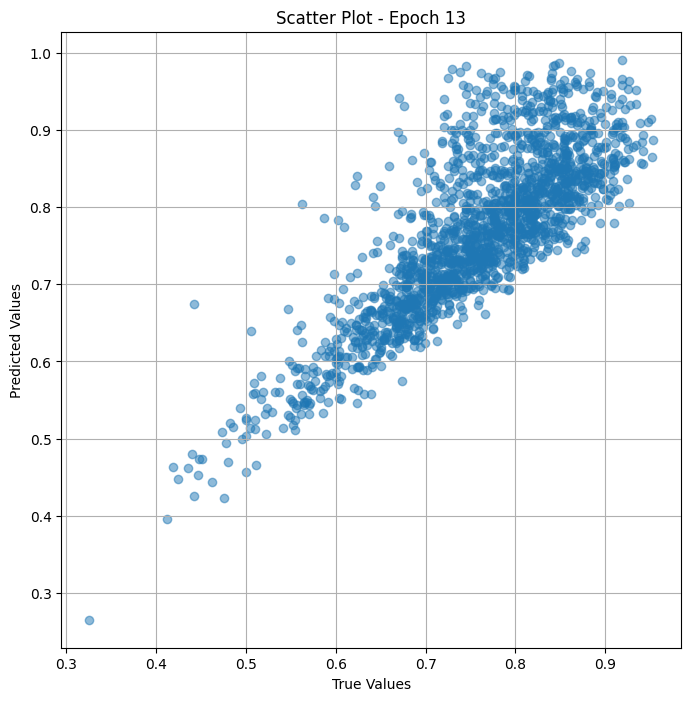


 Epoch: (14/50) Loss = 0.0027882633730769157

 Epoch: (14/50) Loss_rmse = 0.05280400812625885

 Epoch: (14/50) R^2 = 0.4179971218109131

 Epoch: (14/50) MAE = 0.026466242969036102

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

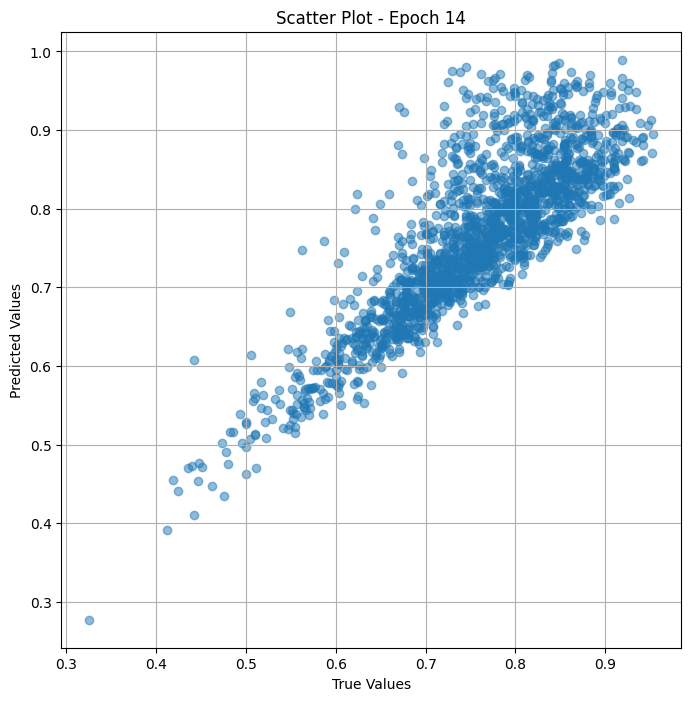


 Epoch: (15/50) Loss = 0.0022160792723298073

 Epoch: (15/50) Loss_rmse = 0.04707525297999382

 Epoch: (15/50) R^2 = 0.5374308824539185

 Epoch: (15/50) MAE = 0.026551581919193268

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

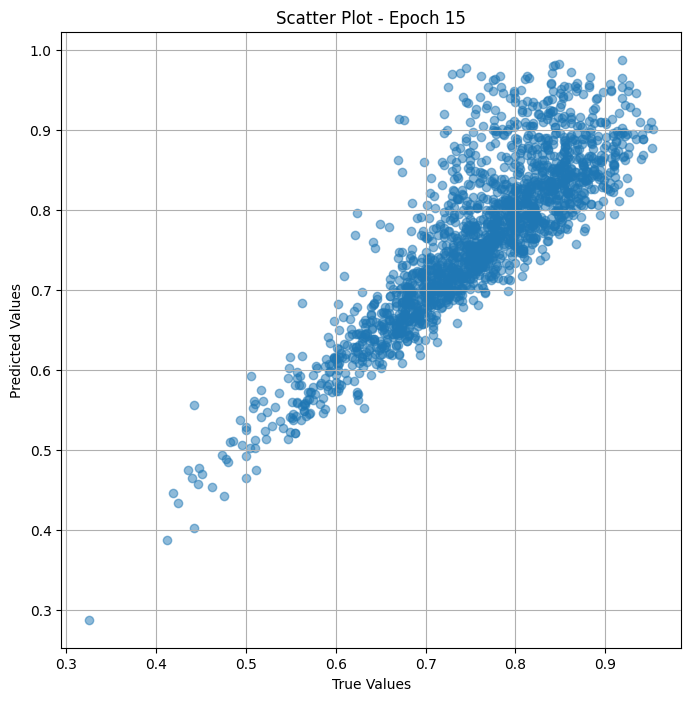


 Epoch: (16/50) Loss = 0.001630640123039484

 Epoch: (16/50) Loss_rmse = 0.040381185710430145

 Epoch: (16/50) R^2 = 0.6596313714981079

 Epoch: (16/50) MAE = 0.025844871997833252

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

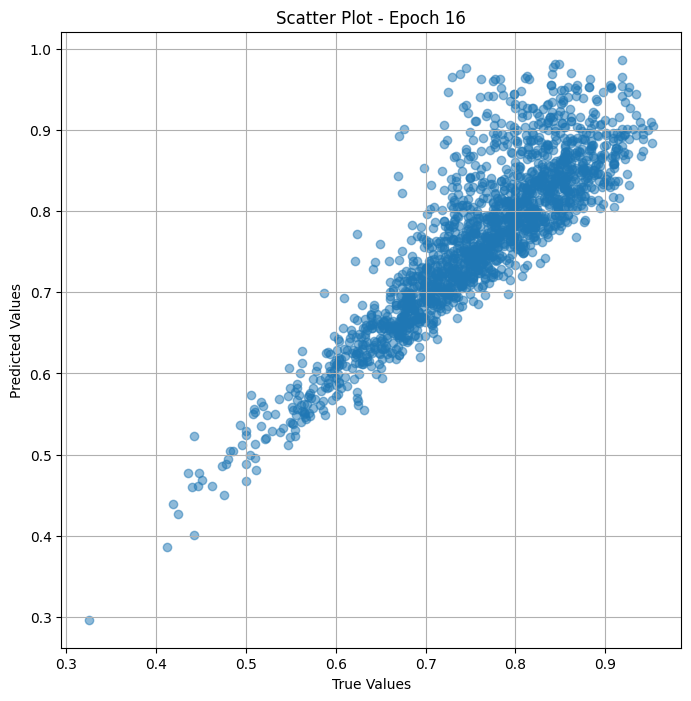


 Epoch: (17/50) Loss = 0.001091589336283505

 Epoch: (17/50) Loss_rmse = 0.03303920850157738

 Epoch: (17/50) R^2 = 0.7721491456031799

 Epoch: (17/50) MAE = 0.024227723479270935

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

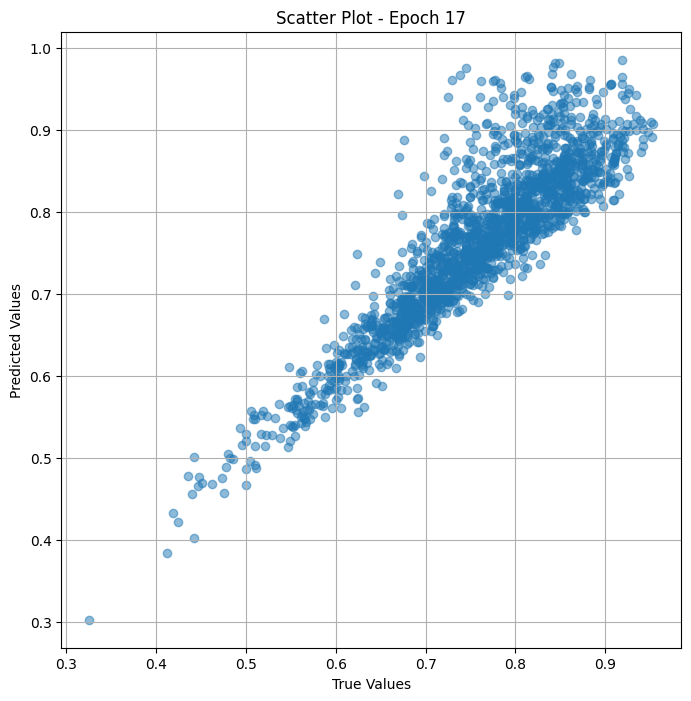


 Epoch: (18/50) Loss = 0.0006945595378056169

 Epoch: (18/50) Loss_rmse = 0.02635449729859829

 Epoch: (18/50) R^2 = 0.8550224304199219

 Epoch: (18/50) MAE = 0.02219131588935852

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

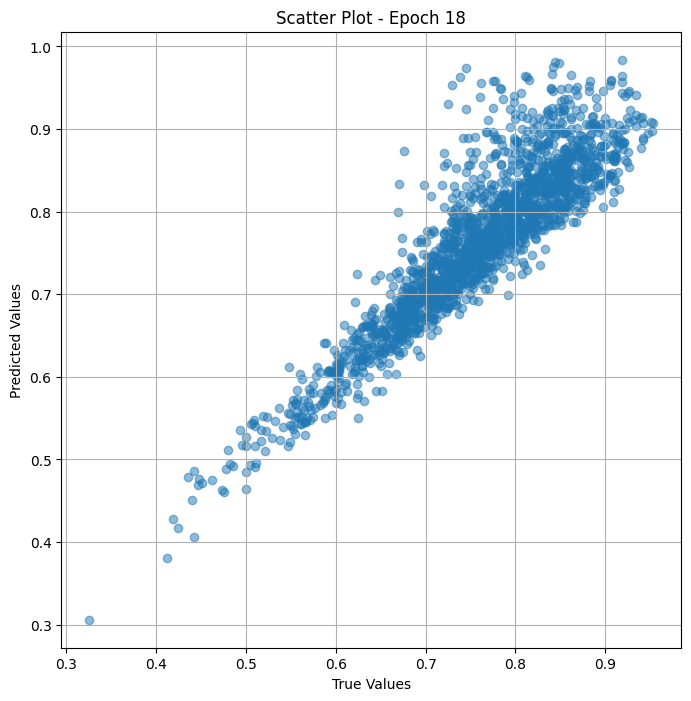


 Epoch: (19/50) Loss = 0.0004999631200917065

 Epoch: (19/50) Loss_rmse = 0.022359855473041534

 Epoch: (19/50) R^2 = 0.8956411480903625

 Epoch: (19/50) MAE = 0.020391419529914856

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

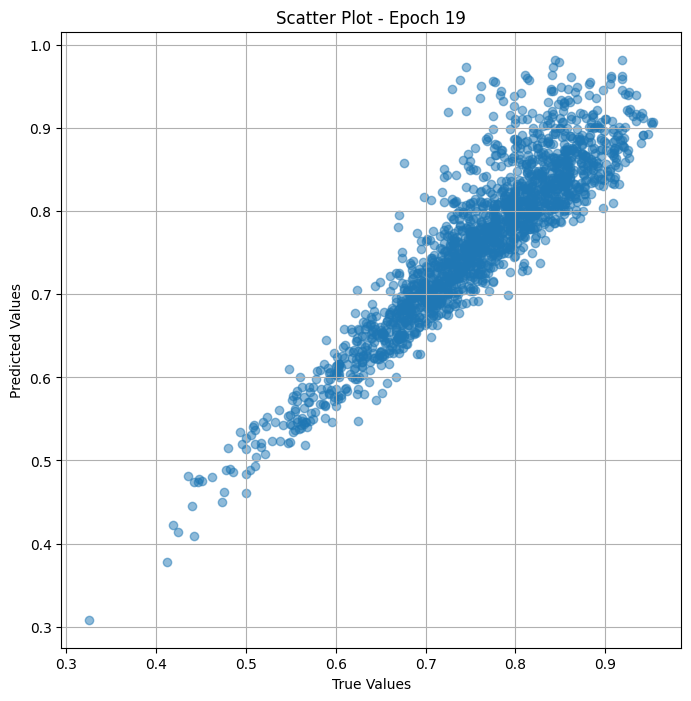


 Epoch: (20/50) Loss = 0.0004914815071970224

 Epoch: (20/50) Loss_rmse = 0.022169381380081177

 Epoch: (20/50) R^2 = 0.8974115252494812

 Epoch: (20/50) MAE = 0.019546717405319214

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

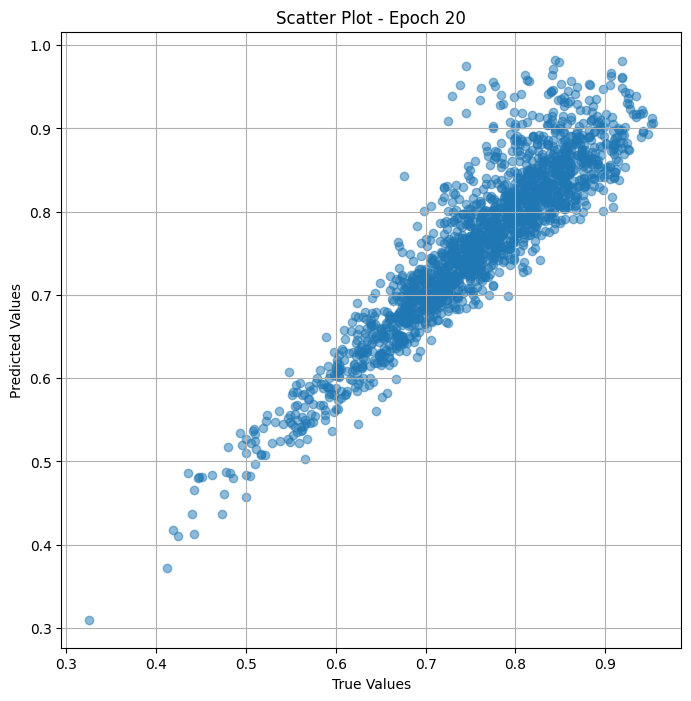


 Epoch: (21/50) Loss = 0.0006197463953867555

 Epoch: (21/50) Loss_rmse = 0.024894706904888153

 Epoch: (21/50) R^2 = 0.870638370513916

 Epoch: (21/50) MAE = 0.020289354026317596

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

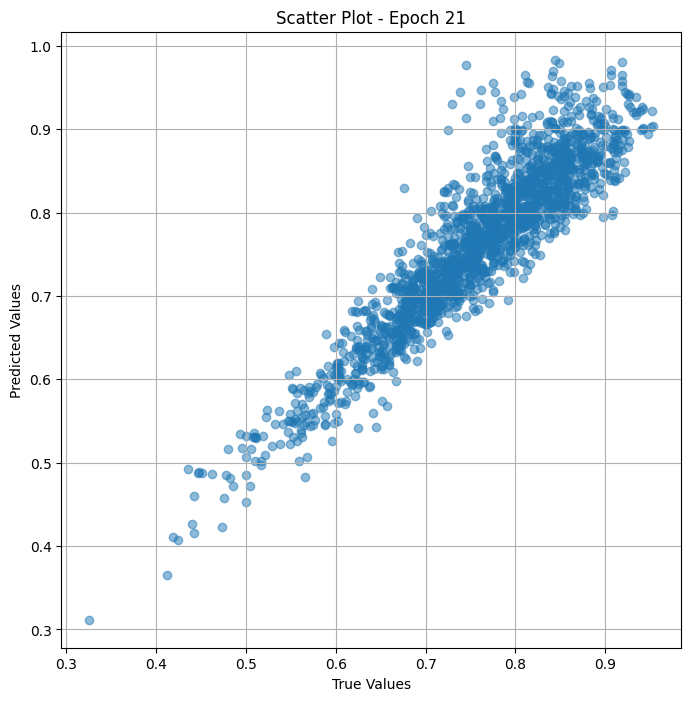


 Epoch: (22/50) Loss = 0.0008944406872615218

 Epoch: (22/50) Loss_rmse = 0.02990720048546791

 Epoch: (22/50) R^2 = 0.813300609588623

 Epoch: (22/50) MAE = 0.023631997406482697

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

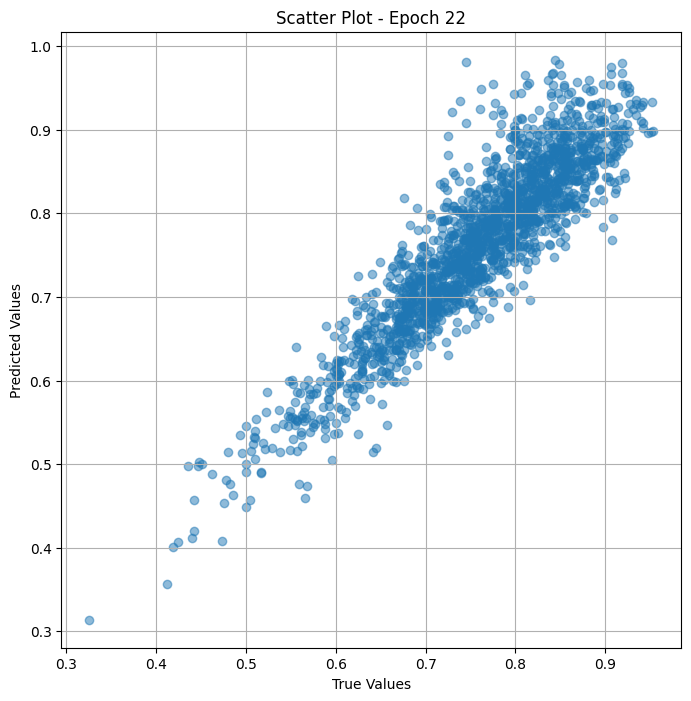


 Epoch: (23/50) Loss = 0.0017065620049834251

 Epoch: (23/50) Loss_rmse = 0.04131055623292923

 Epoch: (23/50) R^2 = 0.6437839865684509

 Epoch: (23/50) MAE = 0.034566327929496765

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

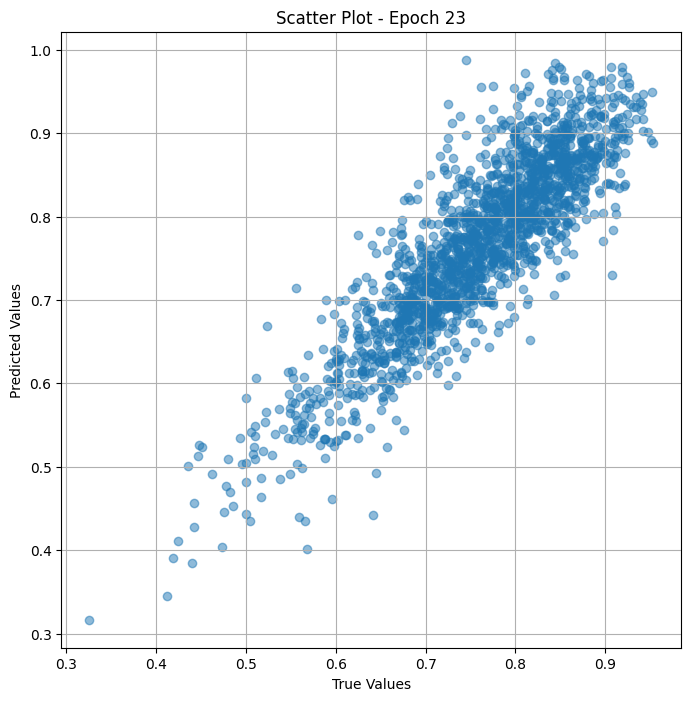


 Epoch: (24/50) Loss = 0.0034077749587595463

 Epoch: (24/50) Loss_rmse = 0.05837615206837654

 Epoch: (24/50) R^2 = 0.28868454694747925

 Epoch: (24/50) MAE = 0.0442013293504715

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

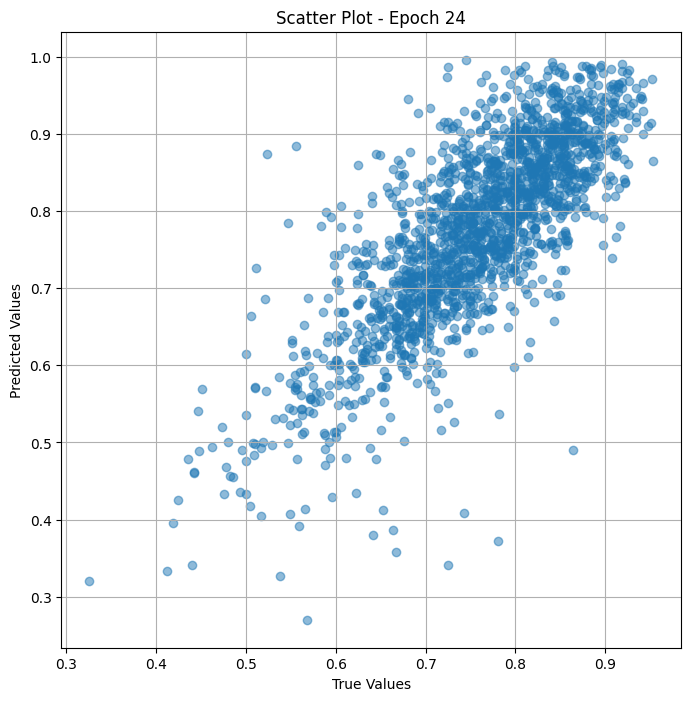


 Epoch: (25/50) Loss = 0.023869667202234268

 Epoch: (25/50) Loss_rmse = 0.1544981151819229

 Epoch: (25/50) R^2 = -3.9823899269104004

 Epoch: (25/50) MAE = 0.14704863727092743

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

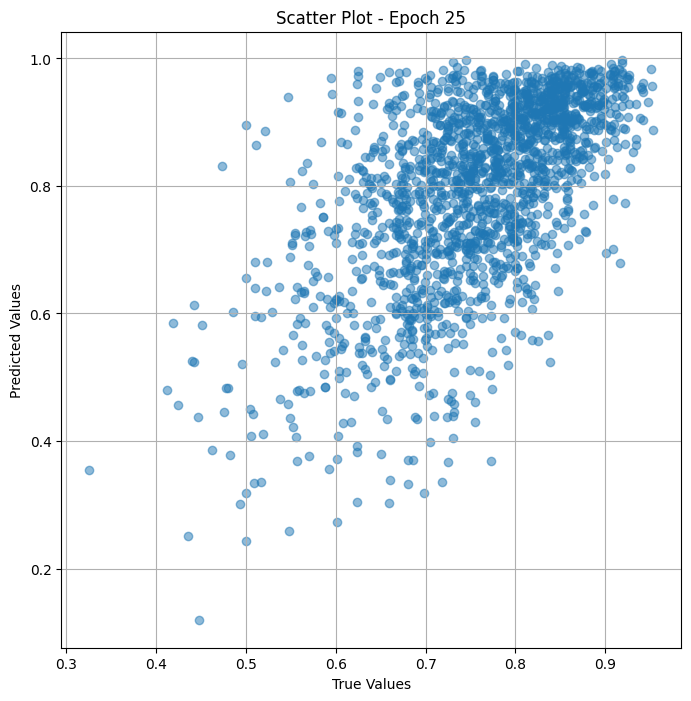


 Epoch: (26/50) Loss = 0.020669713616371155

 Epoch: (26/50) Loss_rmse = 0.14376965165138245

 Epoch: (26/50) R^2 = -3.314453601837158

 Epoch: (26/50) MAE = 0.13667625188827515

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

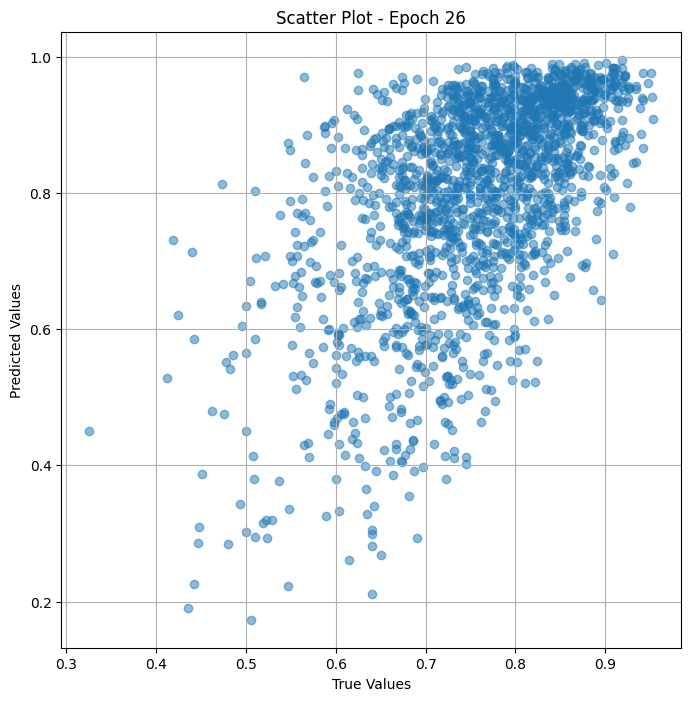


 Epoch: (27/50) Loss = 0.00911958608776331

 Epoch: (27/50) Loss_rmse = 0.0954965204000473

 Epoch: (27/50) R^2 = -0.9035595655441284

 Epoch: (27/50) MAE = 0.08269339054822922

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.69

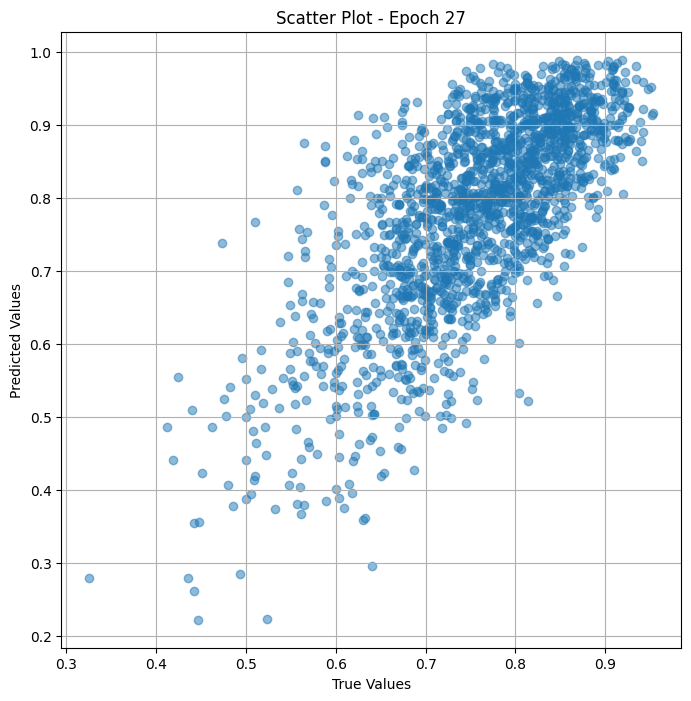


 Epoch: (28/50) Loss = 0.005781291984021664

 Epoch: (28/50) Loss_rmse = 0.07603480666875839

 Epoch: (28/50) R^2 = -0.20674705505371094

 Epoch: (28/50) MAE = 0.06042633205652237

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

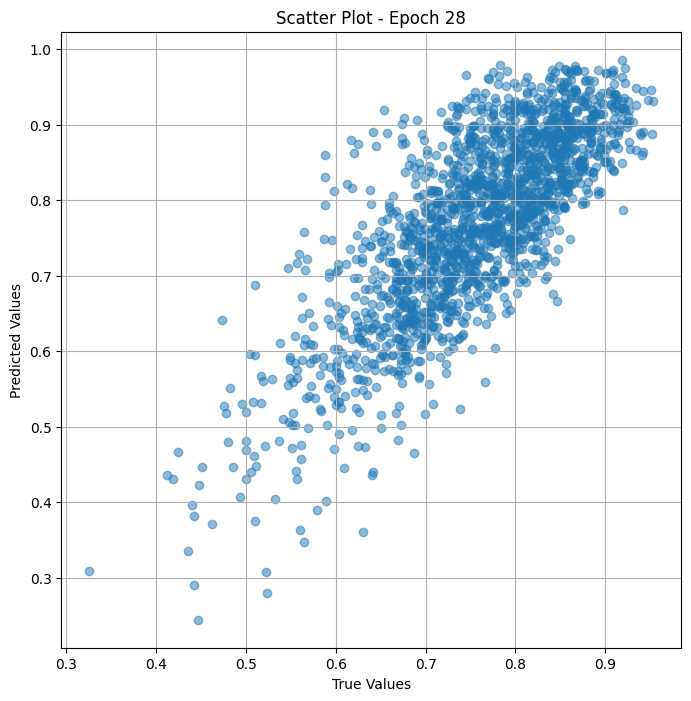


 Epoch: (29/50) Loss = 0.0037981413770467043

 Epoch: (29/50) Loss_rmse = 0.06162906438112259

 Epoch: (29/50) R^2 = 0.20720213651657104

 Epoch: (29/50) MAE = 0.04399879276752472

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

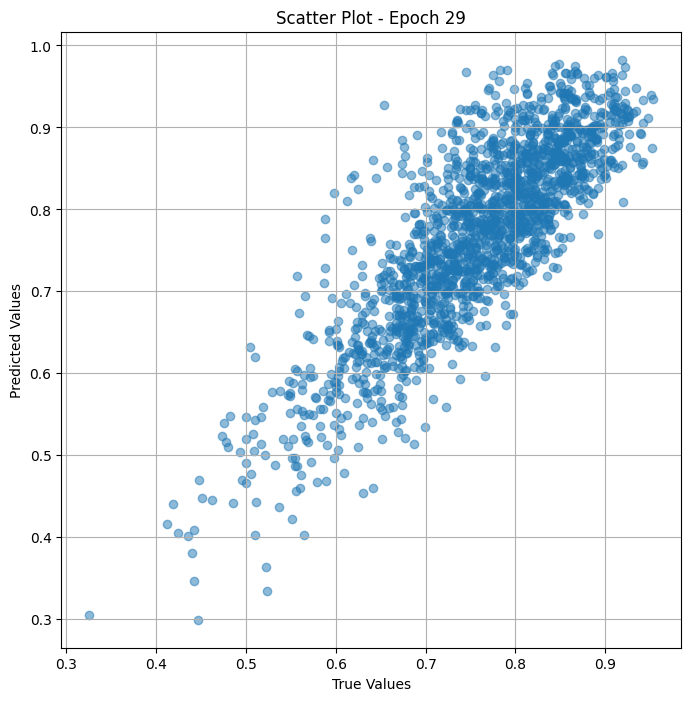


 Epoch: (30/50) Loss = 0.0024505748879164457

 Epoch: (30/50) Loss_rmse = 0.04950328171253204

 Epoch: (30/50) R^2 = 0.48848384618759155

 Epoch: (30/50) MAE = 0.04078307002782822

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

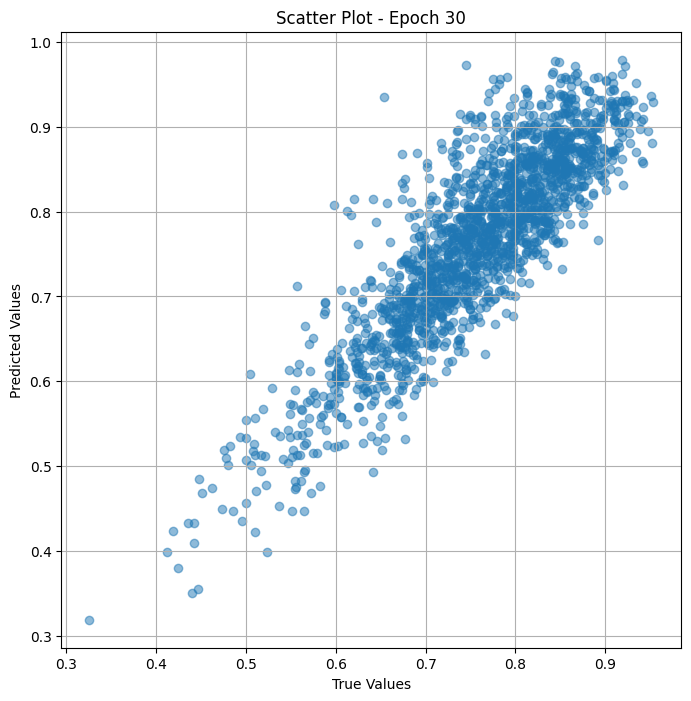


 Epoch: (31/50) Loss = 0.001457364996895194

 Epoch: (31/50) Loss_rmse = 0.03817544877529144

 Epoch: (31/50) R^2 = 0.695799708366394

 Epoch: (31/50) MAE = 0.030542410910129547

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

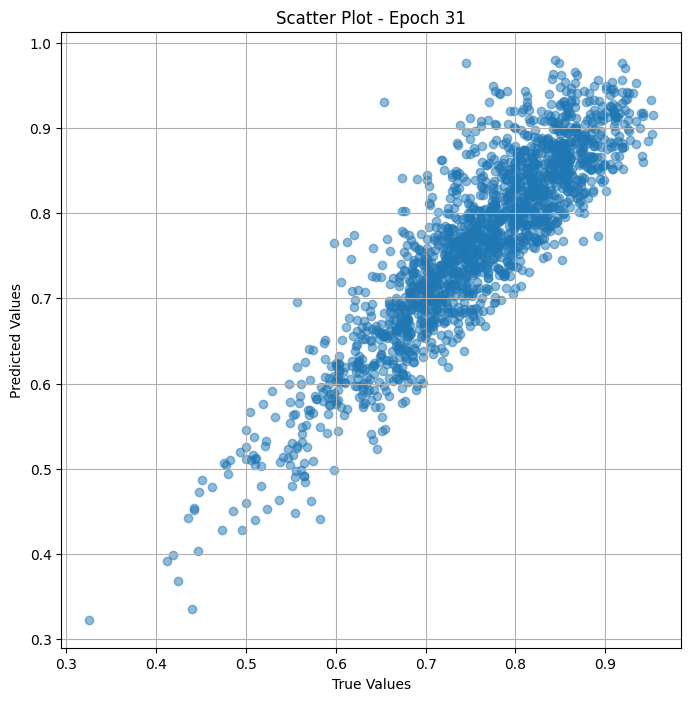


 Epoch: (32/50) Loss = 0.0010032812133431435

 Epoch: (32/50) Loss_rmse = 0.031674616038799286

 Epoch: (32/50) R^2 = 0.790582001209259

 Epoch: (32/50) MAE = 0.022592082619667053

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

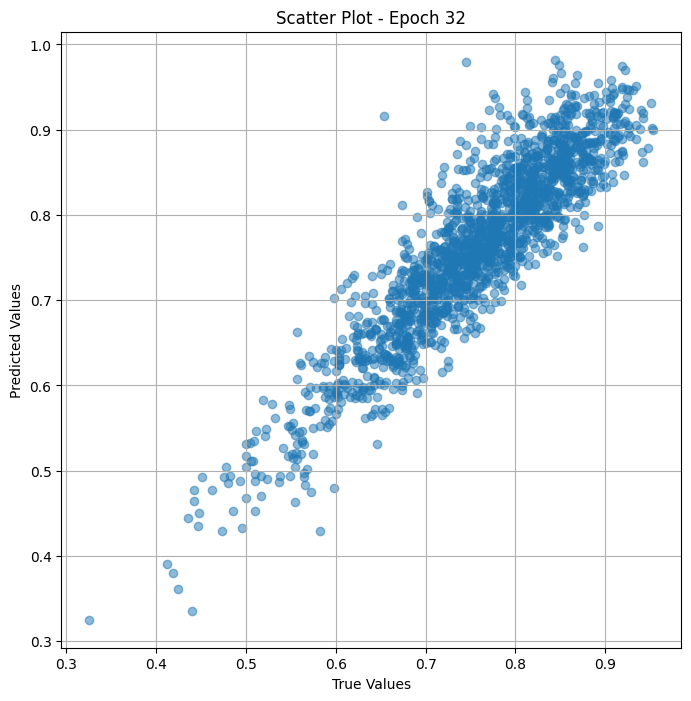


 Epoch: (33/50) Loss = 0.0007223463035188615

 Epoch: (33/50) Loss_rmse = 0.026876501739025116

 Epoch: (33/50) R^2 = 0.8492224216461182

 Epoch: (33/50) MAE = 0.01966863125562668

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

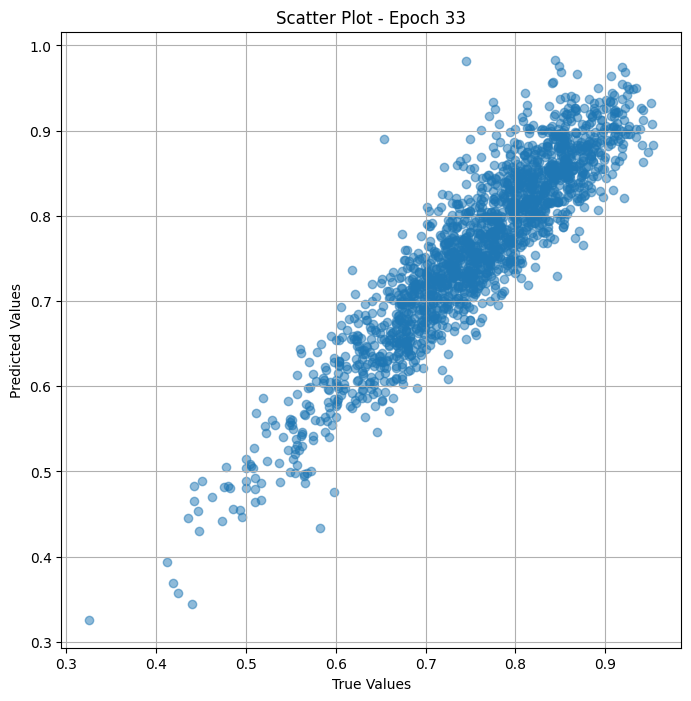


 Epoch: (34/50) Loss = 0.000498460722155869

 Epoch: (34/50) Loss_rmse = 0.022326234728097916

 Epoch: (34/50) R^2 = 0.8959547281265259

 Epoch: (34/50) MAE = 0.014504015445709229

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

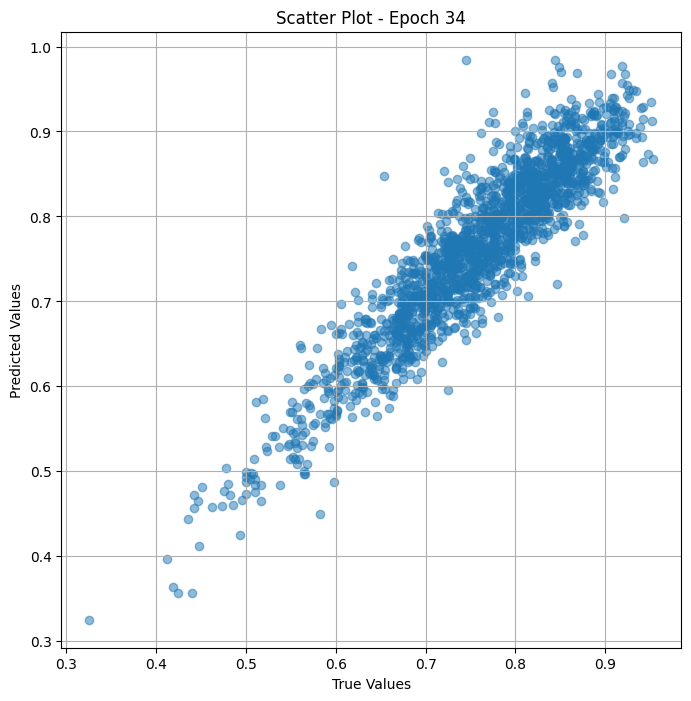


 Epoch: (35/50) Loss = 0.0003904704353772104

 Epoch: (35/50) Loss_rmse = 0.01976032555103302

 Epoch: (35/50) R^2 = 0.9184958934783936

 Epoch: (35/50) MAE = 0.010774202644824982

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

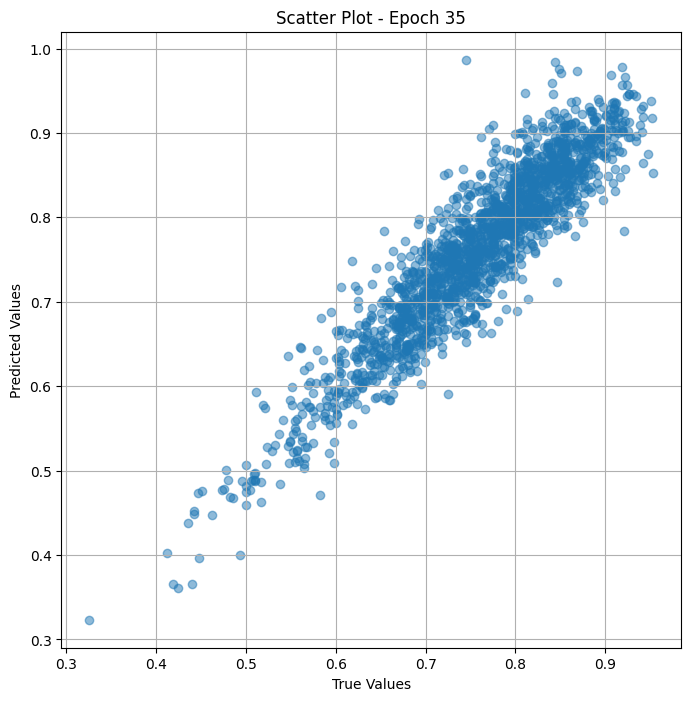


 Epoch: (36/50) Loss = 0.0004745856567751616

 Epoch: (36/50) Loss_rmse = 0.021784987300634384

 Epoch: (36/50) R^2 = 0.9009382724761963

 Epoch: (36/50) MAE = 0.01460159569978714

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

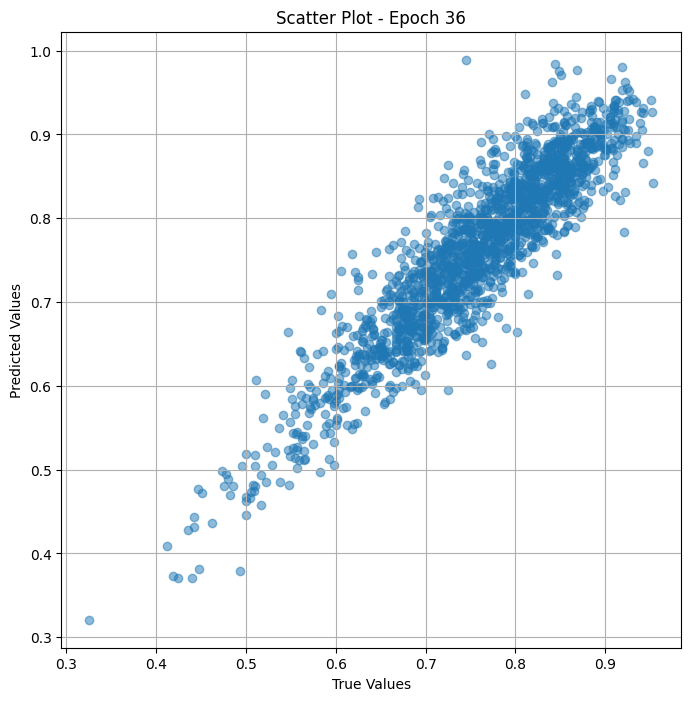


 Epoch: (37/50) Loss = 0.0008486493607051671

 Epoch: (37/50) Loss_rmse = 0.029131587594747543

 Epoch: (37/50) R^2 = 0.8228588104248047

 Epoch: (37/50) MAE = 0.024638459086418152

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

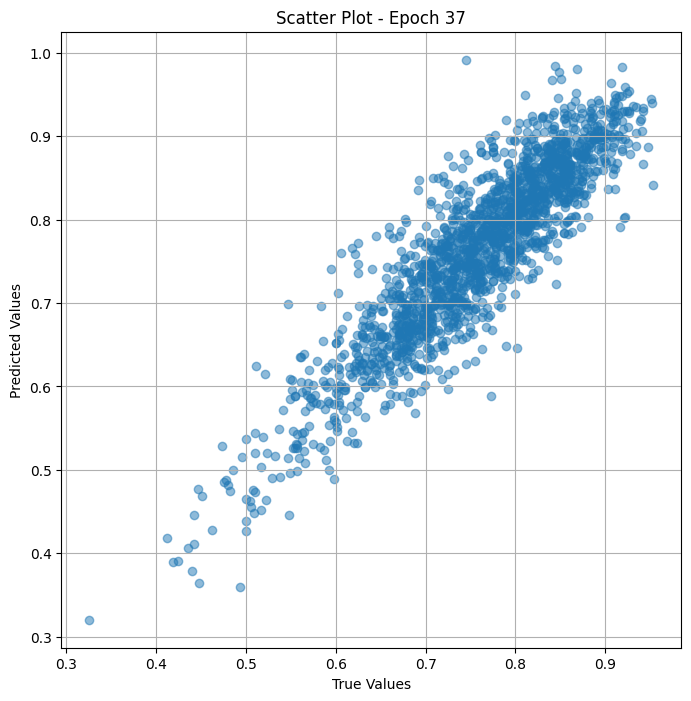


 Epoch: (38/50) Loss = 0.0019912272691726685

 Epoch: (38/50) Loss_rmse = 0.04462317004799843

 Epoch: (38/50) R^2 = 0.5843648910522461

 Epoch: (38/50) MAE = 0.041488416492938995

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

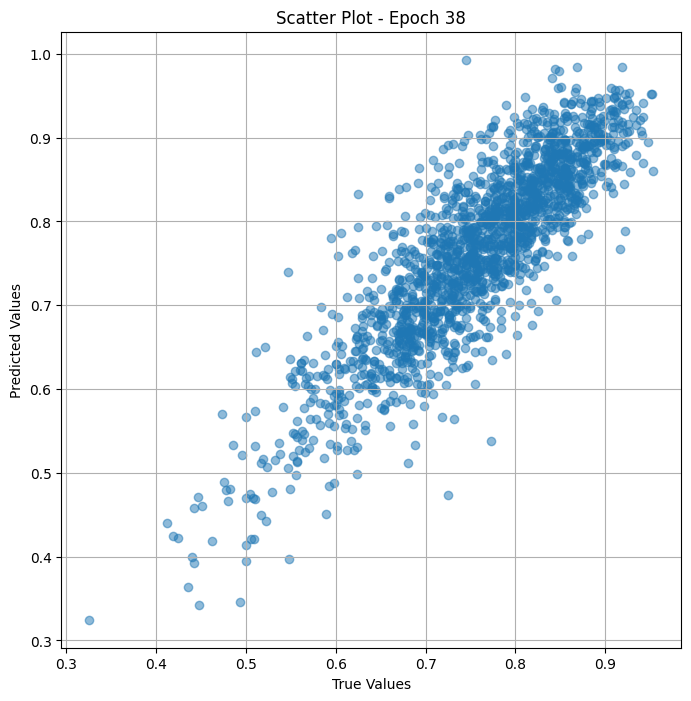


 Epoch: (39/50) Loss = 0.006119257770478725

 Epoch: (39/50) Loss_rmse = 0.07822568714618683

 Epoch: (39/50) R^2 = -0.27729177474975586

 Epoch: (39/50) MAE = 0.07406105846166611

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

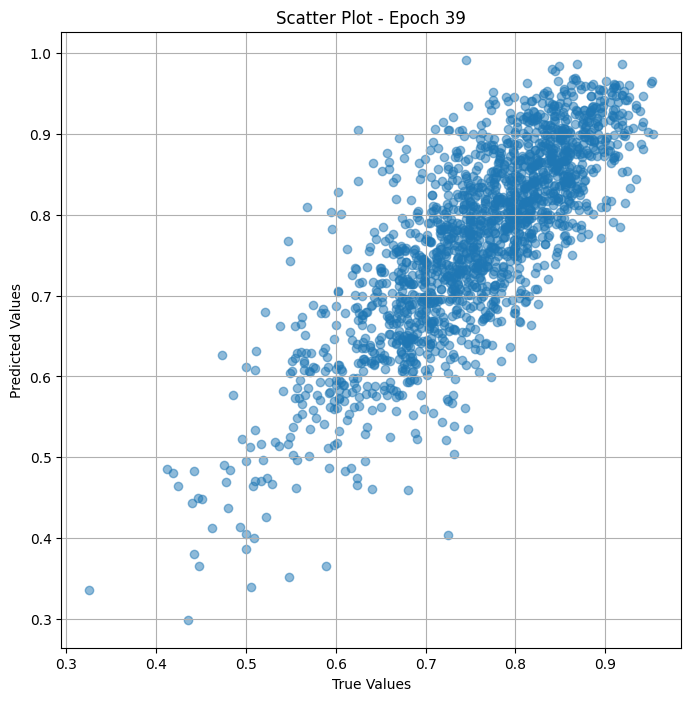


 Epoch: (40/50) Loss = 0.005237840116024017

 Epoch: (40/50) Loss_rmse = 0.0723729208111763

 Epoch: (40/50) R^2 = -0.09331071376800537

 Epoch: (40/50) MAE = 0.06158678978681564

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

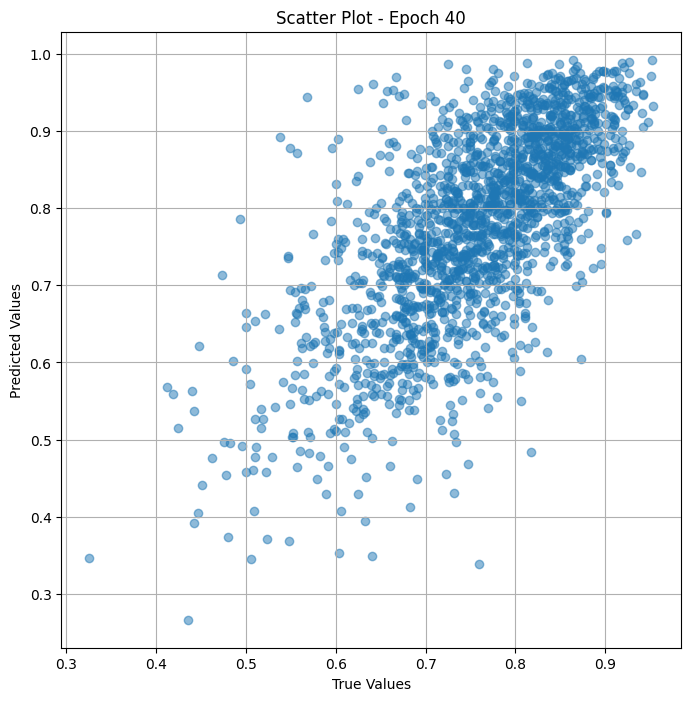


 Epoch: (41/50) Loss = 0.012217594310641289

 Epoch: (41/50) Loss_rmse = 0.1105332300066948

 Epoch: (41/50) R^2 = -1.5502164363861084

 Epoch: (41/50) MAE = 0.08269995450973511

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

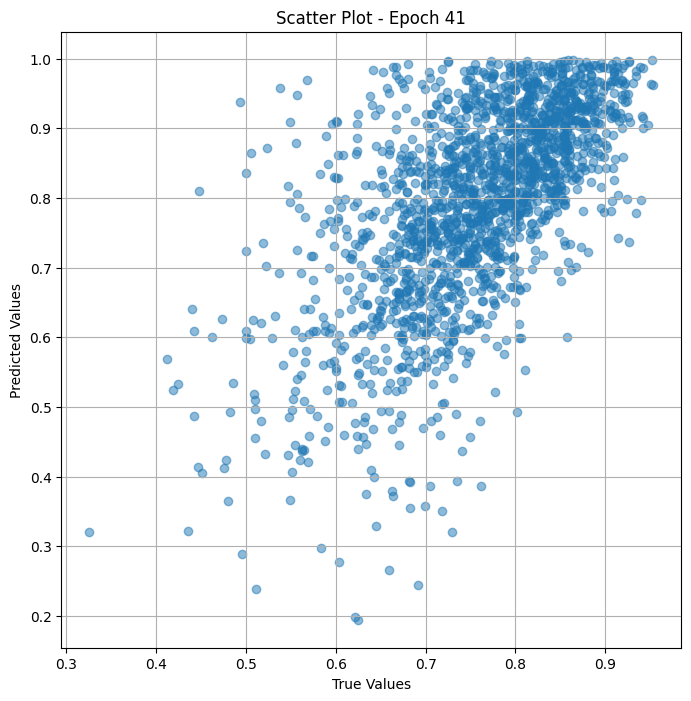


 Epoch: (42/50) Loss = 0.0049469079822301865

 Epoch: (42/50) Loss_rmse = 0.07033425569534302

 Epoch: (42/50) R^2 = -0.03258347511291504

 Epoch: (42/50) MAE = 0.05233854800462723

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

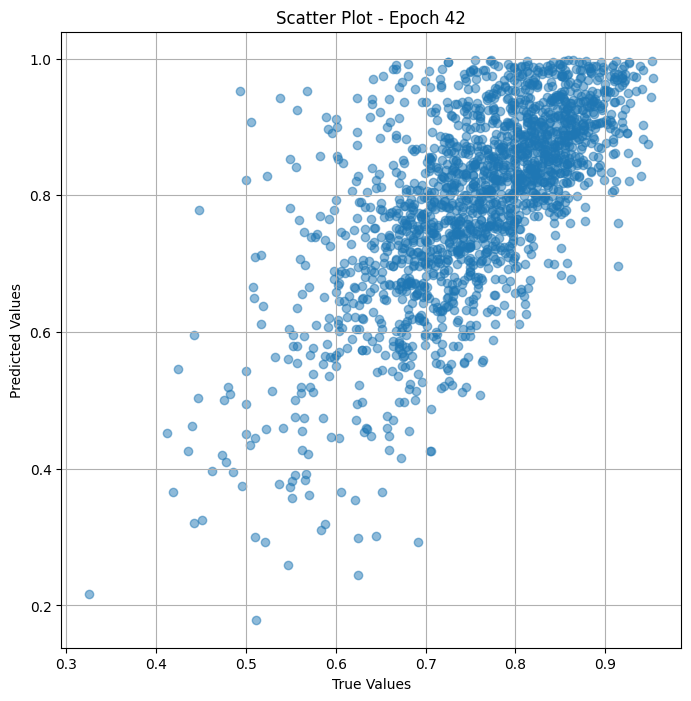


 Epoch: (43/50) Loss = 0.0014483362901955843

 Epoch: (43/50) Loss_rmse = 0.03805701434612274

 Epoch: (43/50) R^2 = 0.6976842880249023

 Epoch: (43/50) MAE = 0.02595037966966629

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

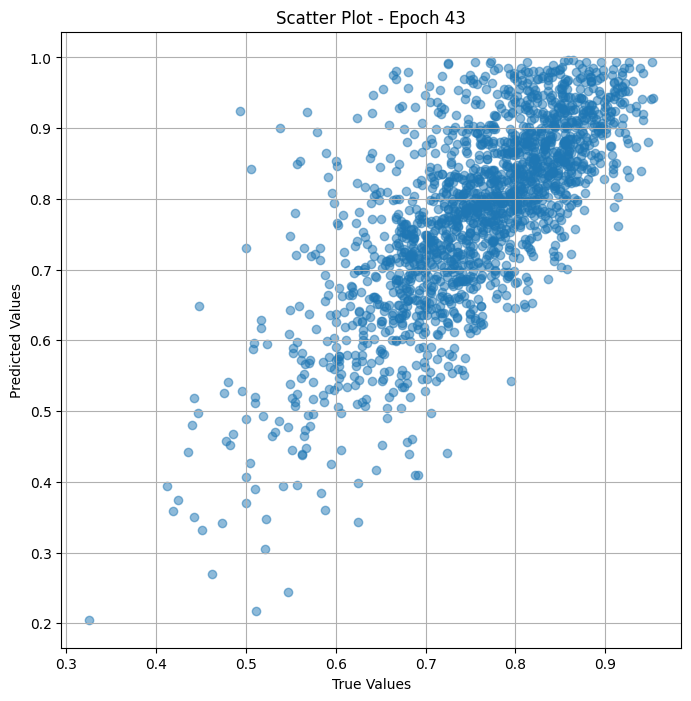


 Epoch: (44/50) Loss = 0.0017069196328520775

 Epoch: (44/50) Loss_rmse = 0.04131488502025604

 Epoch: (44/50) R^2 = 0.6437093615531921

 Epoch: (44/50) MAE = 0.029656358063220978

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

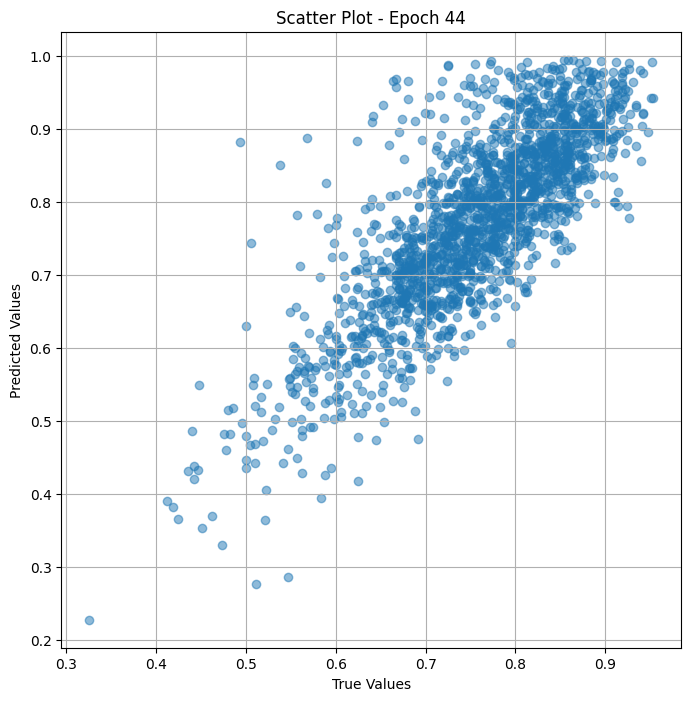


 Epoch: (45/50) Loss = 0.0016778955468907952

 Epoch: (45/50) Loss_rmse = 0.04096212238073349

 Epoch: (45/50) R^2 = 0.6497676372528076

 Epoch: (45/50) MAE = 0.028726622462272644

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

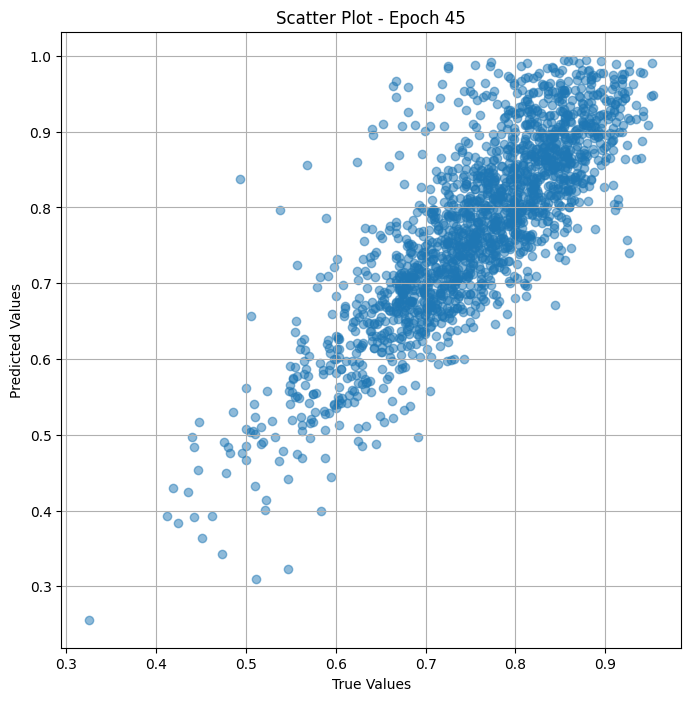


 Epoch: (46/50) Loss = 0.0012329297605901957

 Epoch: (46/50) Loss_rmse = 0.035113099962472916

 Epoch: (46/50) R^2 = 0.7426466941833496

 Epoch: (46/50) MAE = 0.024768464267253876

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

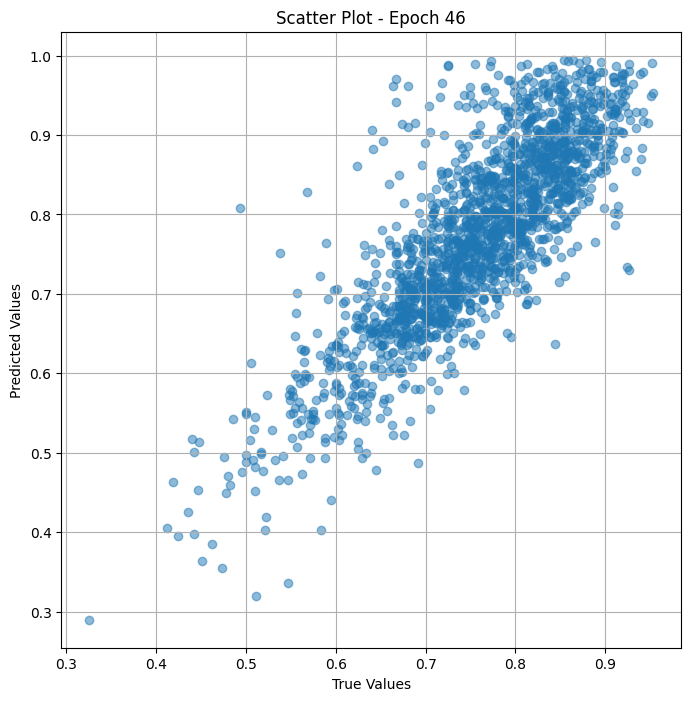


 Epoch: (47/50) Loss = 0.0007747641066089272

 Epoch: (47/50) Loss_rmse = 0.027834584936499596

 Epoch: (47/50) R^2 = 0.8382810950279236

 Epoch: (47/50) MAE = 0.020833440124988556

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

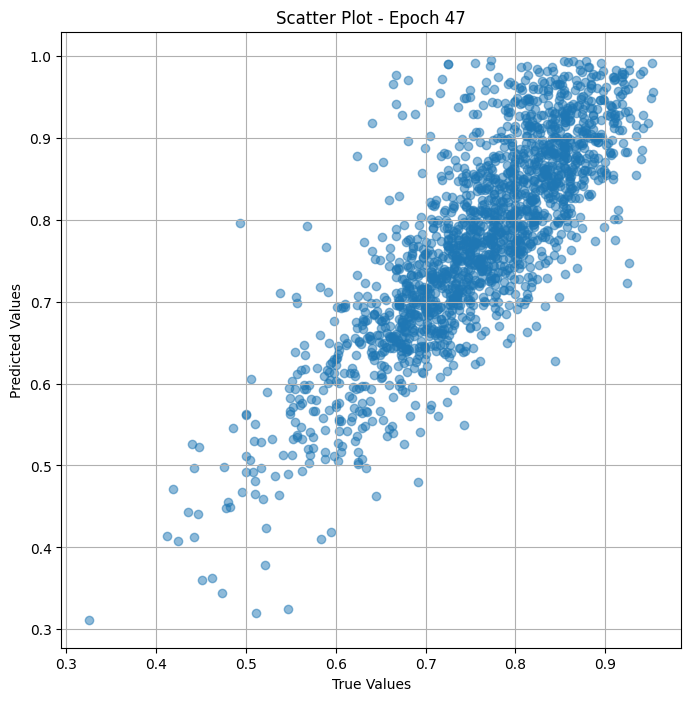


 Epoch: (48/50) Loss = 0.000411064422223717

 Epoch: (48/50) Loss_rmse = 0.020274722948670387

 Epoch: (48/50) R^2 = 0.9141972661018372

 Epoch: (48/50) MAE = 0.016978144645690918

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

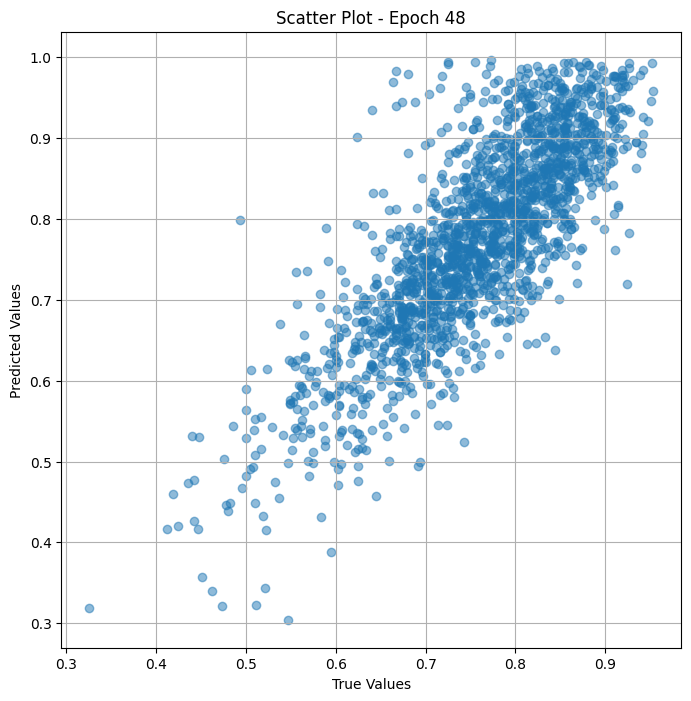


 Epoch: (49/50) Loss = 0.0019095794996246696

 Epoch: (49/50) Loss_rmse = 0.043698735535144806

 Epoch: (49/50) R^2 = 0.601407527923584

 Epoch: (49/50) MAE = 0.03993642330169678

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

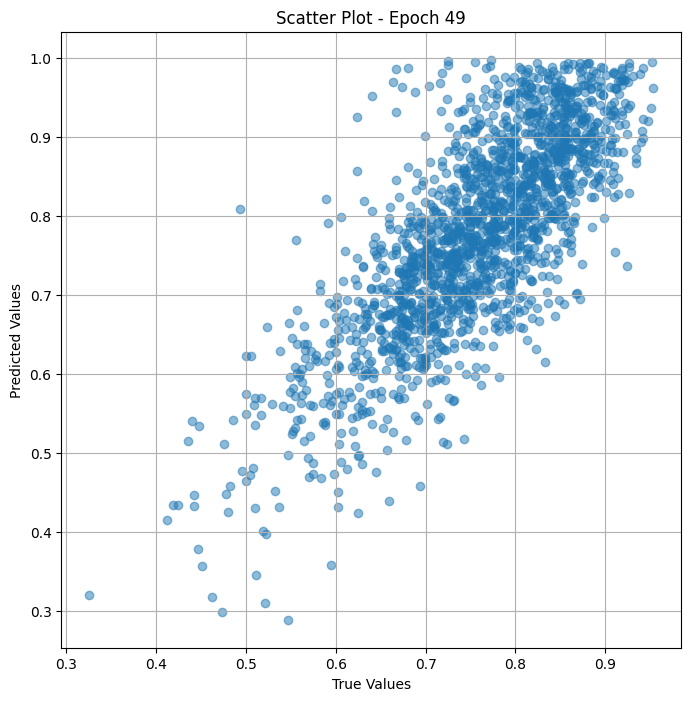


 Epoch: (50/50) Loss = 0.01176512986421585

 Epoch: (50/50) Loss_rmse = 0.10846718400716782

 Epoch: (50/50) R^2 = -1.4557721614837646

 Epoch: (50/50) MAE = 0.10266879200935364

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

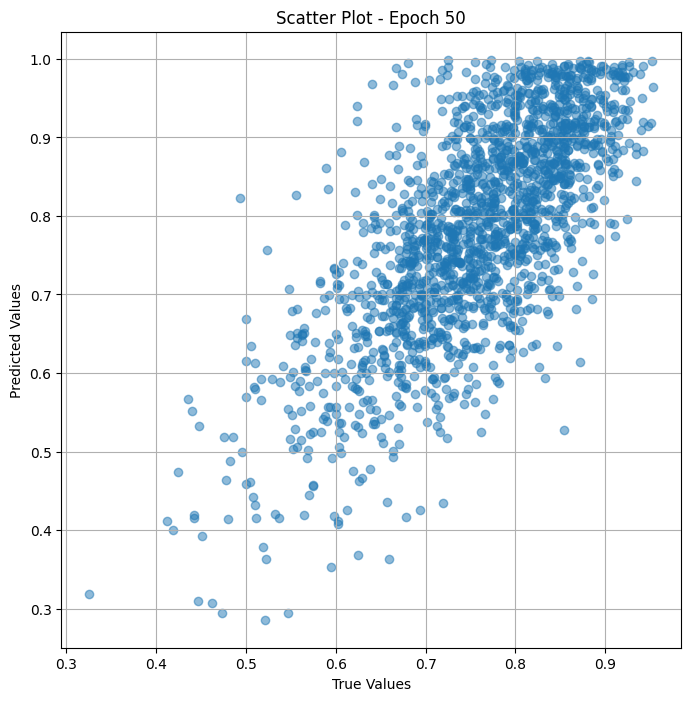

In [ ]:
# Training the model and save weights
fit(50, model, train_dl)
torch.save(model.state_dict(), "model_weights_S")

## Valid

In [ ]:
class Dataset_val(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_val(df_val_vehicle, trans_transform=trans_transform, res_transform=res_transform)
train_dl_val = DataLoader(train_ds, batch_size=16, shuffle= False)

In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

In [ ]:
# Merge the two models
class model_merge_val(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_val = model_merge_val(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_val = DeviceDataLoader(train_dl_val, device)
model_val = to_device(model_val, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_val.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_val, train_dl_val):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_val:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_val(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/100) Loss = 0.12223021686077118

 Epoch: (1/100) Loss_rmse = 0.34961438179016113

 Epoch: (1/100) R^2 = -46.42584228515625

 Epoch: (1/100) MAE = 0.2647796869277954

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0

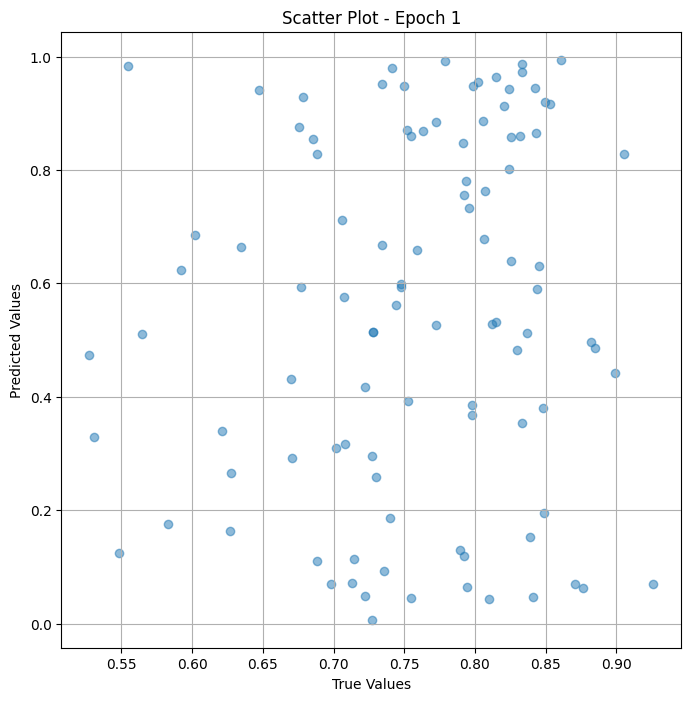


 Epoch: (2/100) Loss = 0.06121475622057915

 Epoch: (2/100) Loss_rmse = 0.247416153550148

 Epoch: (2/100) R^2 = -22.751585006713867

 Epoch: (2/100) MAE = 0.20981551706790924

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0

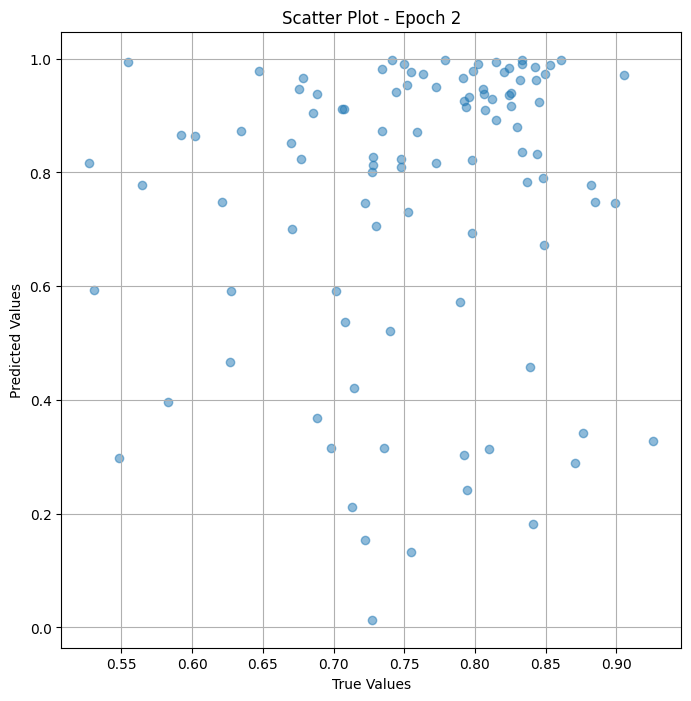


 Epoch: (3/100) Loss = 0.024504266679286957

 Epoch: (3/100) Loss_rmse = 0.15653838217258453

 Epoch: (3/100) R^2 = -8.507760047912598

 Epoch: (3/100) MAE = 0.1440109759569168

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 

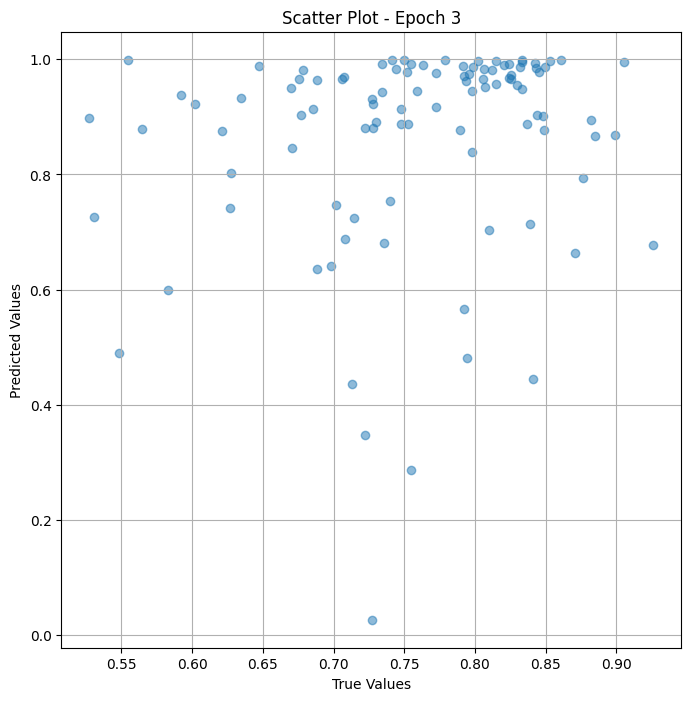


 Epoch: (4/100) Loss = 0.022925004363059998

 Epoch: (4/100) Loss_rmse = 0.1514100581407547

 Epoch: (4/100) R^2 = -7.8949995040893555

 Epoch: (4/100) MAE = 0.1462993621826172

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 

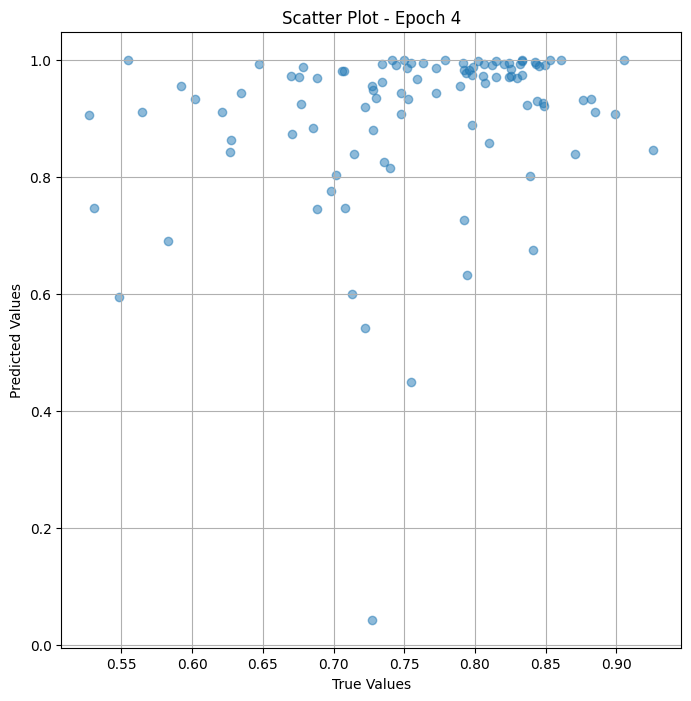


 Epoch: (5/100) Loss = 0.01370183378458023

 Epoch: (5/100) Loss_rmse = 0.11705483496189117

 Epoch: (5/100) R^2 = -4.316370010375977

 Epoch: (5/100) MAE = 0.11586436629295349

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 

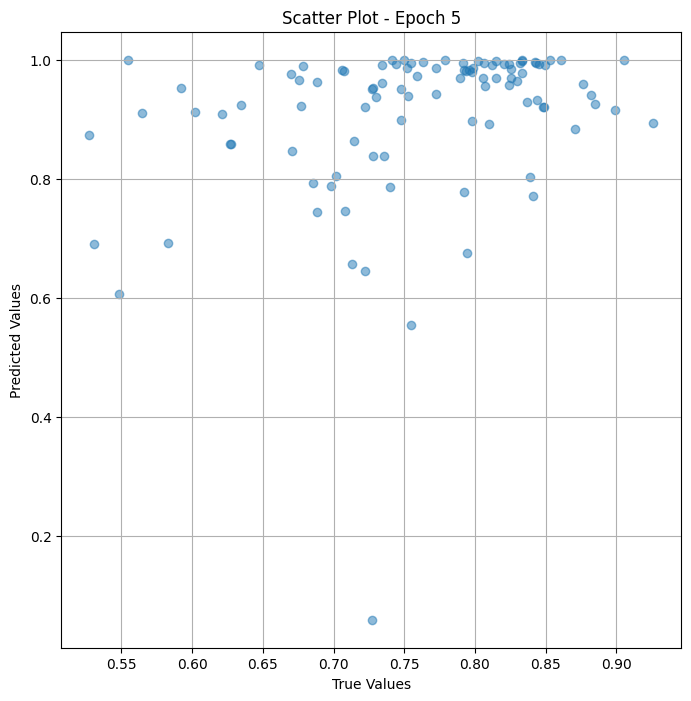


 Epoch: (6/100) Loss = 0.006567700766026974

 Epoch: (6/100) Loss_rmse = 0.0810413509607315

 Epoch: (6/100) R^2 = -1.5482957363128662

 Epoch: (6/100) MAE = 0.06946253776550293

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256,

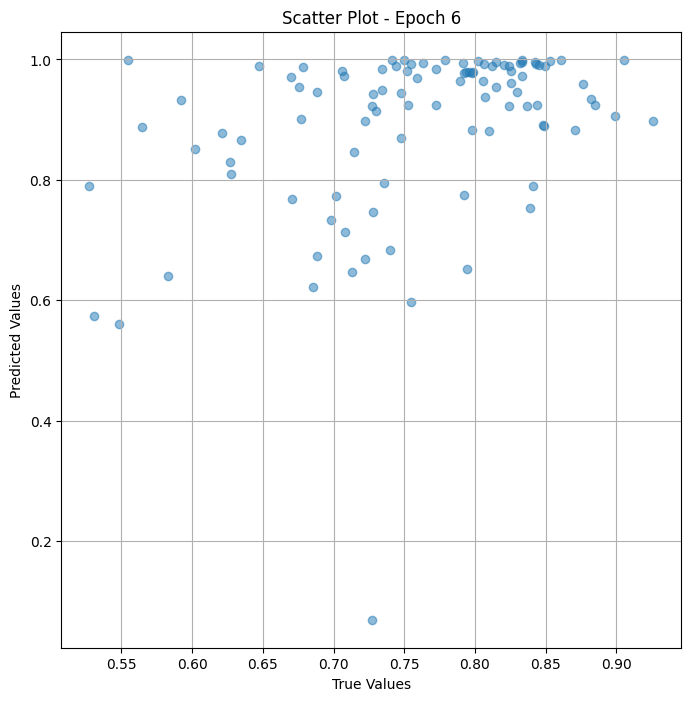


 Epoch: (7/100) Loss = 0.011186962015926838

 Epoch: (7/100) Loss_rmse = 0.10576843470335007

 Epoch: (7/100) R^2 = -3.3405890464782715

 Epoch: (7/100) MAE = 0.09254251420497894

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256

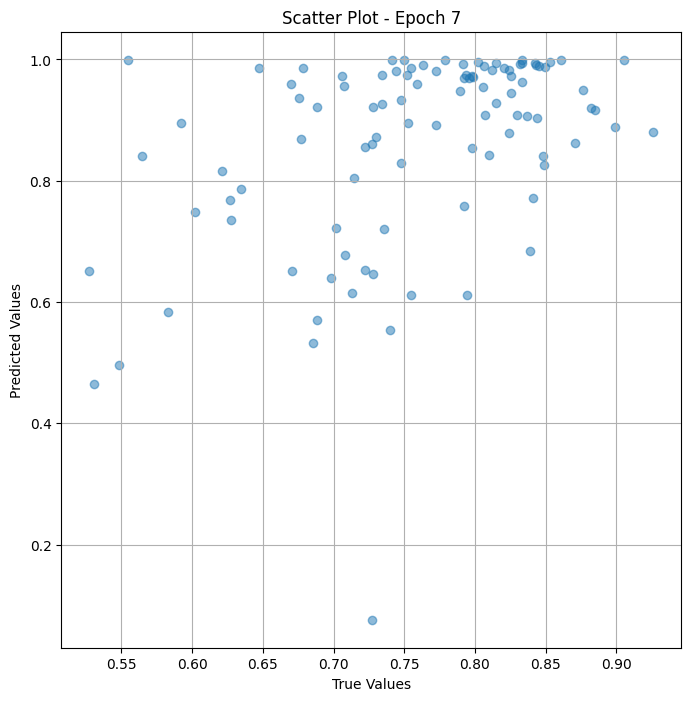


 Epoch: (8/100) Loss = 0.006698216311633587

 Epoch: (8/100) Loss_rmse = 0.08184263110160828

 Epoch: (8/100) R^2 = -1.5989363193511963

 Epoch: (8/100) MAE = 0.08018973469734192

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256

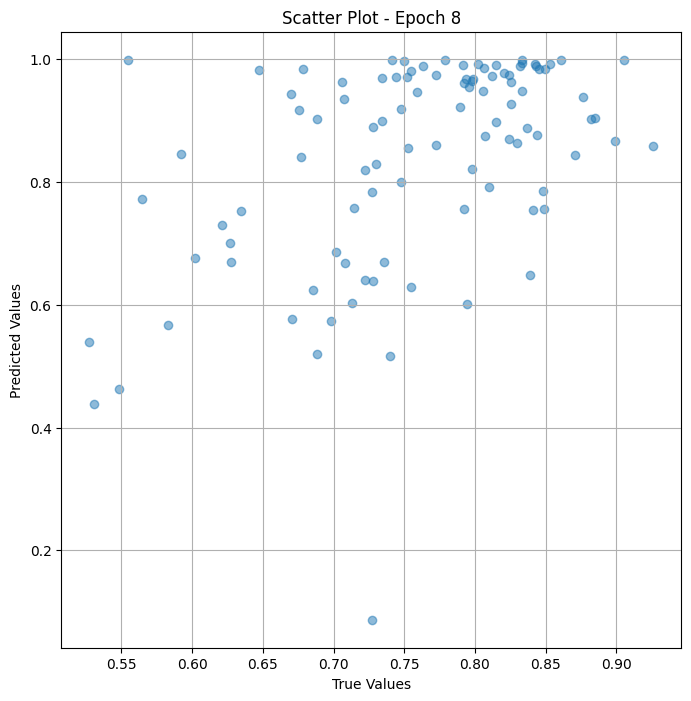


 Epoch: (9/100) Loss = 0.0032271563541144133

 Epoch: (9/100) Loss_rmse = 0.05680806562304497

 Epoch: (9/100) R^2 = -0.25215041637420654

 Epoch: (9/100) MAE = 0.0512300580739975

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274725

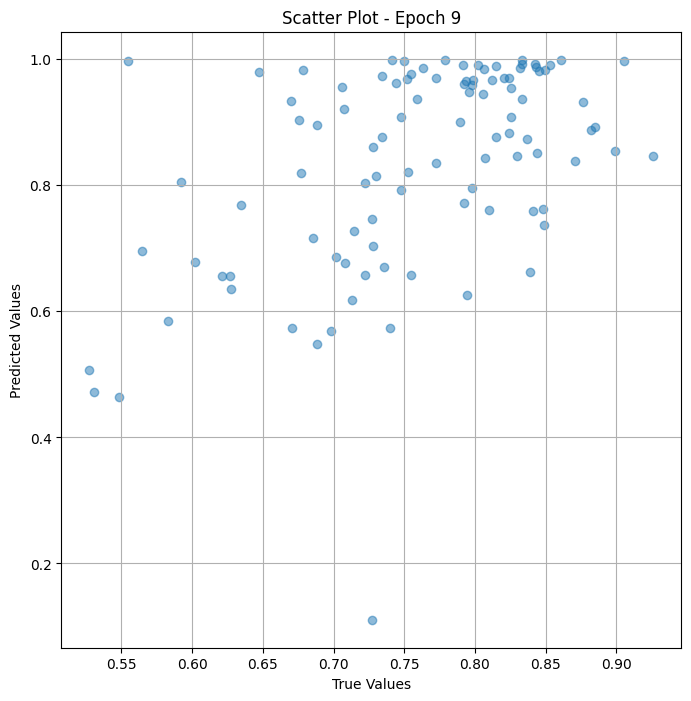


 Epoch: (10/100) Loss = 0.001983626512810588

 Epoch: (10/100) Loss_rmse = 0.044537920504808426

 Epoch: (10/100) R^2 = 0.2303444743156433

 Epoch: (10/100) MAE = 0.04234495759010315

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274

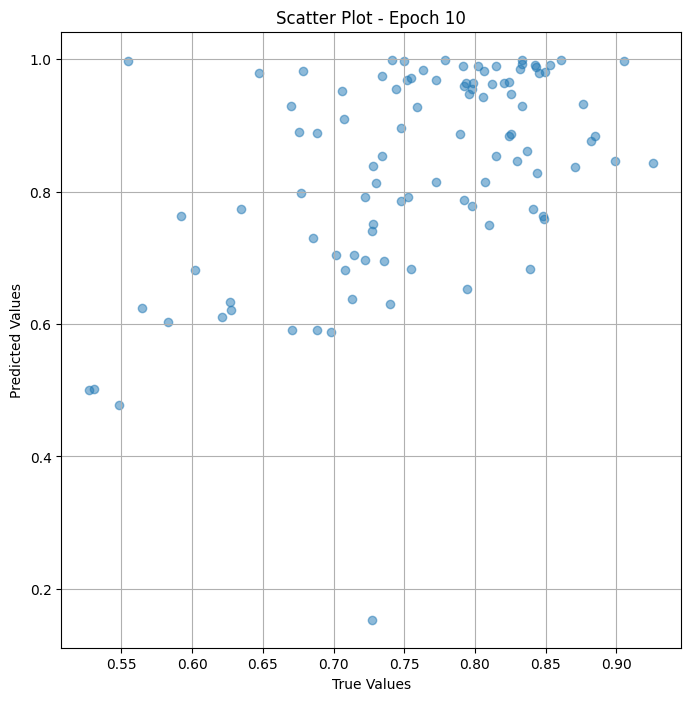


 Epoch: (11/100) Loss = 0.0007202133419923484

 Epoch: (11/100) Loss_rmse = 0.026836790144443512

 Epoch: (11/100) R^2 = 0.7205541729927063

 Epoch: (11/100) MAE = 0.024754583835601807

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52

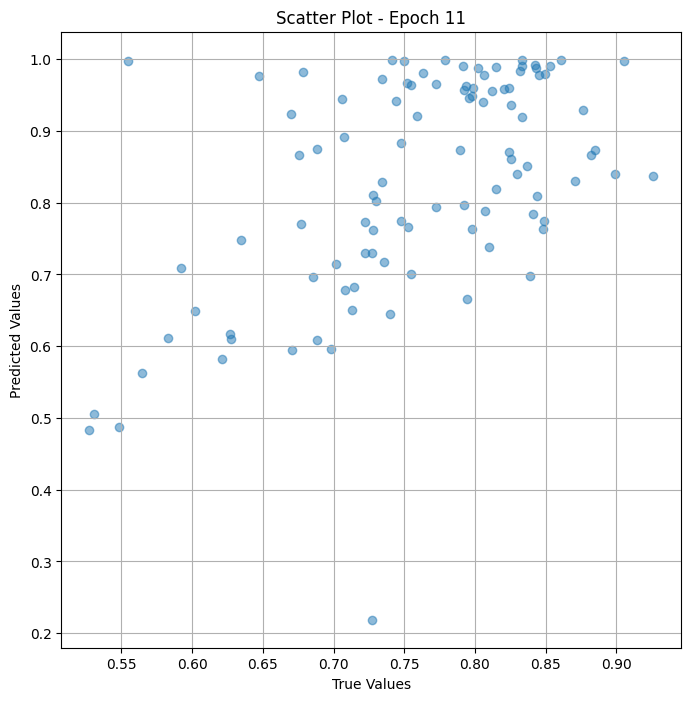


 Epoch: (12/100) Loss = 0.00030782714020460844

 Epoch: (12/100) Loss_rmse = 0.017545003443956375

 Epoch: (12/100) R^2 = 0.8805617690086365

 Epoch: (12/100) MAE = 0.015844151377677917

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

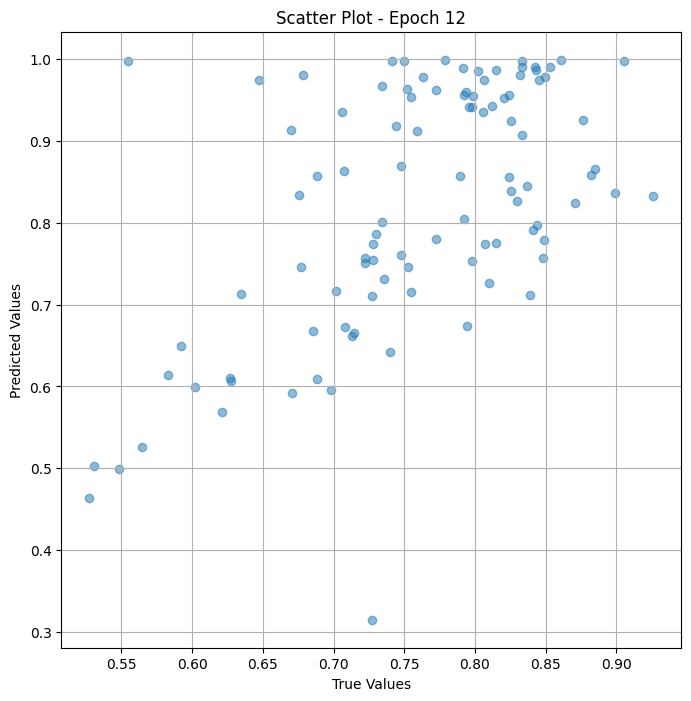


 Epoch: (13/100) Loss = 0.00010283557639922947

 Epoch: (13/100) Loss_rmse = 0.010140787810087204

 Epoch: (13/100) R^2 = 0.9600993394851685

 Epoch: (13/100) MAE = 0.007944047451019287

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

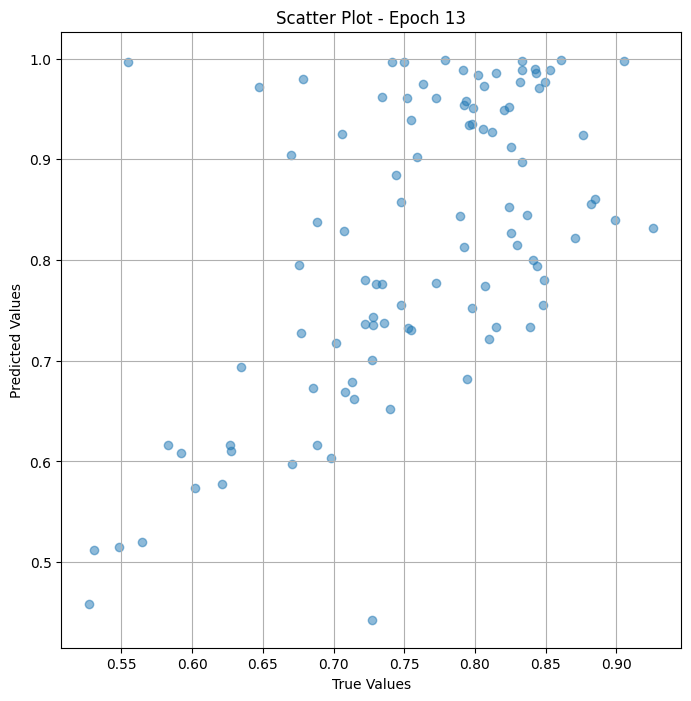


 Epoch: (14/100) Loss = 1.4492576156044379e-05

 Epoch: (14/100) Loss_rmse = 0.0038069116417318583

 Epoch: (14/100) R^2 = 0.9943768382072449

 Epoch: (14/100) MAE = 0.0026997625827789307

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

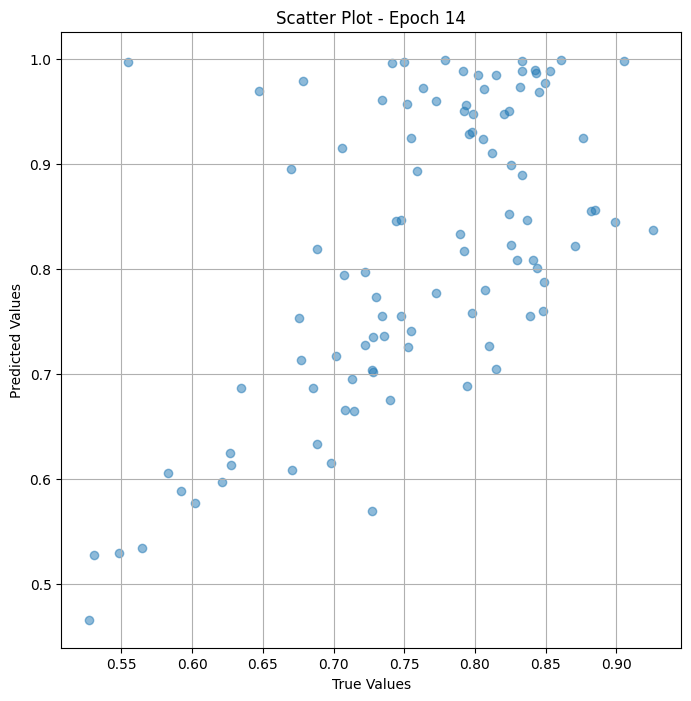


 Epoch: (15/100) Loss = 2.1232961444184184e-05

 Epoch: (15/100) Loss_rmse = 0.004607923794537783

 Epoch: (15/100) R^2 = 0.9917615056037903

 Epoch: (15/100) MAE = 0.004042878746986389

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

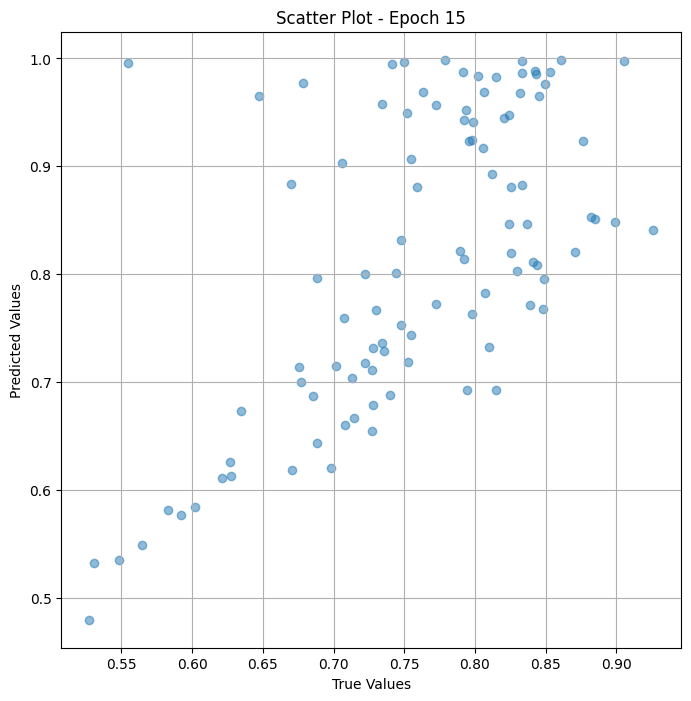


 Epoch: (16/100) Loss = 3.5255947295809165e-05

 Epoch: (16/100) Loss_rmse = 0.005937671754509211

 Epoch: (16/100) R^2 = 0.9863205552101135

 Epoch: (16/100) MAE = 0.00553363561630249

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52

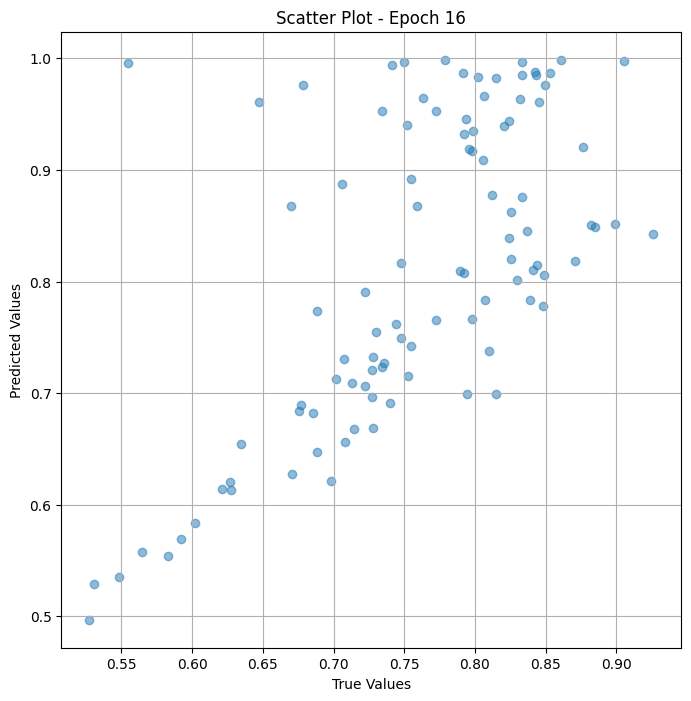


 Epoch: (17/100) Loss = 2.340177888981998e-05

 Epoch: (17/100) Loss_rmse = 0.004837538581341505

 Epoch: (17/100) R^2 = 0.9909200072288513

 Epoch: (17/100) MAE = 0.004722297191619873

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52

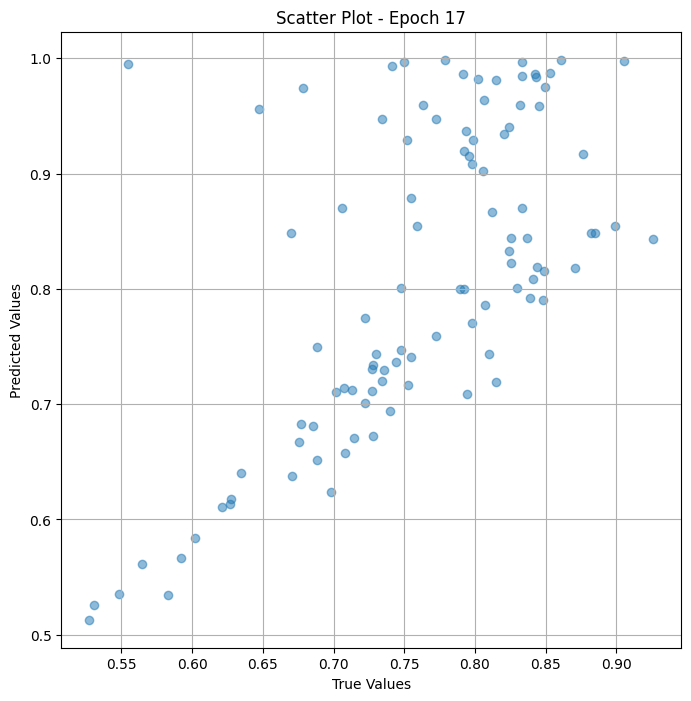


 Epoch: (18/100) Loss = 7.701169124629814e-06

 Epoch: (18/100) Loss_rmse = 0.0027750979643315077

 Epoch: (18/100) R^2 = 0.9970118999481201

 Epoch: (18/100) MAE = 0.002712547779083252

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

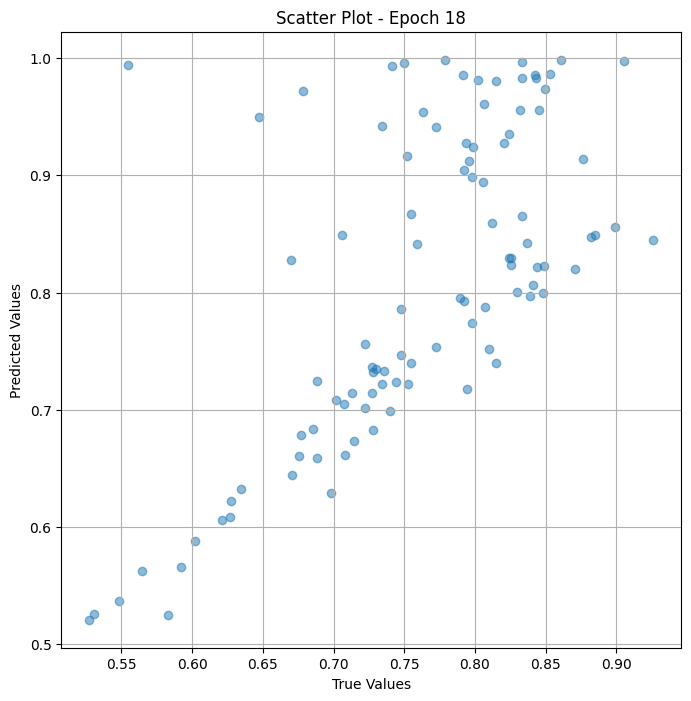


 Epoch: (19/100) Loss = 4.117585831409087e-06

 Epoch: (19/100) Loss_rmse = 0.002029183553531766

 Epoch: (19/100) R^2 = 0.9984023571014404

 Epoch: (19/100) MAE = 0.0019491314888000488

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

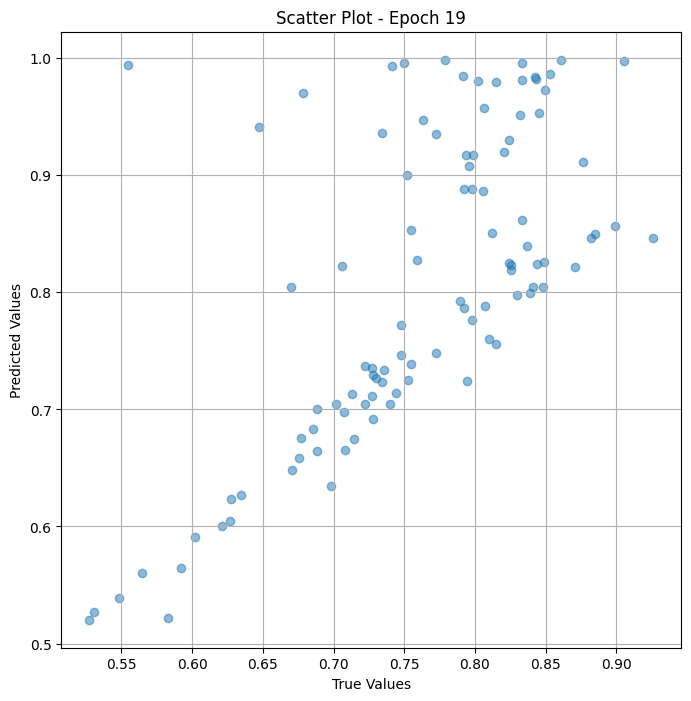


 Epoch: (20/100) Loss = 7.356971764238551e-06

 Epoch: (20/100) Loss_rmse = 0.0027123738545924425

 Epoch: (20/100) R^2 = 0.9971454739570618

 Epoch: (20/100) MAE = 0.0025323331356048584

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

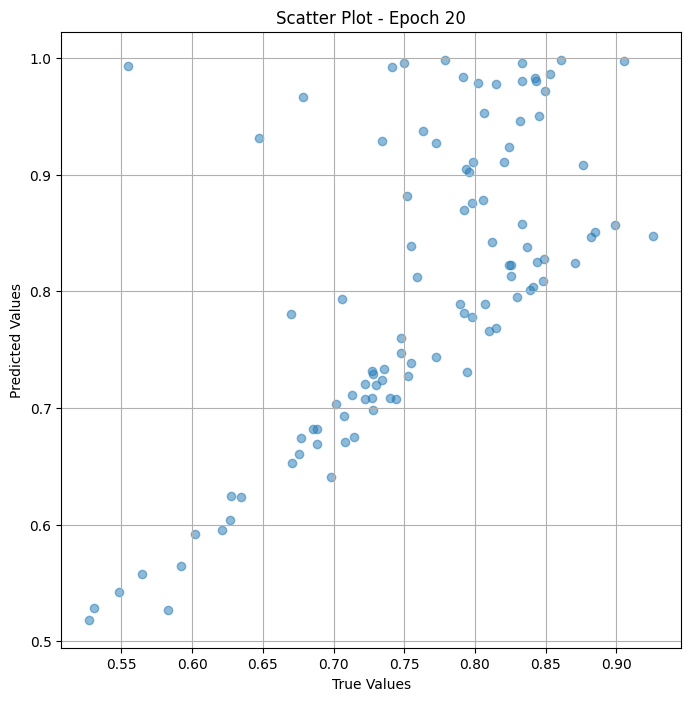


 Epoch: (21/100) Loss = 1.2911569683637936e-05

 Epoch: (21/100) Loss_rmse = 0.003593267174437642

 Epoch: (21/100) R^2 = 0.9949902296066284

 Epoch: (21/100) MAE = 0.0034943968057632446

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

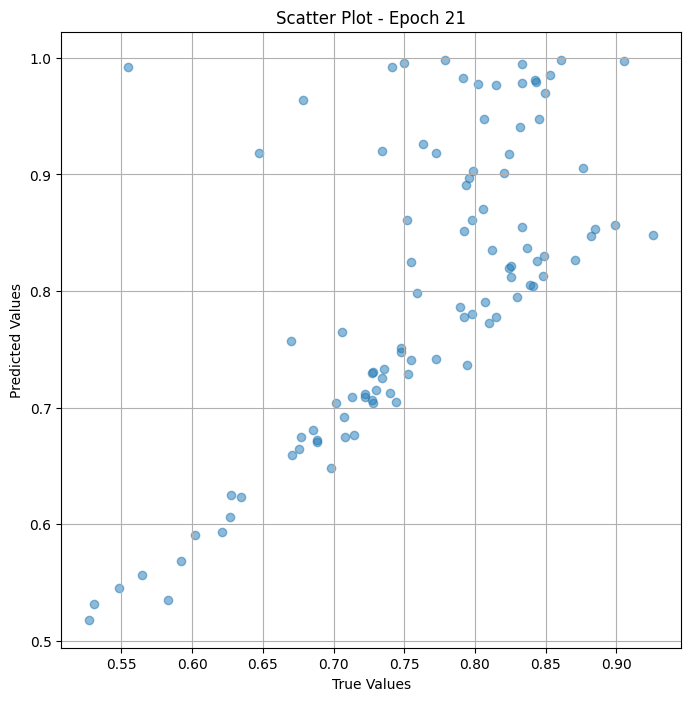


 Epoch: (22/100) Loss = 1.801161670300644e-05

 Epoch: (22/100) Loss_rmse = 0.0042440094985067844

 Epoch: (22/100) R^2 = 0.9930114150047302

 Epoch: (22/100) MAE = 0.004085749387741089

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

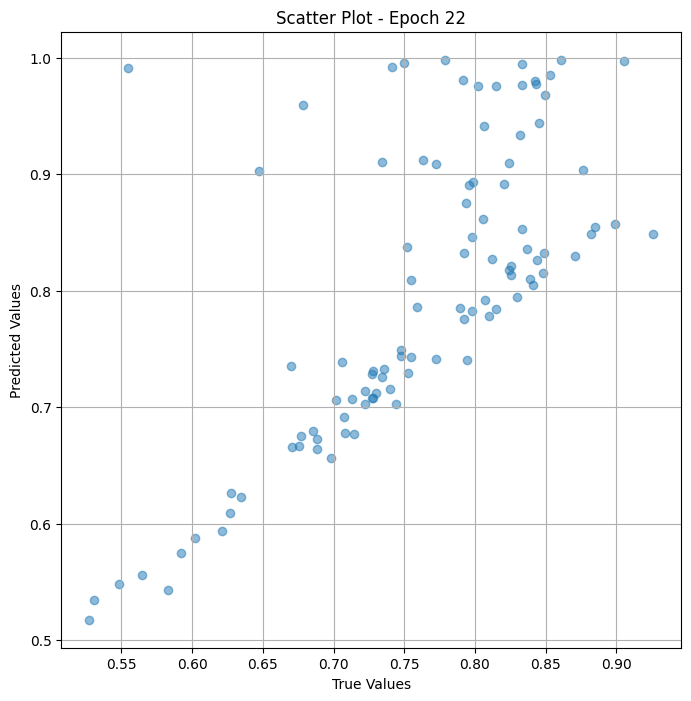


 Epoch: (23/100) Loss = 1.9201994291506708e-05

 Epoch: (23/100) Loss_rmse = 0.004382008221000433

 Epoch: (23/100) R^2 = 0.9925495386123657

 Epoch: (23/100) MAE = 0.004066571593284607

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

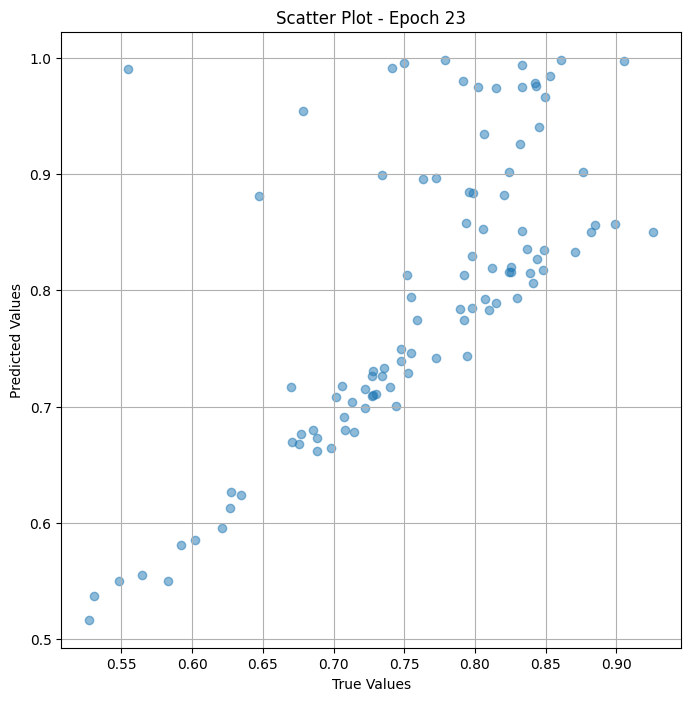


 Epoch: (24/100) Loss = 1.8475508113624528e-05

 Epoch: (24/100) Loss_rmse = 0.004298314452171326

 Epoch: (24/100) R^2 = 0.9928314089775085

 Epoch: (24/100) MAE = 0.00377105176448822

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52

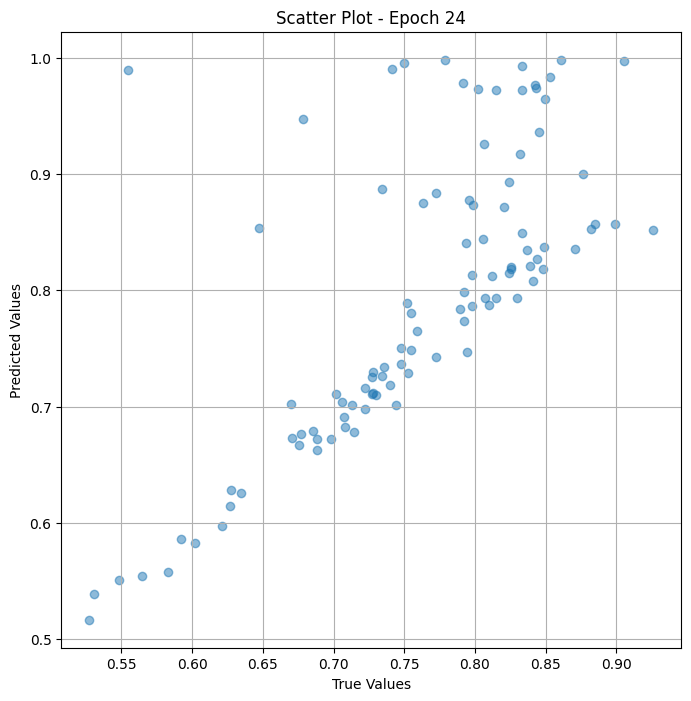


 Epoch: (25/100) Loss = 1.8427757822792046e-05

 Epoch: (25/100) Loss_rmse = 0.0042927563190460205

 Epoch: (25/100) R^2 = 0.9928499460220337

 Epoch: (25/100) MAE = 0.0035314559936523438

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

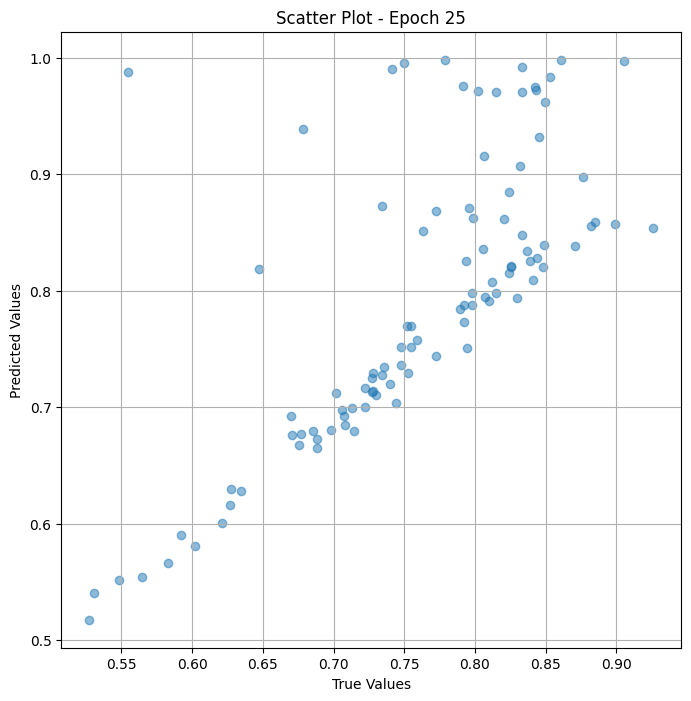


 Epoch: (26/100) Loss = 1.7331154595012777e-05

 Epoch: (26/100) Loss_rmse = 0.004163070116192102

 Epoch: (26/100) R^2 = 0.9932754635810852

 Epoch: (26/100) MAE = 0.0032513290643692017

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

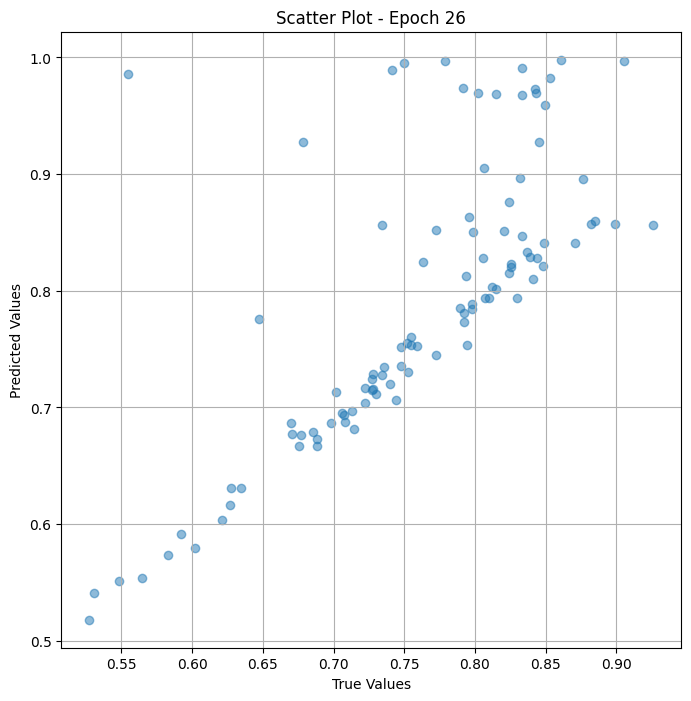


 Epoch: (27/100) Loss = 1.3794679944112431e-05

 Epoch: (27/100) Loss_rmse = 0.0037141190841794014

 Epoch: (27/100) R^2 = 0.9946476221084595

 Epoch: (27/100) MAE = 0.0028336048126220703

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

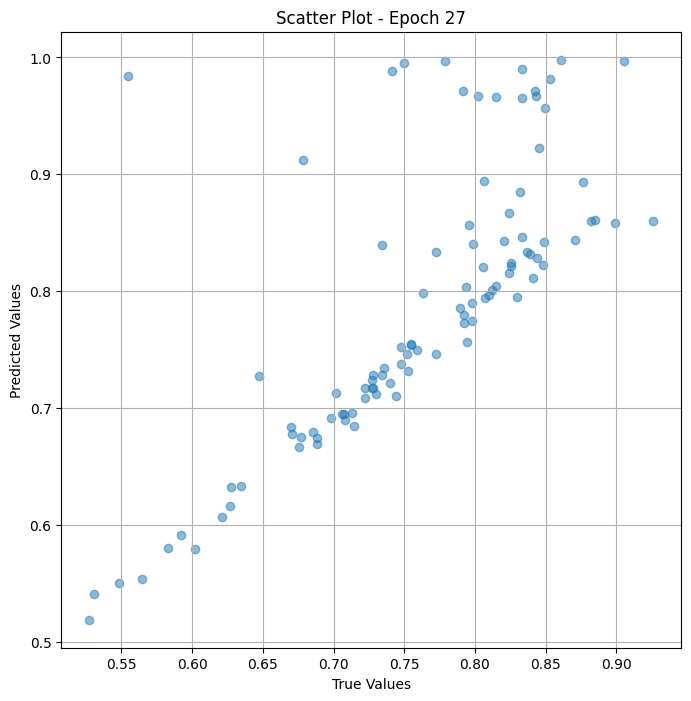


 Epoch: (28/100) Loss = 1.0335736078559421e-05

 Epoch: (28/100) Loss_rmse = 0.0032149238977581263

 Epoch: (28/100) R^2 = 0.9959896802902222

 Epoch: (28/100) MAE = 0.0024792253971099854

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

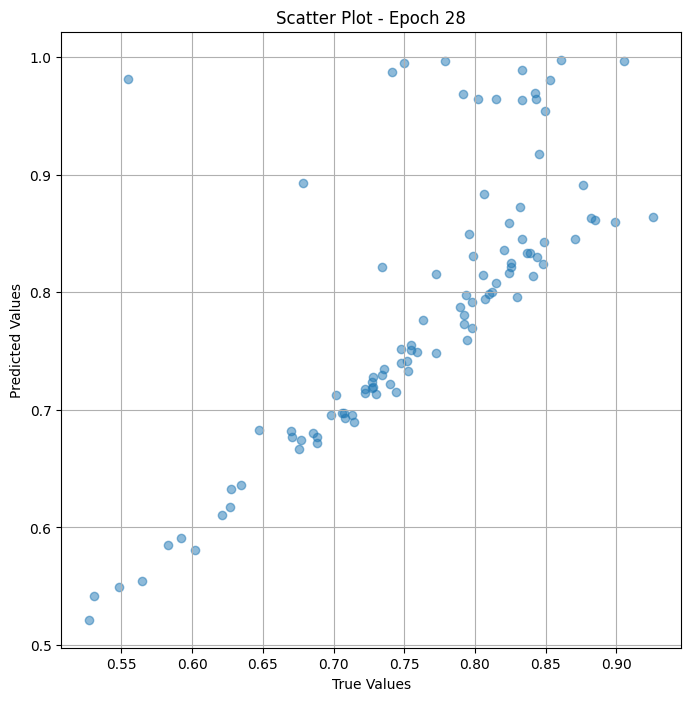


 Epoch: (29/100) Loss = 7.948208804009482e-06

 Epoch: (29/100) Loss_rmse = 0.0028192568570375443

 Epoch: (29/100) R^2 = 0.9969160556793213

 Epoch: (29/100) MAE = 0.0022680163383483887

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

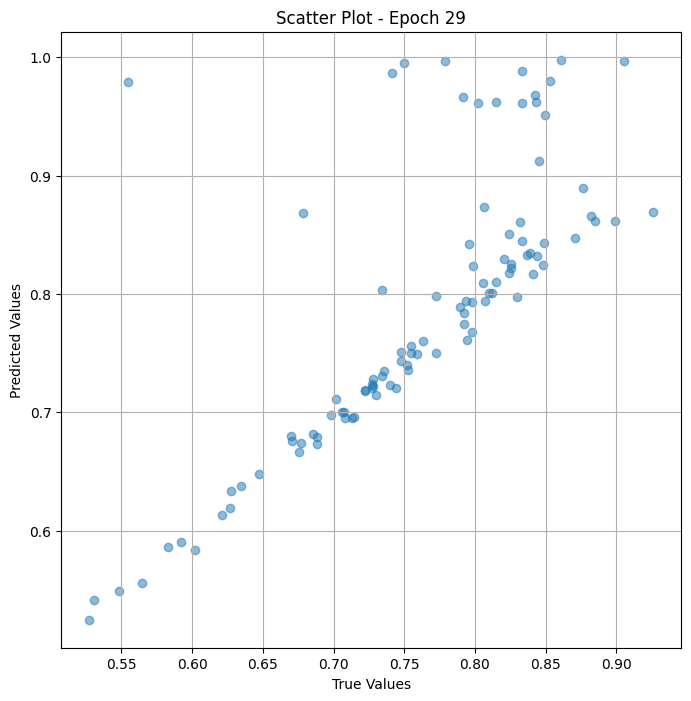


 Epoch: (30/100) Loss = 6.273028702707961e-06

 Epoch: (30/100) Loss_rmse = 0.0025046016089618206

 Epoch: (30/100) R^2 = 0.9975660443305969

 Epoch: (30/100) MAE = 0.002177700400352478

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

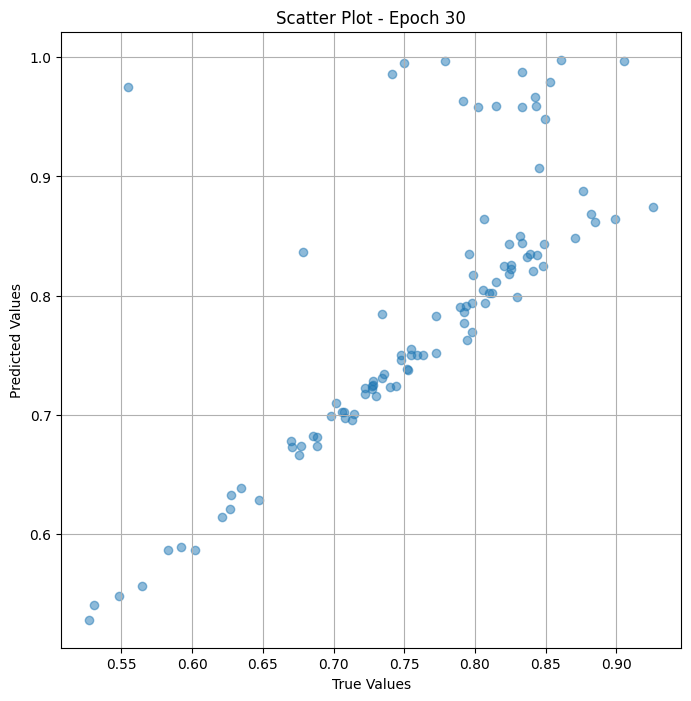


 Epoch: (31/100) Loss = 5.260578745946987e-06

 Epoch: (31/100) Loss_rmse = 0.002293595112860203

 Epoch: (31/100) R^2 = 0.9979588985443115

 Epoch: (31/100) MAE = 0.002054080367088318

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52

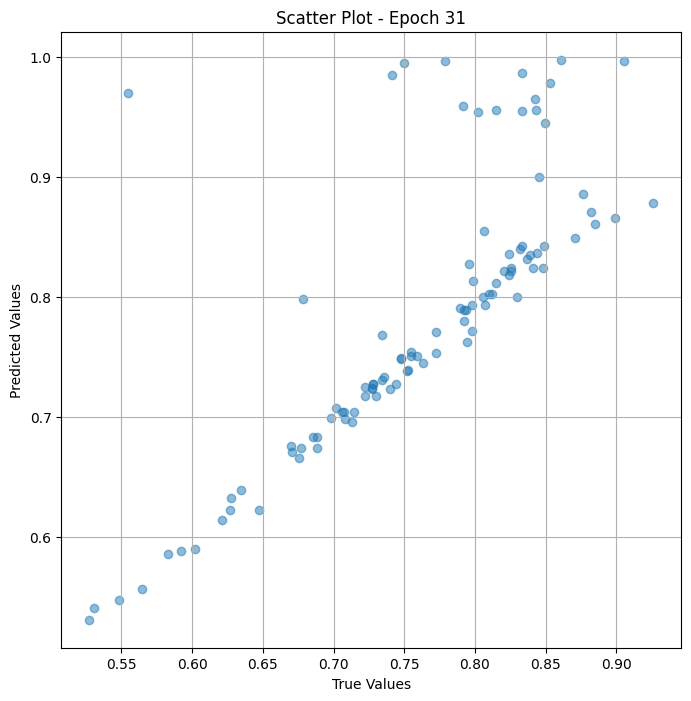


 Epoch: (32/100) Loss = 4.350549716036767e-06

 Epoch: (32/100) Loss_rmse = 0.002085797255858779

 Epoch: (32/100) R^2 = 0.9983119964599609

 Epoch: (32/100) MAE = 0.0017746537923812866

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

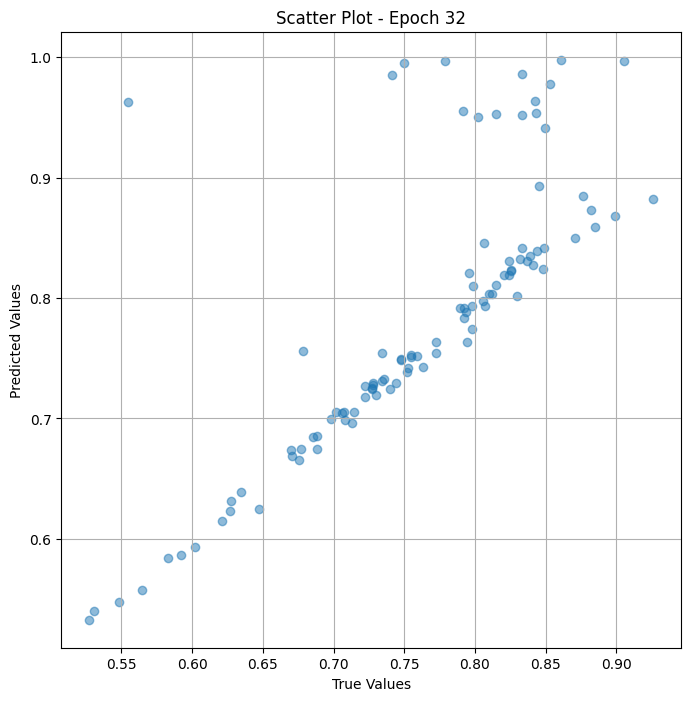


 Epoch: (33/100) Loss = 3.422830786803388e-06

 Epoch: (33/100) Loss_rmse = 0.0018500894075259566

 Epoch: (33/100) R^2 = 0.9986719489097595

 Epoch: (33/100) MAE = 0.001336708664894104

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

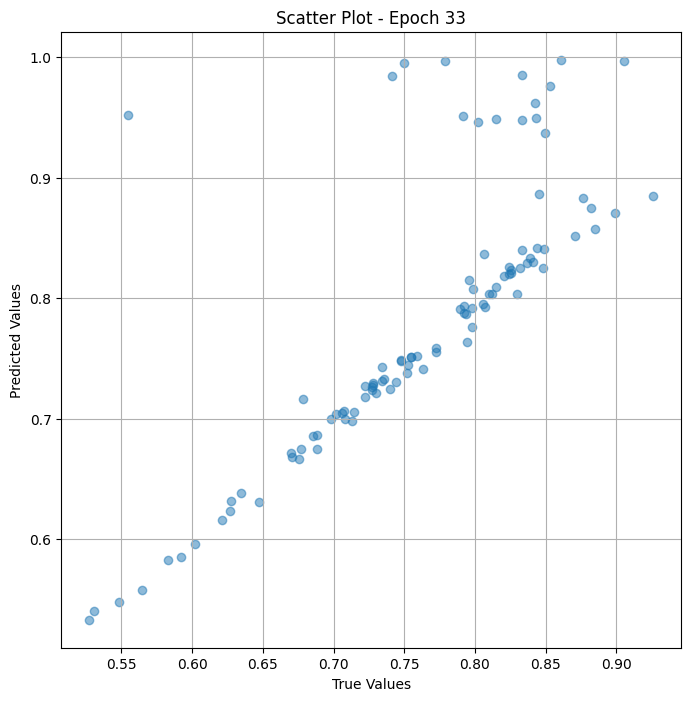


 Epoch: (34/100) Loss = 3.889577783411369e-06

 Epoch: (34/100) Loss_rmse = 0.001972201280295849

 Epoch: (34/100) R^2 = 0.9984908103942871

 Epoch: (34/100) MAE = 0.0013352632522583008

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

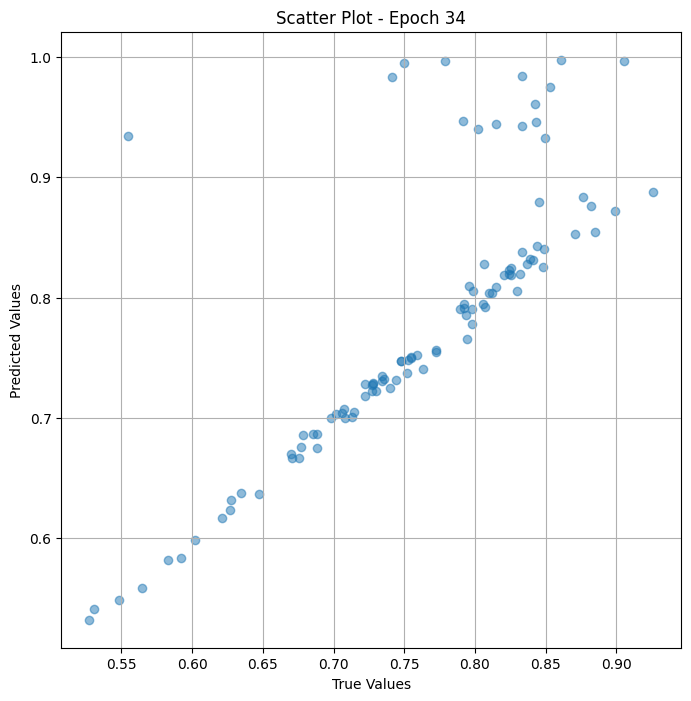


 Epoch: (35/100) Loss = 7.184219157352345e-06

 Epoch: (35/100) Loss_rmse = 0.0026803393848240376

 Epoch: (35/100) R^2 = 0.9972124695777893

 Epoch: (35/100) MAE = 0.0019143074750900269

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

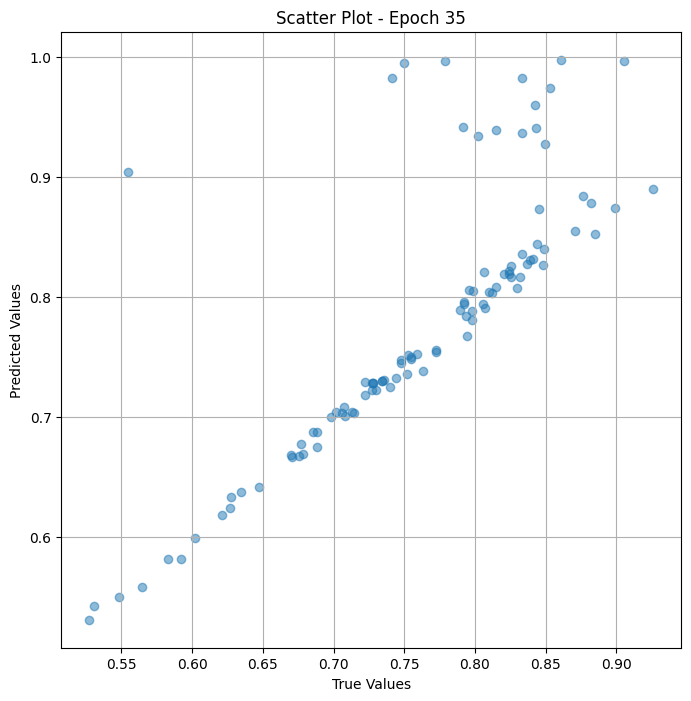


 Epoch: (36/100) Loss = 1.25547667266801e-05

 Epoch: (36/100) Loss_rmse = 0.003543270519003272

 Epoch: (36/100) R^2 = 0.9951286911964417

 Epoch: (36/100) MAE = 0.0026296675205230713

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52

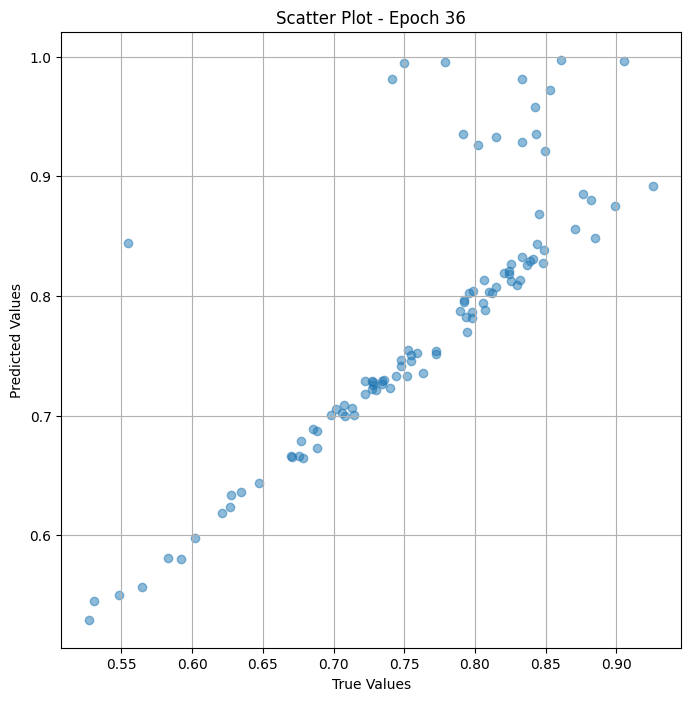


 Epoch: (37/100) Loss = 1.2375995538604911e-05

 Epoch: (37/100) Loss_rmse = 0.0035179532133042812

 Epoch: (37/100) R^2 = 0.9951980710029602

 Epoch: (37/100) MAE = 0.002841085195541382

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

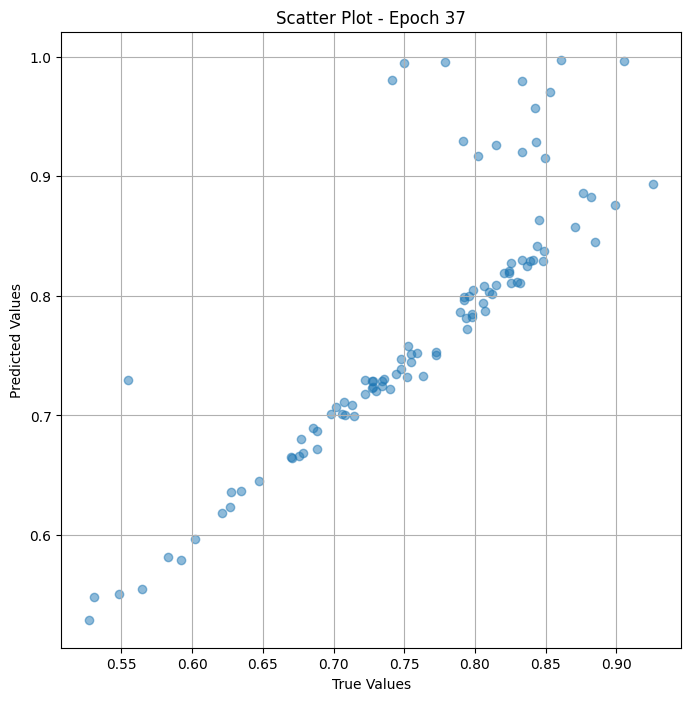


 Epoch: (38/100) Loss = 3.234423957110266e-06

 Epoch: (38/100) Loss_rmse = 0.001798450481146574

 Epoch: (38/100) R^2 = 0.9987450242042542

 Epoch: (38/100) MAE = 0.0014570802450180054

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

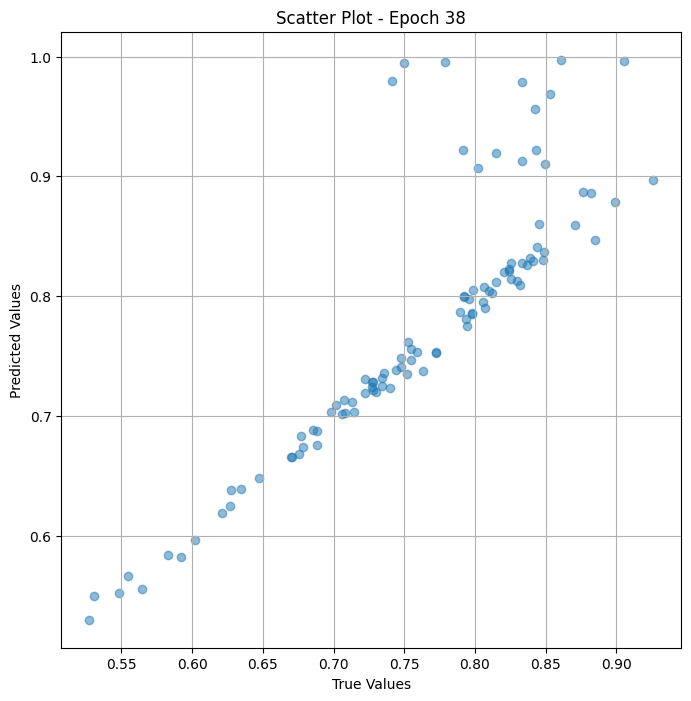


 Epoch: (39/100) Loss = 5.866510491614463e-06

 Epoch: (39/100) Loss_rmse = 0.0024220880586653948

 Epoch: (39/100) R^2 = 0.9977237582206726

 Epoch: (39/100) MAE = 0.0022743791341781616

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

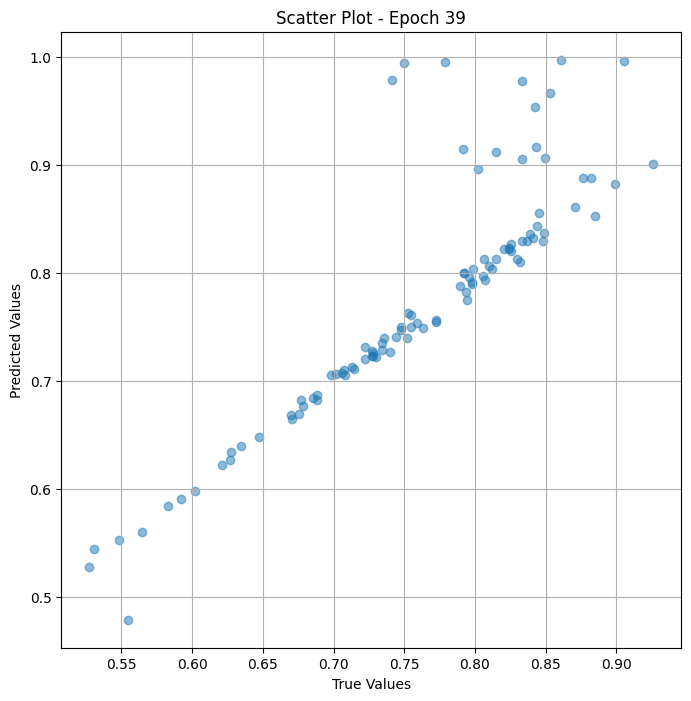


 Epoch: (40/100) Loss = 6.570888217538595e-06

 Epoch: (40/100) Loss_rmse = 0.002563374349847436

 Epoch: (40/100) R^2 = 0.9974504709243774

 Epoch: (40/100) MAE = 0.0025505274534225464

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

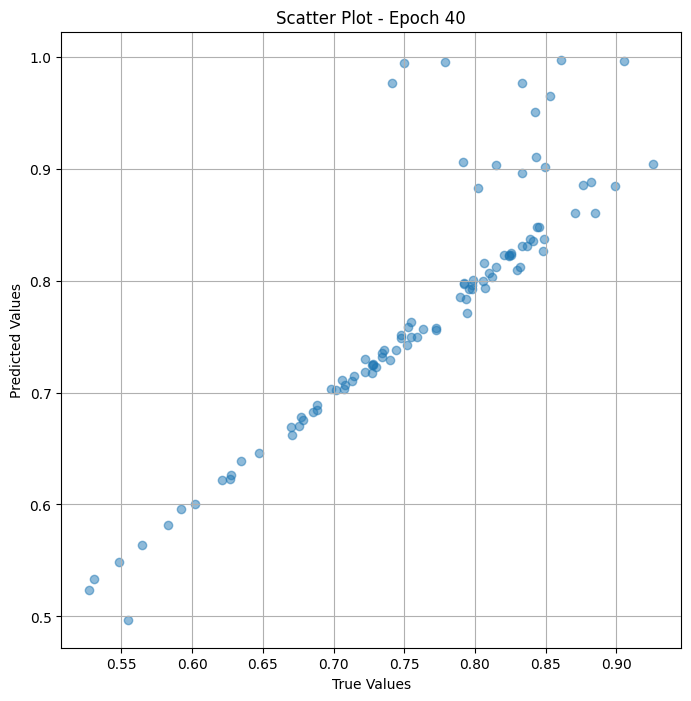


 Epoch: (41/100) Loss = 3.7565807815553853e-06

 Epoch: (41/100) Loss_rmse = 0.0019381900783628225

 Epoch: (41/100) R^2 = 0.9985424280166626

 Epoch: (41/100) MAE = 0.001338660717010498

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

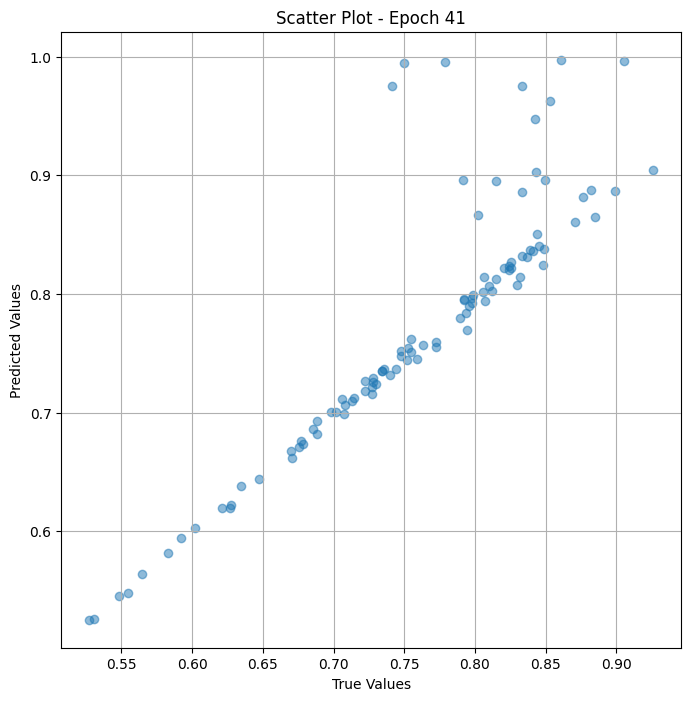


 Epoch: (42/100) Loss = 2.8589702196768485e-06

 Epoch: (42/100) Loss_rmse = 0.0016908489633351564

 Epoch: (42/100) R^2 = 0.9988906979560852

 Epoch: (42/100) MAE = 0.0015030503273010254

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

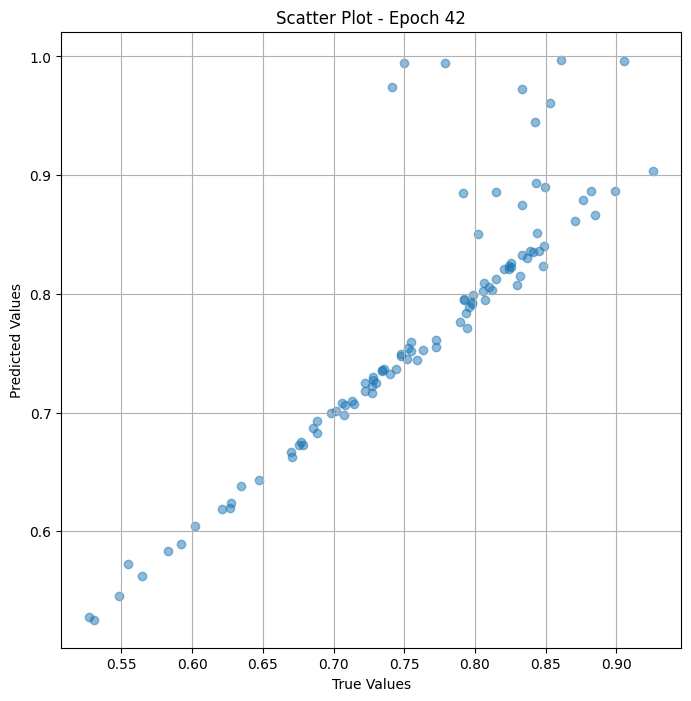


 Epoch: (43/100) Loss = 3.002333528456802e-07

 Epoch: (43/100) Loss_rmse = 0.0005479355459101498

 Epoch: (43/100) R^2 = 0.9998835325241089

 Epoch: (43/100) MAE = 0.00039623677730560303

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

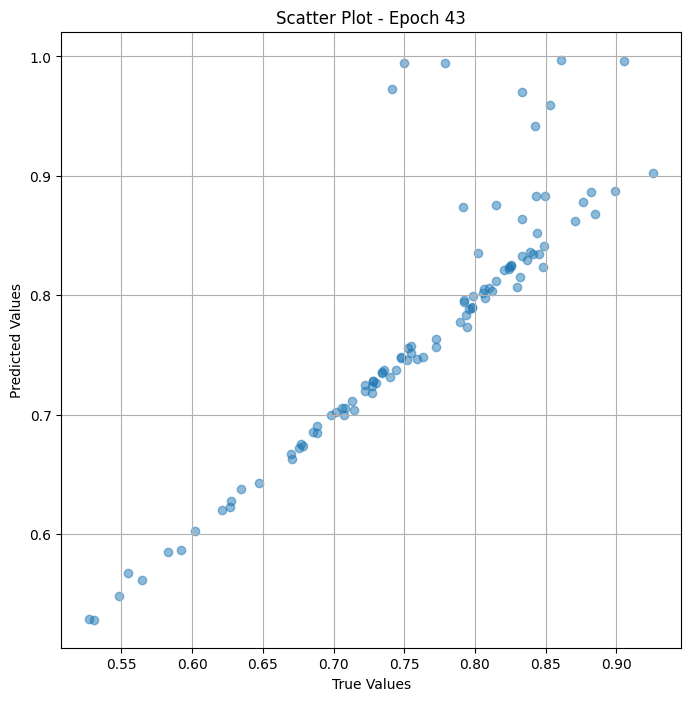


 Epoch: (44/100) Loss = 8.43637167236011e-07

 Epoch: (44/100) Loss_rmse = 0.0009184972150251269

 Epoch: (44/100) R^2 = 0.9996726512908936

 Epoch: (44/100) MAE = 0.0008694976568222046

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

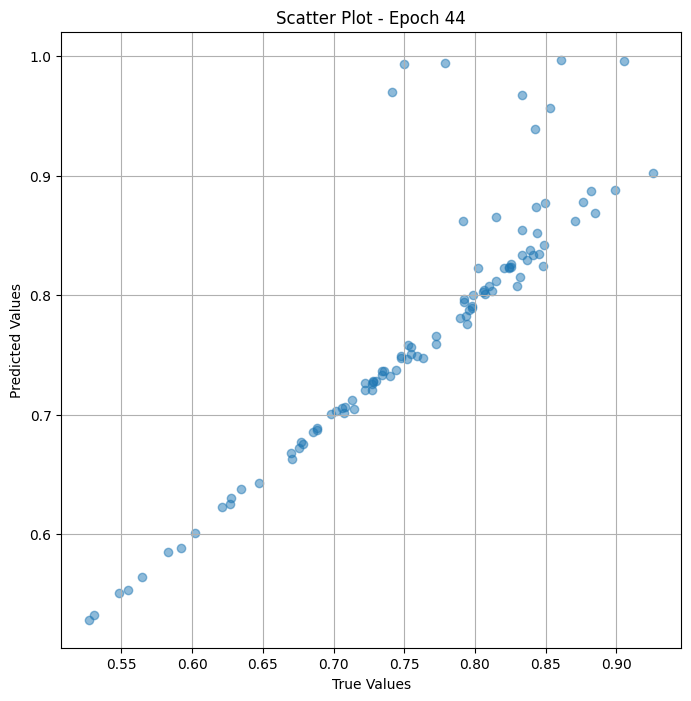


 Epoch: (45/100) Loss = 5.975969656901725e-07

 Epoch: (45/100) Loss_rmse = 0.0007730439538136125

 Epoch: (45/100) R^2 = 0.9997681379318237

 Epoch: (45/100) MAE = 0.0006385743618011475

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

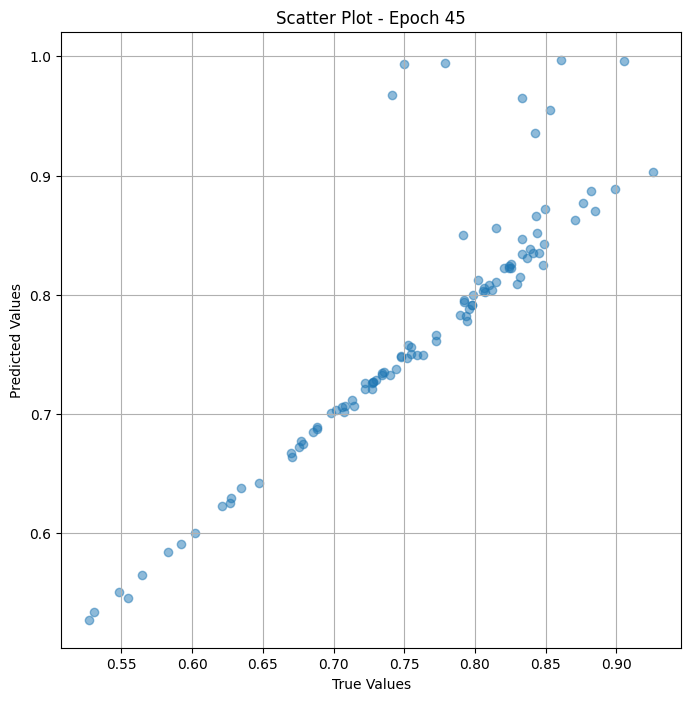


 Epoch: (46/100) Loss = 2.563380689935002e-07

 Epoch: (46/100) Loss_rmse = 0.0005062983836978674

 Epoch: (46/100) R^2 = 0.9999005198478699

 Epoch: (46/100) MAE = 0.0004648864269256592

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

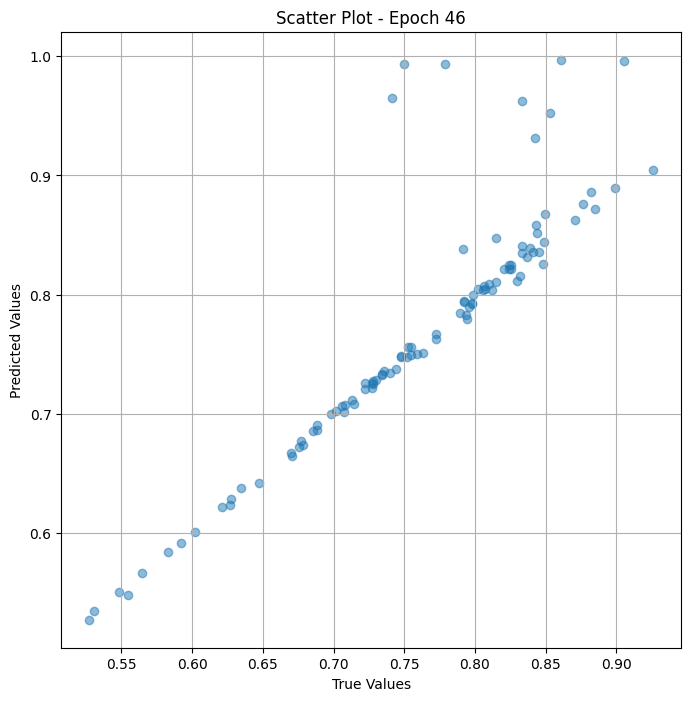


 Epoch: (47/100) Loss = 3.5814508692055824e-07

 Epoch: (47/100) Loss_rmse = 0.0005984522285871208

 Epoch: (47/100) R^2 = 0.9998610615730286

 Epoch: (47/100) MAE = 0.000504419207572937

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

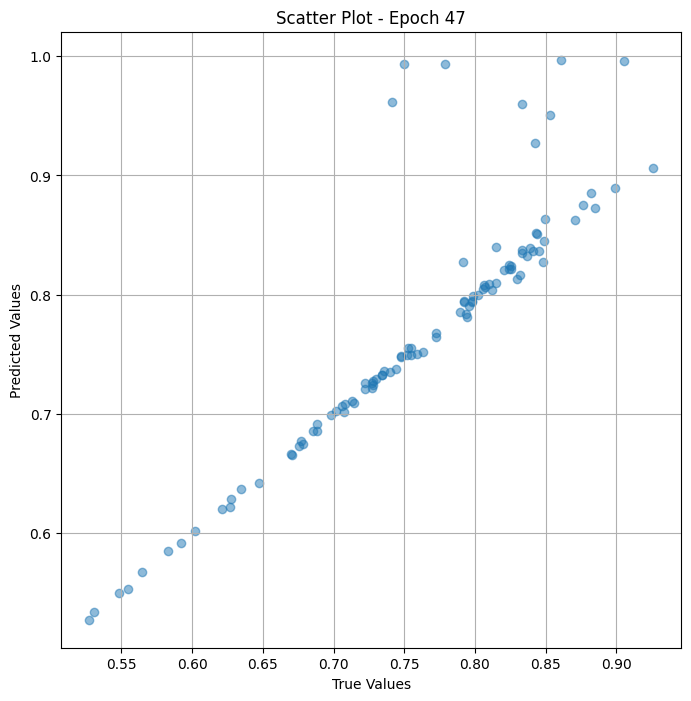


 Epoch: (48/100) Loss = 3.974804485551431e-07

 Epoch: (48/100) Loss_rmse = 0.0006304605049081147

 Epoch: (48/100) R^2 = 0.9998458027839661

 Epoch: (48/100) MAE = 0.0005648881196975708

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

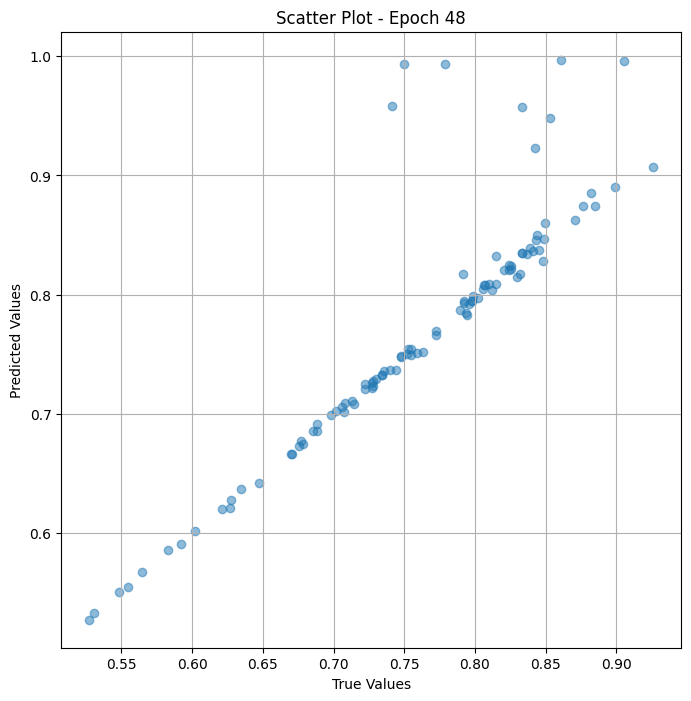


 Epoch: (49/100) Loss = 3.964183292737289e-07

 Epoch: (49/100) Loss_rmse = 0.0006296175997704268

 Epoch: (49/100) R^2 = 0.9998461604118347

 Epoch: (49/100) MAE = 0.0005106478929519653

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

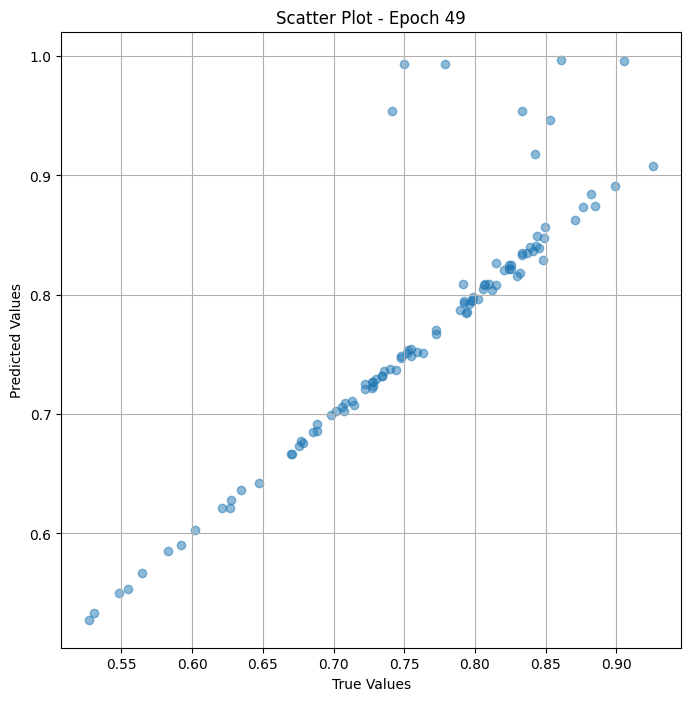


 Epoch: (50/100) Loss = 4.553272674456821e-07

 Epoch: (50/100) Loss_rmse = 0.0006747794104740024

 Epoch: (50/100) R^2 = 0.9998233318328857

 Epoch: (50/100) MAE = 0.0005376338958740234

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

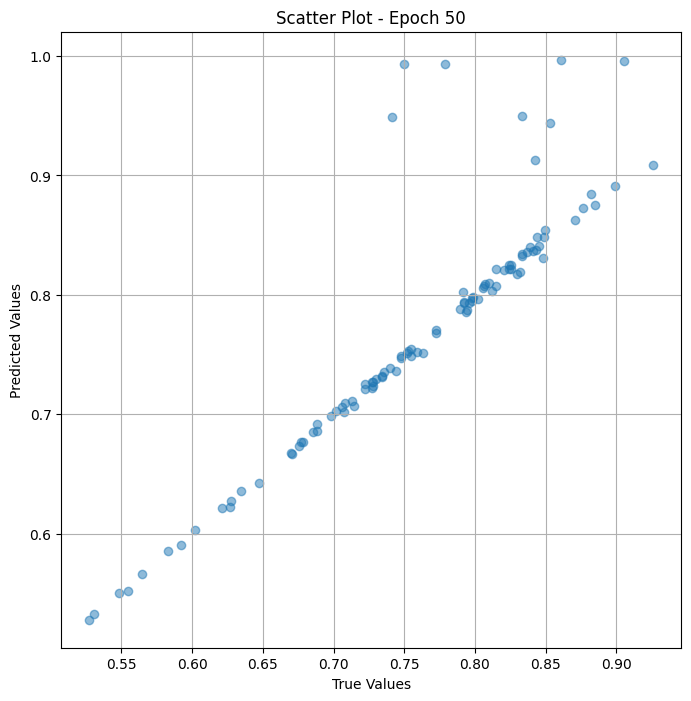


 Epoch: (51/100) Loss = 4.744499335629371e-07

 Epoch: (51/100) Loss_rmse = 0.0006888032658025622

 Epoch: (51/100) R^2 = 0.9998159408569336

 Epoch: (51/100) MAE = 0.0005107969045639038

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

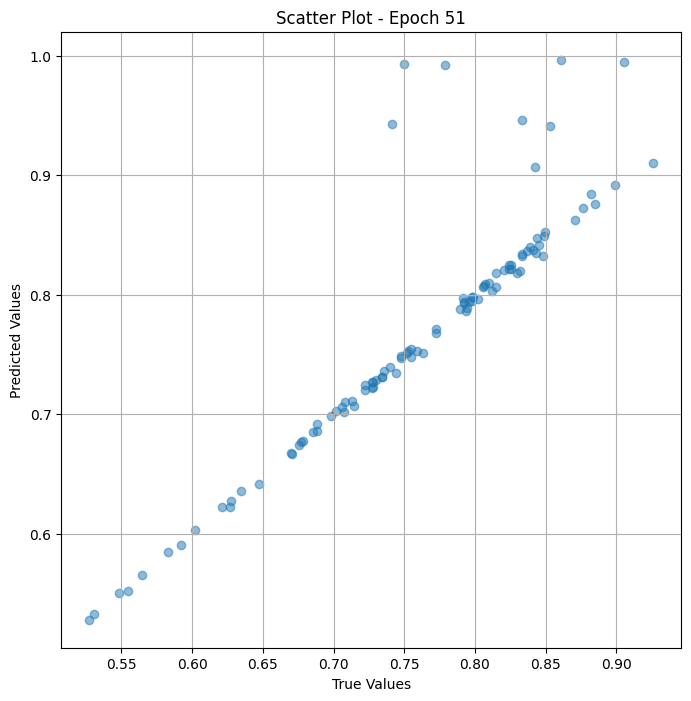


 Epoch: (52/100) Loss = 5.341161113392445e-07

 Epoch: (52/100) Loss_rmse = 0.0007308324566110969

 Epoch: (52/100) R^2 = 0.999792754650116

 Epoch: (52/100) MAE = 0.0005251020193099976

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

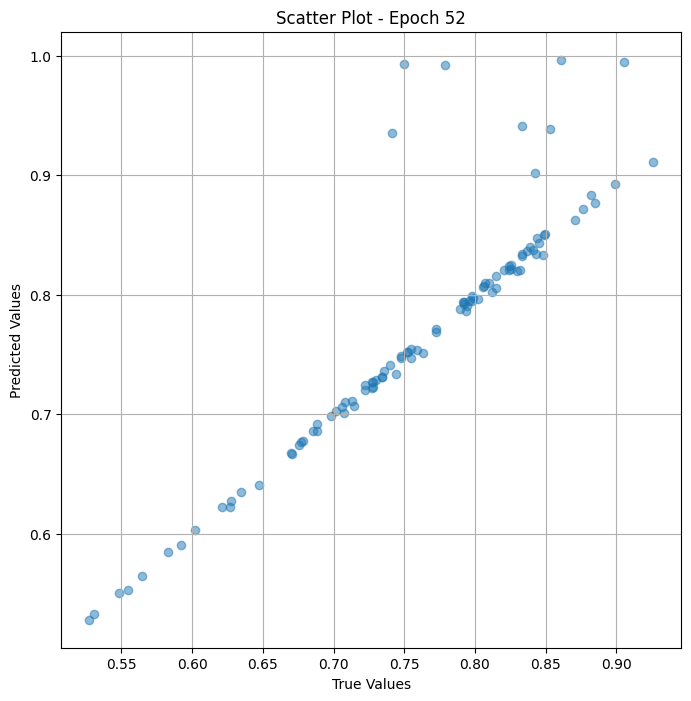


 Epoch: (53/100) Loss = 6.220499813025526e-07

 Epoch: (53/100) Loss_rmse = 0.0007887014653533697

 Epoch: (53/100) R^2 = 0.9997586607933044

 Epoch: (53/100) MAE = 0.0005600303411483765

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

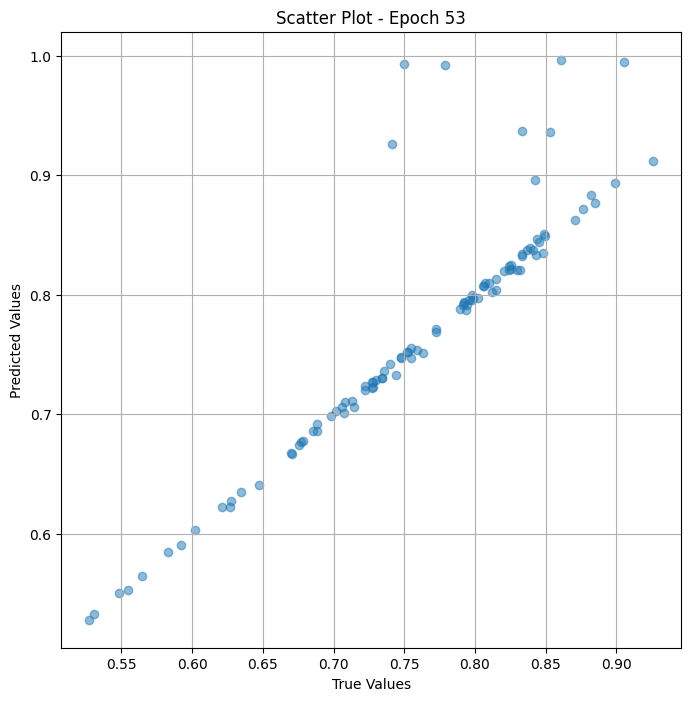


 Epoch: (54/100) Loss = 6.918259032318019e-07

 Epoch: (54/100) Loss_rmse = 0.0008317606989294291

 Epoch: (54/100) R^2 = 0.9997315406799316

 Epoch: (54/100) MAE = 0.0005730986595153809

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

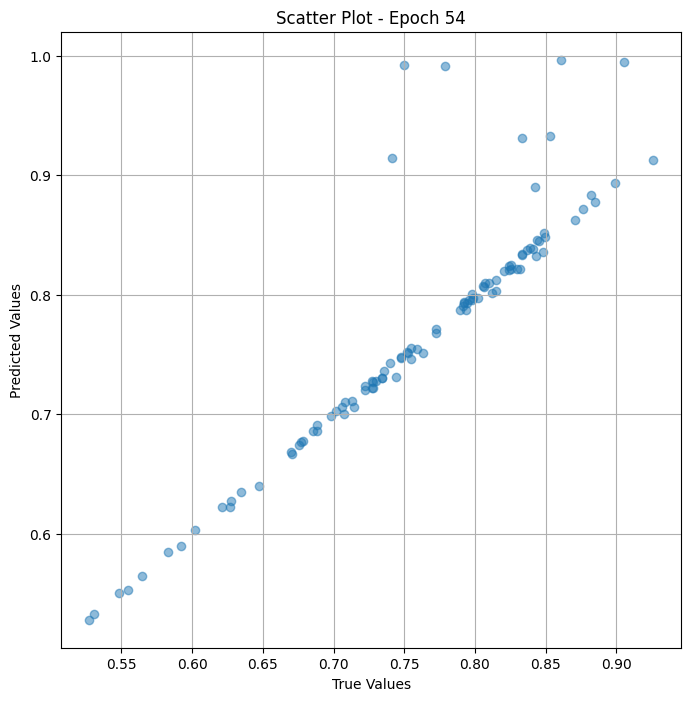


 Epoch: (55/100) Loss = 7.250622502397164e-07

 Epoch: (55/100) Loss_rmse = 0.0008515058434568346

 Epoch: (55/100) R^2 = 0.9997186660766602

 Epoch: (55/100) MAE = 0.0005674809217453003

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

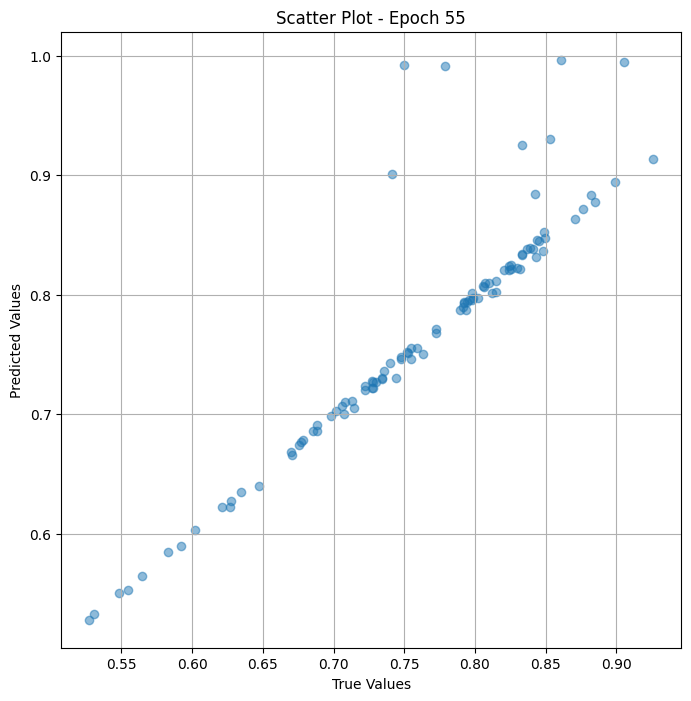


 Epoch: (56/100) Loss = 7.49540788547165e-07

 Epoch: (56/100) Loss_rmse = 0.0008657602593302727

 Epoch: (56/100) R^2 = 0.9997091889381409

 Epoch: (56/100) MAE = 0.0005650371313095093

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

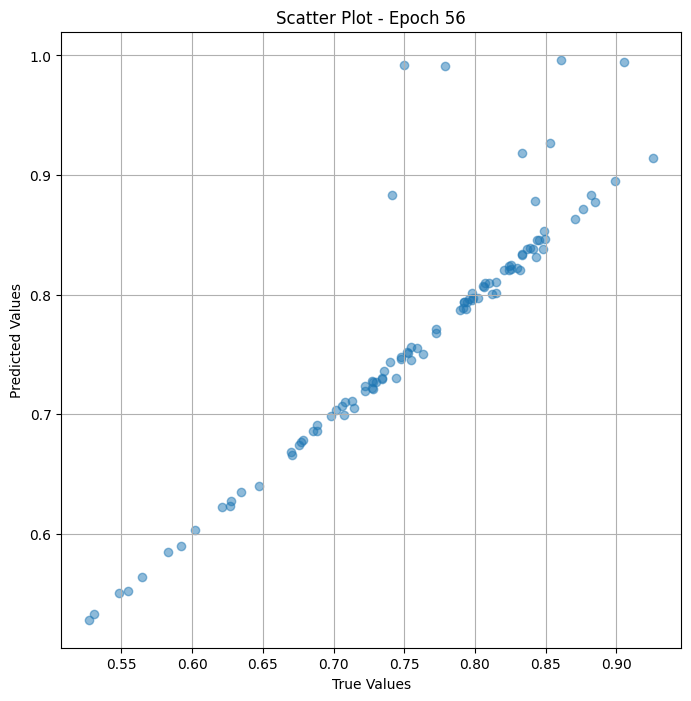


 Epoch: (57/100) Loss = 7.462655275958241e-07

 Epoch: (57/100) Loss_rmse = 0.0008638665894977748

 Epoch: (57/100) R^2 = 0.9997104406356812

 Epoch: (57/100) MAE = 0.000574752688407898

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

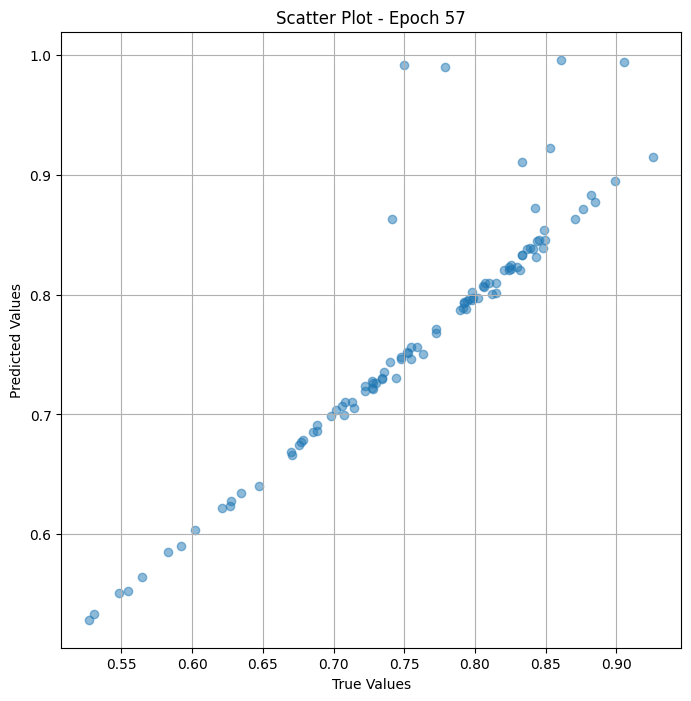


 Epoch: (58/100) Loss = 7.246819677675376e-07

 Epoch: (58/100) Loss_rmse = 0.0008512825588695705

 Epoch: (58/100) R^2 = 0.9997188448905945

 Epoch: (58/100) MAE = 0.0005841702222824097

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

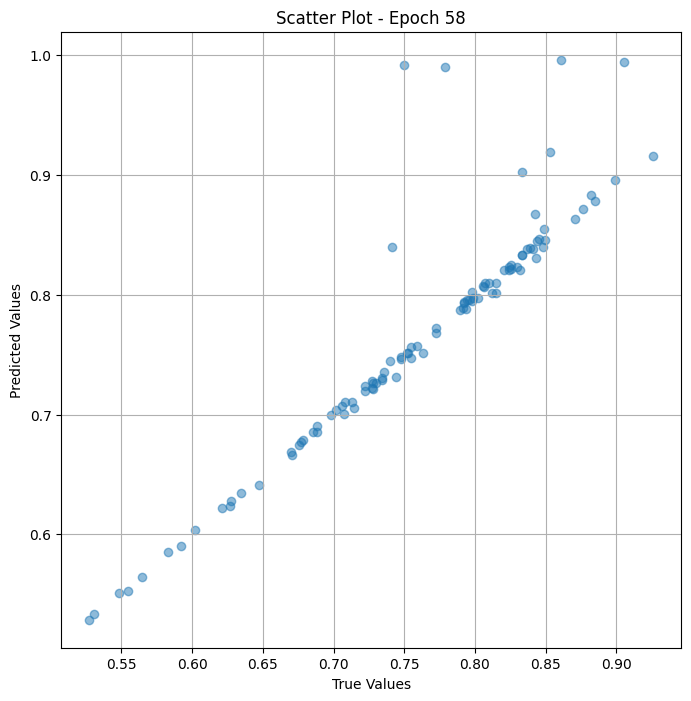


 Epoch: (59/100) Loss = 6.384575499396306e-07

 Epoch: (59/100) Loss_rmse = 0.0007990353624336421

 Epoch: (59/100) R^2 = 0.9997522830963135

 Epoch: (59/100) MAE = 0.0005732923746109009

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

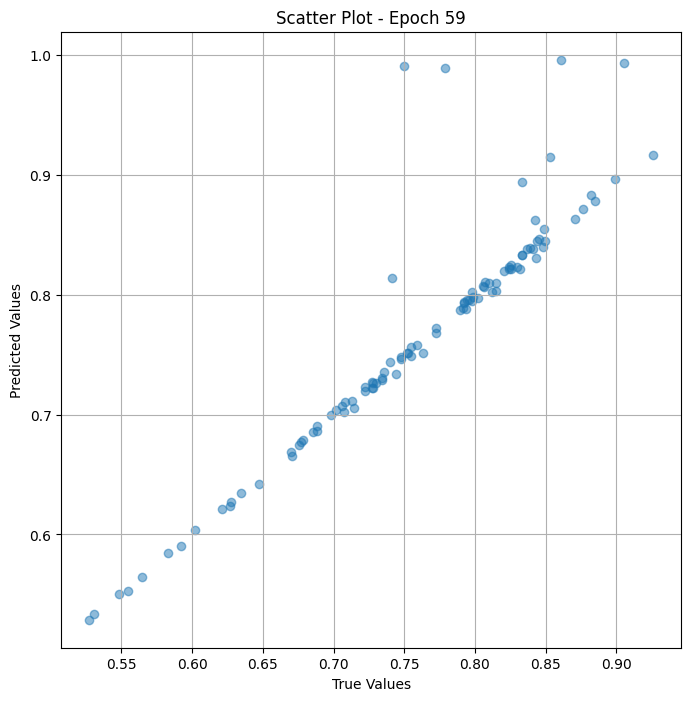


 Epoch: (60/100) Loss = 5.14047655997274e-07

 Epoch: (60/100) Loss_rmse = 0.0007169711752794683

 Epoch: (60/100) R^2 = 0.9998005628585815

 Epoch: (60/100) MAE = 0.000539824366569519

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52

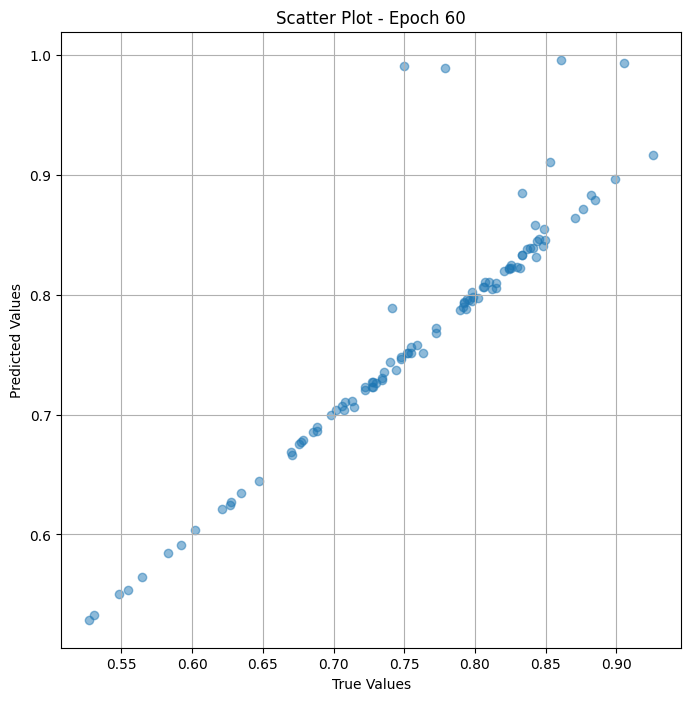


 Epoch: (61/100) Loss = 3.6556227200890135e-07

 Epoch: (61/100) Loss_rmse = 0.0006046174676157534

 Epoch: (61/100) R^2 = 0.9998581409454346

 Epoch: (61/100) MAE = 0.00048063695430755615

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 

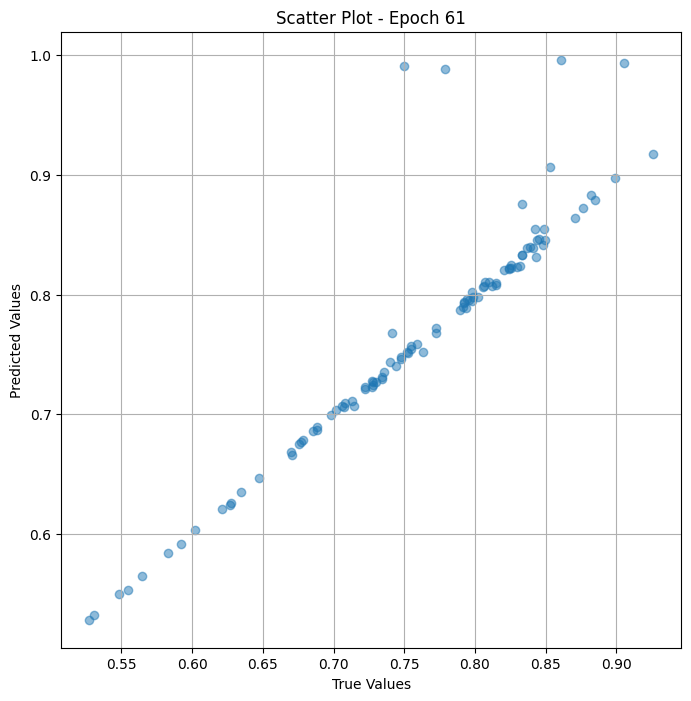


 Epoch: (62/100) Loss = 2.4349878913199063e-07

 Epoch: (62/100) Loss_rmse = 0.0004934559692628682

 Epoch: (62/100) R^2 = 0.999905526638031

 Epoch: (62/100) MAE = 0.00041510164737701416

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

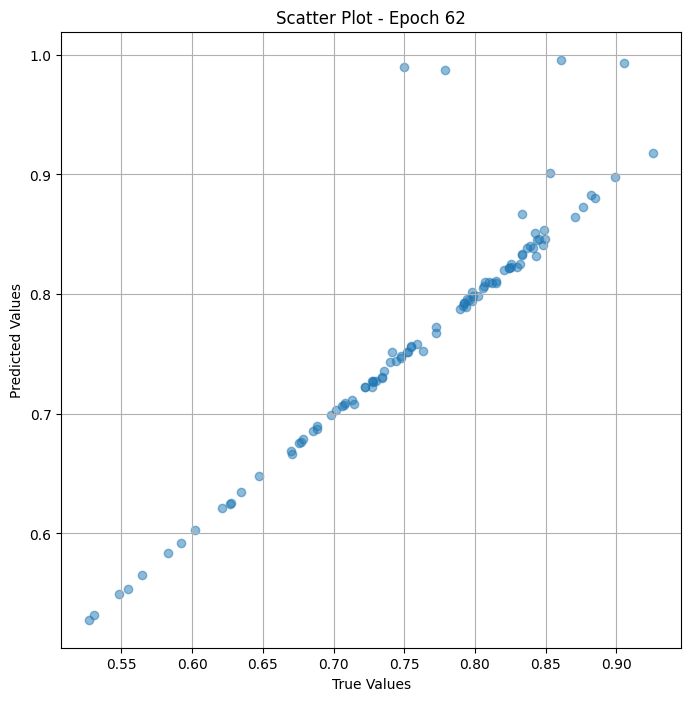


 Epoch: (63/100) Loss = 1.556836934923922e-07

 Epoch: (63/100) Loss_rmse = 0.00039456773083657026

 Epoch: (63/100) R^2 = 0.9999396204948425

 Epoch: (63/100) MAE = 0.00034043192863464355

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 

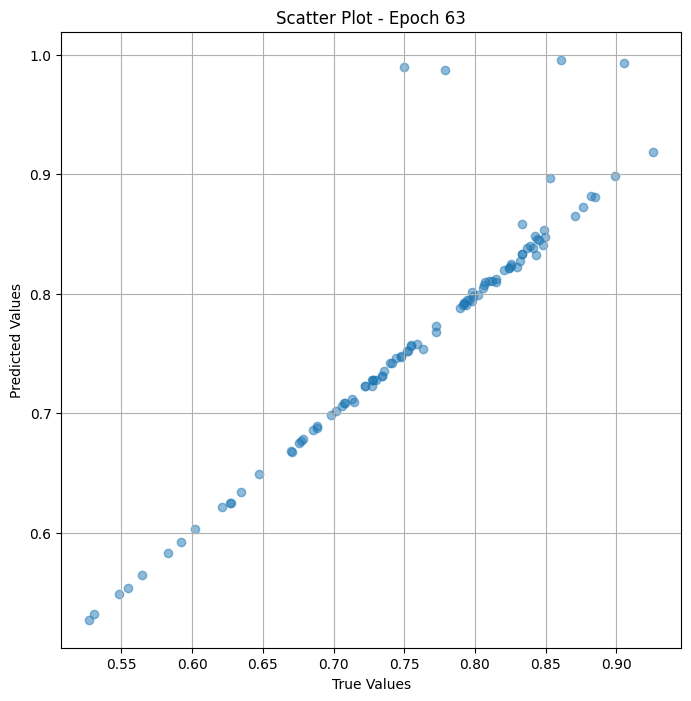


 Epoch: (64/100) Loss = 1.2084024092473555e-07

 Epoch: (64/100) Loss_rmse = 0.0003476208366919309

 Epoch: (64/100) R^2 = 0.9999530911445618

 Epoch: (64/100) MAE = 0.00029465556144714355

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 

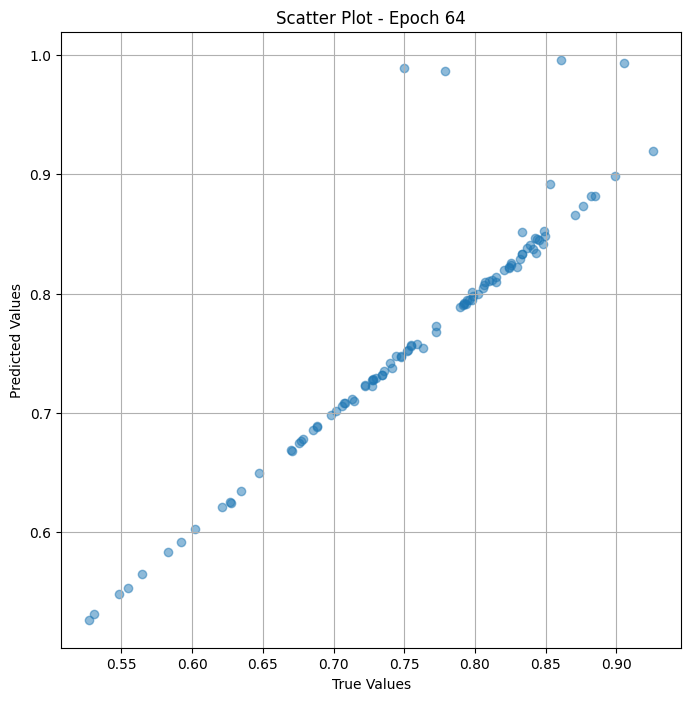


 Epoch: (65/100) Loss = 1.2341222088707582e-07

 Epoch: (65/100) Loss_rmse = 0.00035130075411871076

 Epoch: (65/100) R^2 = 0.9999521374702454

 Epoch: (65/100) MAE = 0.00029505789279937744

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427,

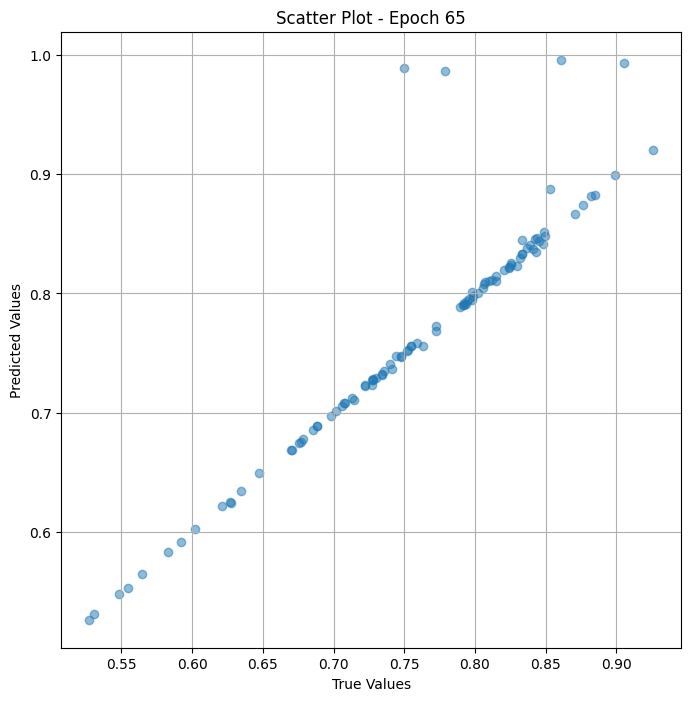


 Epoch: (66/100) Loss = 1.5527611196830549e-07

 Epoch: (66/100) Loss_rmse = 0.0003940509050153196

 Epoch: (66/100) R^2 = 0.9999397397041321

 Epoch: (66/100) MAE = 0.00033126771450042725

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 

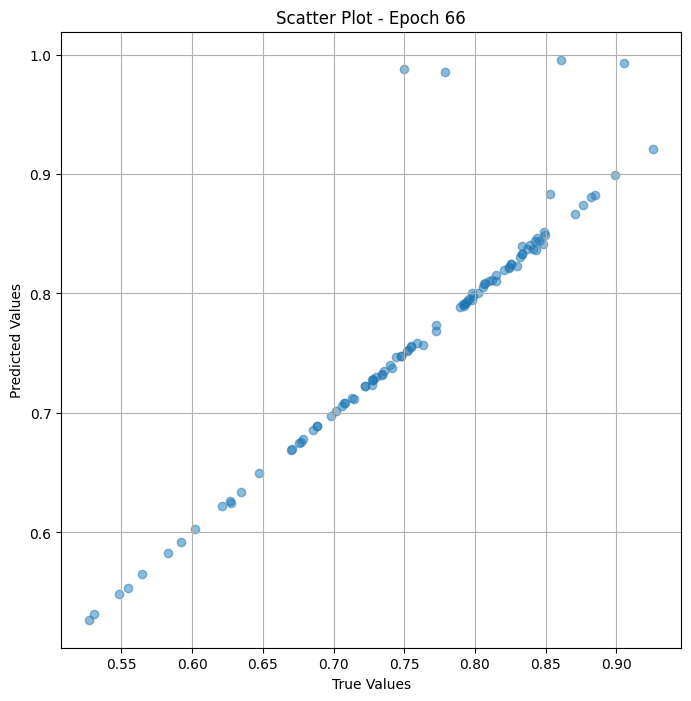


 Epoch: (67/100) Loss = 1.8312987037916173e-07

 Epoch: (67/100) Loss_rmse = 0.00042793675675056875

 Epoch: (67/100) R^2 = 0.9999289512634277

 Epoch: (67/100) MAE = 0.00035694241523742676

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427,

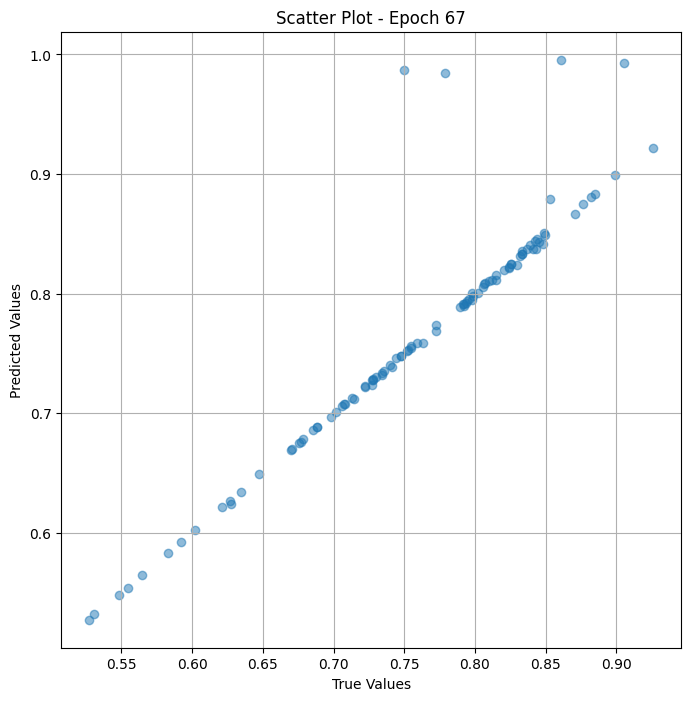


 Epoch: (68/100) Loss = 2.0996692740027356e-07

 Epoch: (68/100) Loss_rmse = 0.0004582214751280844

 Epoch: (68/100) R^2 = 0.999918520450592

 Epoch: (68/100) MAE = 0.0003753751516342163

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

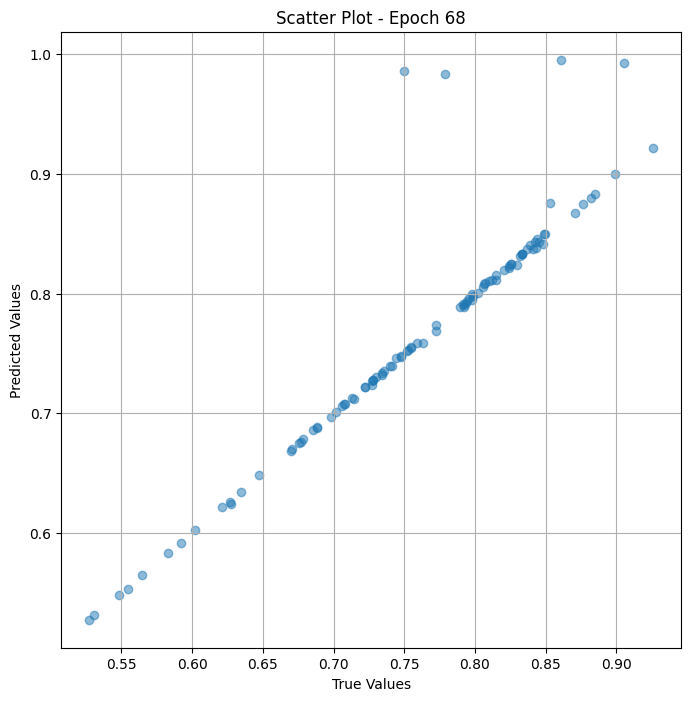


 Epoch: (69/100) Loss = 2.2796679388648045e-07

 Epoch: (69/100) Loss_rmse = 0.00047745867050252855

 Epoch: (69/100) R^2 = 0.9999115467071533

 Epoch: (69/100) MAE = 0.00038073956966400146

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427,

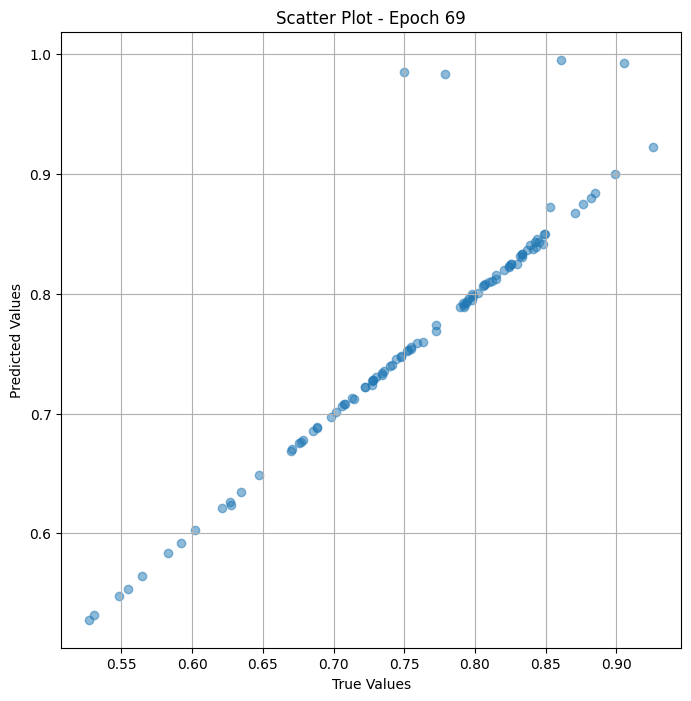


 Epoch: (70/100) Loss = 2.489366011104721e-07

 Epoch: (70/100) Loss_rmse = 0.0004989354638382792

 Epoch: (70/100) R^2 = 0.9999034404754639

 Epoch: (70/100) MAE = 0.00038270652294158936

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

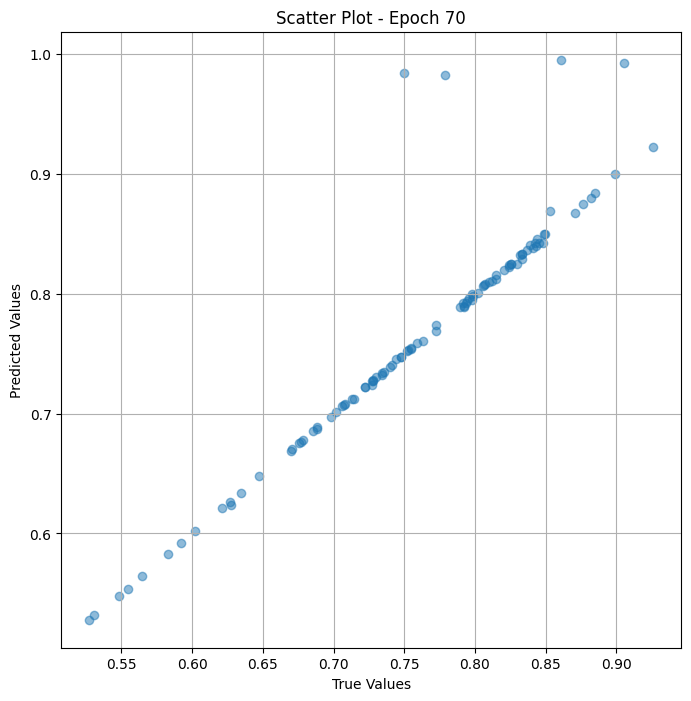


 Epoch: (71/100) Loss = 2.868306125947129e-07

 Epoch: (71/100) Loss_rmse = 0.000535565719474107

 Epoch: (71/100) R^2 = 0.9998887181282043

 Epoch: (71/100) MAE = 0.0003971010446548462

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

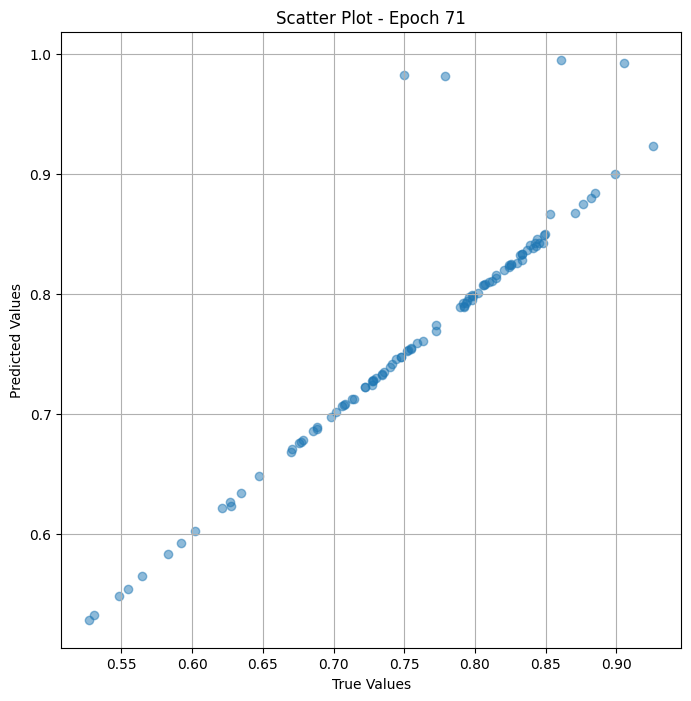


 Epoch: (72/100) Loss = 3.275301025951194e-07

 Epoch: (72/100) Loss_rmse = 0.0005723024369217455

 Epoch: (72/100) R^2 = 0.9998729228973389

 Epoch: (72/100) MAE = 0.00041157007217407227

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

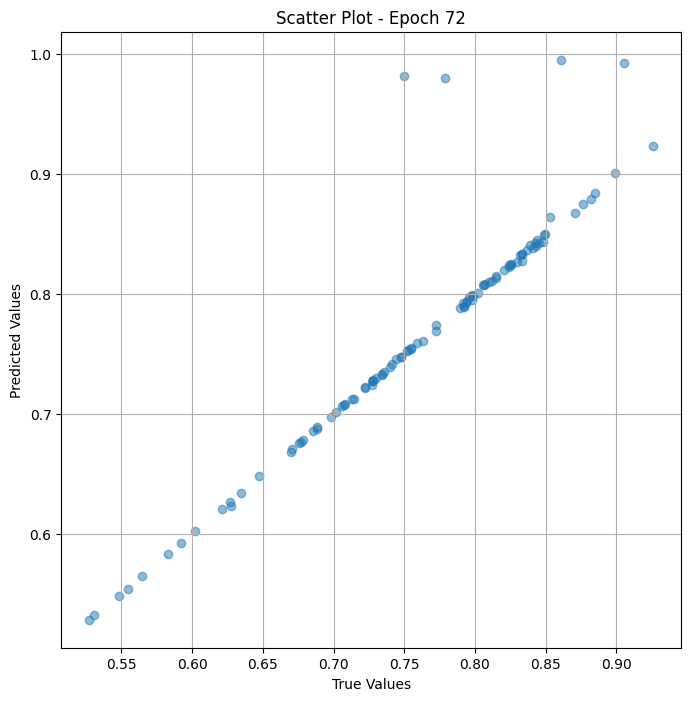


 Epoch: (73/100) Loss = 3.826421561825555e-07

 Epoch: (73/100) Loss_rmse = 0.0006185807869769633

 Epoch: (73/100) R^2 = 0.9998515248298645

 Epoch: (73/100) MAE = 0.00042870640754699707

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

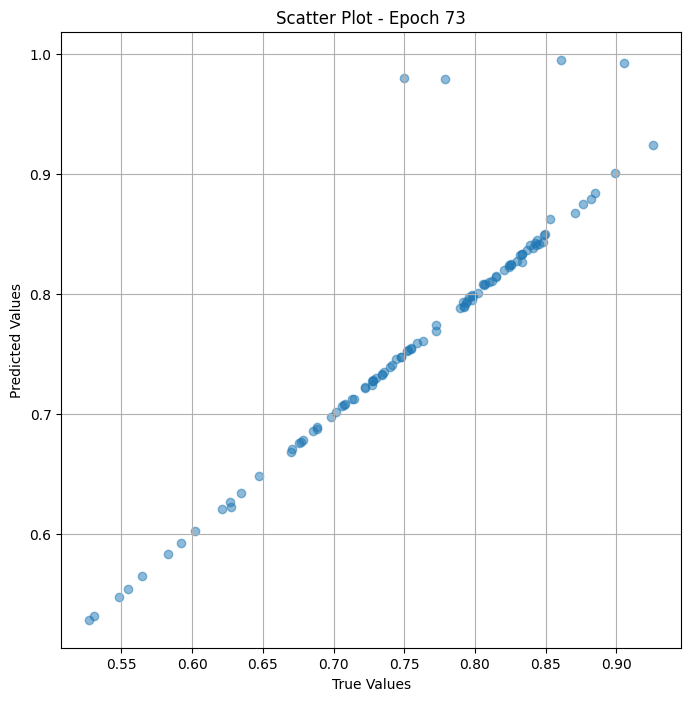


 Epoch: (74/100) Loss = 4.595806331053609e-07

 Epoch: (74/100) Loss_rmse = 0.0006779237883165479

 Epoch: (74/100) R^2 = 0.999821662902832

 Epoch: (74/100) MAE = 0.0004540681838989258

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

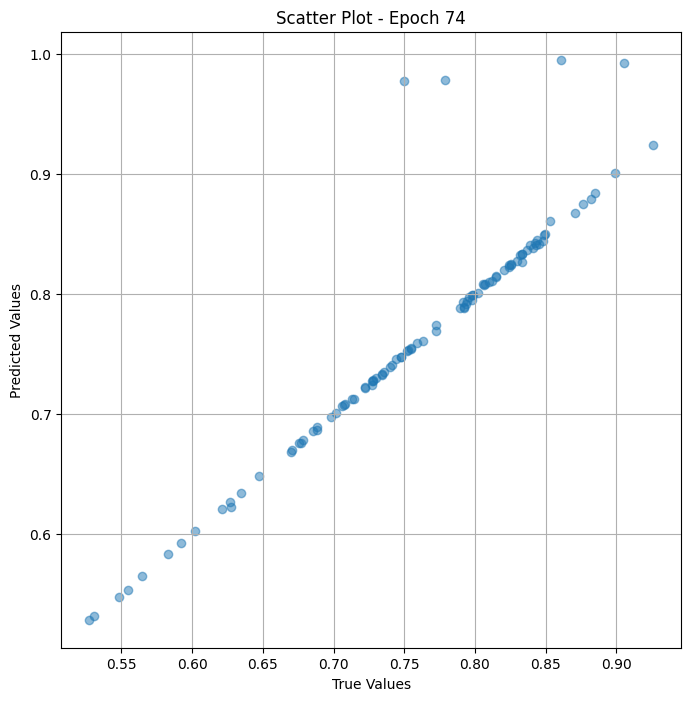


 Epoch: (75/100) Loss = 5.485536007654446e-07

 Epoch: (75/100) Loss_rmse = 0.0007406440563499928

 Epoch: (75/100) R^2 = 0.9997871518135071

 Epoch: (75/100) MAE = 0.0004821866750717163

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

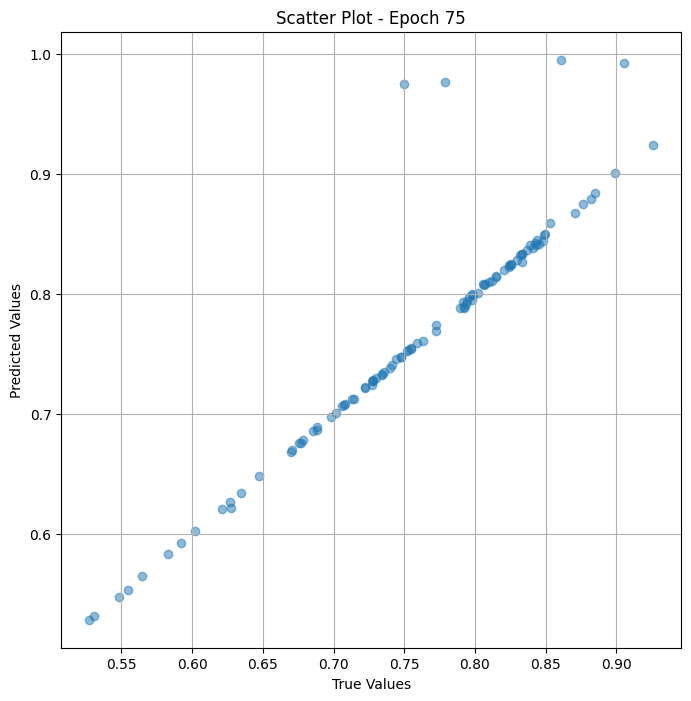


 Epoch: (76/100) Loss = 6.716014127050585e-07

 Epoch: (76/100) Loss_rmse = 0.0008195129339583218

 Epoch: (76/100) R^2 = 0.999739408493042

 Epoch: (76/100) MAE = 0.000527501106262207

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52

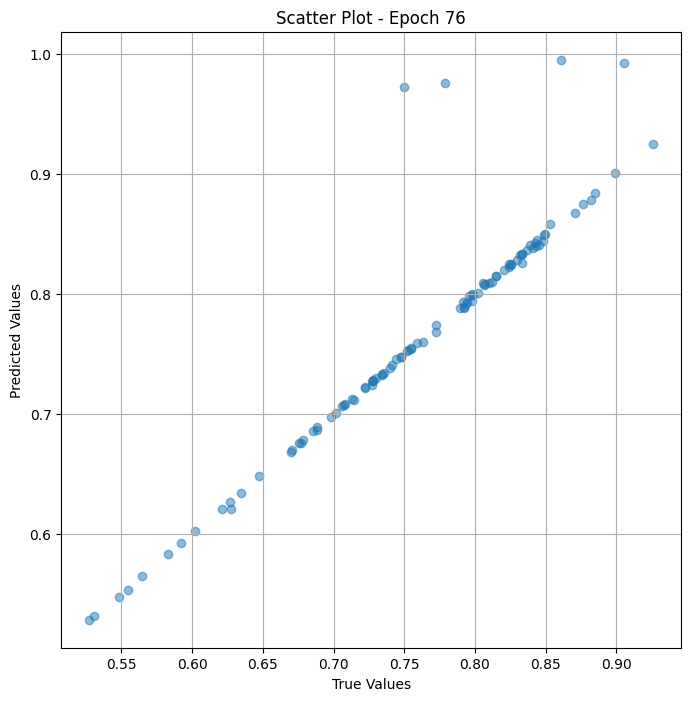


 Epoch: (77/100) Loss = 8.354562623935635e-07

 Epoch: (77/100) Loss_rmse = 0.0009140329784713686

 Epoch: (77/100) R^2 = 0.9996758103370667

 Epoch: (77/100) MAE = 0.0005821138620376587

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

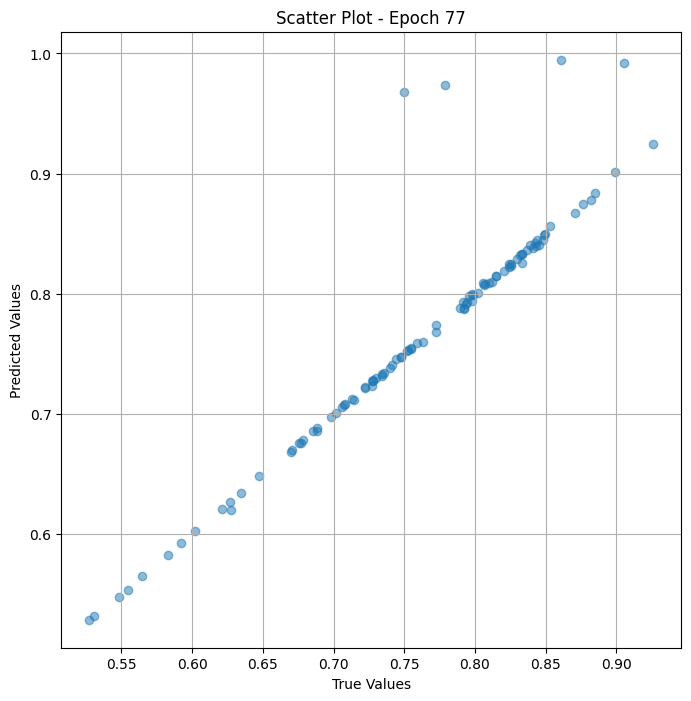


 Epoch: (78/100) Loss = 1.0505672207727912e-06

 Epoch: (78/100) Loss_rmse = 0.0010249718325212598

 Epoch: (78/100) R^2 = 0.9995923638343811

 Epoch: (78/100) MAE = 0.0006539970636367798

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

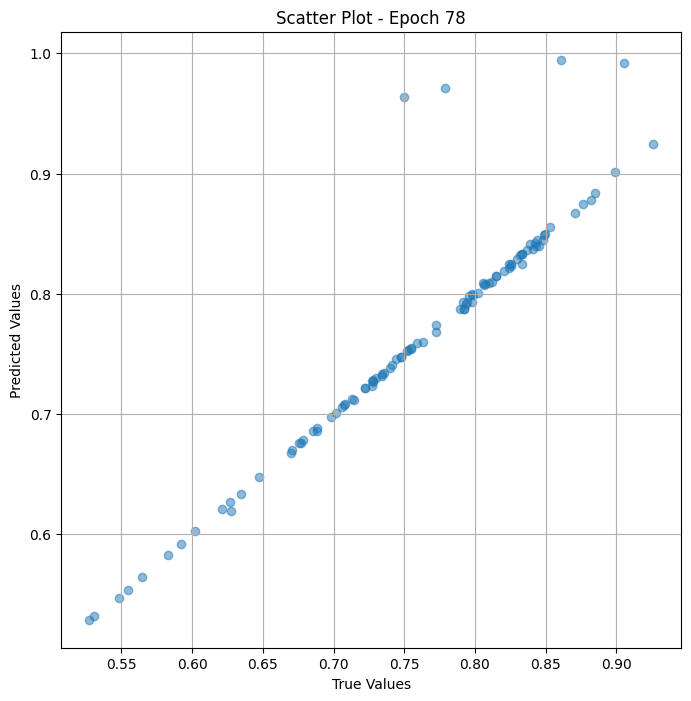


 Epoch: (79/100) Loss = 1.3385813417698955e-06

 Epoch: (79/100) Loss_rmse = 0.0011569707421585917

 Epoch: (79/100) R^2 = 0.9994806051254272

 Epoch: (79/100) MAE = 0.0007440447807312012

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

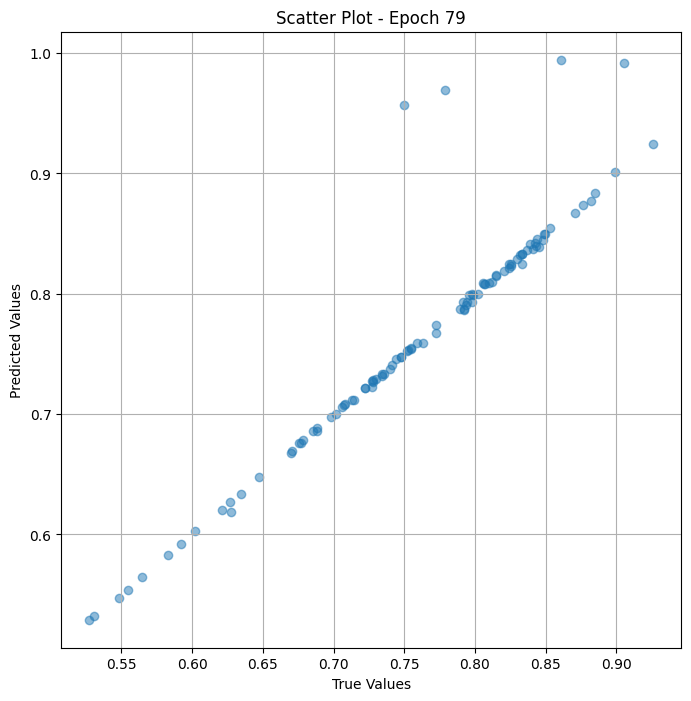


 Epoch: (80/100) Loss = 1.7441930140194017e-06

 Epoch: (80/100) Loss_rmse = 0.001320678973570466

 Epoch: (80/100) R^2 = 0.9993232488632202

 Epoch: (80/100) MAE = 0.0008467882871627808

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

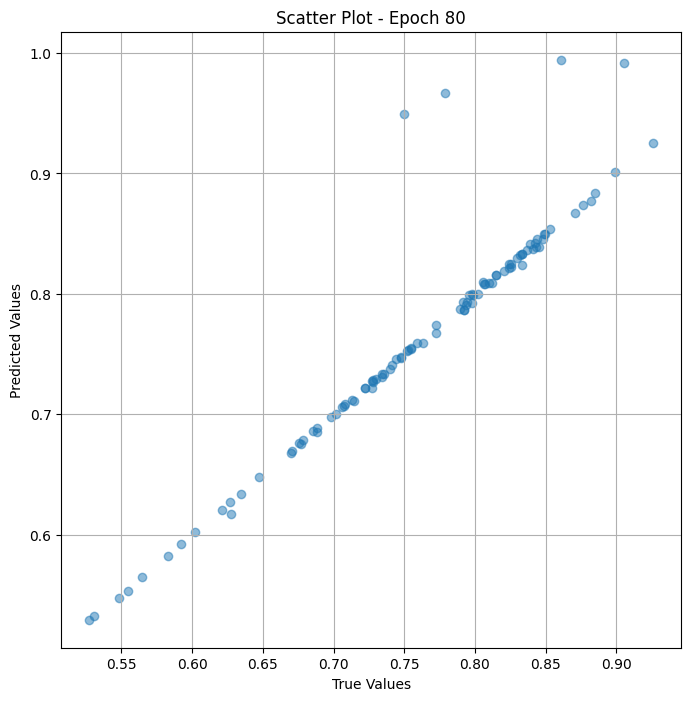


 Epoch: (81/100) Loss = 2.224552417828818e-06

 Epoch: (81/100) Loss_rmse = 0.0014914933126419783

 Epoch: (81/100) R^2 = 0.9991368651390076

 Epoch: (81/100) MAE = 0.0009565204381942749

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

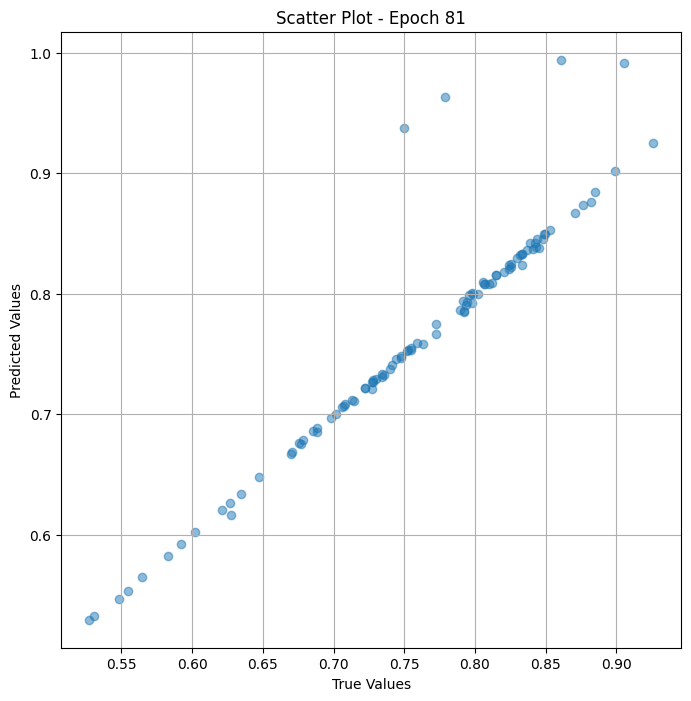


 Epoch: (82/100) Loss = 2.7980686354567297e-06

 Epoch: (82/100) Loss_rmse = 0.0016727428883314133

 Epoch: (82/100) R^2 = 0.998914361000061

 Epoch: (82/100) MAE = 0.0010821819305419922

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

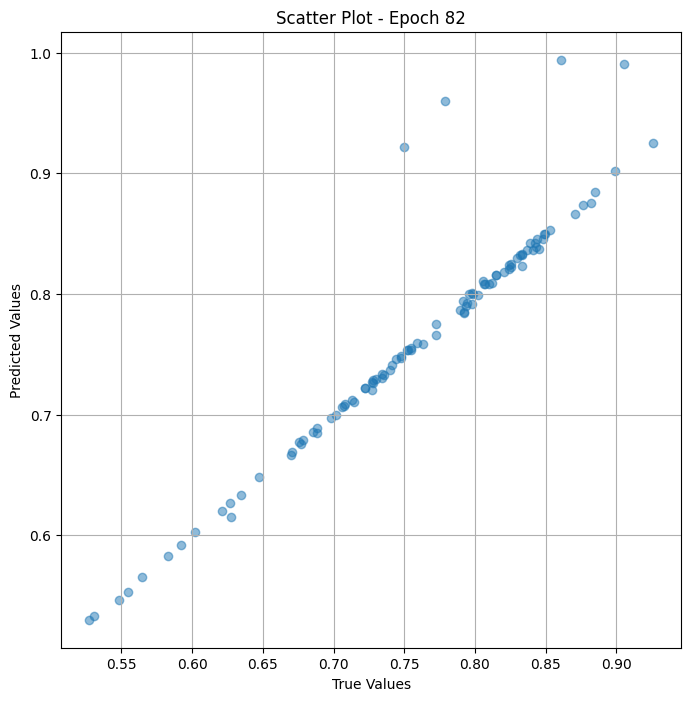


 Epoch: (83/100) Loss = 3.1402462354890304e-06

 Epoch: (83/100) Loss_rmse = 0.0017720740288496017

 Epoch: (83/100) R^2 = 0.9987815618515015

 Epoch: (83/100) MAE = 0.0011545121669769287

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

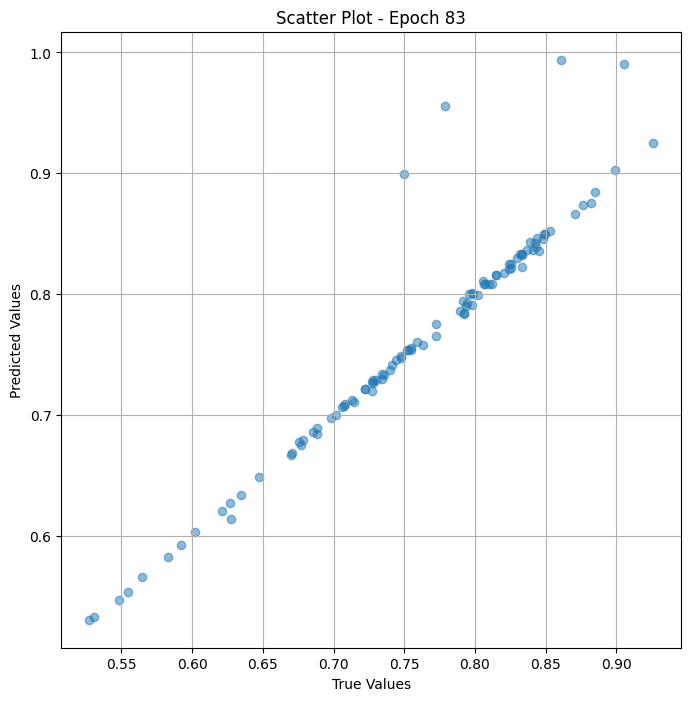


 Epoch: (84/100) Loss = 2.7096280064142775e-06

 Epoch: (84/100) Loss_rmse = 0.001646094722673297

 Epoch: (84/100) R^2 = 0.9989486336708069

 Epoch: (84/100) MAE = 0.001104503870010376

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

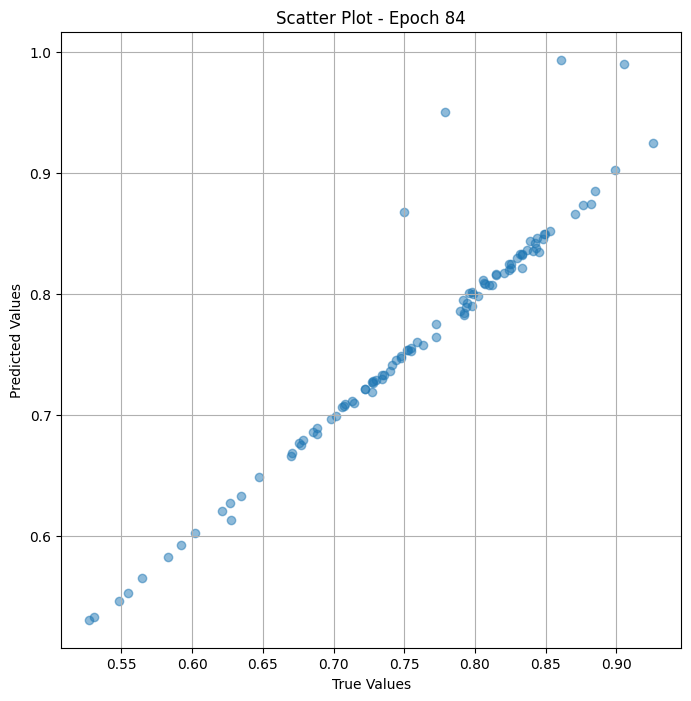


 Epoch: (85/100) Loss = 1.1399025652281125e-06

 Epoch: (85/100) Loss_rmse = 0.0010676621459424496

 Epoch: (85/100) R^2 = 0.9995577335357666

 Epoch: (85/100) MAE = 0.0007765591144561768

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

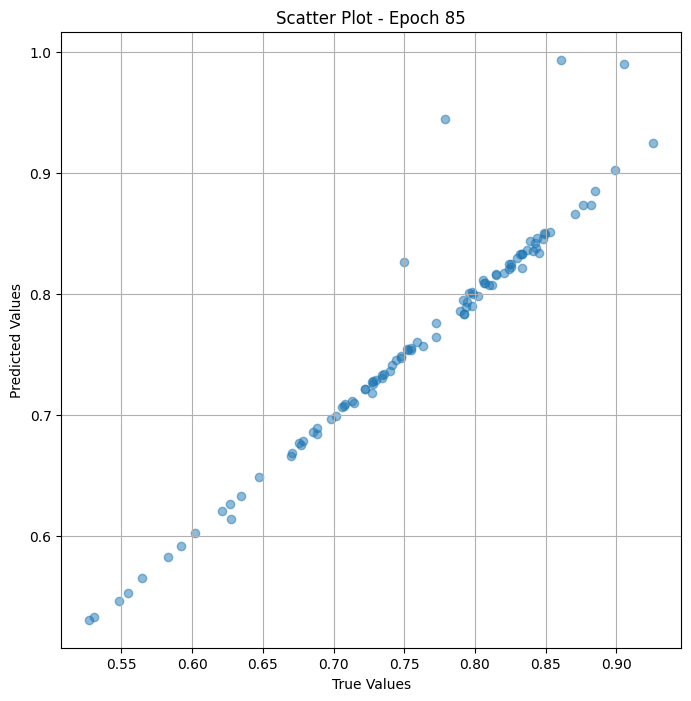


 Epoch: (86/100) Loss = 5.95264033620424e-08

 Epoch: (86/100) Loss_rmse = 0.00024398033565375954

 Epoch: (86/100) R^2 = 0.9999769330024719

 Epoch: (86/100) MAE = 0.00017146766185760498

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

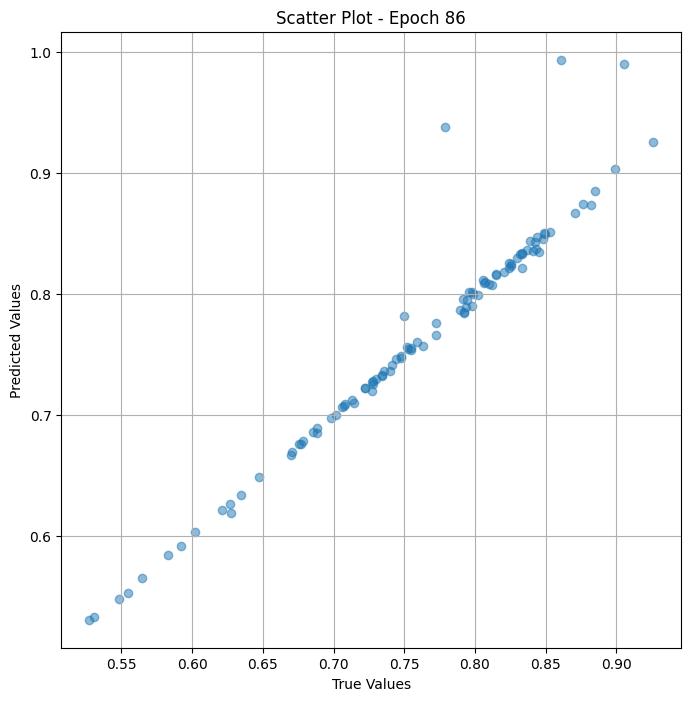


 Epoch: (87/100) Loss = 5.712191182283277e-07

 Epoch: (87/100) Loss_rmse = 0.0007557903882116079

 Epoch: (87/100) R^2 = 0.9997783899307251

 Epoch: (87/100) MAE = 0.0006306618452072144

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

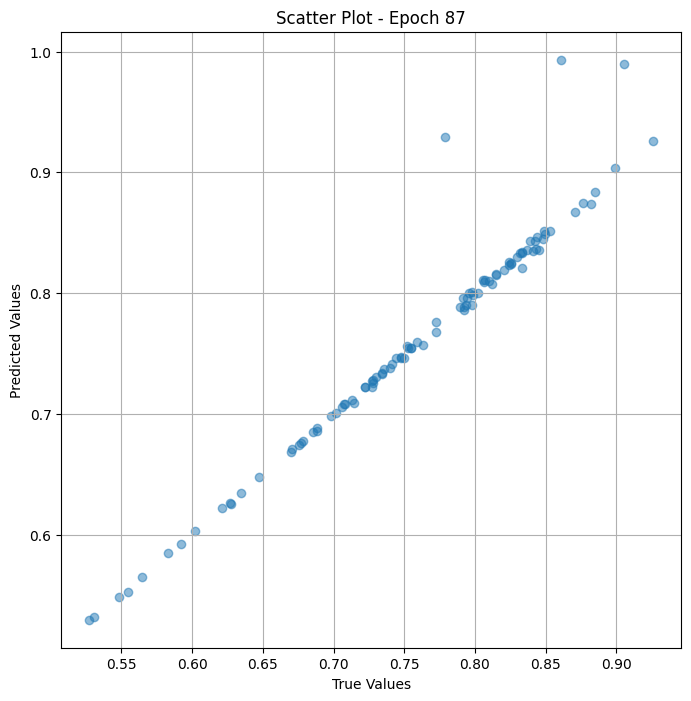


 Epoch: (88/100) Loss = 4.724654729670874e-07

 Epoch: (88/100) Loss_rmse = 0.000687361229211092

 Epoch: (88/100) R^2 = 0.9998166561126709

 Epoch: (88/100) MAE = 0.0006603151559829712

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5

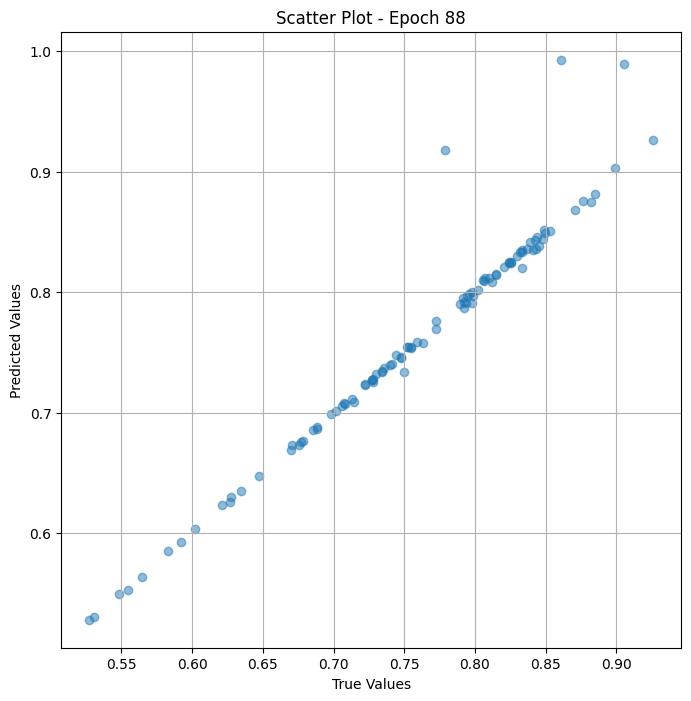


 Epoch: (89/100) Loss = 1.5178598289367073e-07

 Epoch: (89/100) Loss_rmse = 0.00038959720404818654

 Epoch: (89/100) R^2 = 0.9999411106109619

 Epoch: (89/100) MAE = 0.00032776594161987305

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427,

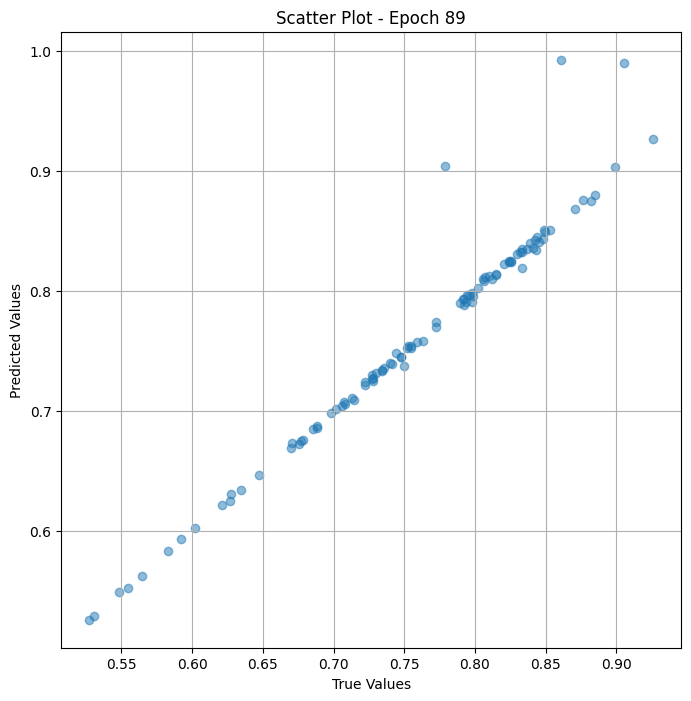


 Epoch: (90/100) Loss = 9.604442396948798e-08

 Epoch: (90/100) Loss_rmse = 0.0003099103341810405

 Epoch: (90/100) R^2 = 0.9999627470970154

 Epoch: (90/100) MAE = 0.00025969743728637695

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0

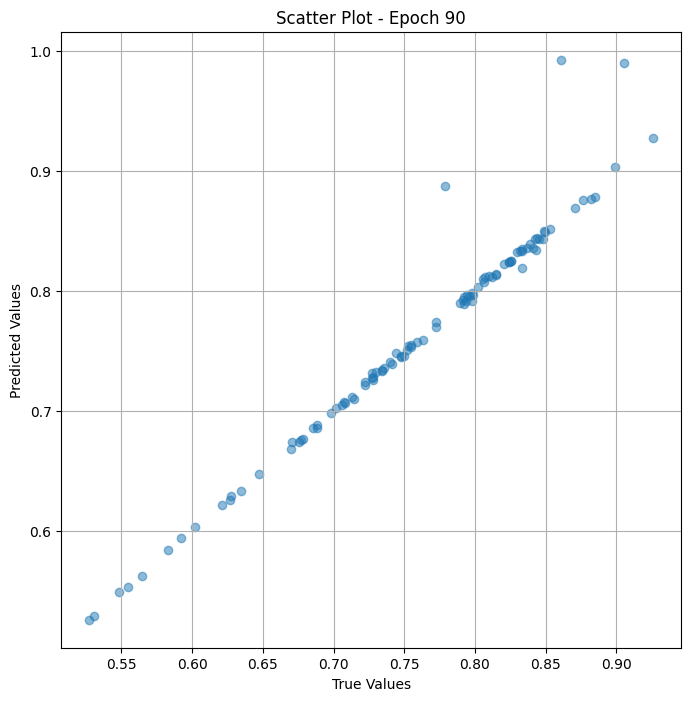


 Epoch: (91/100) Loss = 3.796452219262392e-08

 Epoch: (91/100) Loss_rmse = 0.00019484486256260425

 Epoch: (91/100) R^2 = 0.9999852776527405

 Epoch: (91/100) MAE = 0.00014983117580413818

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 

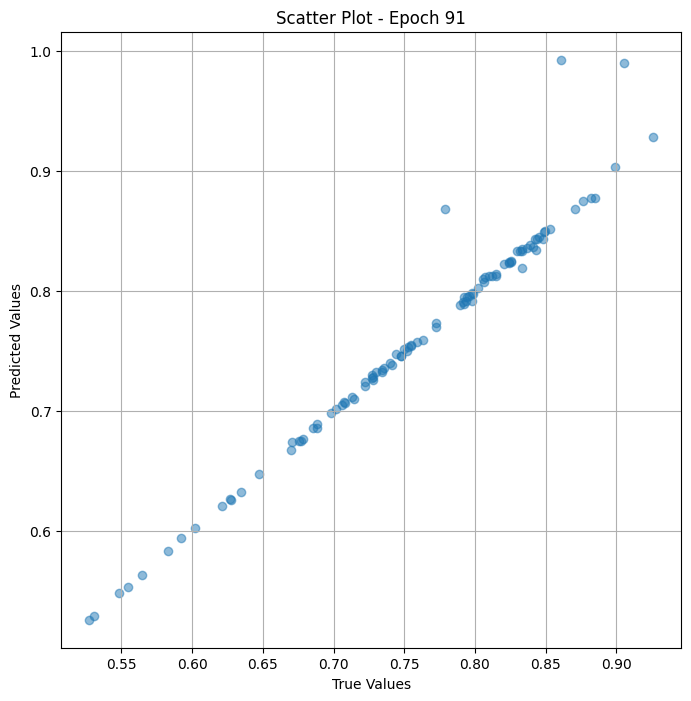


 Epoch: (92/100) Loss = 3.866404796326606e-08

 Epoch: (92/100) Loss_rmse = 0.00019663175044115633

 Epoch: (92/100) R^2 = 0.9999849796295166

 Epoch: (92/100) MAE = 0.00014635920524597168

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 

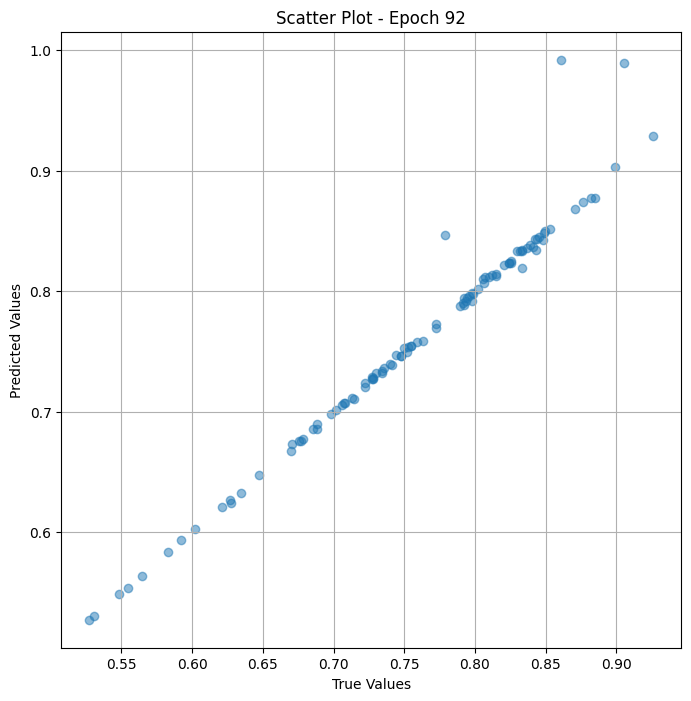


 Epoch: (93/100) Loss = 2.8349326441912126e-08

 Epoch: (93/100) Loss_rmse = 0.00016837258590385318

 Epoch: (93/100) R^2 = 0.9999889731407166

 Epoch: (93/100) MAE = 0.00013765692710876465

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427,

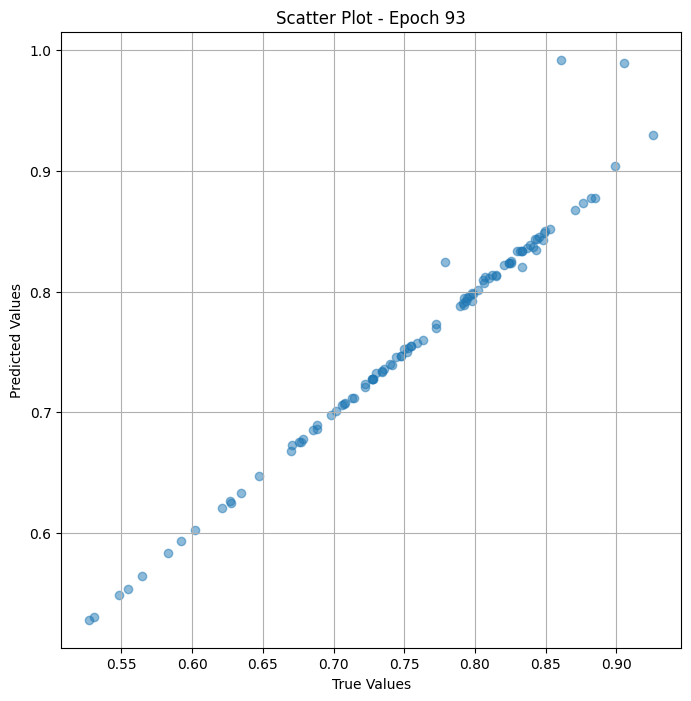


 Epoch: (94/100) Loss = 1.1195413485154404e-08

 Epoch: (94/100) Loss_rmse = 0.00010580837988527492

 Epoch: (94/100) R^2 = 0.9999956488609314

 Epoch: (94/100) MAE = 6.158649921417236e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 

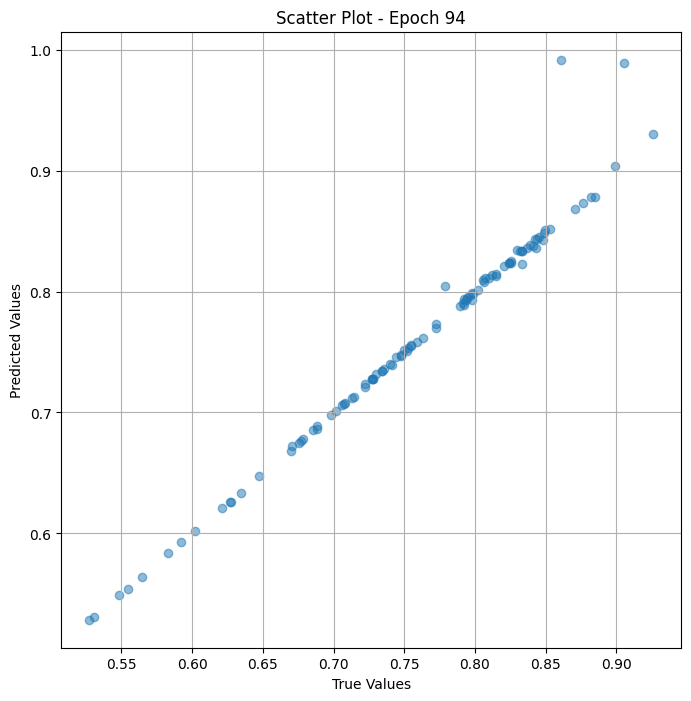


 Epoch: (95/100) Loss = 9.660000799271984e-09

 Epoch: (95/100) Loss_rmse = 9.828530164668337e-05

 Epoch: (95/100) R^2 = 0.9999962449073792

 Epoch: (95/100) MAE = 8.988380432128906e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

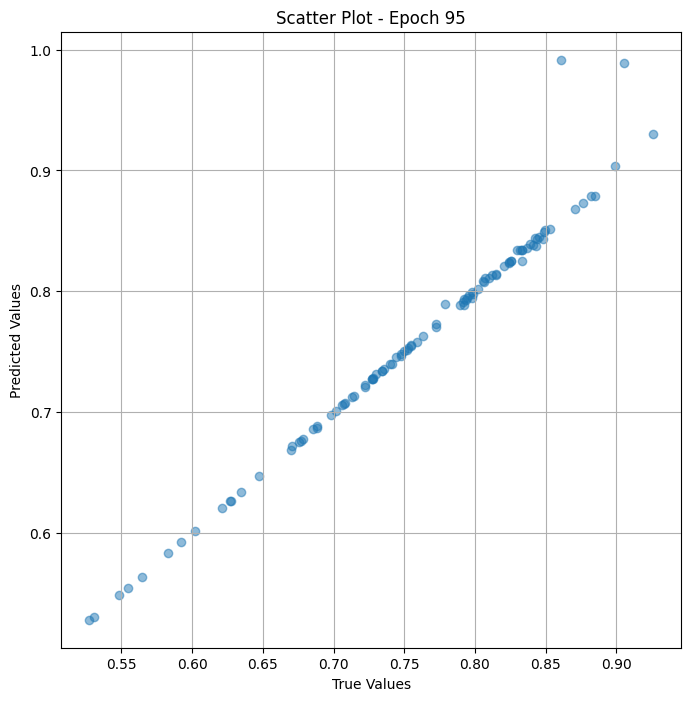


 Epoch: (96/100) Loss = 6.124696305676025e-09

 Epoch: (96/100) Loss_rmse = 7.82604402047582e-05

 Epoch: (96/100) R^2 = 0.999997615814209

 Epoch: (96/100) MAE = 6.686151027679443e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52

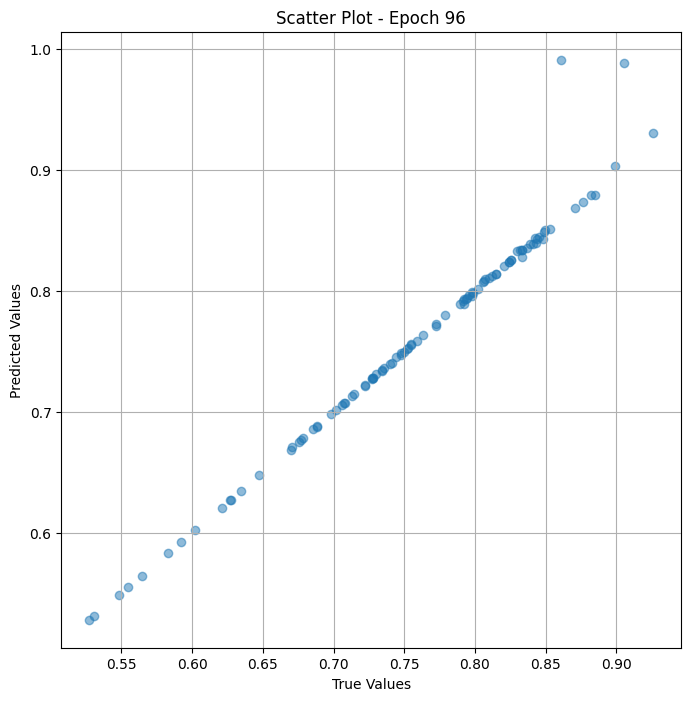


 Epoch: (97/100) Loss = 4.292915356529647e-09

 Epoch: (97/100) Loss_rmse = 6.552034028572962e-05

 Epoch: (97/100) R^2 = 0.9999983310699463

 Epoch: (97/100) MAE = 6.191432476043701e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

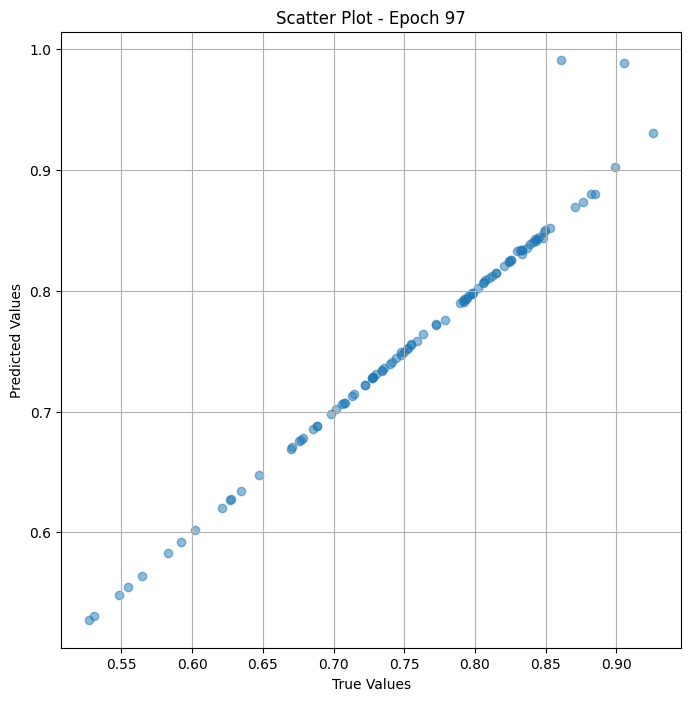


 Epoch: (98/100) Loss = 4.209393722476307e-09

 Epoch: (98/100) Loss_rmse = 6.487983773695305e-05

 Epoch: (98/100) R^2 = 0.9999983906745911

 Epoch: (98/100) MAE = 6.273388862609863e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.

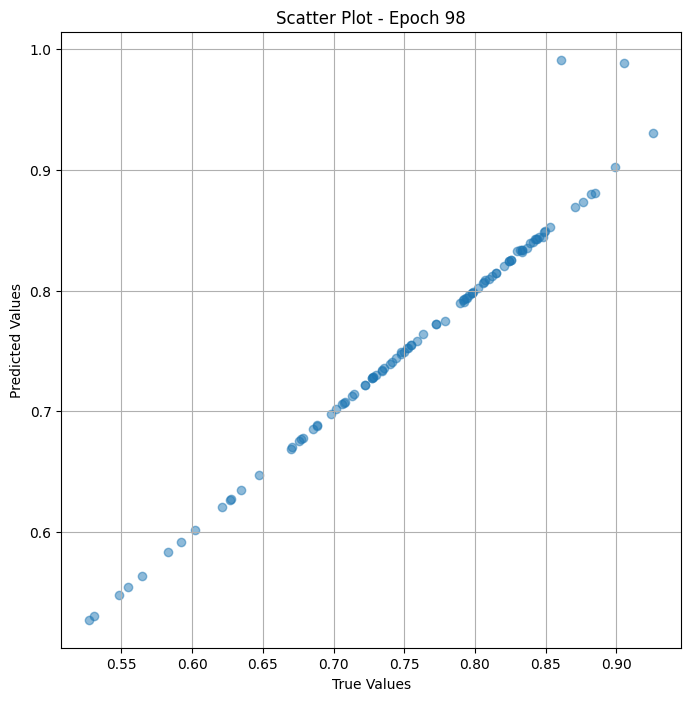


 Epoch: (99/100) Loss = 3.0166171782752826e-09

 Epoch: (99/100) Loss_rmse = 5.492374111781828e-05

 Epoch: (99/100) R^2 = 0.9999988079071045

 Epoch: (99/100) MAE = 5.2616000175476074e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 

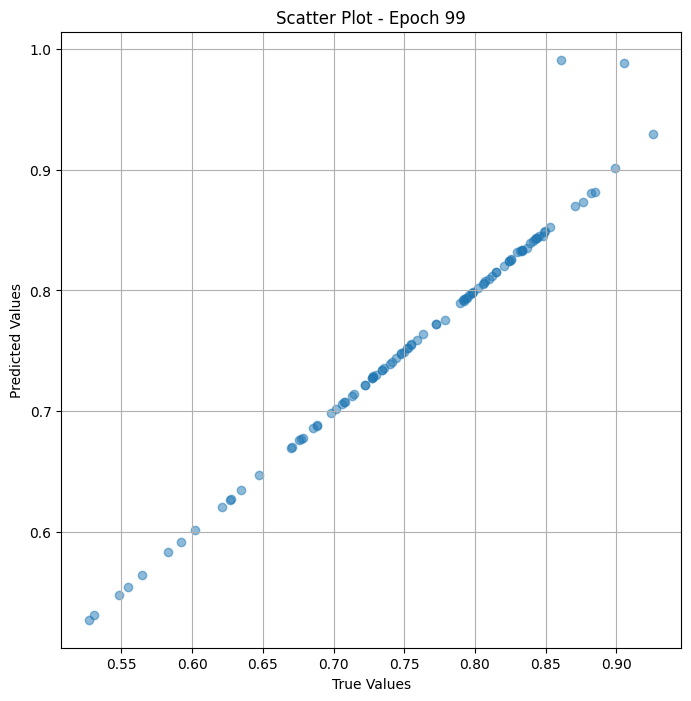


 Epoch: (100/100) Loss = 1.7624337544930313e-09

 Epoch: (100/100) Loss_rmse = 4.1981351387221366e-05

 Epoch: (100/100) R^2 = 0.9999993443489075

 Epoch: (100/100) MAE = 3.9696693420410156e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252

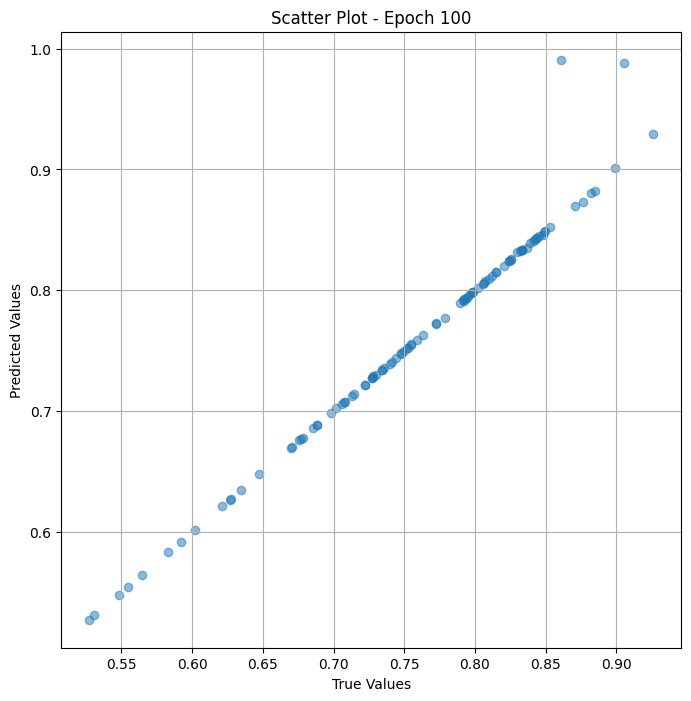

In [ ]:
# Training the model and save weights
fit(100, model_val, train_dl_val)
torch.save(model.state_dict(), "model_weights_vr_val")

## Test

In [ ]:
class Dataset_test_vehicle(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_test_vehicle(df_test_vehicle, trans_transform=trans_transform, res_transform=res_transform)
train_dl_test = DataLoader(train_ds, batch_size=16, shuffle= False)

In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

In [ ]:
# Merge the two models
class model_merge_test(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_test = model_merge_test(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_test = DeviceDataLoader(train_dl_test, device)
model_test = to_device(model_test, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_test.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_test, train_dl_test ):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_test :
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_test(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

           # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.12119778245687485

 Epoch: (1/50) Loss_rmse = 0.34813472628593445

 Epoch: (1/50) R^2 = -10.465349197387695

 Epoch: (1/50) MAE = 0.2766476273536682

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0

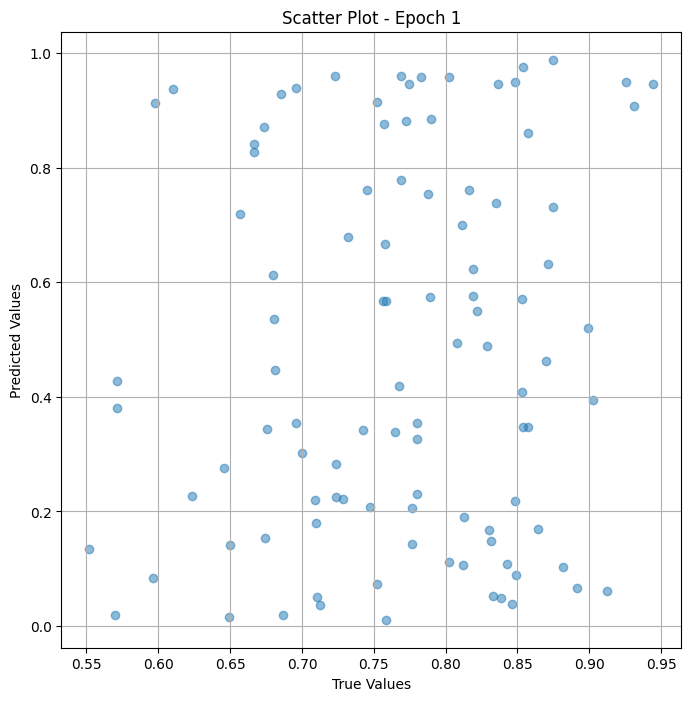


 Epoch: (2/50) Loss = 0.02915378287434578

 Epoch: (2/50) Loss_rmse = 0.17074479162693024

 Epoch: (2/50) R^2 = -1.7579572200775146

 Epoch: (2/50) MAE = 0.15893501043319702

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 

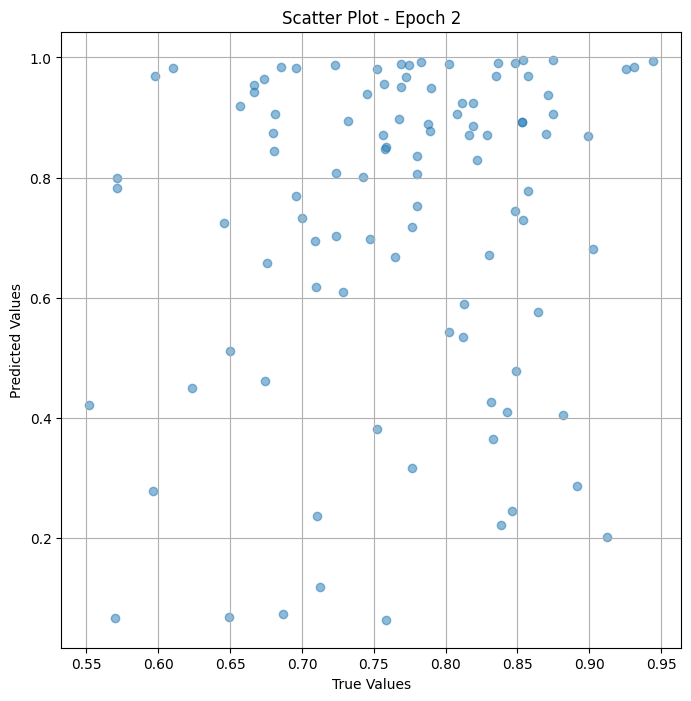


 Epoch: (3/50) Loss = 0.041053831577301025

 Epoch: (3/50) Loss_rmse = 0.20261745154857635

 Epoch: (3/50) R^2 = -2.8837056159973145

 Epoch: (3/50) MAE = 0.17797896265983582

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856,

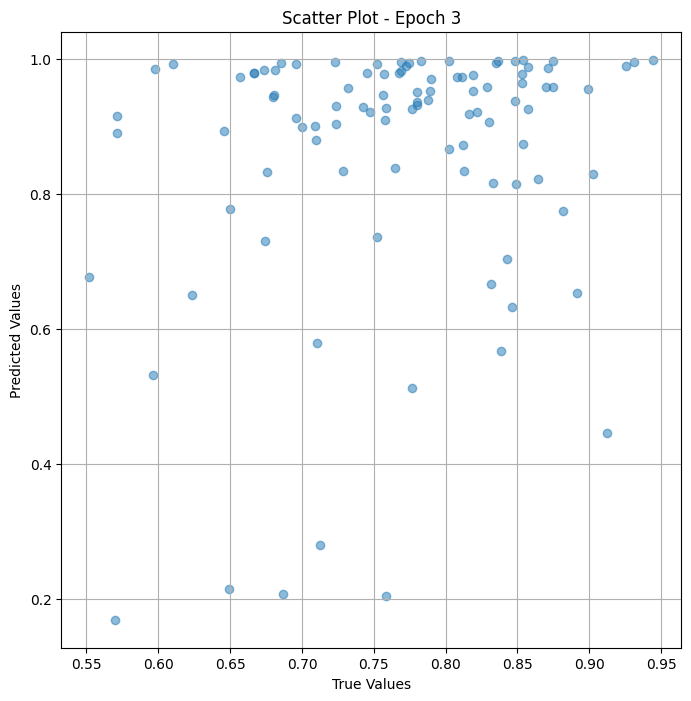


 Epoch: (4/50) Loss = 0.04622256010770798

 Epoch: (4/50) Loss_rmse = 0.21499432623386383

 Epoch: (4/50) R^2 = -3.372669219970703

 Epoch: (4/50) MAE = 0.20052270591259003

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0

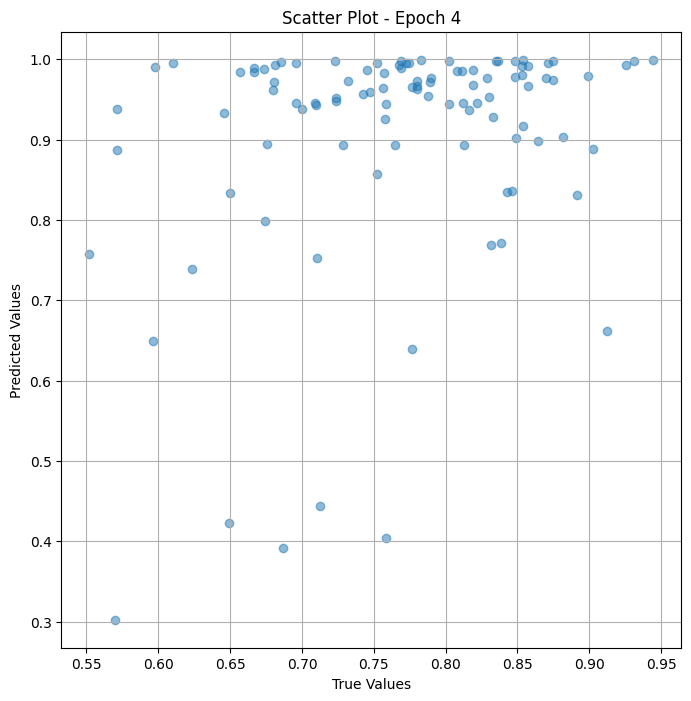


 Epoch: (5/50) Loss = 0.03559233248233795

 Epoch: (5/50) Loss_rmse = 0.18865929543972015

 Epoch: (5/50) R^2 = -2.3670461177825928

 Epoch: (5/50) MAE = 0.1780085265636444

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0

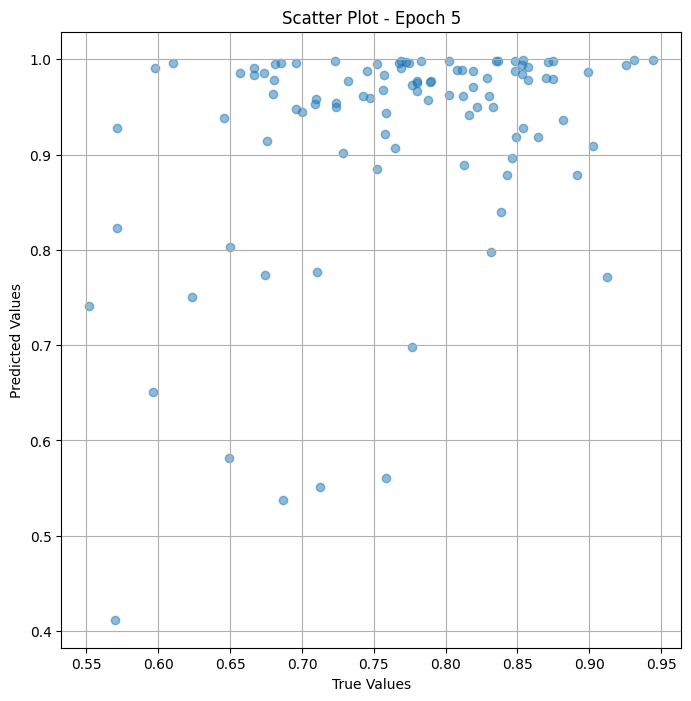


 Epoch: (6/50) Loss = 0.017541904002428055

 Epoch: (6/50) Loss_rmse = 0.13244585692882538

 Epoch: (6/50) R^2 = -0.659469723701477

 Epoch: (6/50) MAE = 0.11213865876197815

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 

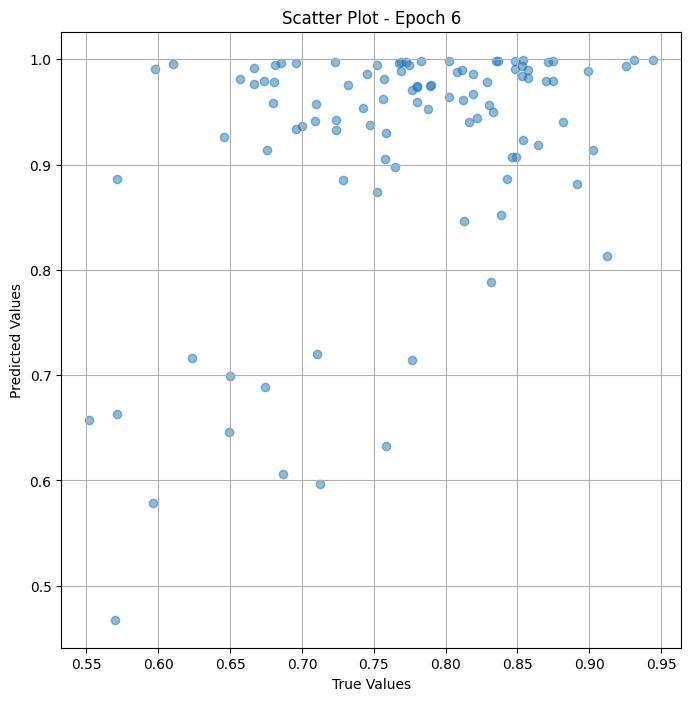


 Epoch: (7/50) Loss = 0.01581312157213688

 Epoch: (7/50) Loss_rmse = 0.12575022876262665

 Epoch: (7/50) R^2 = -0.4959263801574707

 Epoch: (7/50) MAE = 0.12123950570821762

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 

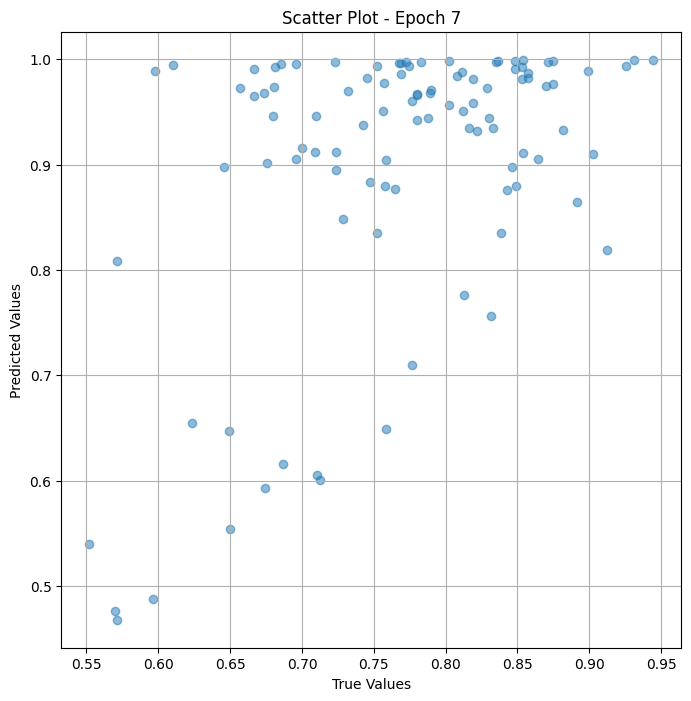


 Epoch: (8/50) Loss = 0.012470198795199394

 Epoch: (8/50) Loss_rmse = 0.11167004704475403

 Epoch: (8/50) R^2 = -0.17968475818634033

 Epoch: (8/50) MAE = 0.10990898311138153

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856

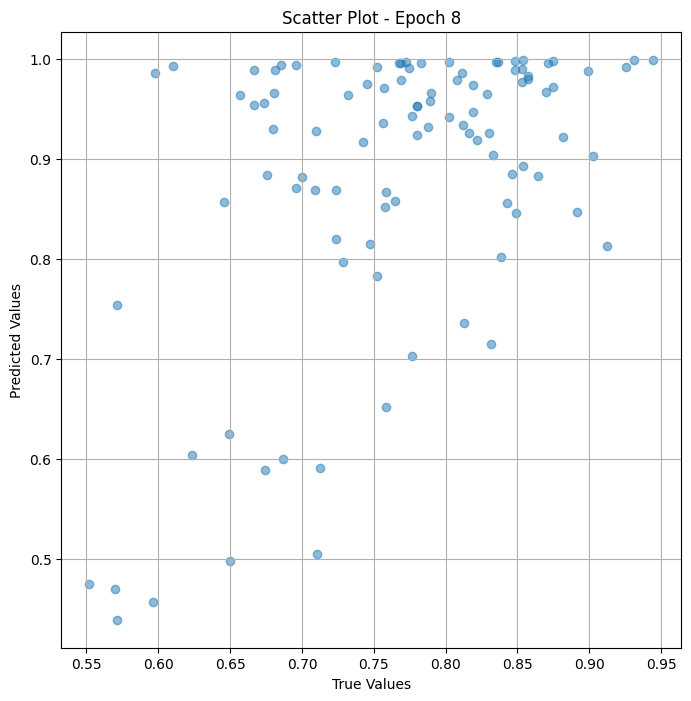


 Epoch: (9/50) Loss = 0.00452292338013649

 Epoch: (9/50) Loss_rmse = 0.06725268065929413

 Epoch: (9/50) R^2 = 0.5721299648284912

 Epoch: (9/50) MAE = 0.05409236252307892

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0

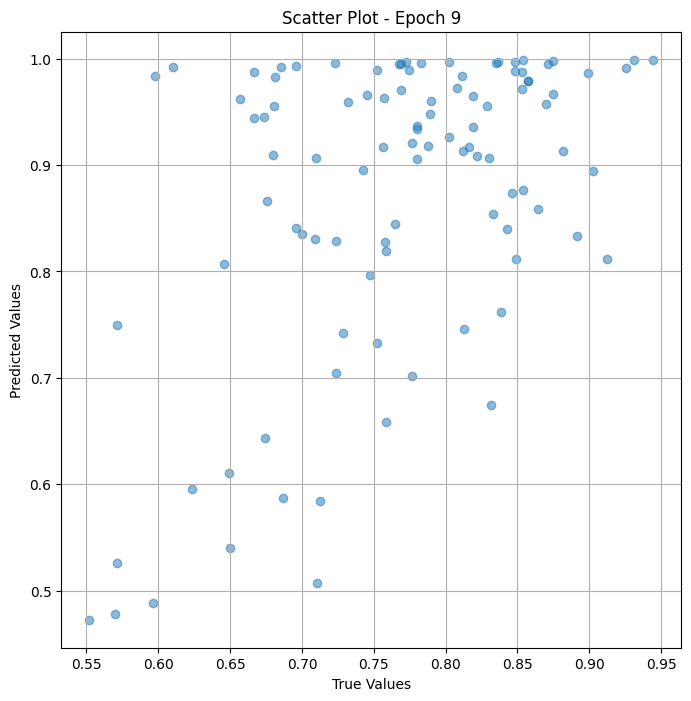


 Epoch: (10/50) Loss = 0.005888024345040321

 Epoch: (10/50) Loss_rmse = 0.07673346251249313

 Epoch: (10/50) R^2 = 0.4429910182952881

 Epoch: (10/50) MAE = 0.06069985032081604

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853658

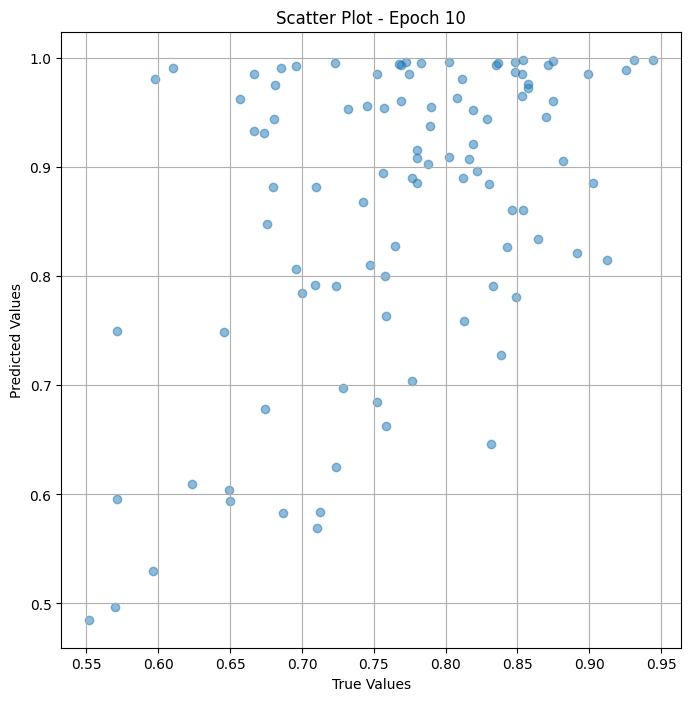


 Epoch: (11/50) Loss = 0.004053791984915733

 Epoch: (11/50) Loss_rmse = 0.06366939842700958

 Epoch: (11/50) R^2 = 0.6165099740028381

 Epoch: (11/50) MAE = 0.04968370497226715

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853658

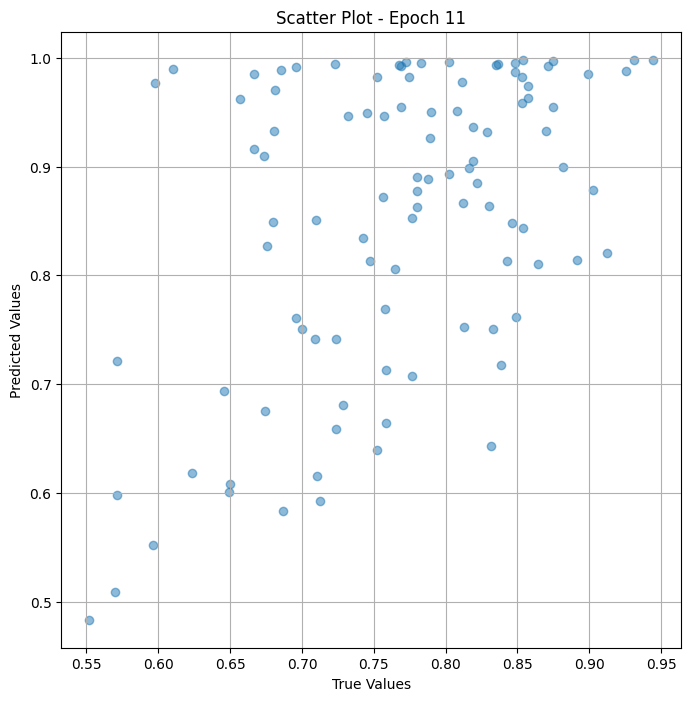


 Epoch: (12/50) Loss = 0.0022781100124120712

 Epoch: (12/50) Loss_rmse = 0.047729551792144775

 Epoch: (12/50) R^2 = 0.7844900488853455

 Epoch: (12/50) MAE = 0.028015196323394775

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

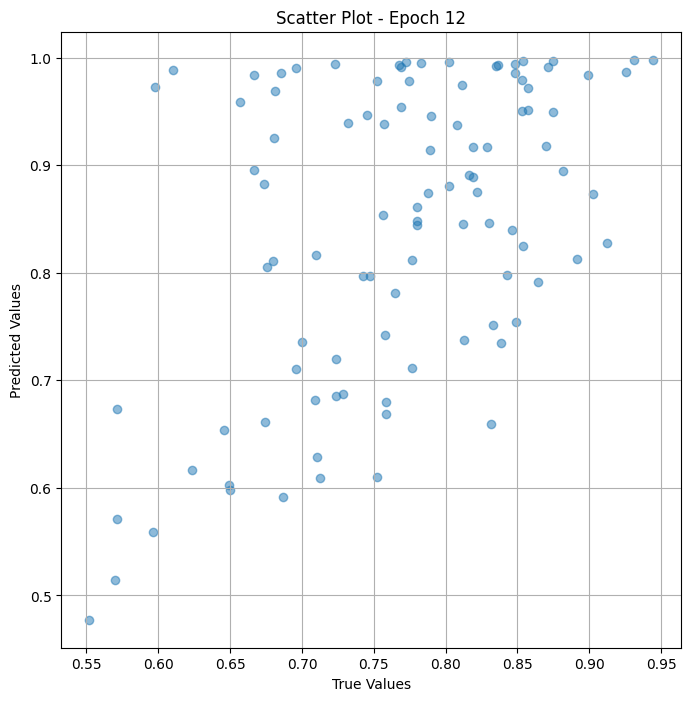


 Epoch: (13/50) Loss = 0.0017087230226024985

 Epoch: (13/50) Loss_rmse = 0.041336704045534134

 Epoch: (13/50) R^2 = 0.838354229927063

 Epoch: (13/50) MAE = 0.02990908920764923

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365

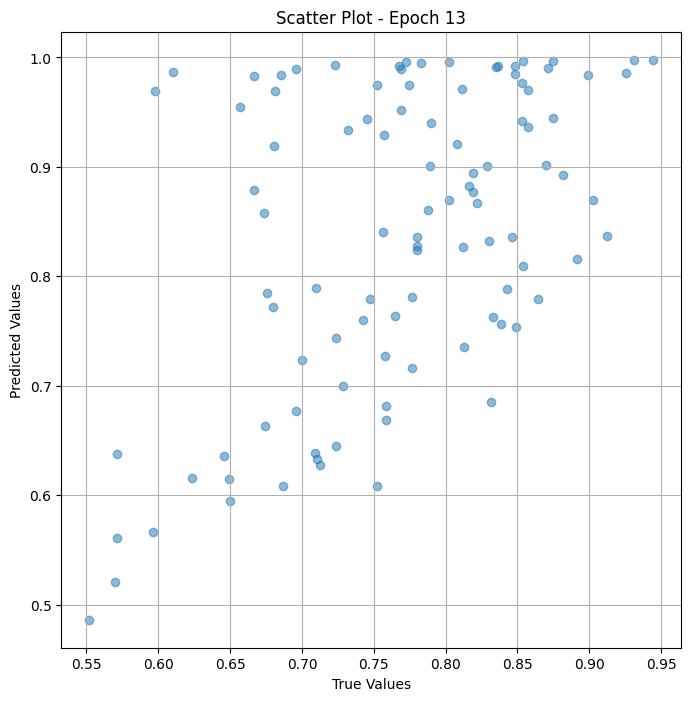


 Epoch: (14/50) Loss = 0.0008715037256479263

 Epoch: (14/50) Loss_rmse = 0.029521241784095764

 Epoch: (14/50) R^2 = 0.9175554513931274

 Epoch: (14/50) MAE = 0.018348291516304016

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

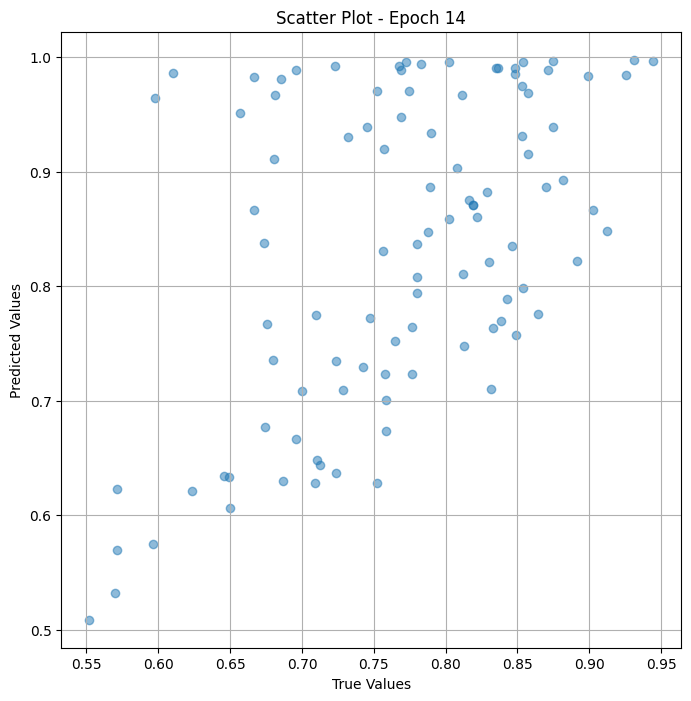


 Epoch: (15/50) Loss = 0.0002714713045861572

 Epoch: (15/50) Loss_rmse = 0.016476387158036232

 Epoch: (15/50) R^2 = 0.9743187427520752

 Epoch: (15/50) MAE = 0.012696459889411926

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

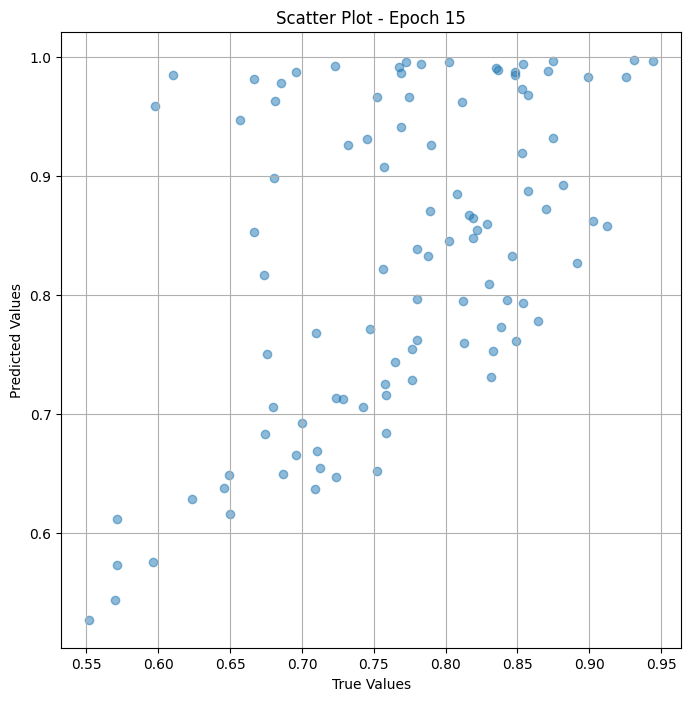


 Epoch: (16/50) Loss = 9.817299724090844e-05

 Epoch: (16/50) Loss_rmse = 0.009908229112625122

 Epoch: (16/50) R^2 = 0.9907128214836121

 Epoch: (16/50) MAE = 0.00693318247795105

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8536

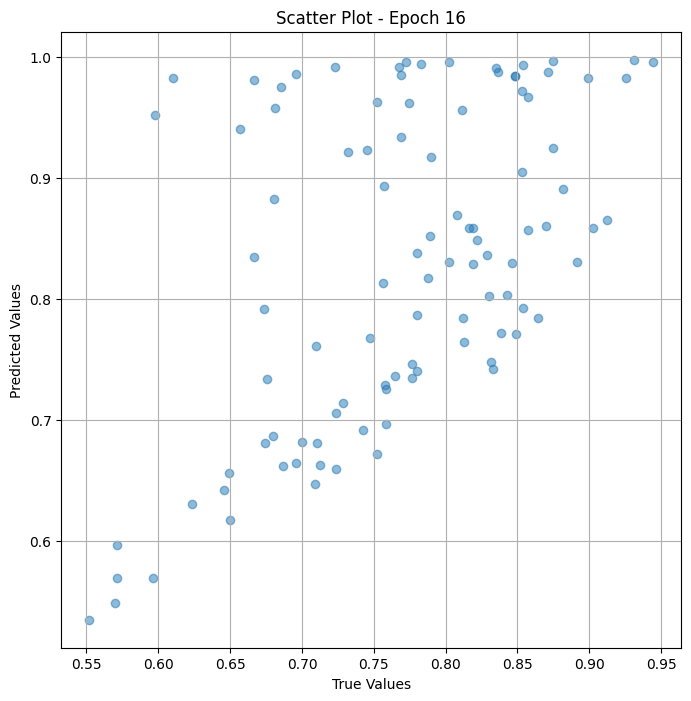


 Epoch: (17/50) Loss = 0.0001351178070763126

 Epoch: (17/50) Loss_rmse = 0.011624018661677837

 Epoch: (17/50) R^2 = 0.9872177839279175

 Epoch: (17/50) MAE = 0.009540960192680359

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

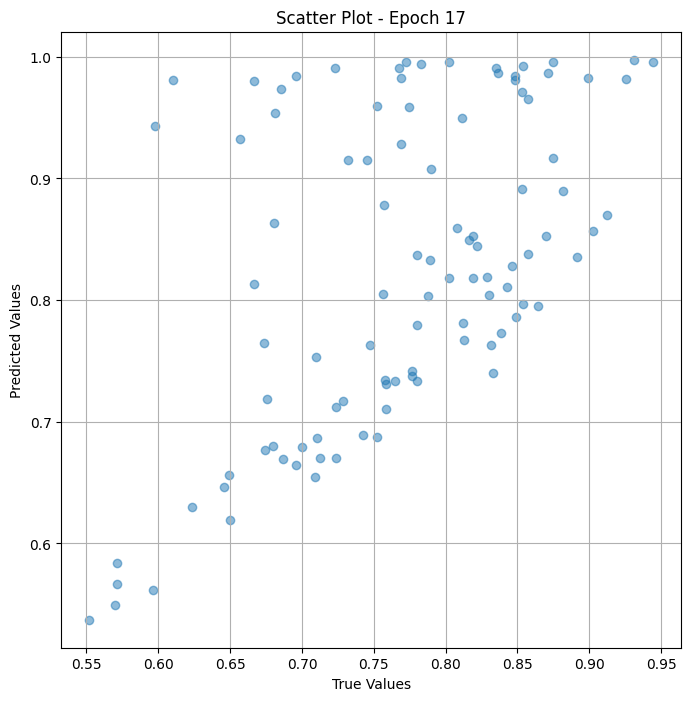


 Epoch: (18/50) Loss = 0.00012712636089418083

 Epoch: (18/50) Loss_rmse = 0.01127503253519535

 Epoch: (18/50) R^2 = 0.9879738092422485

 Epoch: (18/50) MAE = 0.007821515202522278

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

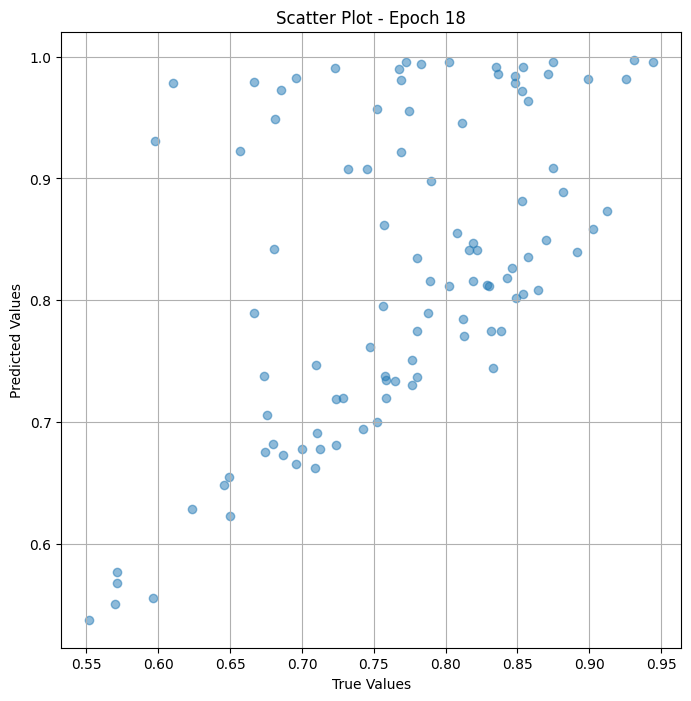


 Epoch: (19/50) Loss = 7.457965693902224e-05

 Epoch: (19/50) Loss_rmse = 0.008635951206088066

 Epoch: (19/50) R^2 = 0.9929447174072266

 Epoch: (19/50) MAE = 0.0065674930810928345

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

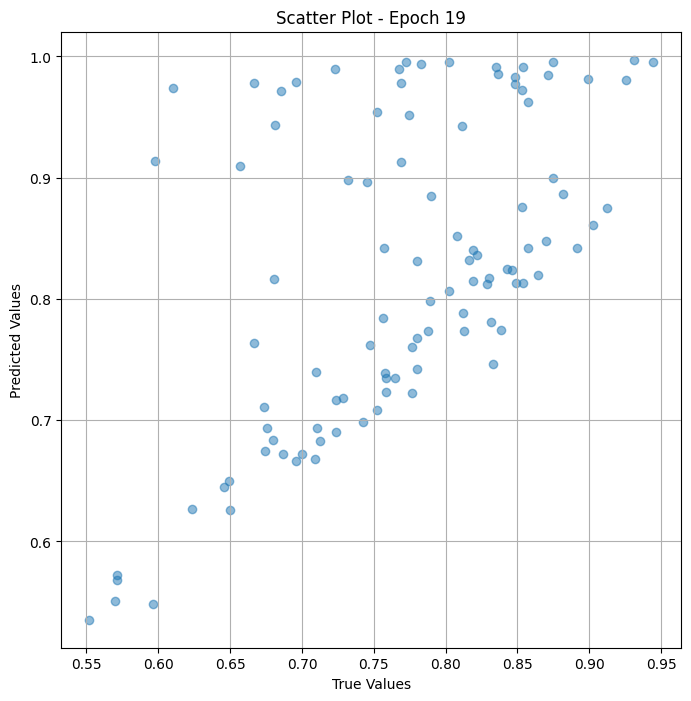


 Epoch: (20/50) Loss = 5.479713945533149e-05

 Epoch: (20/50) Loss_rmse = 0.007402508985251188

 Epoch: (20/50) R^2 = 0.9948161840438843

 Epoch: (20/50) MAE = 0.006120726466178894

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

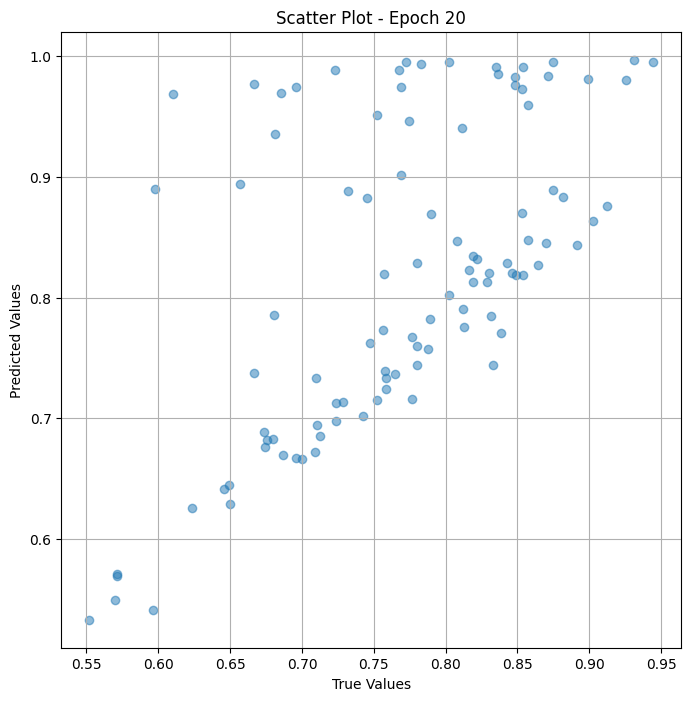


 Epoch: (21/50) Loss = 3.912810643669218e-05

 Epoch: (21/50) Loss_rmse = 0.0062552462331950665

 Epoch: (21/50) R^2 = 0.9962984919548035

 Epoch: (21/50) MAE = 0.005355209112167358

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

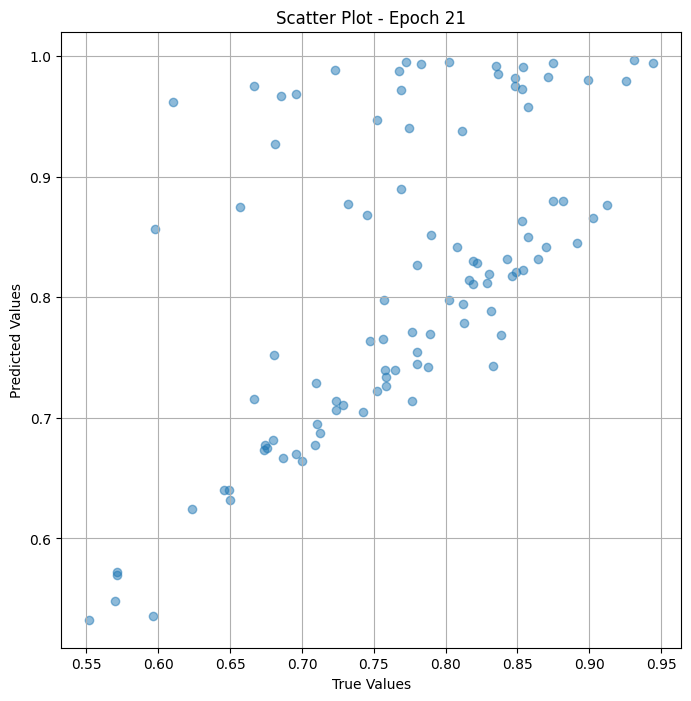


 Epoch: (22/50) Loss = 2.677231350389775e-05

 Epoch: (22/50) Loss_rmse = 0.005174196790903807

 Epoch: (22/50) R^2 = 0.9974673390388489

 Epoch: (22/50) MAE = 0.00472654402256012

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8536

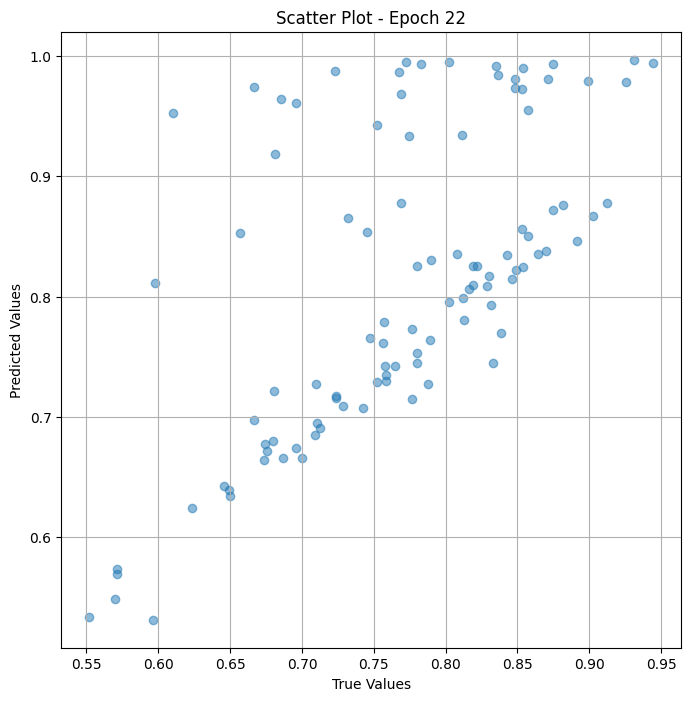


 Epoch: (23/50) Loss = 2.3581493223900907e-05

 Epoch: (23/50) Loss_rmse = 0.004856077954173088

 Epoch: (23/50) R^2 = 0.9977691769599915

 Epoch: (23/50) MAE = 0.004361733794212341

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

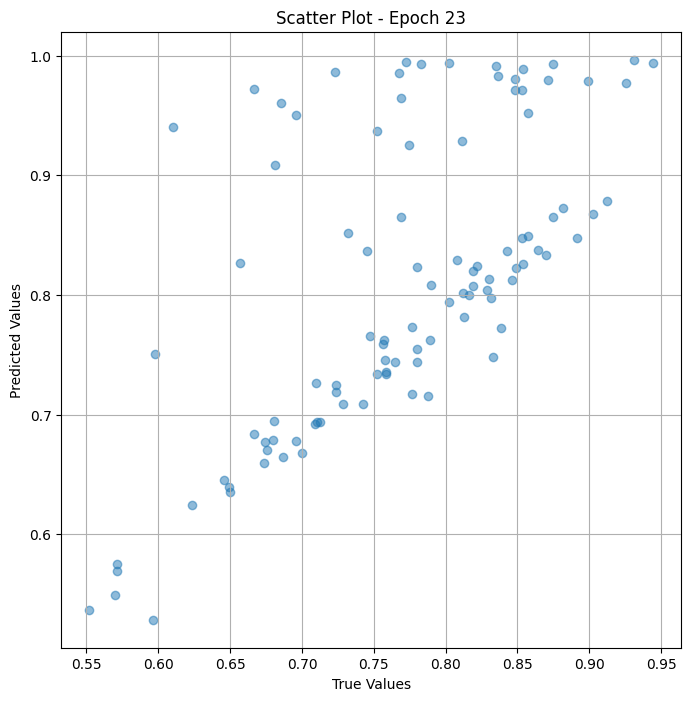


 Epoch: (24/50) Loss = 1.8205961168860085e-05

 Epoch: (24/50) Loss_rmse = 0.004266844596713781

 Epoch: (24/50) R^2 = 0.9982777237892151

 Epoch: (24/50) MAE = 0.0036727190017700195

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

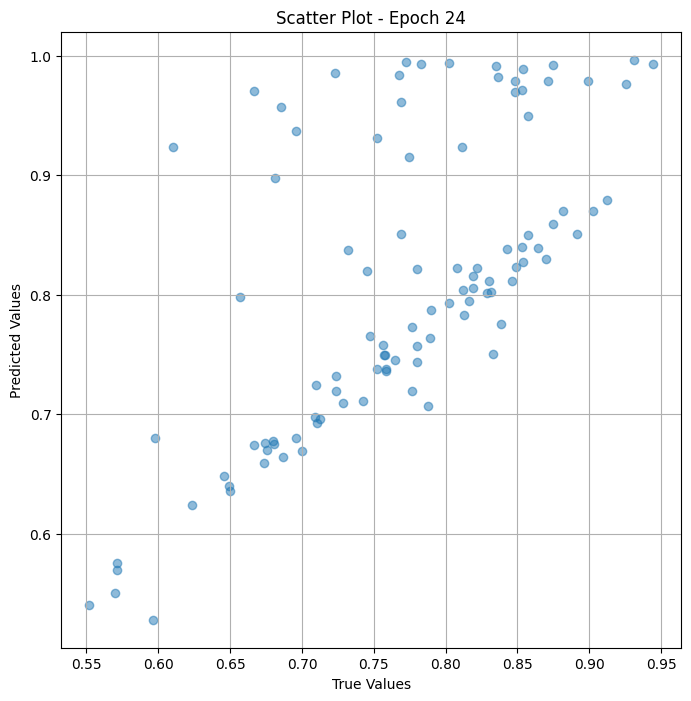


 Epoch: (25/50) Loss = 1.2020807844237424e-05

 Epoch: (25/50) Loss_rmse = 0.003467103699222207

 Epoch: (25/50) R^2 = 0.9988628029823303

 Epoch: (25/50) MAE = 0.0028227567672729492

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

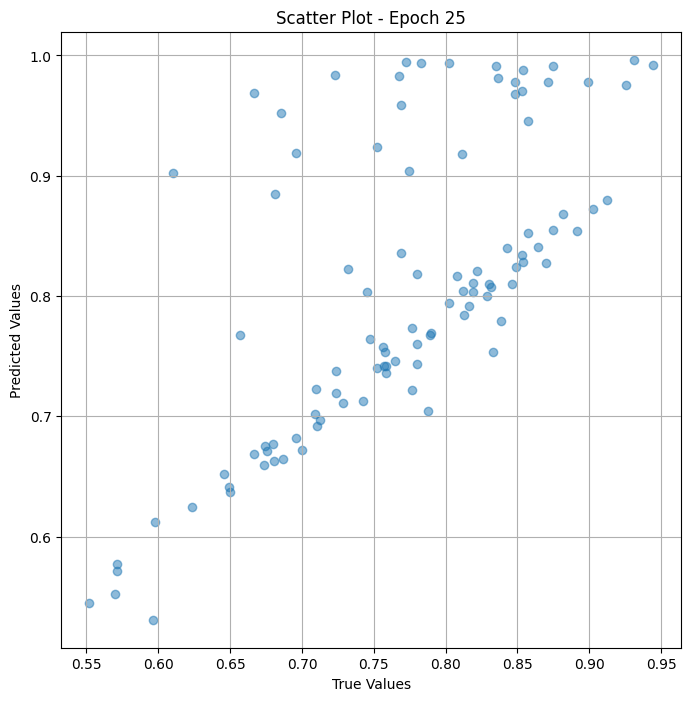


 Epoch: (26/50) Loss = 9.613785550754983e-06

 Epoch: (26/50) Loss_rmse = 0.0031006105709820986

 Epoch: (26/50) R^2 = 0.9990905523300171

 Epoch: (26/50) MAE = 0.0023458153009414673

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

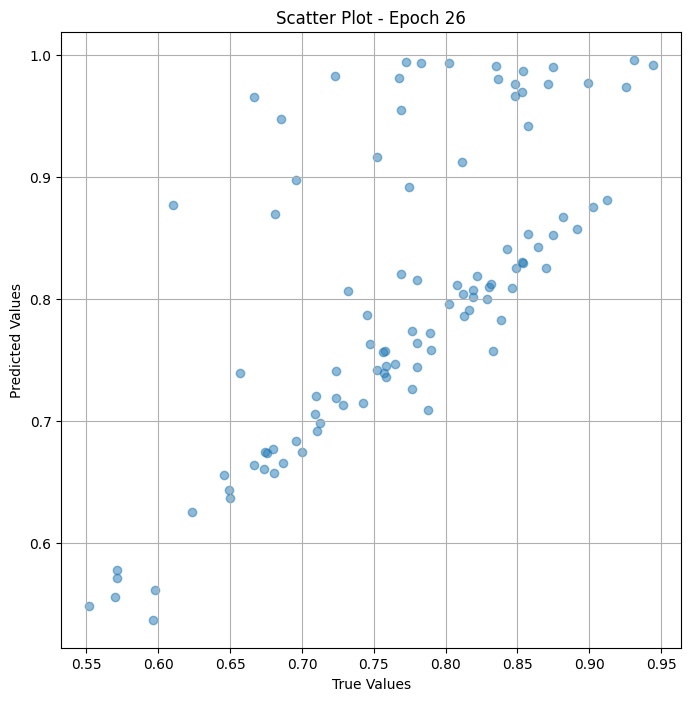


 Epoch: (27/50) Loss = 9.942787983163726e-06

 Epoch: (27/50) Loss_rmse = 0.0031532186549156904

 Epoch: (27/50) R^2 = 0.9990594387054443

 Epoch: (27/50) MAE = 0.0022136420011520386

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

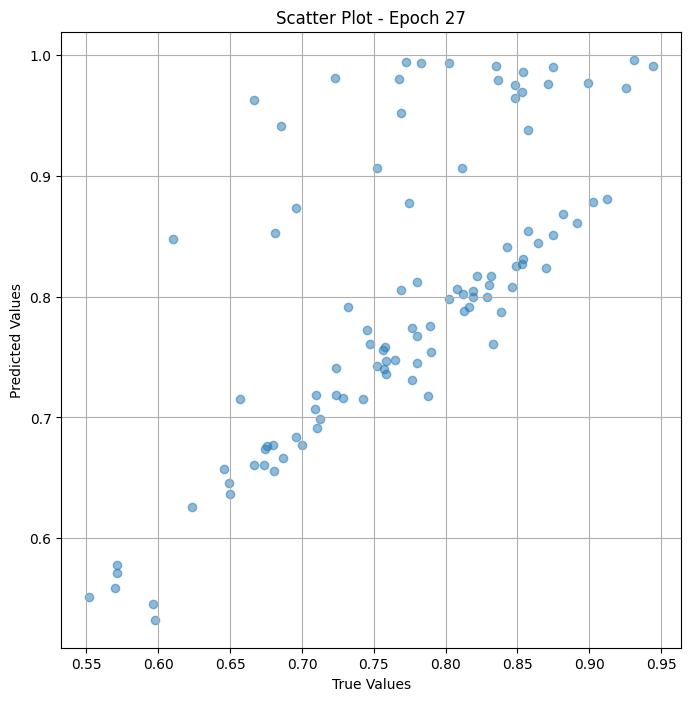


 Epoch: (28/50) Loss = 1.0018742614192888e-05

 Epoch: (28/50) Loss_rmse = 0.0031652397010475397

 Epoch: (28/50) R^2 = 0.9990522265434265

 Epoch: (28/50) MAE = 0.0022276490926742554

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.

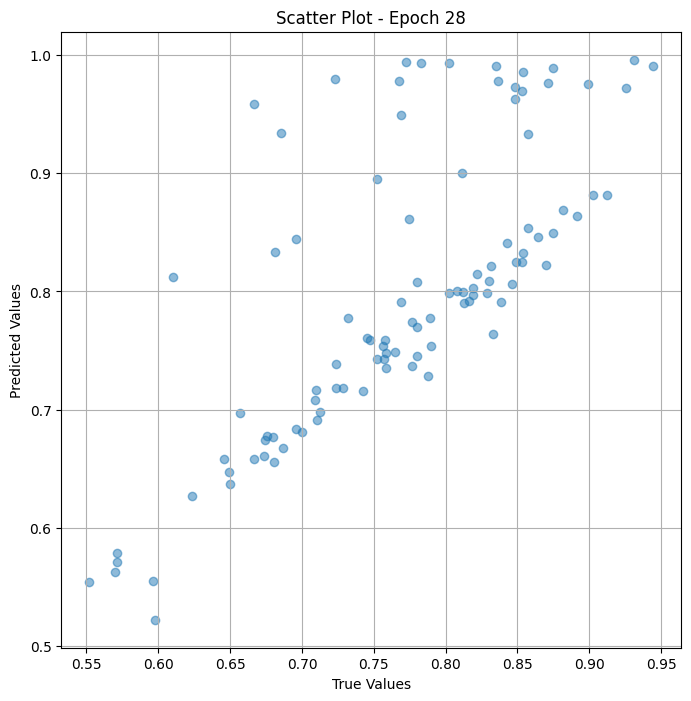


 Epoch: (29/50) Loss = 8.881734174792655e-06

 Epoch: (29/50) Loss_rmse = 0.0029802238568663597

 Epoch: (29/50) R^2 = 0.9991598129272461

 Epoch: (29/50) MAE = 0.0023049861192703247

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

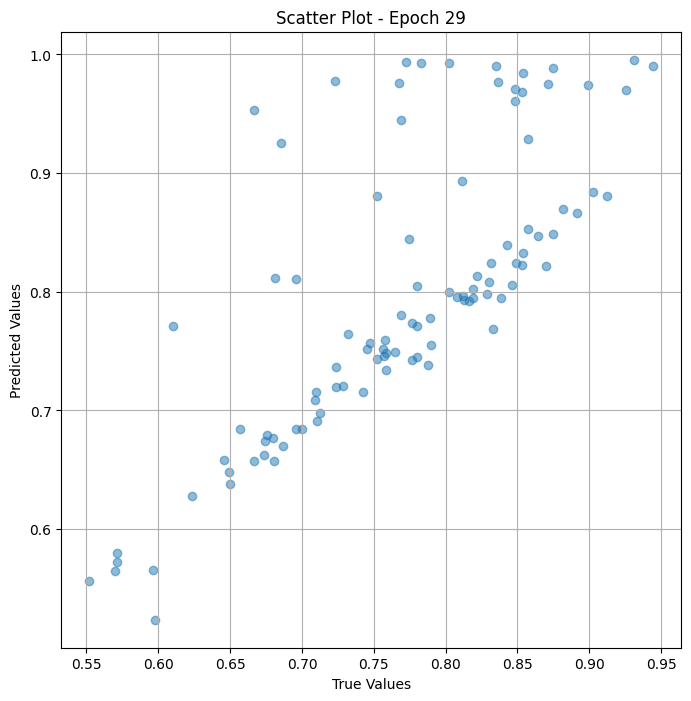


 Epoch: (30/50) Loss = 7.211141564766876e-06

 Epoch: (30/50) Loss_rmse = 0.0026853568851947784

 Epoch: (30/50) R^2 = 0.9993178248405457

 Epoch: (30/50) MAE = 0.0021680444478988647

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

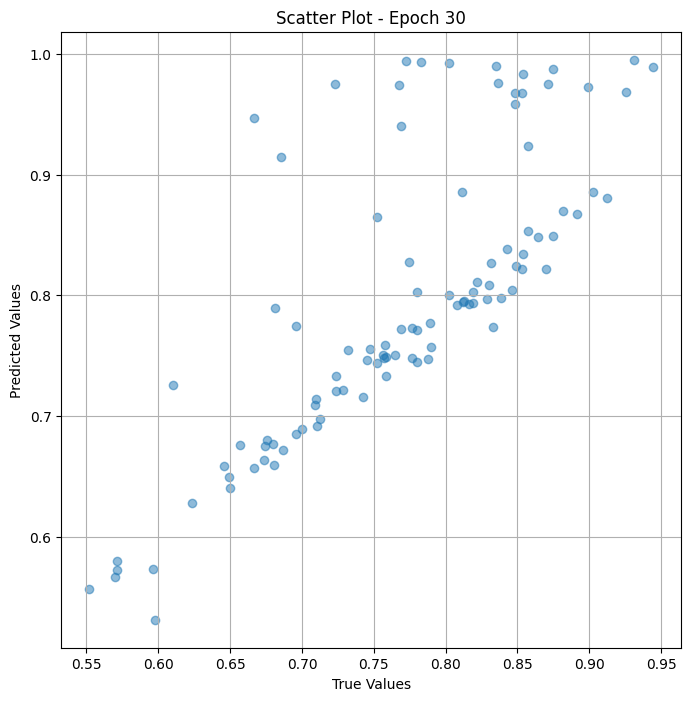


 Epoch: (31/50) Loss = 6.414883500838187e-06

 Epoch: (31/50) Loss_rmse = 0.002532762009650469

 Epoch: (31/50) R^2 = 0.9993931651115417

 Epoch: (31/50) MAE = 0.002009361982345581

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

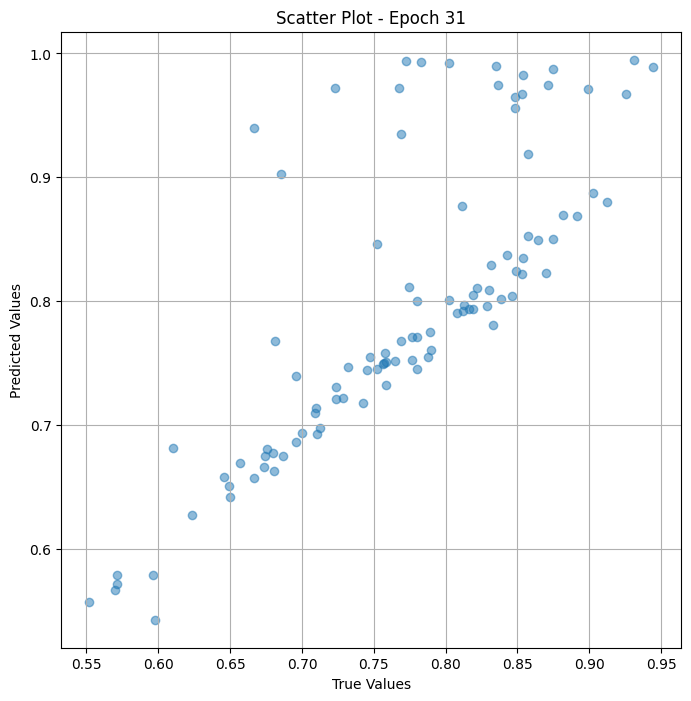


 Epoch: (32/50) Loss = 7.213945536932442e-06

 Epoch: (32/50) Loss_rmse = 0.0026858788914978504

 Epoch: (32/50) R^2 = 0.9993175864219666

 Epoch: (32/50) MAE = 0.0020208656787872314

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

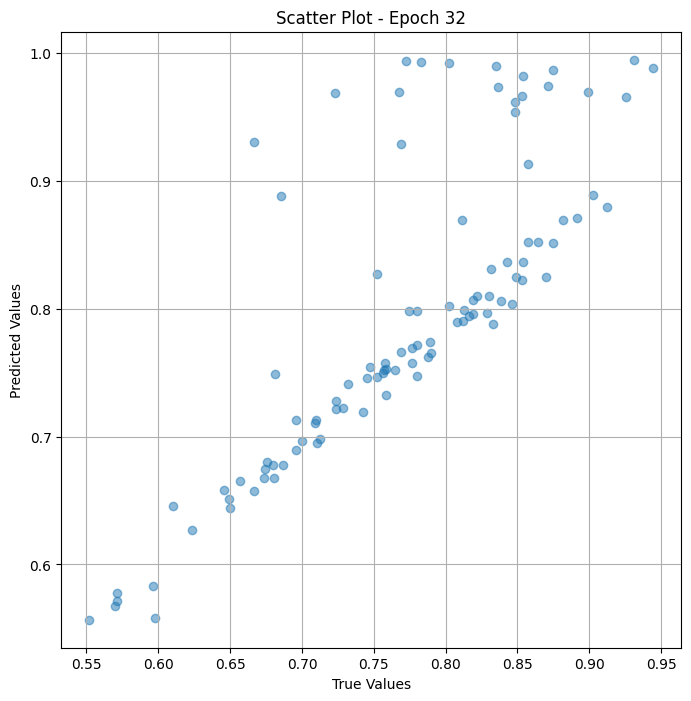


 Epoch: (33/50) Loss = 9.549009519105311e-06

 Epoch: (33/50) Loss_rmse = 0.0030901471618562937

 Epoch: (33/50) R^2 = 0.9990966320037842

 Epoch: (33/50) MAE = 0.002214178442955017

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

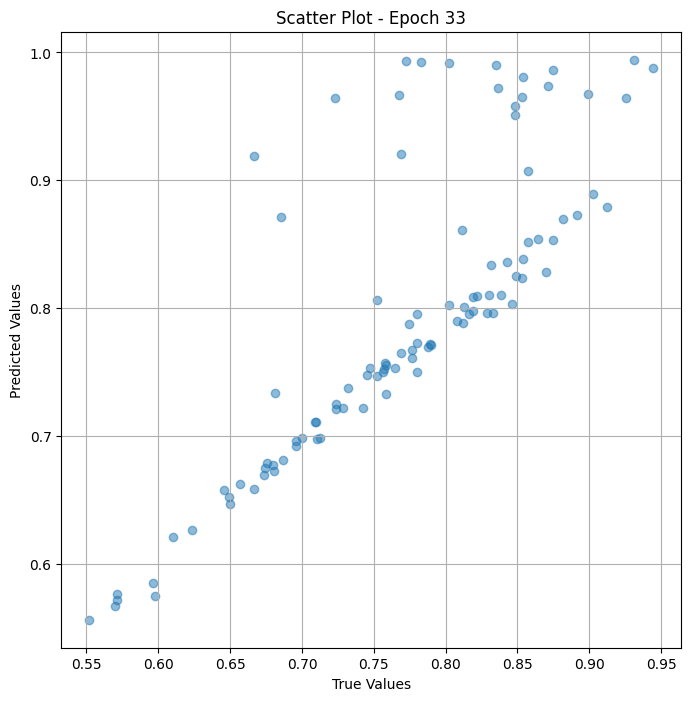


 Epoch: (34/50) Loss = 1.1871152310050093e-05

 Epoch: (34/50) Loss_rmse = 0.003445453941822052

 Epoch: (34/50) R^2 = 0.9988769888877869

 Epoch: (34/50) MAE = 0.002406299114227295

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

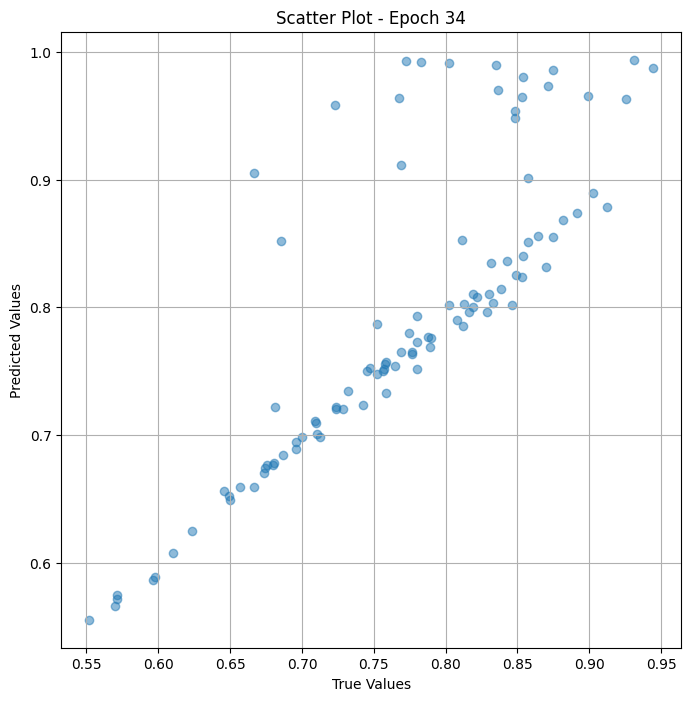


 Epoch: (35/50) Loss = 1.258897827938199e-05

 Epoch: (35/50) Loss_rmse = 0.003548095002770424

 Epoch: (35/50) R^2 = 0.9988090991973877

 Epoch: (35/50) MAE = 0.0024853646755218506

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

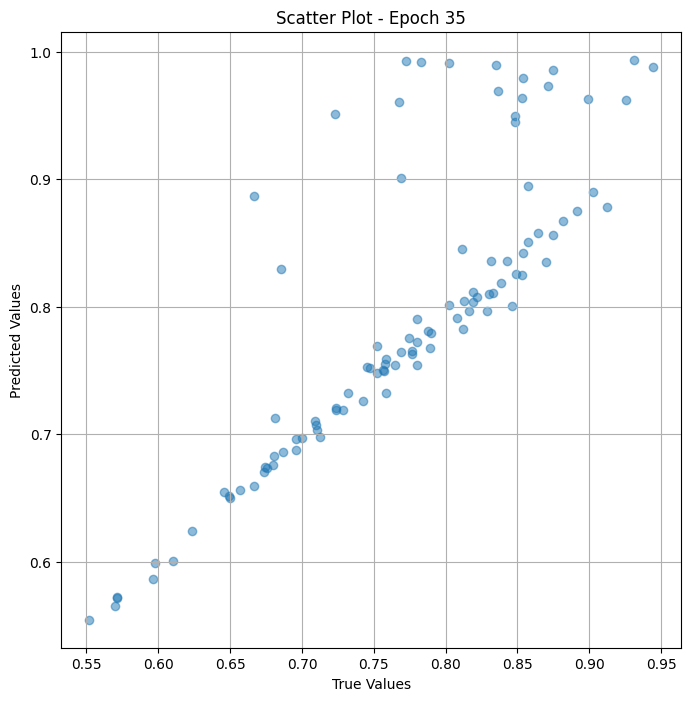


 Epoch: (36/50) Loss = 1.186476947623305e-05

 Epoch: (36/50) Loss_rmse = 0.0034445275086909533

 Epoch: (36/50) R^2 = 0.9988775849342346

 Epoch: (36/50) MAE = 0.002425253391265869

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

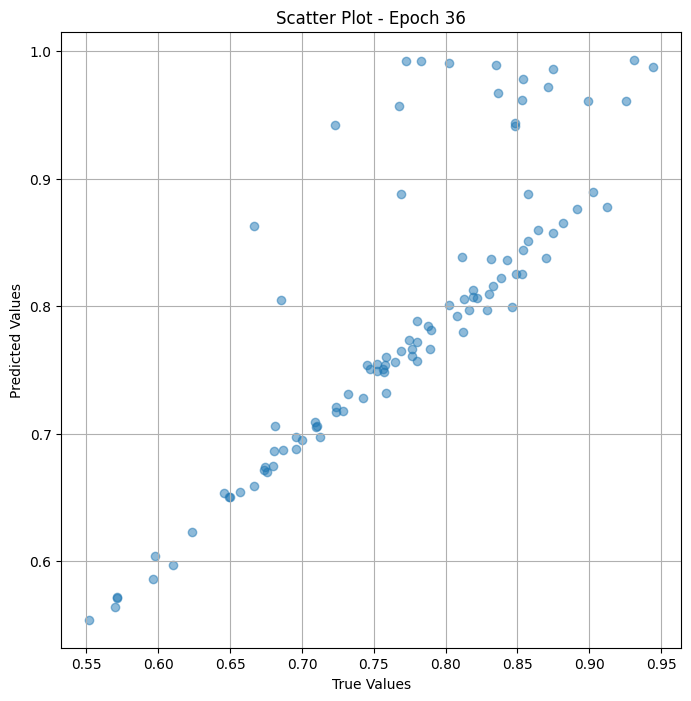


 Epoch: (37/50) Loss = 1.0707553883548826e-05

 Epoch: (37/50) Loss_rmse = 0.0032722398173063993

 Epoch: (37/50) R^2 = 0.998987078666687

 Epoch: (37/50) MAE = 0.0022828131914138794

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

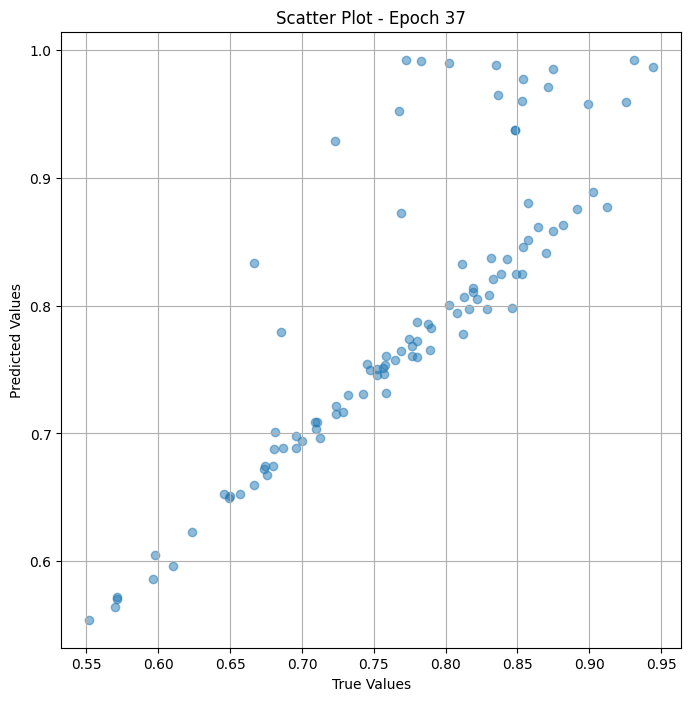


 Epoch: (38/50) Loss = 9.789844625629485e-06

 Epoch: (38/50) Loss_rmse = 0.0031288727186620235

 Epoch: (38/50) R^2 = 0.99907386302948

 Epoch: (38/50) MAE = 0.0022158175706863403

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

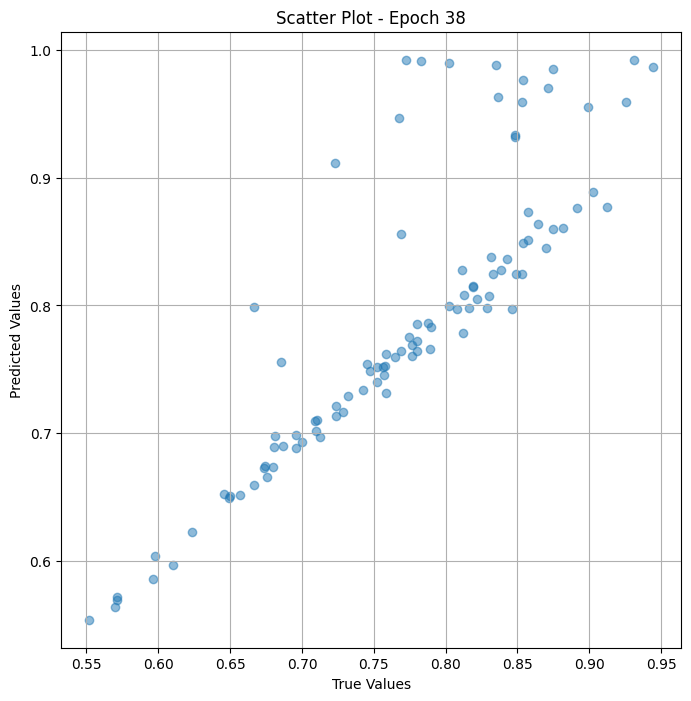


 Epoch: (39/50) Loss = 9.247393791156355e-06

 Epoch: (39/50) Loss_rmse = 0.003040952840819955

 Epoch: (39/50) R^2 = 0.9991251826286316

 Epoch: (39/50) MAE = 0.0021943747997283936

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

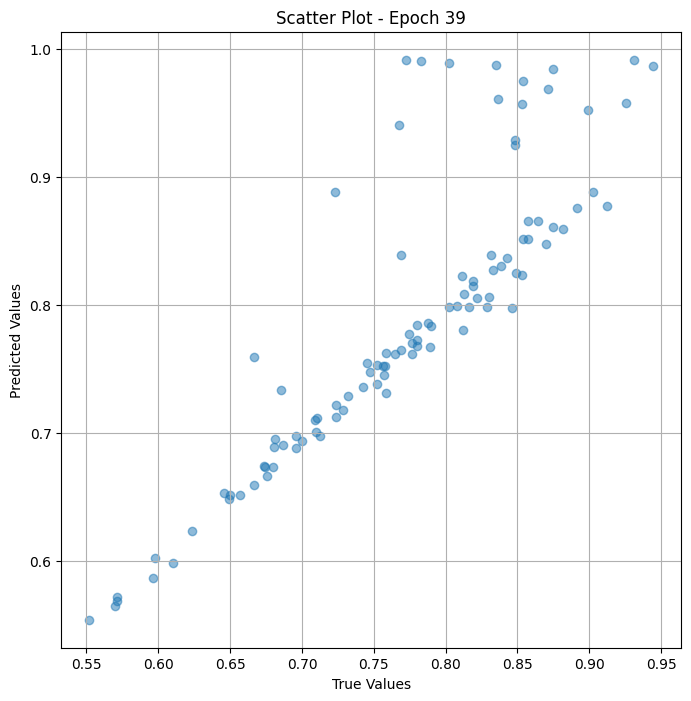


 Epoch: (40/50) Loss = 8.90516548679443e-06

 Epoch: (40/50) Loss_rmse = 0.0029841524083167315

 Epoch: (40/50) R^2 = 0.9991575479507446

 Epoch: (40/50) MAE = 0.0021170973777770996

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

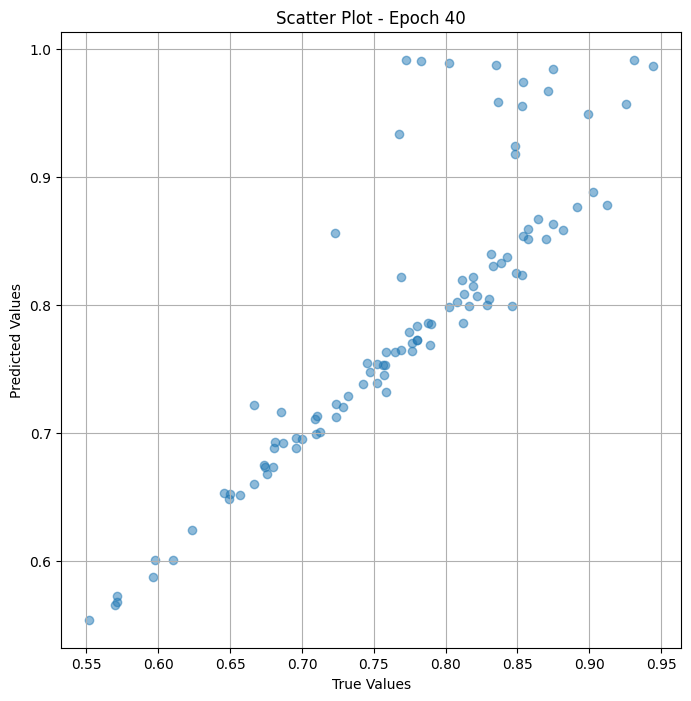


 Epoch: (41/50) Loss = 8.636127859062981e-06

 Epoch: (41/50) Loss_rmse = 0.0029387290123850107

 Epoch: (41/50) R^2 = 0.9991829991340637

 Epoch: (41/50) MAE = 0.001958891749382019

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

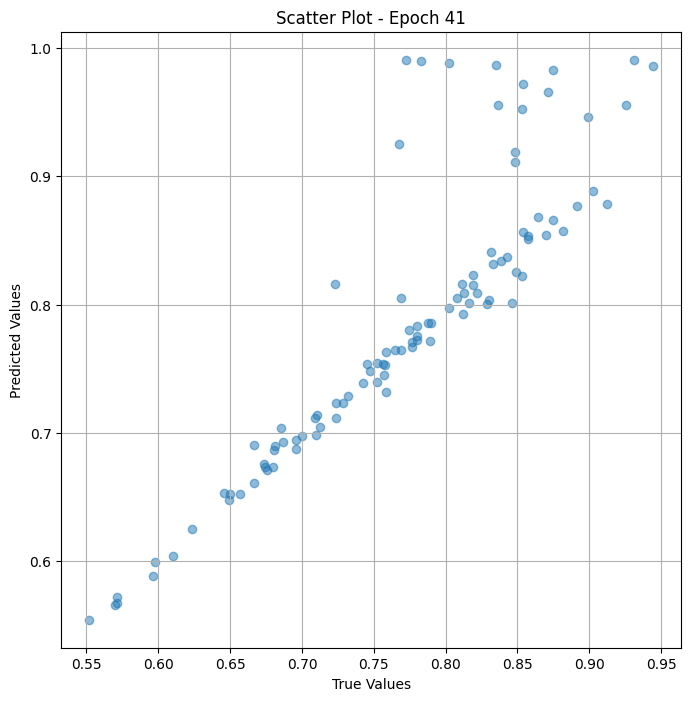


 Epoch: (42/50) Loss = 8.498770512233023e-06

 Epoch: (42/50) Loss_rmse = 0.0029152650386095047

 Epoch: (42/50) R^2 = 0.9991959929466248

 Epoch: (42/50) MAE = 0.0017693489789962769

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

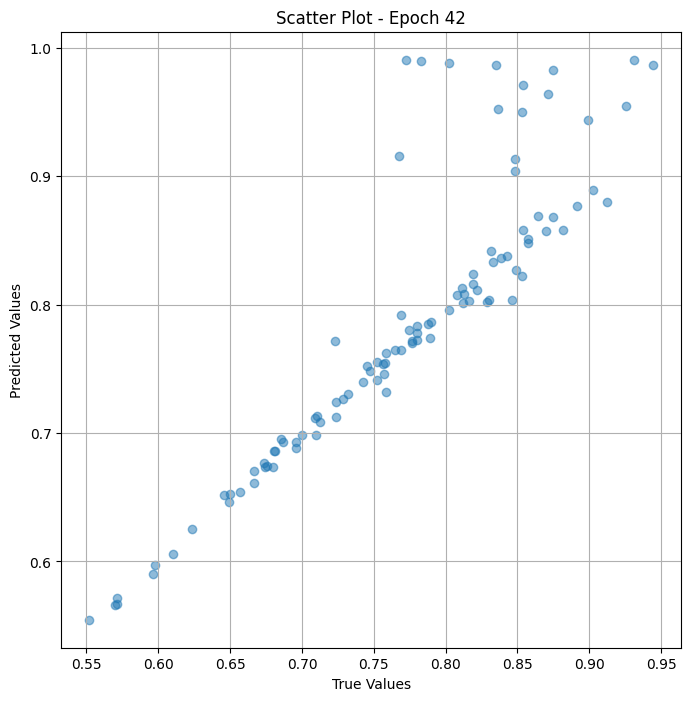


 Epoch: (43/50) Loss = 8.994549716589972e-06

 Epoch: (43/50) Loss_rmse = 0.0029990915209054947

 Epoch: (43/50) R^2 = 0.9991490840911865

 Epoch: (43/50) MAE = 0.0019317865371704102

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

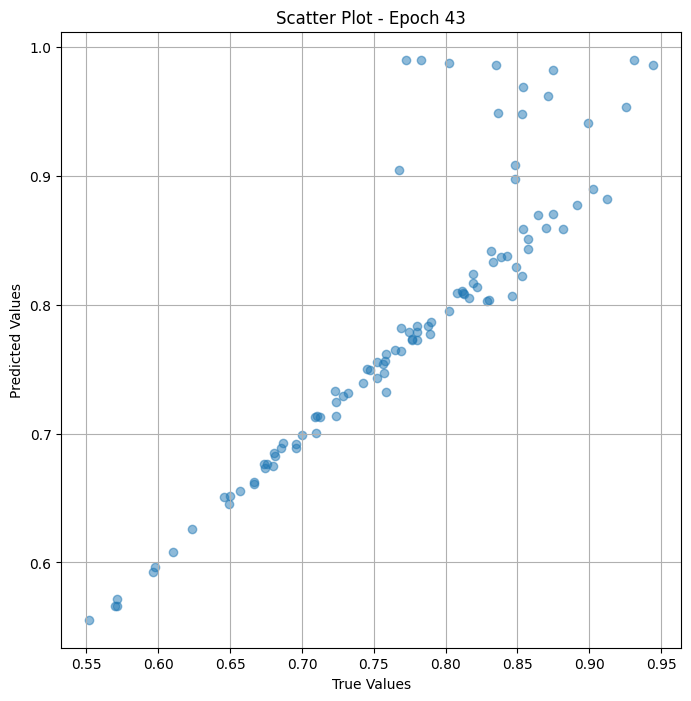


 Epoch: (44/50) Loss = 1.041691666614497e-05

 Epoch: (44/50) Loss_rmse = 0.0032275249250233173

 Epoch: (44/50) R^2 = 0.9990145564079285

 Epoch: (44/50) MAE = 0.0022059231996536255

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

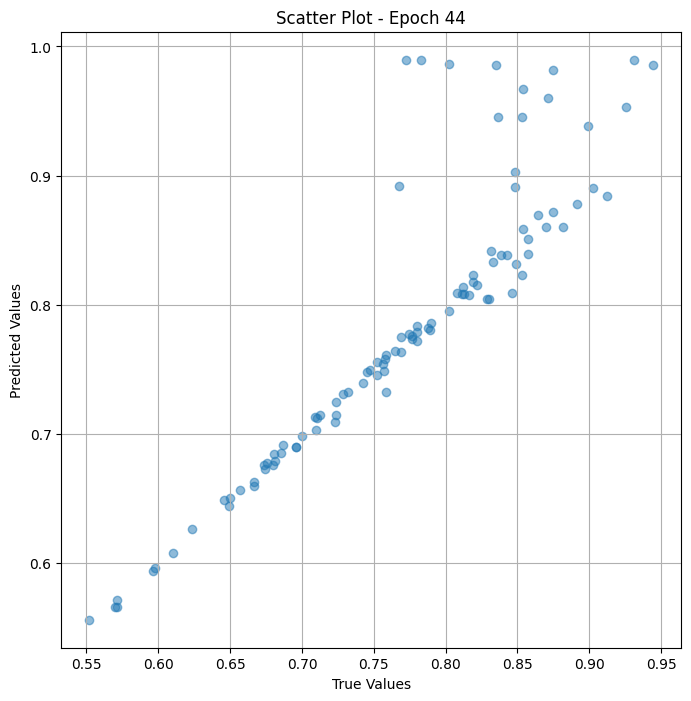


 Epoch: (45/50) Loss = 1.197256915475009e-05

 Epoch: (45/50) Loss_rmse = 0.0034601399675011635

 Epoch: (45/50) R^2 = 0.998867392539978

 Epoch: (45/50) MAE = 0.002380460500717163

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

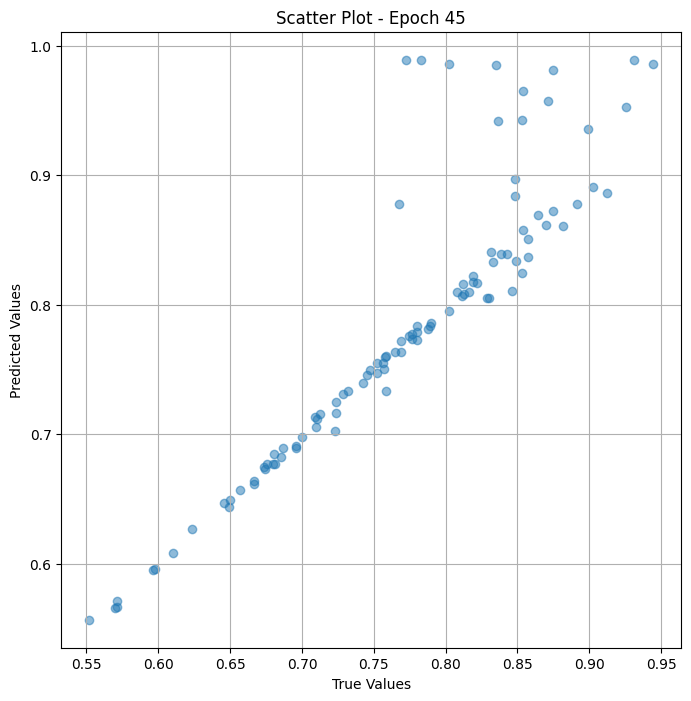


 Epoch: (46/50) Loss = 1.251522553502582e-05

 Epoch: (46/50) Loss_rmse = 0.0035376865416765213

 Epoch: (46/50) R^2 = 0.9988160729408264

 Epoch: (46/50) MAE = 0.0023268908262252808

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

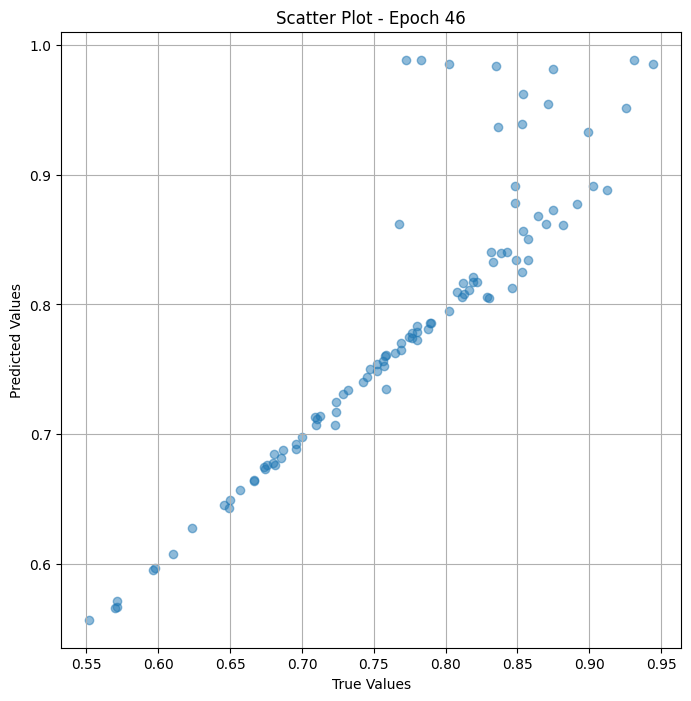


 Epoch: (47/50) Loss = 1.156687085313024e-05

 Epoch: (47/50) Loss_rmse = 0.0034010102972388268

 Epoch: (47/50) R^2 = 0.9989057779312134

 Epoch: (47/50) MAE = 0.0021927952766418457

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

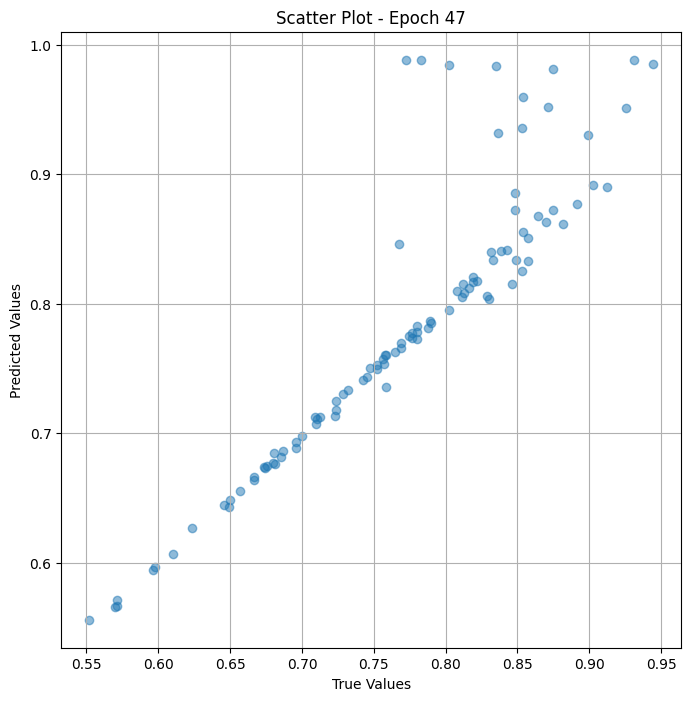


 Epoch: (48/50) Loss = 9.635538845031988e-06

 Epoch: (48/50) Loss_rmse = 0.0031041165348142385

 Epoch: (48/50) R^2 = 0.99908846616745

 Epoch: (48/50) MAE = 0.001949995756149292

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8536

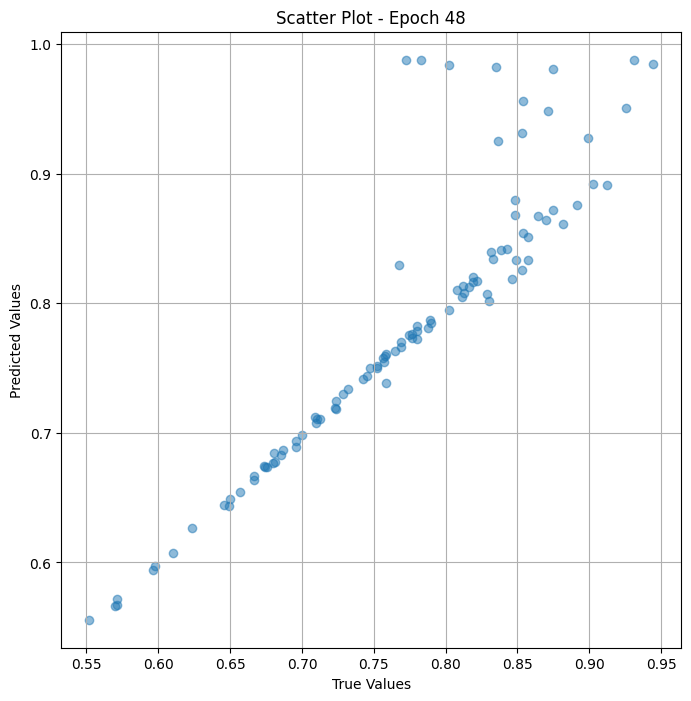


 Epoch: (49/50) Loss = 7.5953034865960944e-06

 Epoch: (49/50) Loss_rmse = 0.0027559578884392977

 Epoch: (49/50) R^2 = 0.9992814660072327

 Epoch: (49/50) MAE = 0.001706436276435852

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

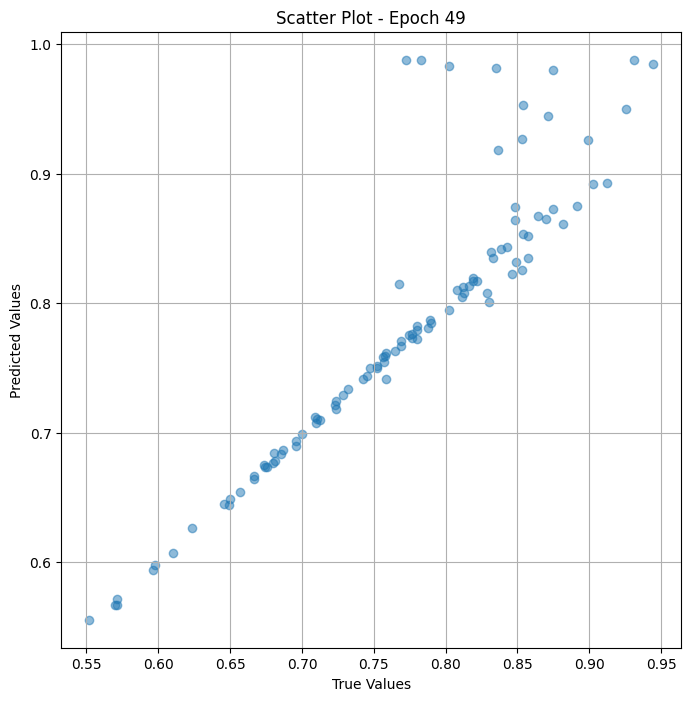


 Epoch: (50/50) Loss = 5.890155989618506e-06

 Epoch: (50/50) Loss_rmse = 0.0024269644636660814

 Epoch: (50/50) R^2 = 0.9994428157806396

 Epoch: (50/50) MAE = 0.0015106201171875

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8536

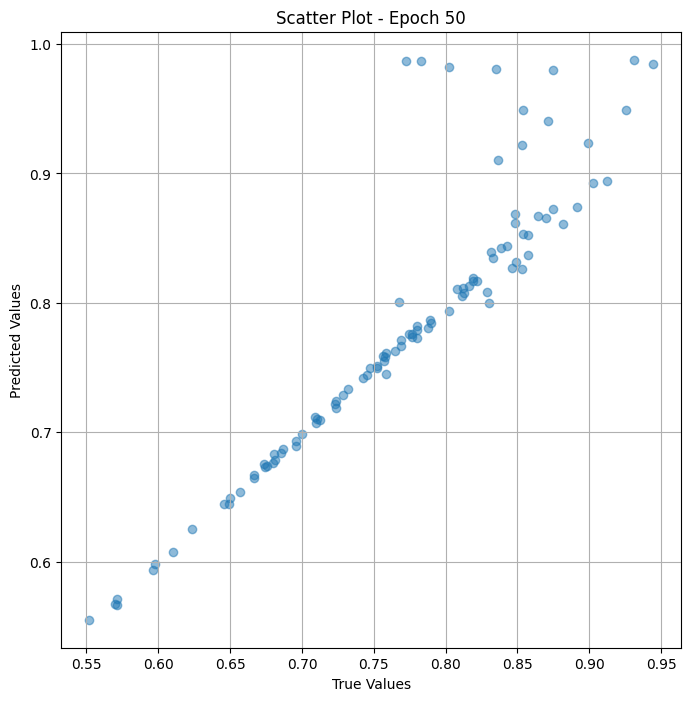

In [ ]:
# Training the model and save weights
fit(50, model_test, train_dl_test)
torch.save(model.state_dict(), "model_weights_vr_test")

In [ ]:
 true_values_list = [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256]

 predicted_values_list= [0.82593405, 0.9408416, 0.86694086, 0.7104337, 0.68750346, 0.8945301, 0.79408014]

import numpy as np
from scipy.stats import spearmanr


spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.9642857142857145 0.0004541491691941689


# Finetune


## Train

In [ ]:
# Load the pre-trained ResNet model
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
for param in model_Res.parameters():
    param.requires_grad = True

# Add your custom layers for fine-tuning
#num_features = model_Res[0][-1].in_features  # Get the number of features in the last layer of ResNet

custom_layers = [
    nn.Flatten(),
    nn.Linear(2048, 512),  # Example: add a fully connected layer with 512 units
    nn.ReLU(),
    nn.Dropout(0.5),  # Example: add dropout for regularization
    nn.Linear(512, 1)  # Example: add the output layer with your desired number of classes
]

# Create a new model by combining ResNet and custom layers
fine_tuned_model = nn.Sequential(
    model_Res,
    *custom_layers
)

# Optionally, you can print the fine-tuned model architecture
print(fine_tuned_model)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256

In [ ]:
# Load the pre-trained ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')

# Freeze some of the layers
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = True

# Extract the feature extractor
feature_extractor = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224-in21k')

# Remove the classification head (top layers) from the model
model_trans_top = nn.Sequential(*list(model_trans.children())[:-2])

# Access the last linear layer and adjust its bias
last_linear_layer = list(model_trans.children())[-1]
# Assuming the last layer is a Linear layer
if isinstance(last_linear_layer, nn.Linear):
    # Adjust the bias as needed
    new_bias = torch.tensor([2.0])
    last_linear_layer.bias.data = new_bias

# Add Sigmoid activation
mymodel = nn.Sequential(last_linear_layer, nn.Sigmoid())

# Optionally, you can print the modified model architecture
print(mymodel)


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

Sequential(
  (0): ViTPooler(
    (dense): Linear(in_features=768, out_features=768, bias=True)
    (activation): Tanh()
  )
  (1): Sigmoid()
)


In [ ]:
# Merge the two models
class model_merge_fine(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model = model_merge_fine(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model = to_device(model, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.04932519793510437

 Epoch: (1/50) Loss_rmse = 0.22209276258945465

 Epoch: (1/50) R^2 = -9.295802116394043

 Epoch: (1/50) MAE = 0.21391865611076355

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.699029

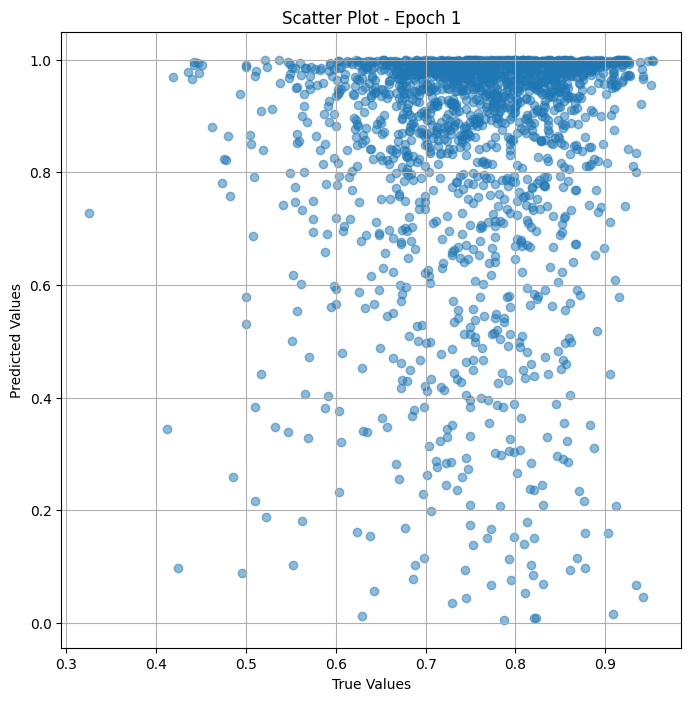


 Epoch: (2/50) Loss = 0.045045893639326096

 Epoch: (2/50) Loss_rmse = 0.21224017441272736

 Epoch: (2/50) R^2 = -8.402569770812988

 Epoch: (2/50) MAE = 0.20453417301177979

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.69902

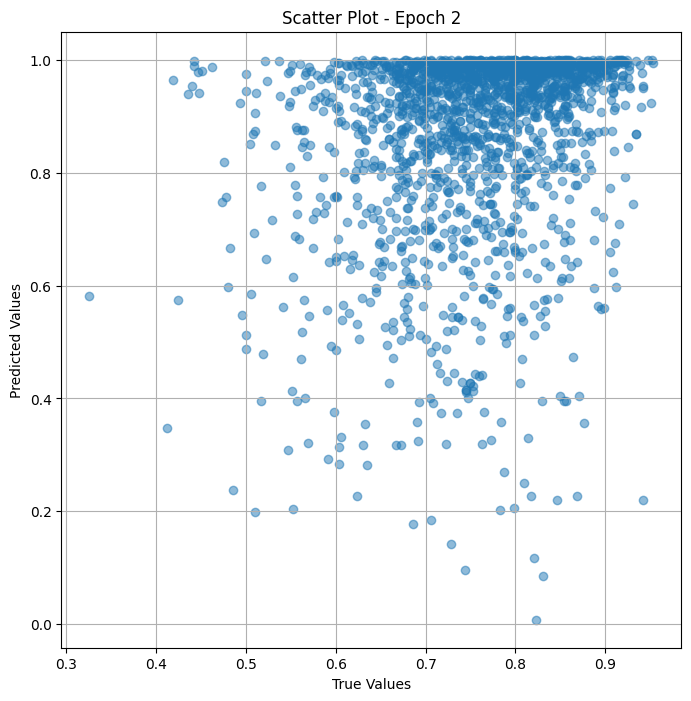


 Epoch: (3/50) Loss = 0.03844290226697922

 Epoch: (3/50) Loss_rmse = 0.19606861472129822

 Epoch: (3/50) R^2 = -7.024306297302246

 Epoch: (3/50) MAE = 0.18832767009735107

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.699029

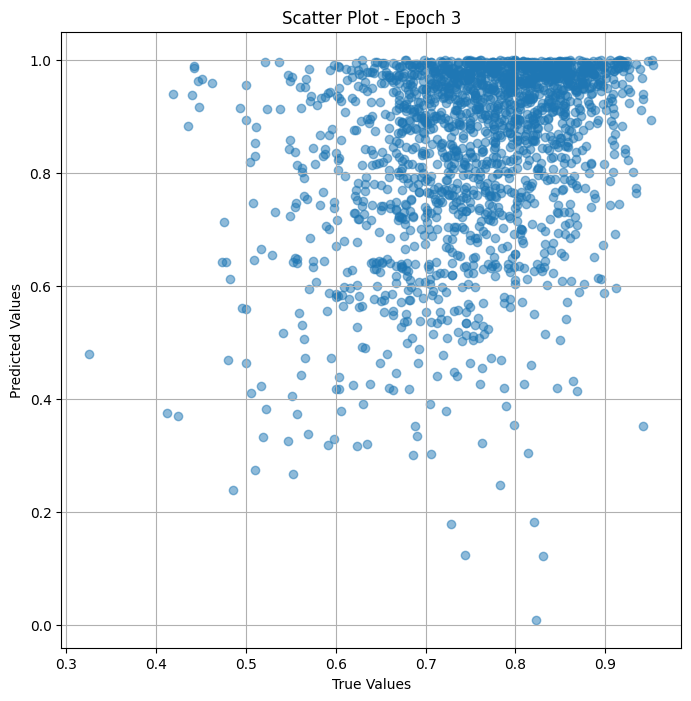


 Epoch: (4/50) Loss = 0.030854102224111557

 Epoch: (4/50) Loss_rmse = 0.1756533533334732

 Epoch: (4/50) R^2 = -5.440272808074951

 Epoch: (4/50) MAE = 0.16818475723266602

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.699029

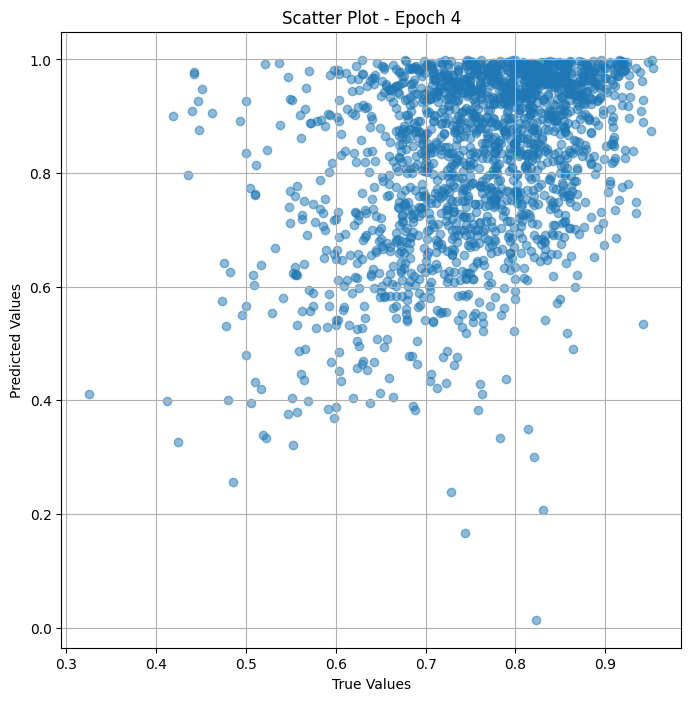


 Epoch: (5/50) Loss = 0.02354322001338005

 Epoch: (5/50) Loss_rmse = 0.153438001871109

 Epoch: (5/50) R^2 = -3.9142494201660156

 Epoch: (5/50) MAE = 0.14691093564033508

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6990291

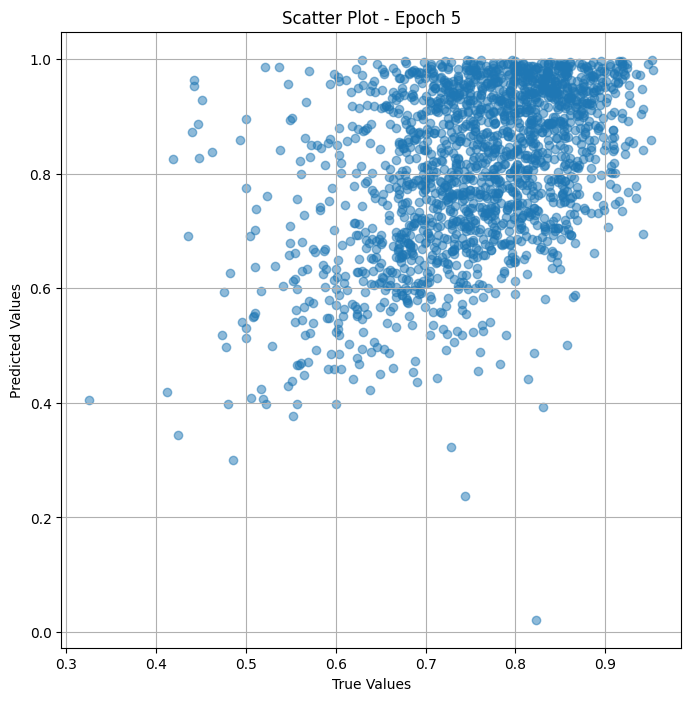


 Epoch: (6/50) Loss = 0.01683777943253517

 Epoch: (6/50) Loss_rmse = 0.1297604739665985

 Epoch: (6/50) R^2 = -2.5146021842956543

 Epoch: (6/50) MAE = 0.12326864898204803

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.699029

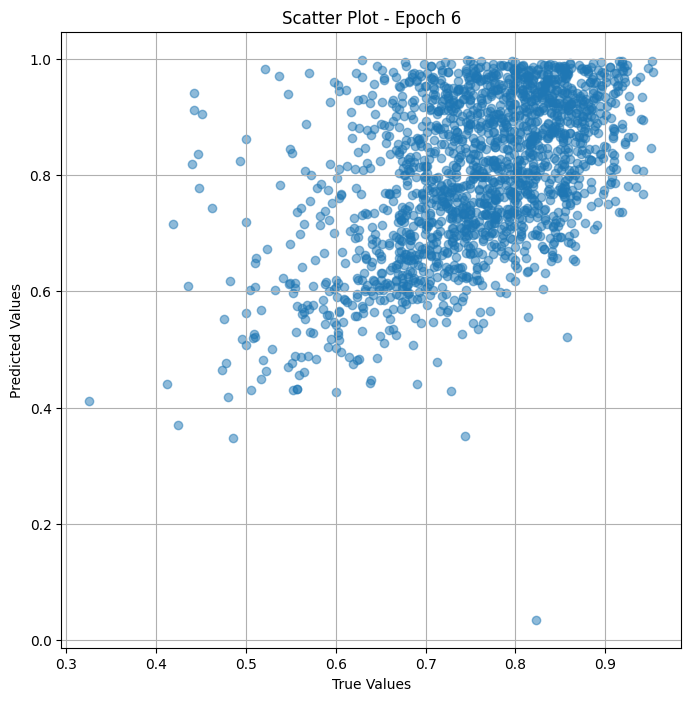


 Epoch: (7/50) Loss = 0.01164383627474308

 Epoch: (7/50) Loss_rmse = 0.10790660977363586

 Epoch: (7/50) R^2 = -1.4304542541503906

 Epoch: (7/50) MAE = 0.0997239276766777

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.699029

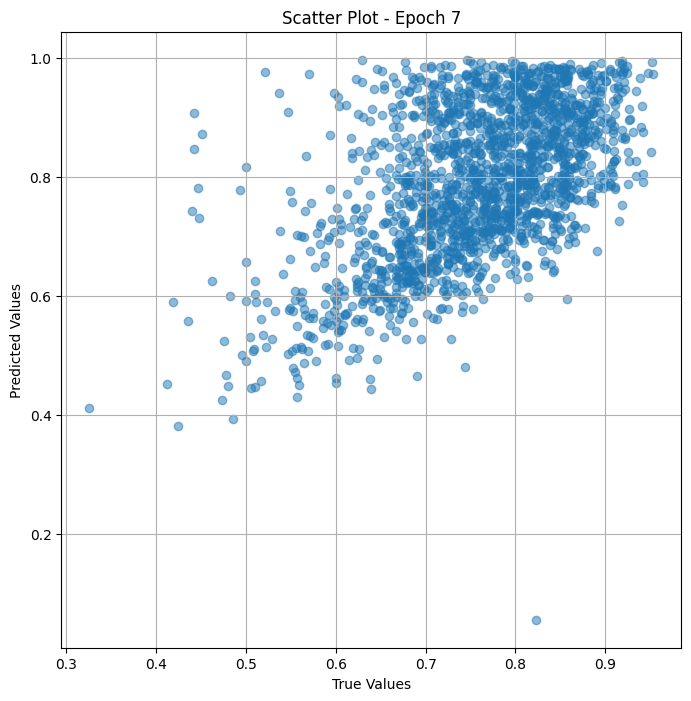


 Epoch: (8/50) Loss = 0.00808675866574049

 Epoch: (8/50) Loss_rmse = 0.08992640674114227

 Epoch: (8/50) R^2 = -0.6879743337631226

 Epoch: (8/50) MAE = 0.08130516856908798

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.69902

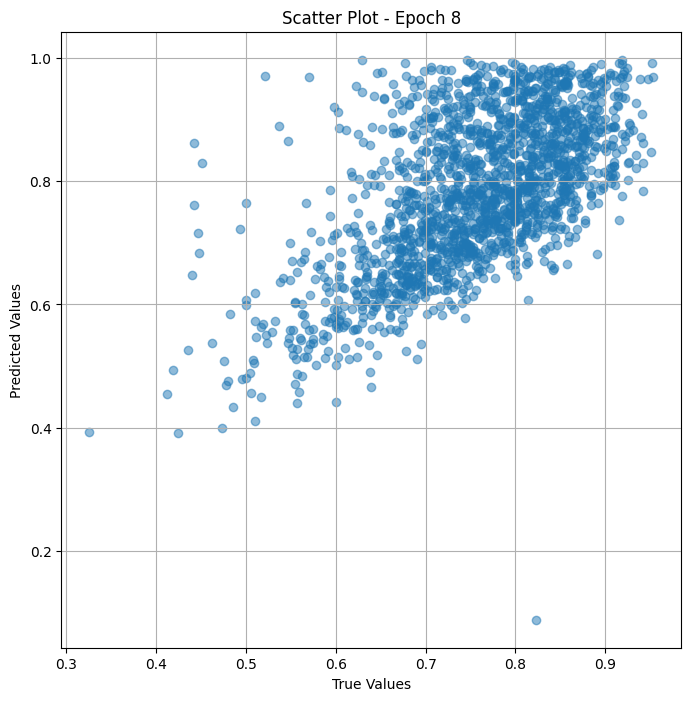


 Epoch: (9/50) Loss = 0.0059823812916874886

 Epoch: (9/50) Loss_rmse = 0.07734585553407669

 Epoch: (9/50) R^2 = -0.24872112274169922

 Epoch: (9/50) MAE = 0.06653902679681778

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.69

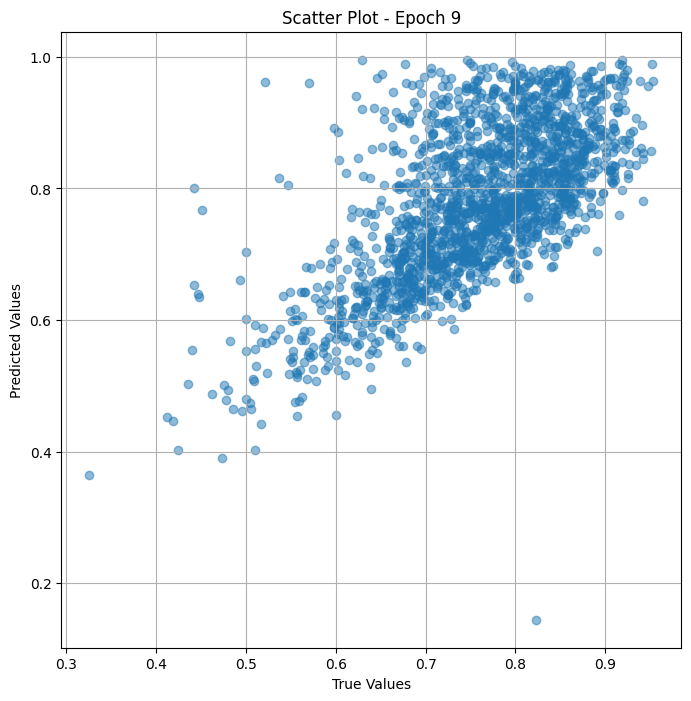


 Epoch: (10/50) Loss = 0.00487474724650383

 Epoch: (10/50) Loss_rmse = 0.0698193907737732

 Epoch: (10/50) R^2 = -0.017521142959594727

 Epoch: (10/50) MAE = 0.05574586242437363

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

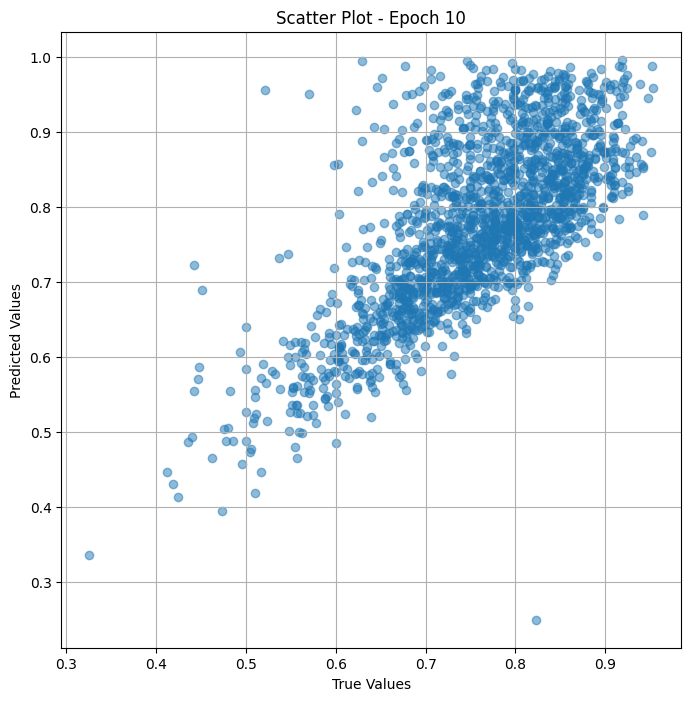


 Epoch: (11/50) Loss = 0.004093802534043789

 Epoch: (11/50) Loss_rmse = 0.06398282945156097

 Epoch: (11/50) R^2 = 0.14548784494400024

 Epoch: (11/50) MAE = 0.0482296347618103

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

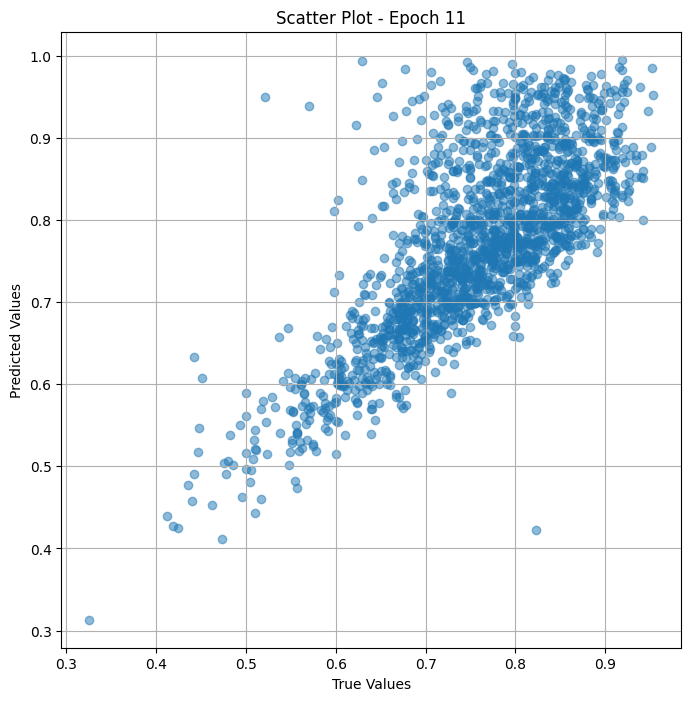


 Epoch: (12/50) Loss = 0.0034108140971511602

 Epoch: (12/50) Loss_rmse = 0.058402176946401596

 Epoch: (12/50) R^2 = 0.28805017471313477

 Epoch: (12/50) MAE = 0.04111577570438385

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

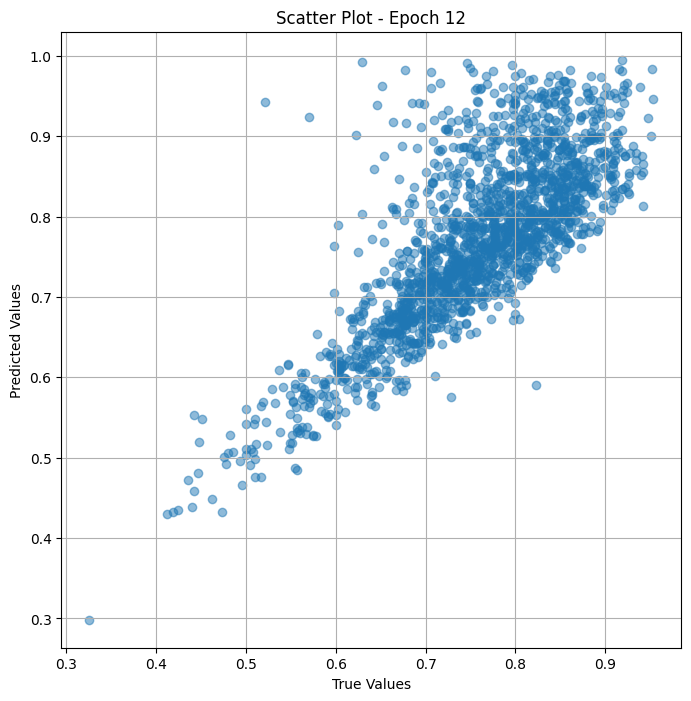


 Epoch: (13/50) Loss = 0.002927975030615926

 Epoch: (13/50) Loss_rmse = 0.05411076545715332

 Epoch: (13/50) R^2 = 0.3888346552848816

 Epoch: (13/50) MAE = 0.036711737513542175

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

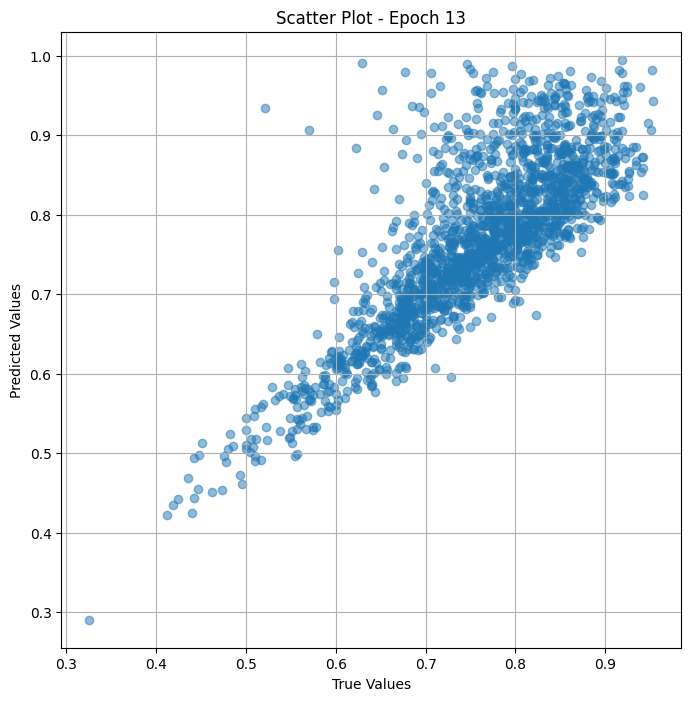


 Epoch: (14/50) Loss = 0.0025398931466042995

 Epoch: (14/50) Loss_rmse = 0.0503973513841629

 Epoch: (14/50) R^2 = 0.4698401689529419

 Epoch: (14/50) MAE = 0.03352835029363632

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

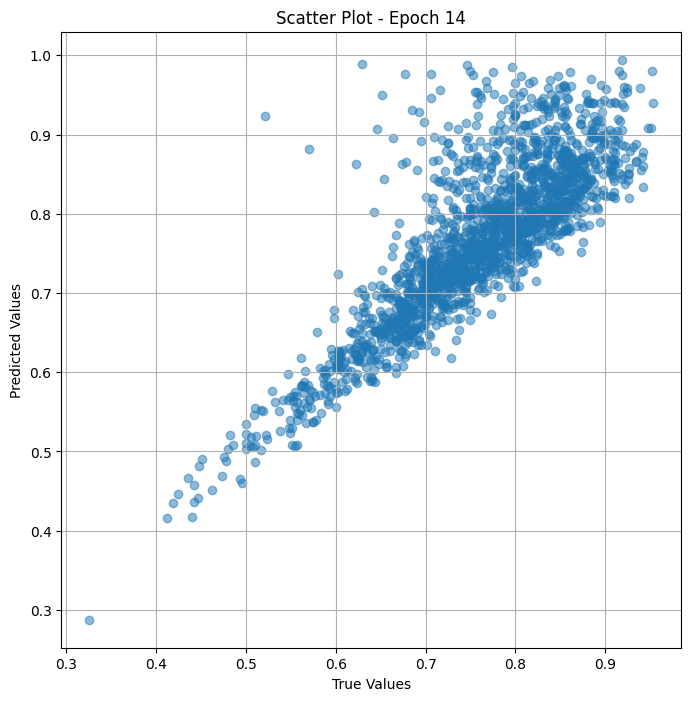


 Epoch: (15/50) Loss = 0.0022044903598725796

 Epoch: (15/50) Loss_rmse = 0.04695200175046921

 Epoch: (15/50) R^2 = 0.5398498773574829

 Epoch: (15/50) MAE = 0.030801504850387573

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

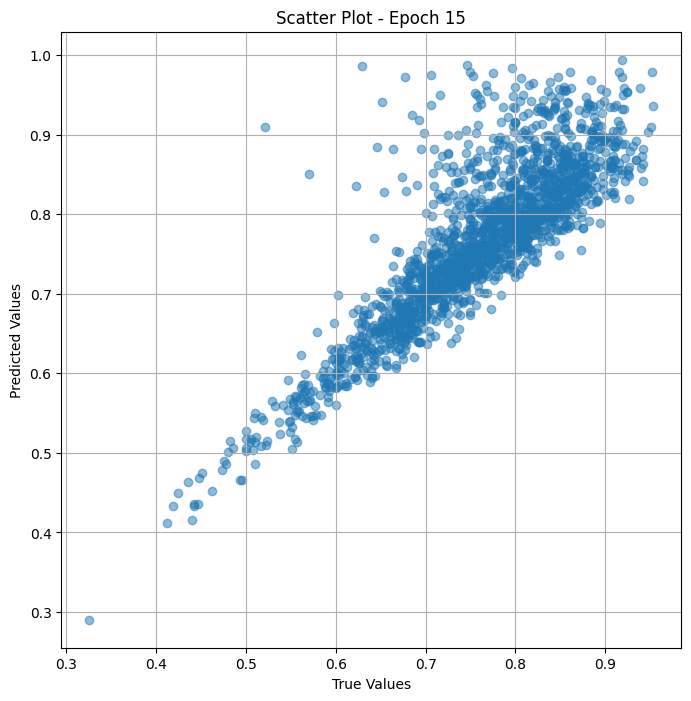


 Epoch: (16/50) Loss = 0.0019122192170470953

 Epoch: (16/50) Loss_rmse = 0.04372892901301384

 Epoch: (16/50) R^2 = 0.6008565425872803

 Epoch: (16/50) MAE = 0.02790389209985733

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

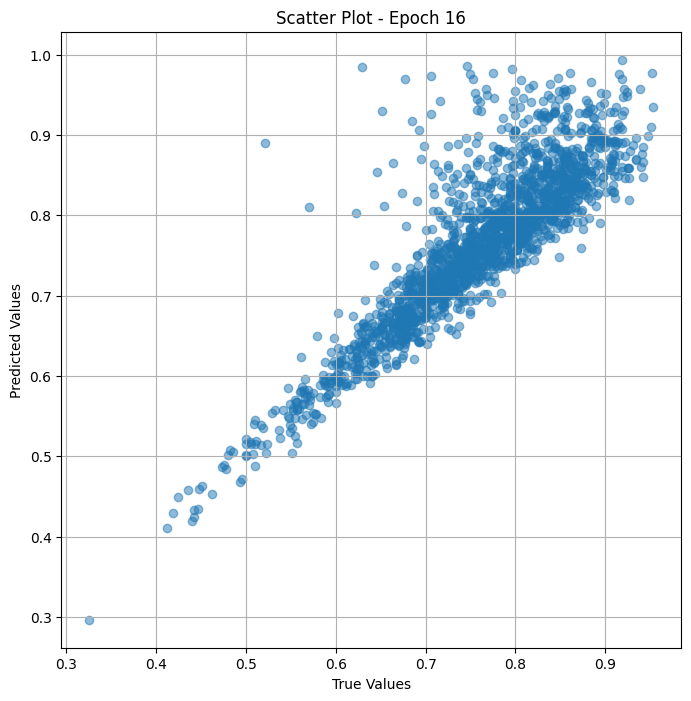


 Epoch: (17/50) Loss = 0.0016903758514672518

 Epoch: (17/50) Loss_rmse = 0.04111418128013611

 Epoch: (17/50) R^2 = 0.6471625566482544

 Epoch: (17/50) MAE = 0.025328293442726135

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

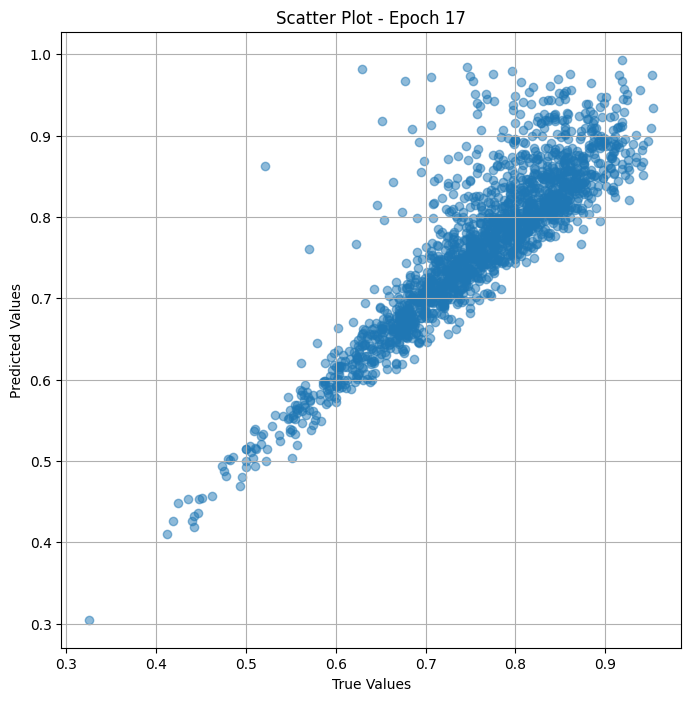


 Epoch: (18/50) Loss = 0.001579469651915133

 Epoch: (18/50) Loss_rmse = 0.03974254056811333

 Epoch: (18/50) R^2 = 0.6703124046325684

 Epoch: (18/50) MAE = 0.02382679283618927

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

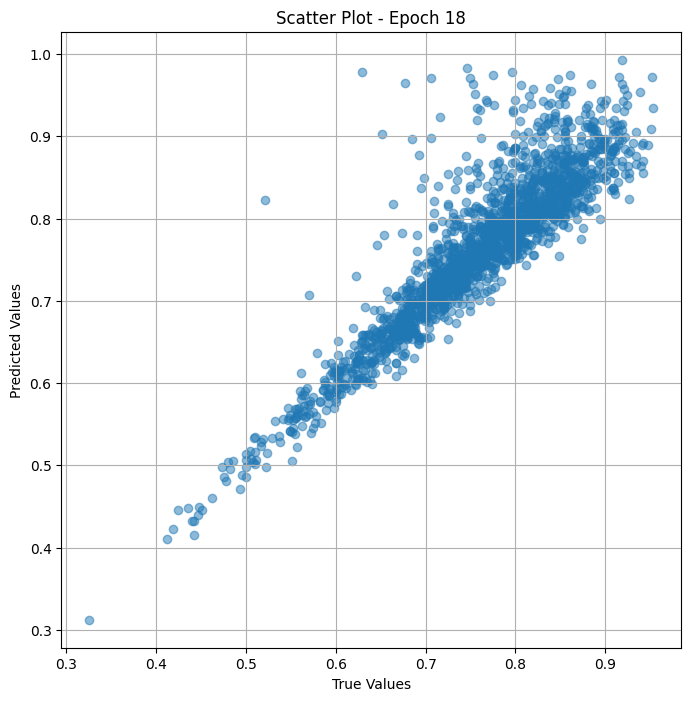


 Epoch: (19/50) Loss = 0.0015409267507493496

 Epoch: (19/50) Loss_rmse = 0.03925463929772377

 Epoch: (19/50) R^2 = 0.6783576011657715

 Epoch: (19/50) MAE = 0.02252989262342453

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

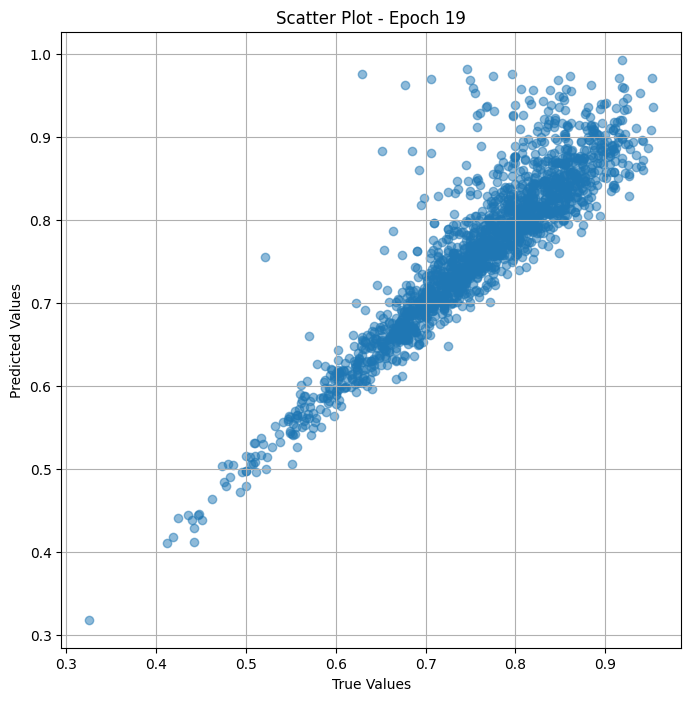


 Epoch: (20/50) Loss = 0.00160897895693779

 Epoch: (20/50) Loss_rmse = 0.040112078189849854

 Epoch: (20/50) R^2 = 0.6641528010368347

 Epoch: (20/50) MAE = 0.023147590458393097

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

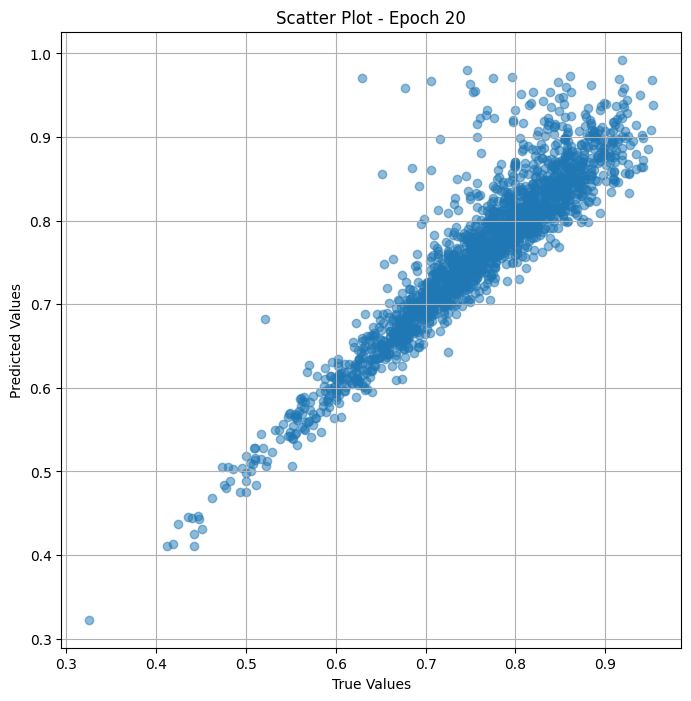


 Epoch: (21/50) Loss = 0.0017616397235542536

 Epoch: (21/50) Loss_rmse = 0.04197189211845398

 Epoch: (21/50) R^2 = 0.6322874426841736

 Epoch: (21/50) MAE = 0.024721696972846985

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

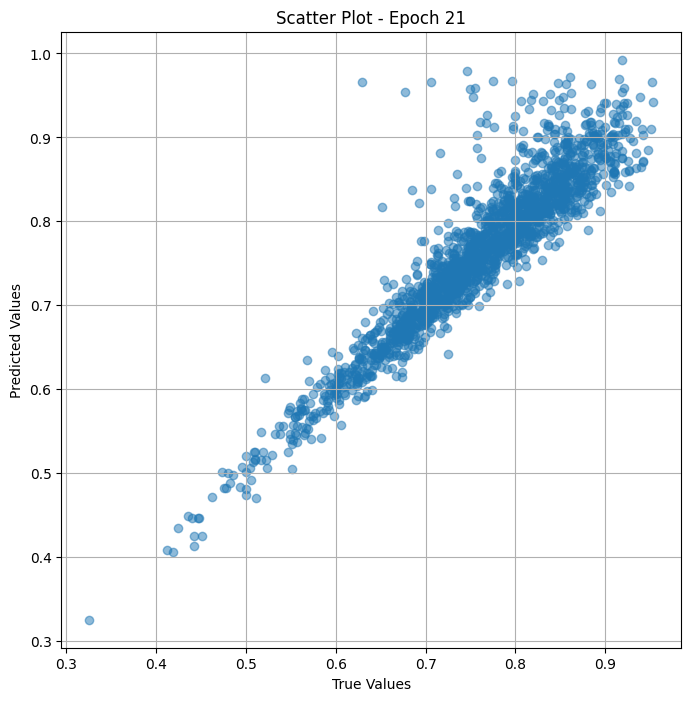


 Epoch: (22/50) Loss = 0.001982802525162697

 Epoch: (22/50) Loss_rmse = 0.044528670608997345

 Epoch: (22/50) R^2 = 0.5861234664916992

 Epoch: (22/50) MAE = 0.027042575180530548

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

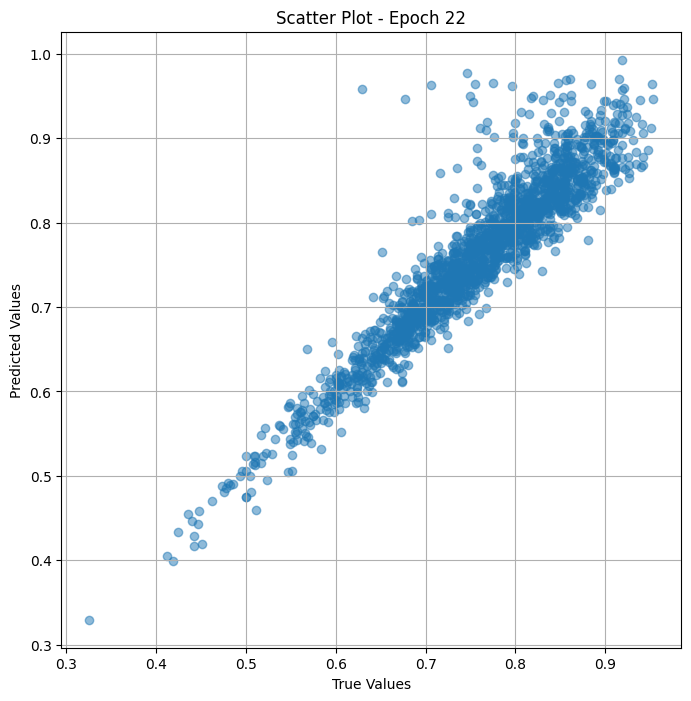


 Epoch: (23/50) Loss = 0.0022547077387571335

 Epoch: (23/50) Loss_rmse = 0.047483764588832855

 Epoch: (23/50) R^2 = 0.5293678045272827

 Epoch: (23/50) MAE = 0.030468031764030457

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

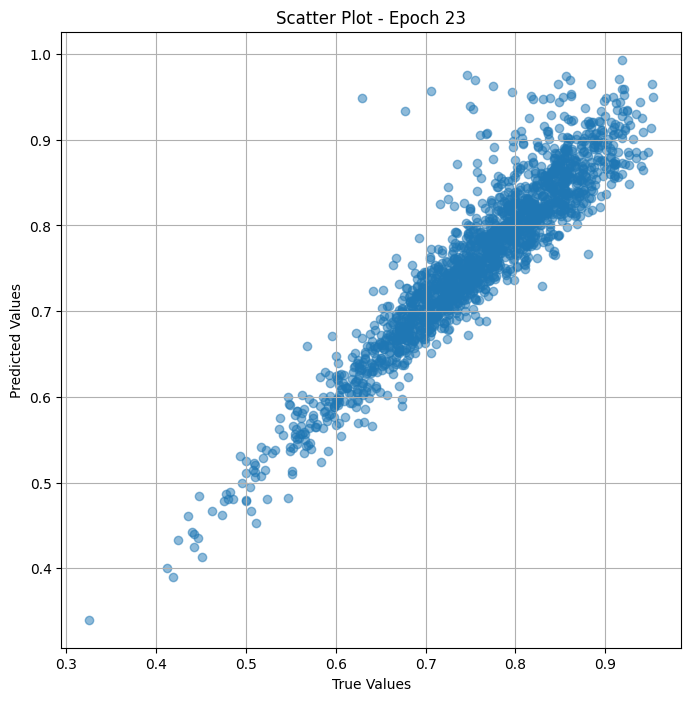


 Epoch: (24/50) Loss = 0.0025738871190696955

 Epoch: (24/50) Loss_rmse = 0.05073349177837372

 Epoch: (24/50) R^2 = 0.4627445340156555

 Epoch: (24/50) MAE = 0.03690395504236221

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

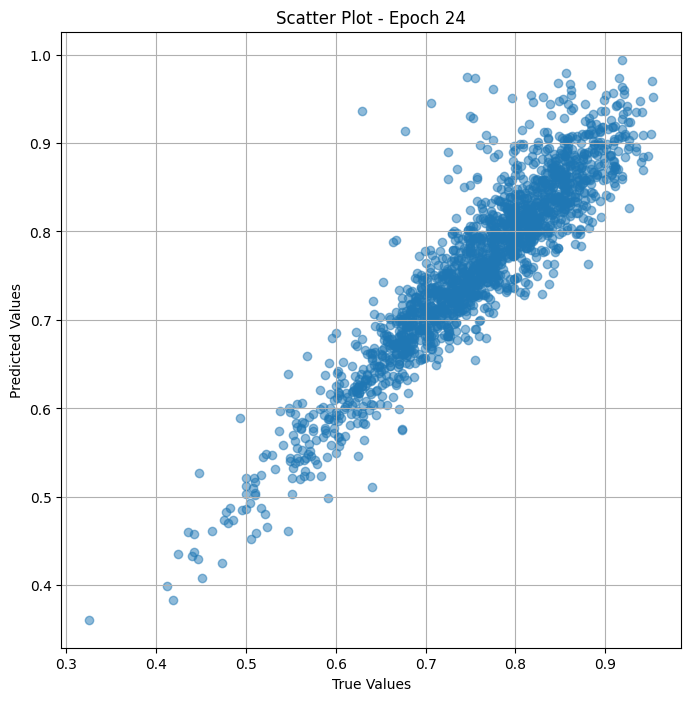


 Epoch: (25/50) Loss = 0.0032072162721306086

 Epoch: (25/50) Loss_rmse = 0.05663229152560234

 Epoch: (25/50) R^2 = 0.3305477499961853

 Epoch: (25/50) MAE = 0.0438956692814827

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

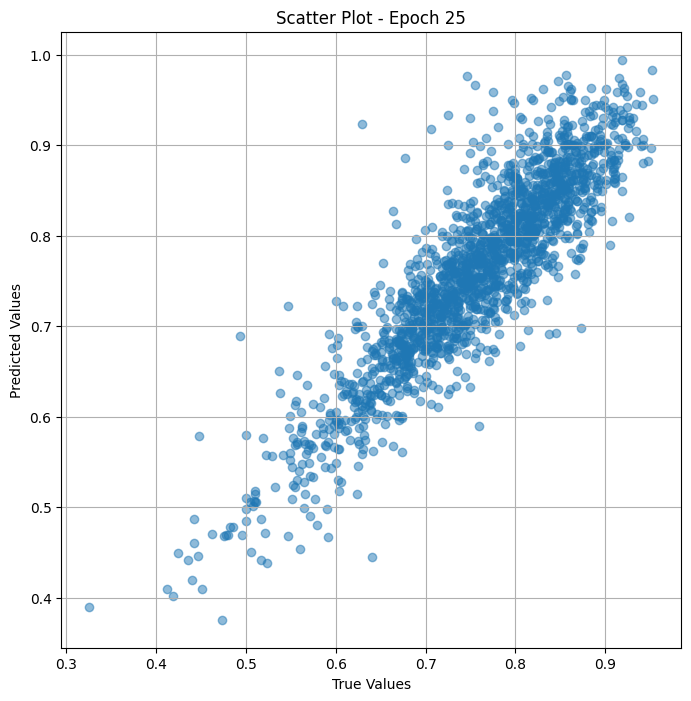


 Epoch: (26/50) Loss = 0.0033430629409849644

 Epoch: (26/50) Loss_rmse = 0.05781922489404678

 Epoch: (26/50) R^2 = 0.3021920323371887

 Epoch: (26/50) MAE = 0.045250117778778076

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

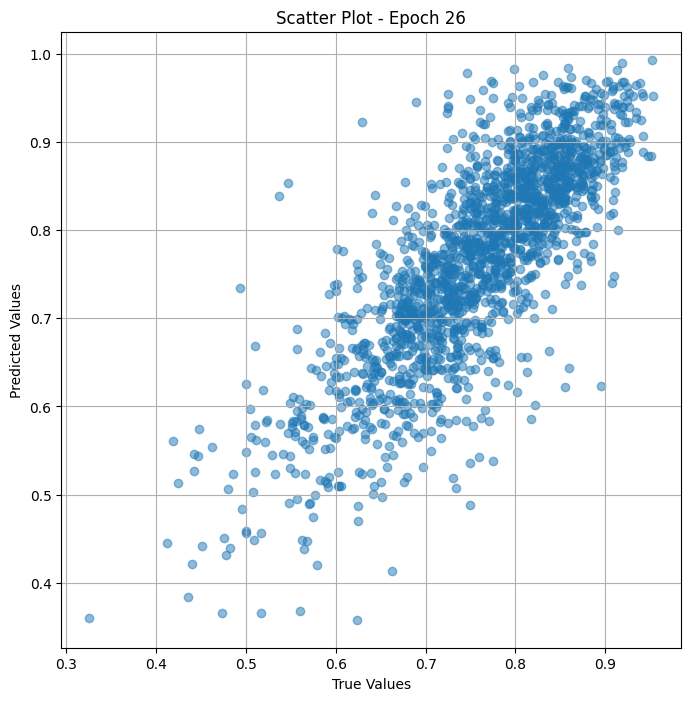


 Epoch: (27/50) Loss = 0.02520349621772766

 Epoch: (27/50) Loss_rmse = 0.1587560921907425

 Epoch: (27/50) R^2 = -4.260804176330566

 Epoch: (27/50) MAE = 0.13446035981178284

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.699

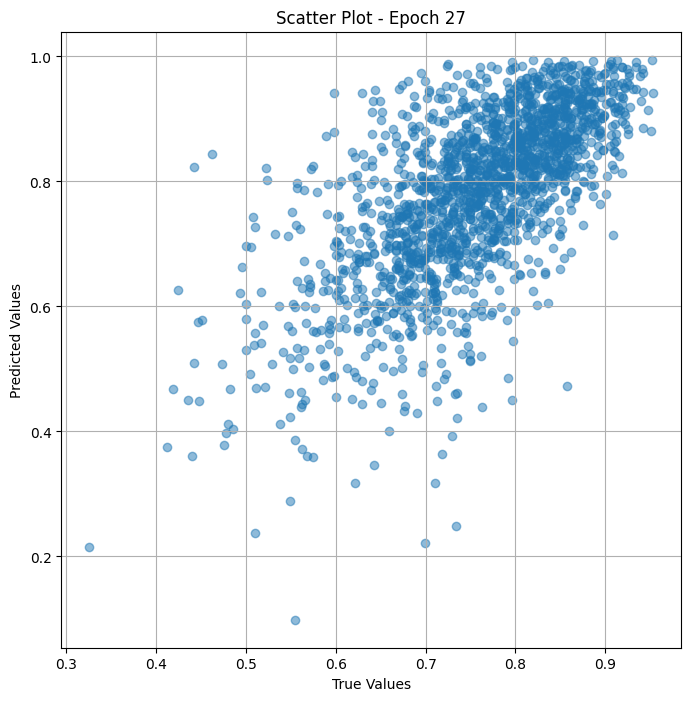


 Epoch: (28/50) Loss = 0.001047179801389575

 Epoch: (28/50) Loss_rmse = 0.03236015886068344

 Epoch: (28/50) R^2 = 0.7814189195632935

 Epoch: (28/50) MAE = 0.025159738957881927

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

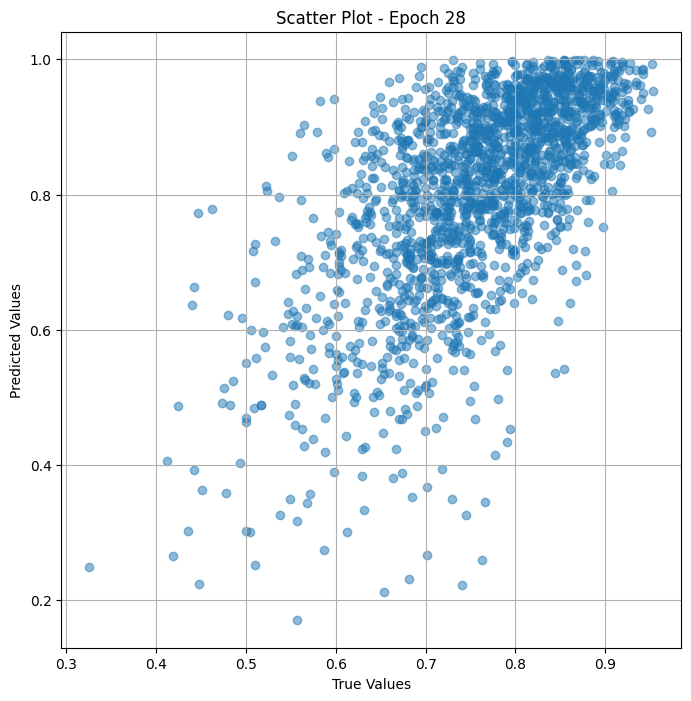


 Epoch: (29/50) Loss = 0.0019188070436939597

 Epoch: (29/50) Loss_rmse = 0.043804191052913666

 Epoch: (29/50) R^2 = 0.599481463432312

 Epoch: (29/50) MAE = 0.041569121181964874

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

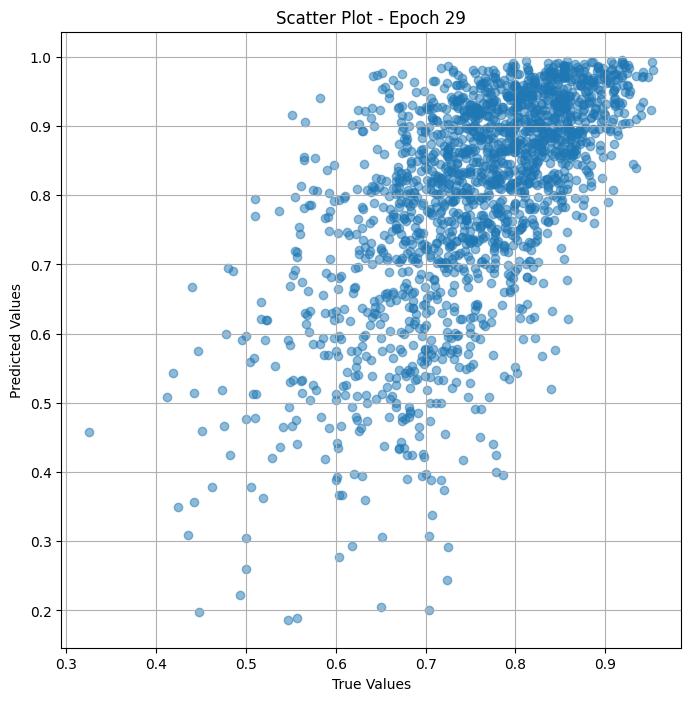


 Epoch: (30/50) Loss = 0.002641589380800724

 Epoch: (30/50) Loss_rmse = 0.05139639601111412

 Epoch: (30/50) R^2 = 0.4486128091812134

 Epoch: (30/50) MAE = 0.039480410516262054

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

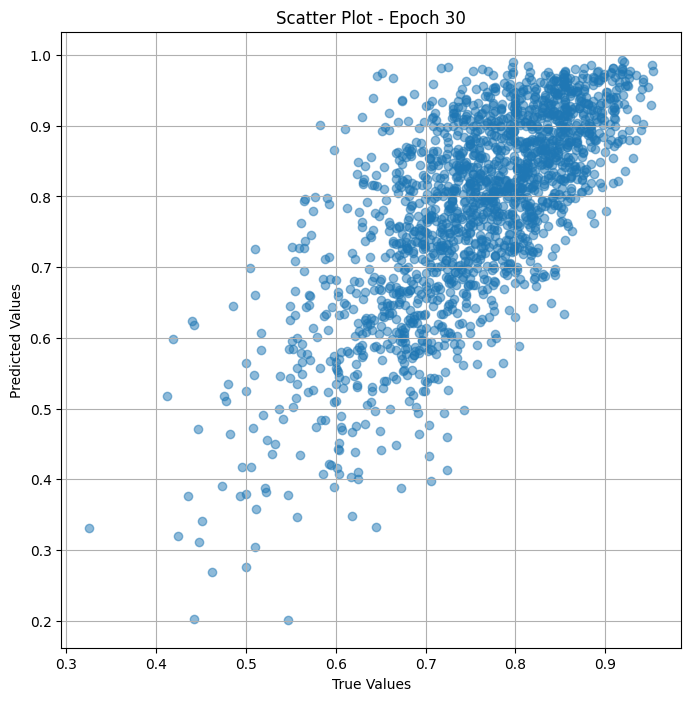


 Epoch: (31/50) Loss = 0.0025919645559042692

 Epoch: (31/50) Loss_rmse = 0.05091134086251259

 Epoch: (31/50) R^2 = 0.45897114276885986

 Epoch: (31/50) MAE = 0.046923138201236725

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

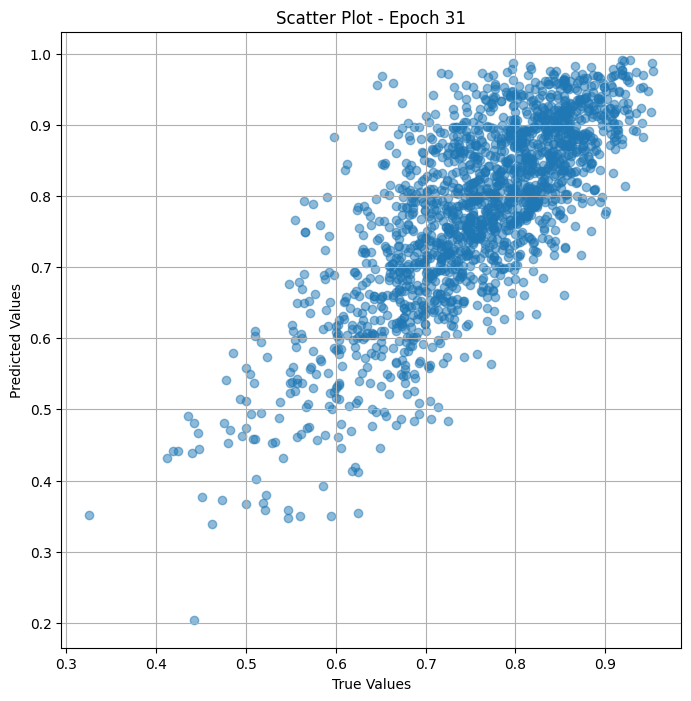


 Epoch: (32/50) Loss = 0.0031889965757727623

 Epoch: (32/50) Loss_rmse = 0.05647120252251625

 Epoch: (32/50) R^2 = 0.3343508243560791

 Epoch: (32/50) MAE = 0.051077209413051605

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

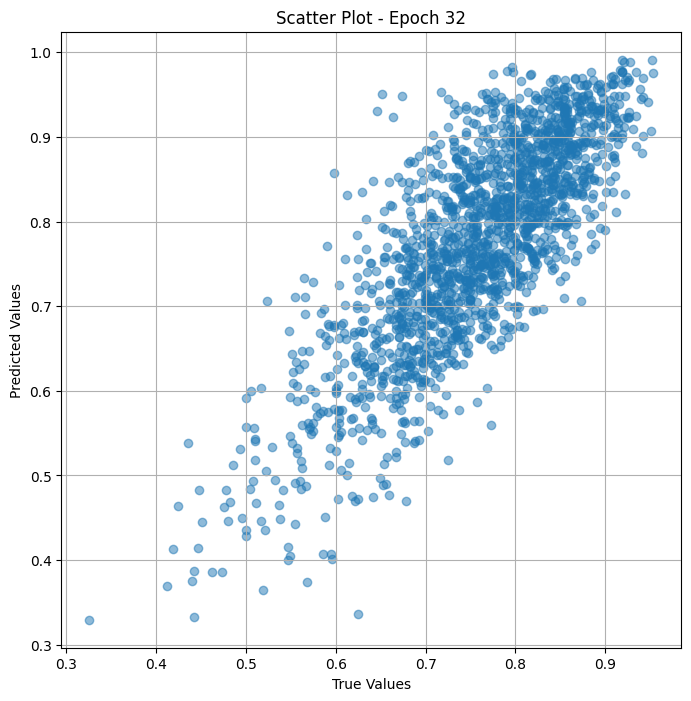


 Epoch: (33/50) Loss = 0.00038897705962881446

 Epoch: (33/50) Loss_rmse = 0.019722500815987587

 Epoch: (33/50) R^2 = 0.9188076257705688

 Epoch: (33/50) MAE = 0.01923505961894989

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

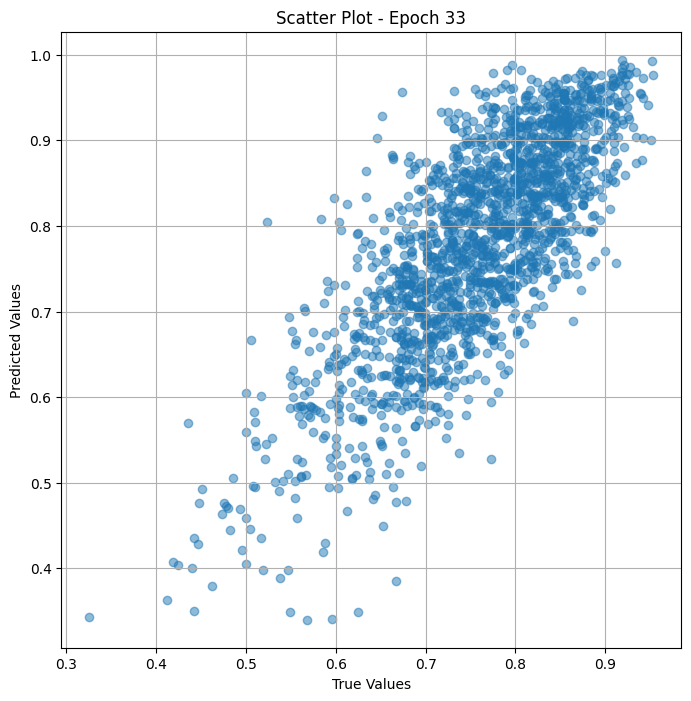


 Epoch: (34/50) Loss = 0.009500713087618351

 Epoch: (34/50) Loss_rmse = 0.09747160226106644

 Epoch: (34/50) R^2 = -0.9831134080886841

 Epoch: (34/50) MAE = 0.09391207247972488

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

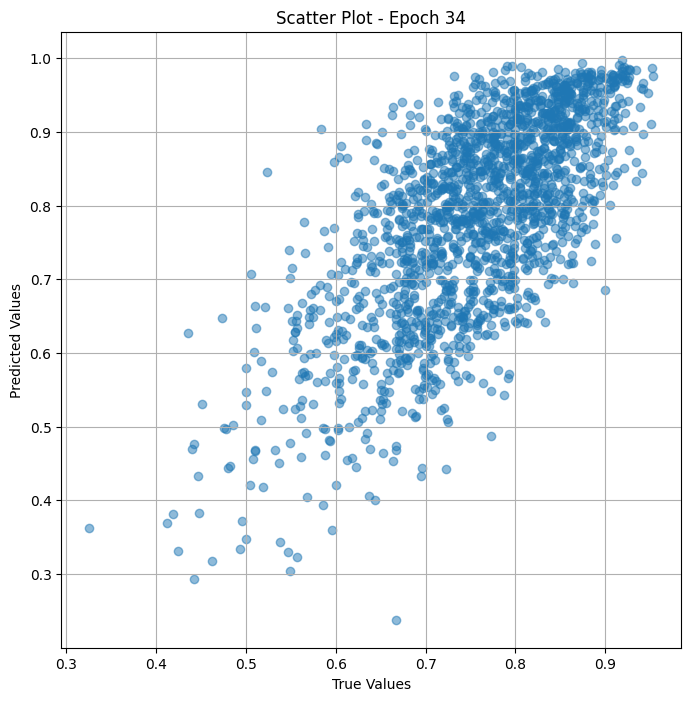


 Epoch: (35/50) Loss = 0.013624042272567749

 Epoch: (35/50) Loss_rmse = 0.11672206968069077

 Epoch: (35/50) R^2 = -1.8437888622283936

 Epoch: (35/50) MAE = 0.10517760366201401

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

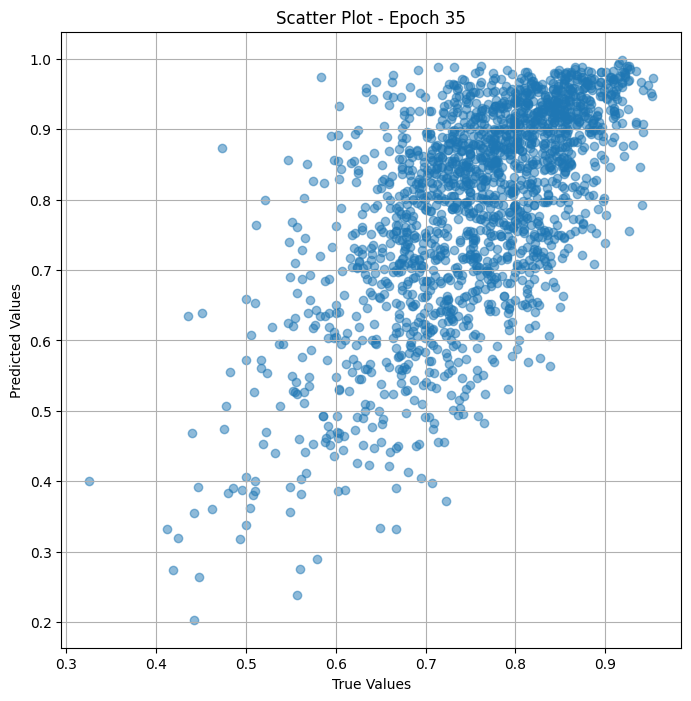


 Epoch: (36/50) Loss = 0.011607913300395012

 Epoch: (36/50) Loss_rmse = 0.10774002969264984

 Epoch: (36/50) R^2 = -1.4229559898376465

 Epoch: (36/50) MAE = 0.09335535764694214

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

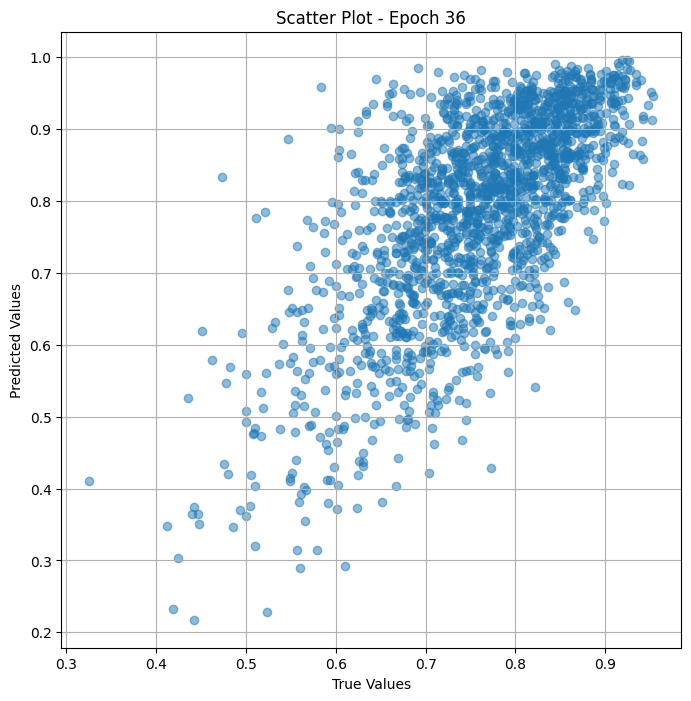


 Epoch: (37/50) Loss = 0.009205101057887077

 Epoch: (37/50) Loss_rmse = 0.09594321995973587

 Epoch: (37/50) R^2 = -0.9214093685150146

 Epoch: (37/50) MAE = 0.07766790688037872

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

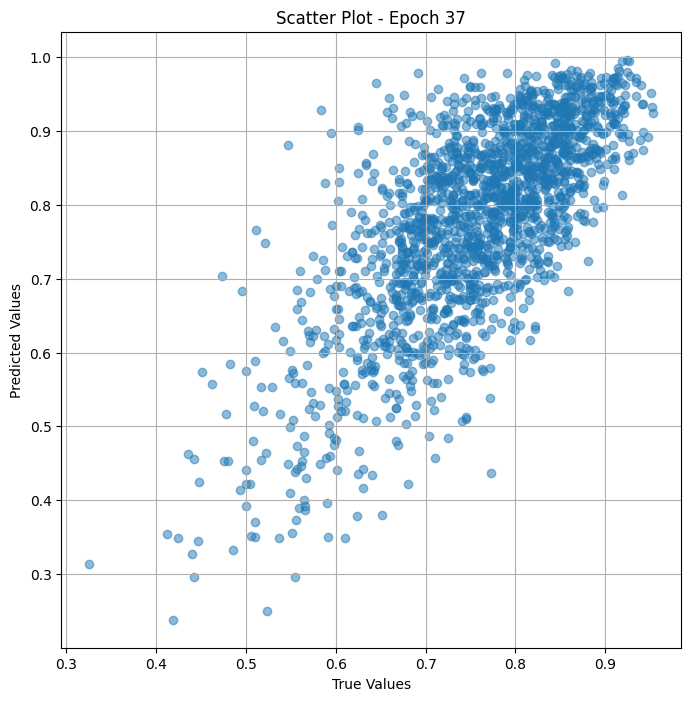


 Epoch: (38/50) Loss = 0.00686196144670248

 Epoch: (38/50) Loss_rmse = 0.08283695578575134

 Epoch: (38/50) R^2 = -0.4323185682296753

 Epoch: (38/50) MAE = 0.06620445847511292

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

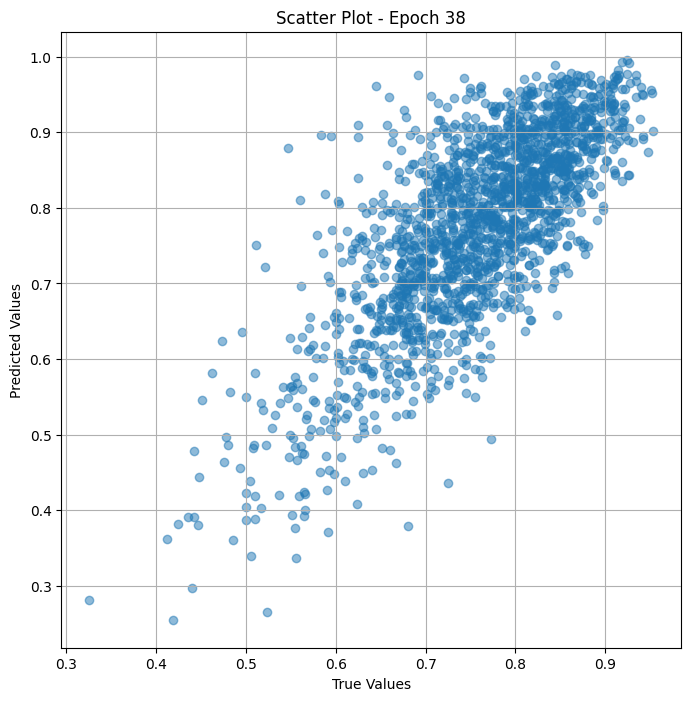


 Epoch: (39/50) Loss = 0.005092555191367865

 Epoch: (39/50) Loss_rmse = 0.07136213779449463

 Epoch: (39/50) R^2 = -0.06298494338989258

 Epoch: (39/50) MAE = 0.055094487965106964

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

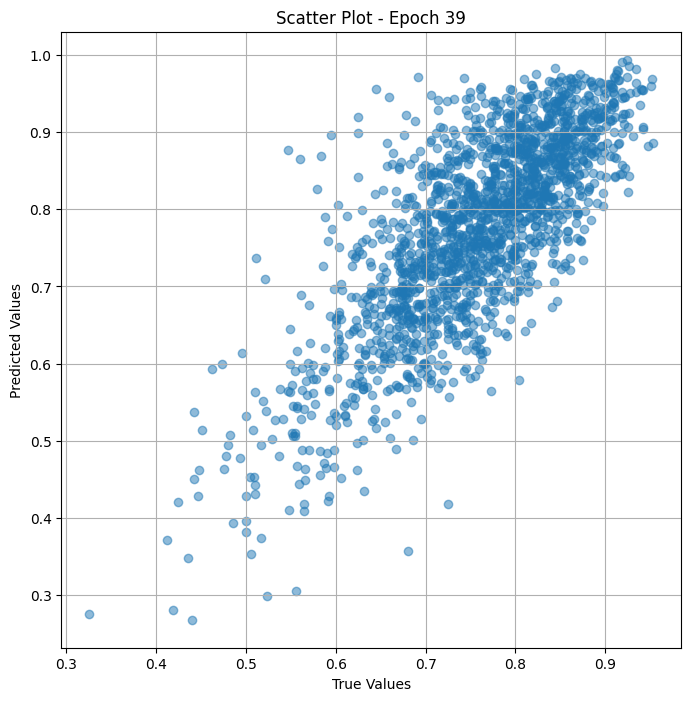


 Epoch: (40/50) Loss = 0.003733794204890728

 Epoch: (40/50) Loss_rmse = 0.06110478192567825

 Epoch: (40/50) R^2 = 0.22063350677490234

 Epoch: (40/50) MAE = 0.04352383315563202

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

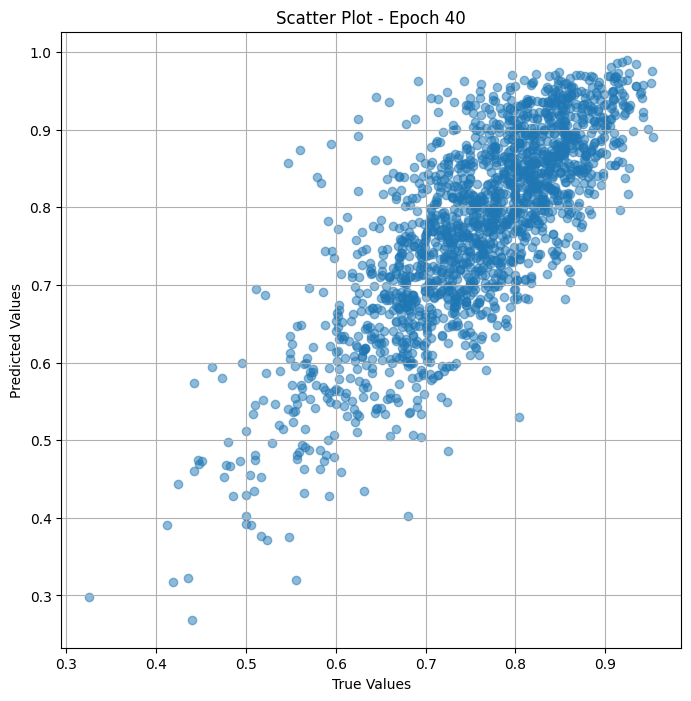


 Epoch: (41/50) Loss = 0.0027871266938745975

 Epoch: (41/50) Loss_rmse = 0.052793245762586594

 Epoch: (41/50) R^2 = 0.41823434829711914

 Epoch: (41/50) MAE = 0.03956173360347748

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

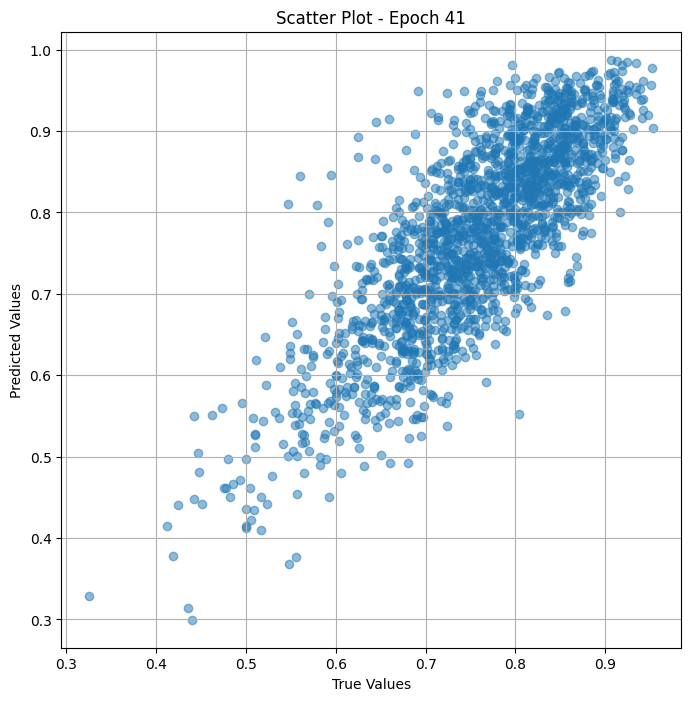


 Epoch: (42/50) Loss = 0.0019254949875175953

 Epoch: (42/50) Loss_rmse = 0.043880462646484375

 Epoch: (42/50) R^2 = 0.5980854034423828

 Epoch: (42/50) MAE = 0.035450421273708344

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

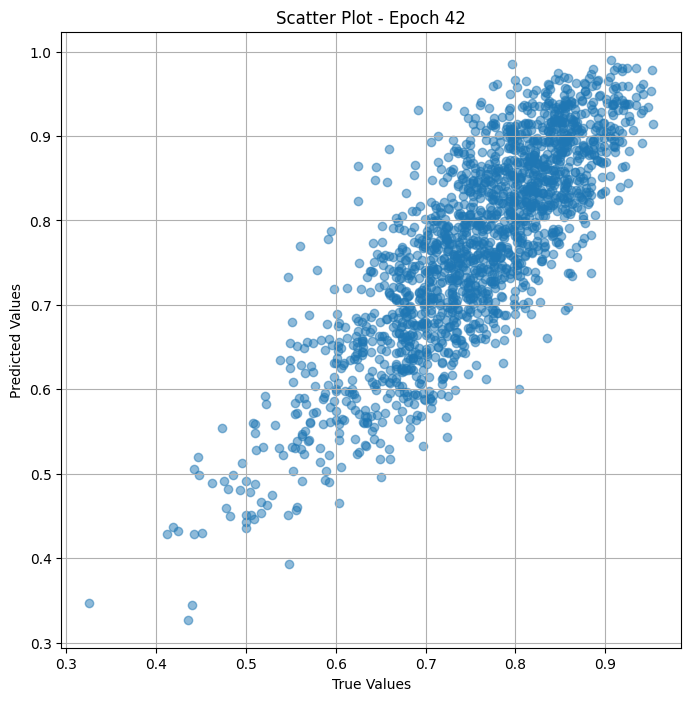


 Epoch: (43/50) Loss = 0.001699685351923108

 Epoch: (43/50) Loss_rmse = 0.04122724011540413

 Epoch: (43/50) R^2 = 0.6452193856239319

 Epoch: (43/50) MAE = 0.035405293107032776

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

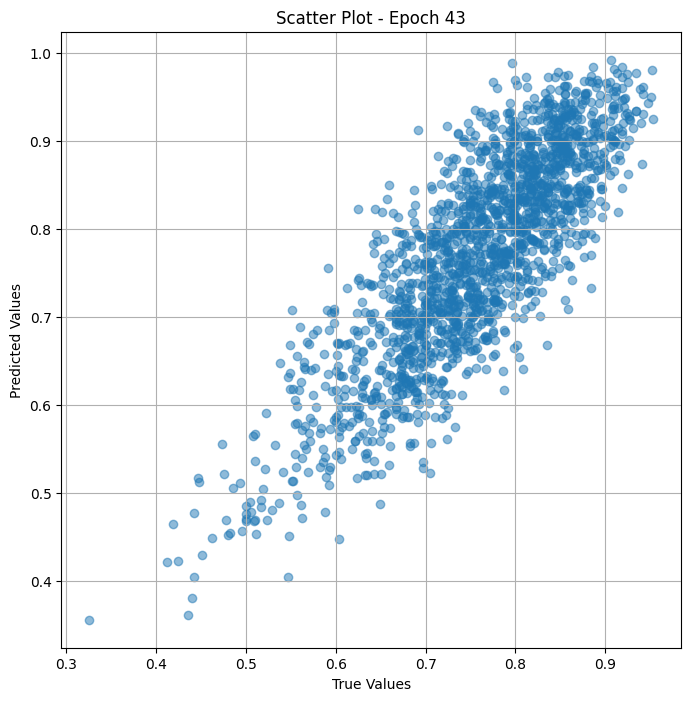


 Epoch: (44/50) Loss = 0.002396919298917055

 Epoch: (44/50) Loss_rmse = 0.048958342522382736

 Epoch: (44/50) R^2 = 0.49968355894088745

 Epoch: (44/50) MAE = 0.04535195976495743

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

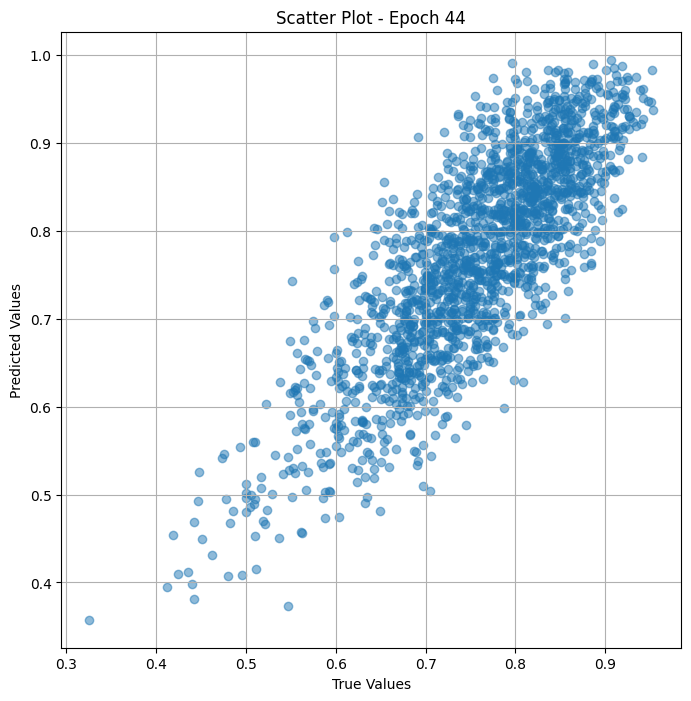


 Epoch: (45/50) Loss = 0.002979894867166877

 Epoch: (45/50) Loss_rmse = 0.05458841472864151

 Epoch: (45/50) R^2 = 0.3779972791671753

 Epoch: (45/50) MAE = 0.04734129458665848

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.6

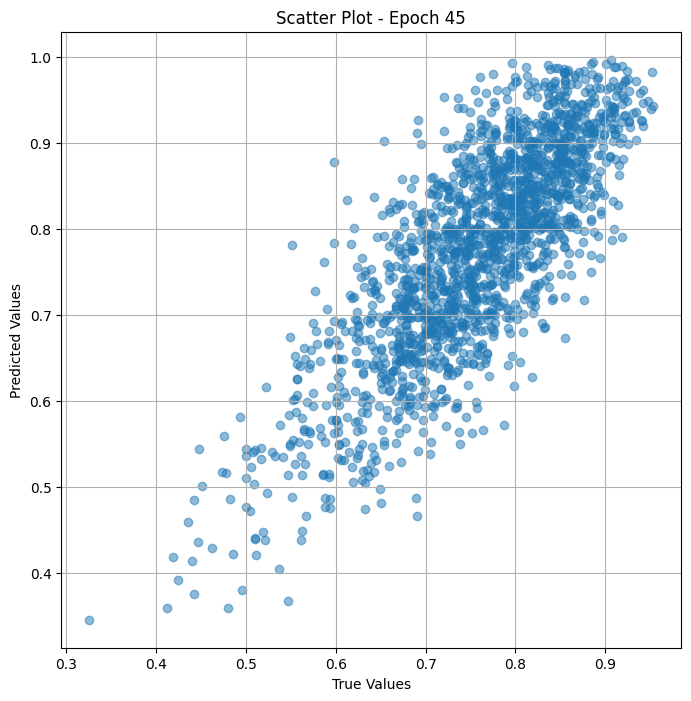


 Epoch: (46/50) Loss = 0.0019377215066924691

 Epoch: (46/50) Loss_rmse = 0.044019557535648346

 Epoch: (46/50) R^2 = 0.5955333709716797

 Epoch: (46/50) MAE = 0.04215655475854874

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

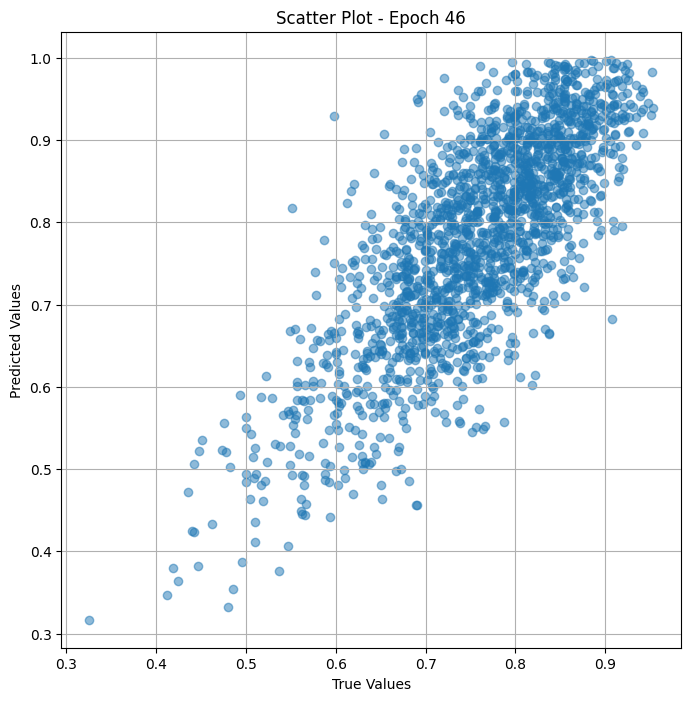


 Epoch: (47/50) Loss = 0.0018000828567892313

 Epoch: (47/50) Loss_rmse = 0.04242738336324692

 Epoch: (47/50) R^2 = 0.6242631077766418

 Epoch: (47/50) MAE = 0.03890889137983322

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0.

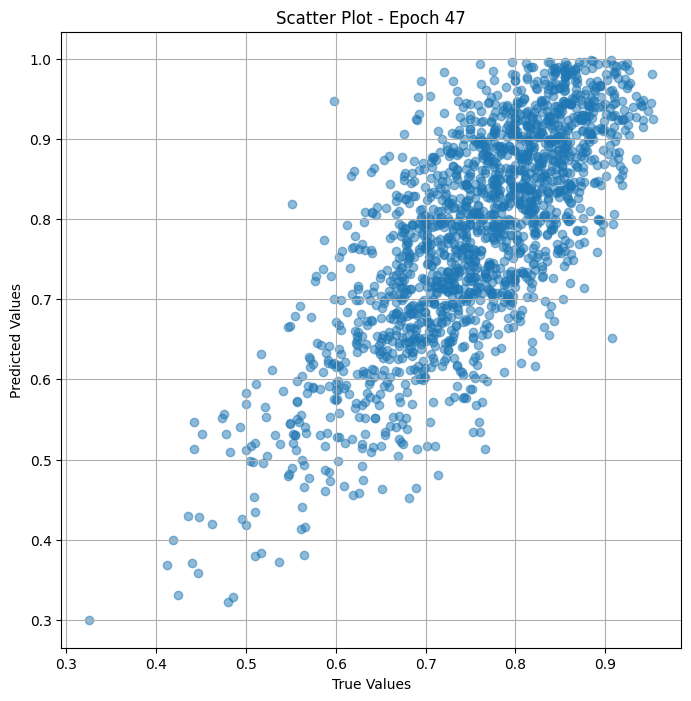


 Epoch: (48/50) Loss = 0.0009339877869933844

 Epoch: (48/50) Loss_rmse = 0.030561214312911034

 Epoch: (48/50) R^2 = 0.8050458431243896

 Epoch: (48/50) MAE = 0.02773766964673996

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

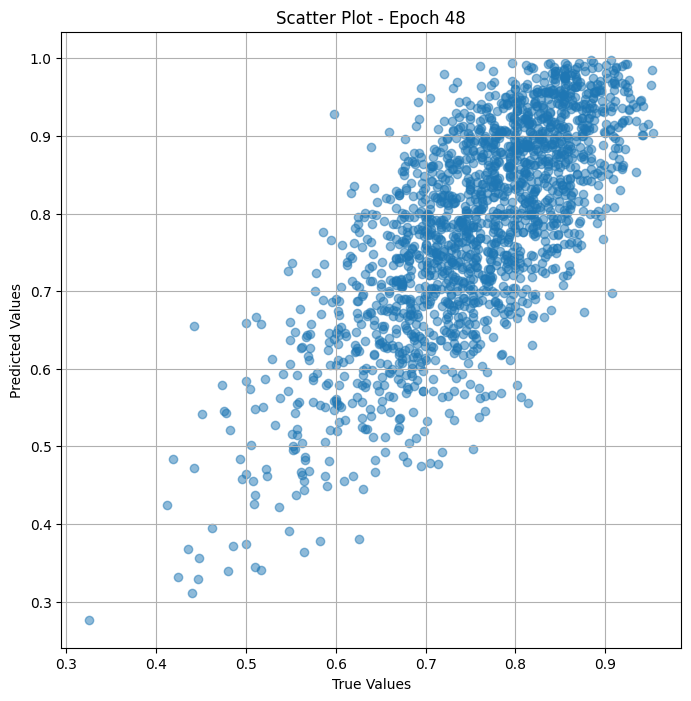


 Epoch: (49/50) Loss = 0.0020158011466264725

 Epoch: (49/50) Loss_rmse = 0.04489767551422119

 Epoch: (49/50) R^2 = 0.5792355537414551

 Epoch: (49/50) MAE = 0.041496433317661285

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 0

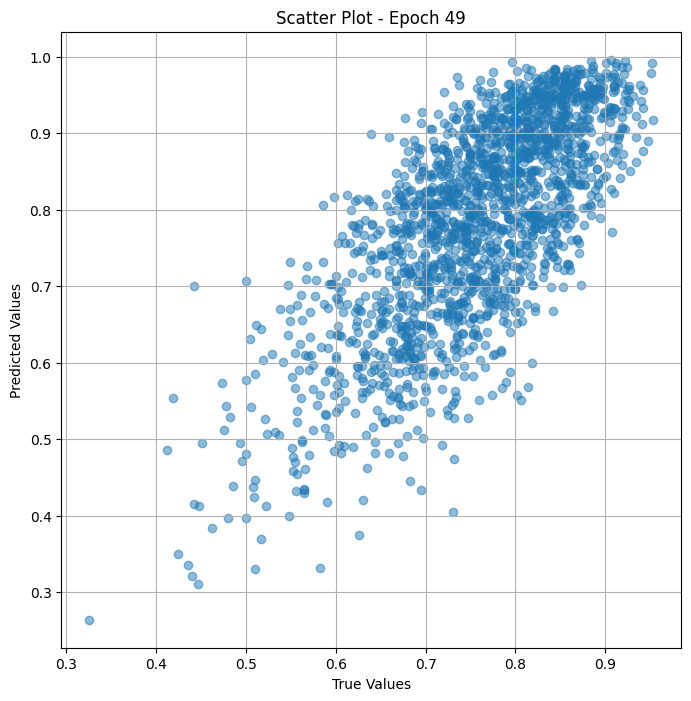


 Epoch: (50/50) Loss = 0.0025336567778140306

 Epoch: (50/50) Loss_rmse = 0.050335440784692764

 Epoch: (50/50) R^2 = 0.4711419343948364

 Epoch: (50/50) MAE = 0.046078599989414215

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5877193, 0.6494845, 0.6818182, 0.8518519, 0.88349515, 0.6732673, 0.7876106, 0.8773585, 0.75555557, 0.877193, 0.7979798, 0.8301887, 0.6296296, 0.8586956, 0.7604167, 0.5882353, 0.6818182, 0.42424244, 0.62886596, 0.84821427, 0.90909094, 0.8240741, 0.83505154, 0.82, 0.7297297, 0.90361446, 0.77884614, 0.8125, 0.65178573, 0.8173077, 0.8712871, 0.75238097, 0.7777778, 0.6703297, 0.75, 0.61764705, 0.91358024, 0.8192771, 0.8613861, 0.7933884, 0.9339623, 0.6969697, 0.65686274, 0.7938144, 0.5619048, 0.77319586, 0.8068182, 0.8181818, 0.75, 0.84042555, 0.8130841, 0.7752809, 0.75, 0.83653843, 0.8111111, 0.62886596, 0.8192771, 0.8648649, 0.6979167, 0.6421053, 0.85714287, 0.7802198, 0.7948718, 0.6886792, 0.9339623, 0.51, 0.8659794, 

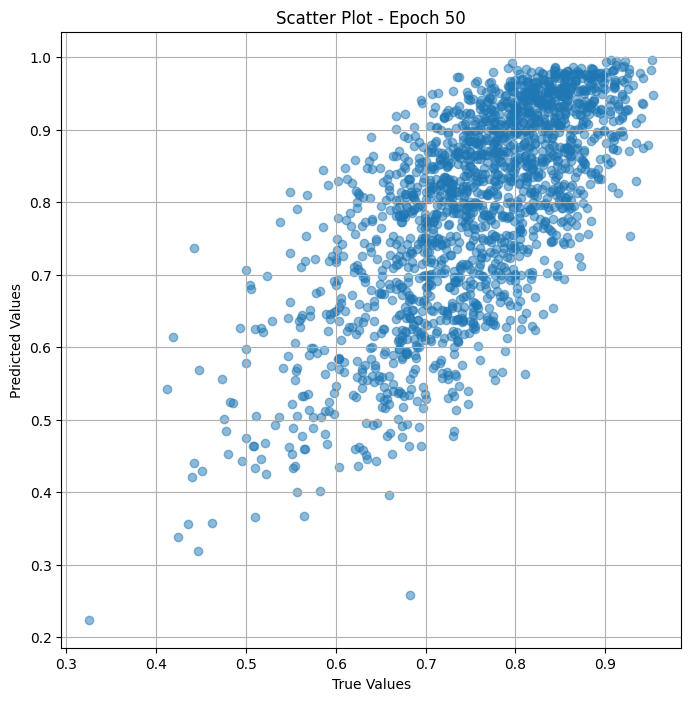

In [ ]:
# Training the model and save weights
fit(50, model, train_dl)
torch.save(model.state_dict(), "model_weights_S_")

## Valid

In [ ]:
# Merge the two models
class model_merge_fine_val(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


modelfine_val = model_merge_fine_val(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_val = DeviceDataLoader(train_dl_val, device)
modelfine_val = to_device(modelfine_val, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(modelfine_val.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,modelfine_val, train_dl_val):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        modelfine_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_val:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = modelfine_val(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.10210390388965607

 Epoch: (1/50) Loss_rmse = 0.3195370137691498

 Epoch: (1/50) R^2 = -38.61674880981445

 Epoch: (1/50) MAE = 0.26187658309936523

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0.712

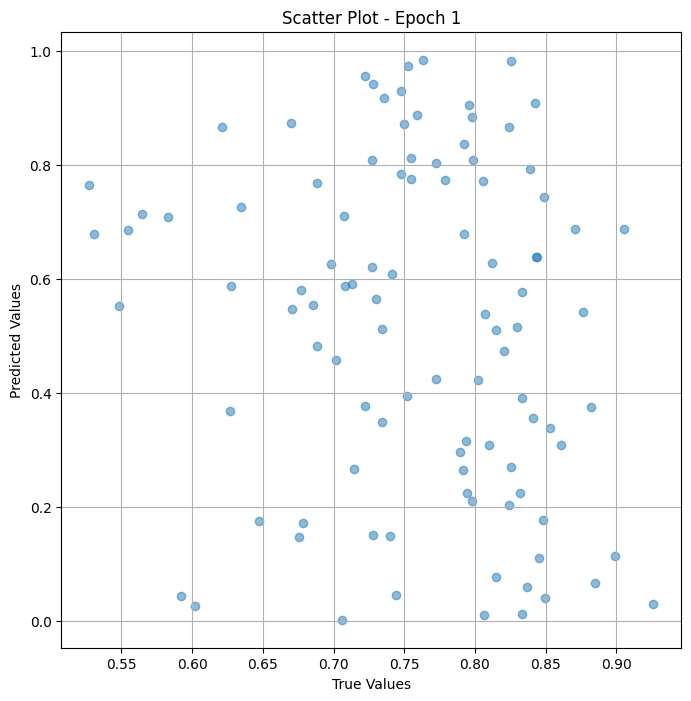


 Epoch: (2/50) Loss = 0.03750714287161827

 Epoch: (2/50) Loss_rmse = 0.19366760551929474

 Epoch: (2/50) R^2 = -13.55293083190918

 Epoch: (2/50) MAE = 0.18178582191467285

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0.71

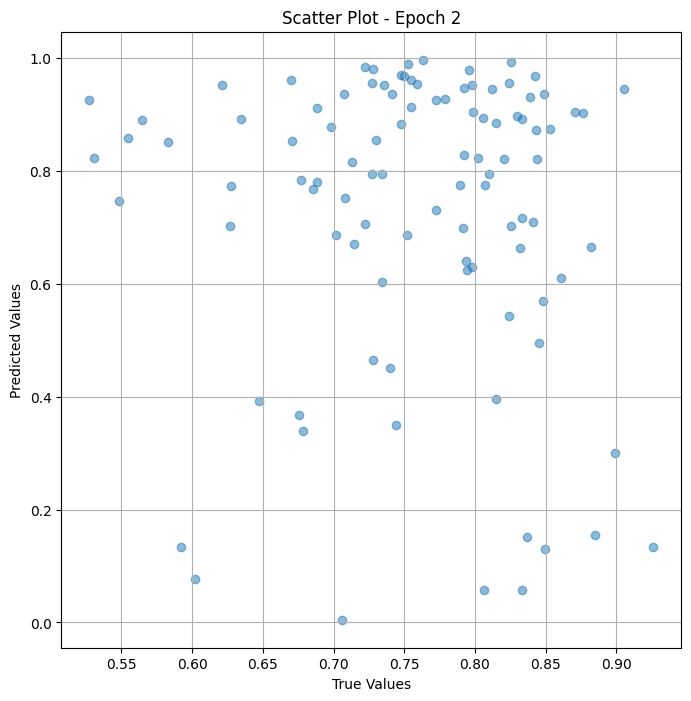


 Epoch: (3/50) Loss = 0.025083761662244797

 Epoch: (3/50) Loss_rmse = 0.15837854146957397

 Epoch: (3/50) R^2 = -8.732605934143066

 Epoch: (3/50) MAE = 0.14496004581451416

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0.7

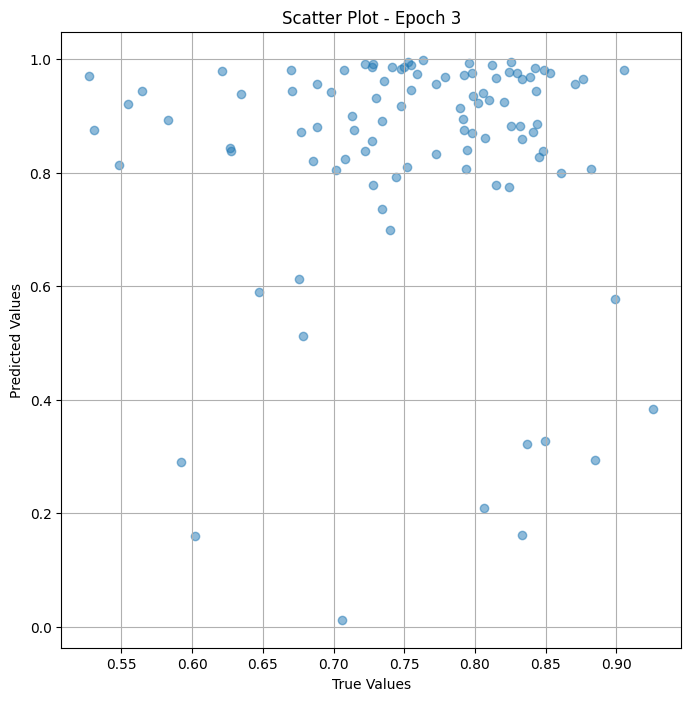


 Epoch: (4/50) Loss = 0.02770046517252922

 Epoch: (4/50) Loss_rmse = 0.16643457114696503

 Epoch: (4/50) R^2 = -9.74789810180664

 Epoch: (4/50) MAE = 0.1614706814289093

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0.7127

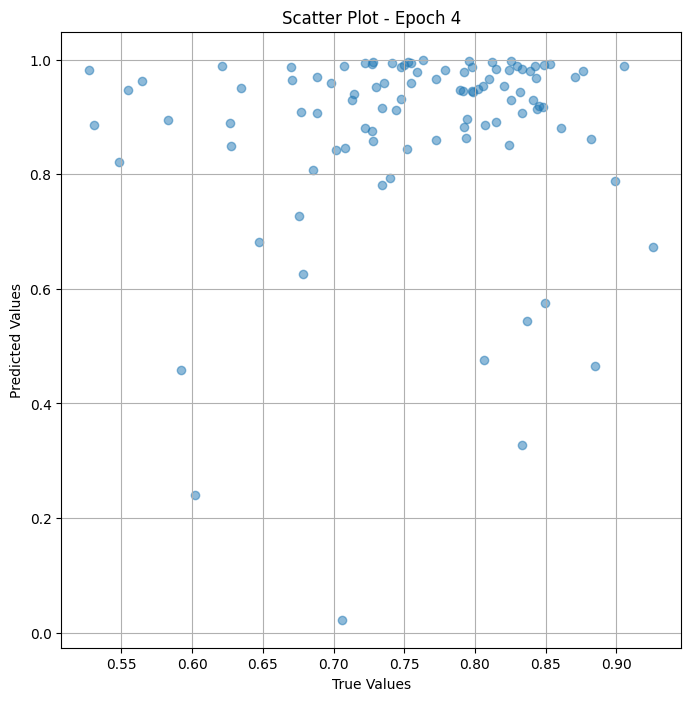


 Epoch: (5/50) Loss = 0.023772630840539932

 Epoch: (5/50) Loss_rmse = 0.1541837602853775

 Epoch: (5/50) R^2 = -8.223881721496582

 Epoch: (5/50) MAE = 0.14394746720790863

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0.71

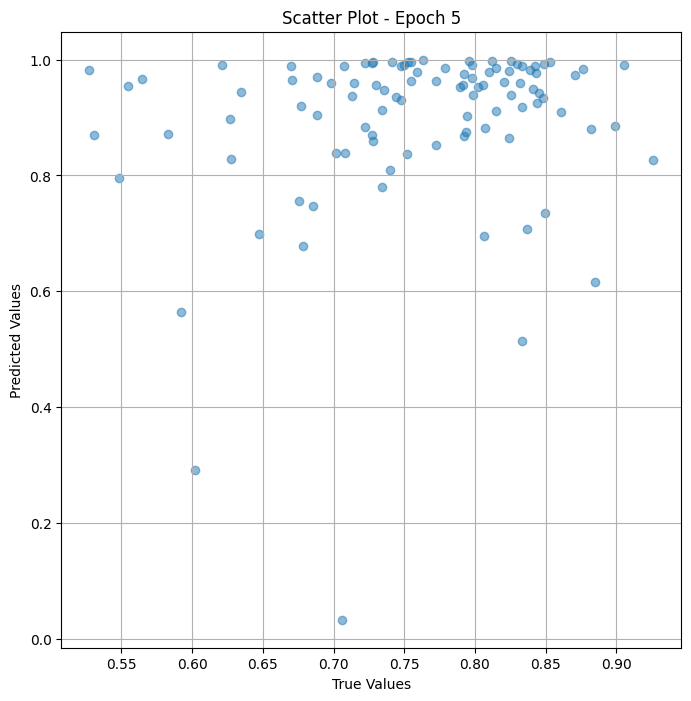


 Epoch: (6/50) Loss = 0.01802067458629608

 Epoch: (6/50) Loss_rmse = 0.13424110412597656

 Epoch: (6/50) R^2 = -5.992098331451416

 Epoch: (6/50) MAE = 0.118354931473732

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0.7127

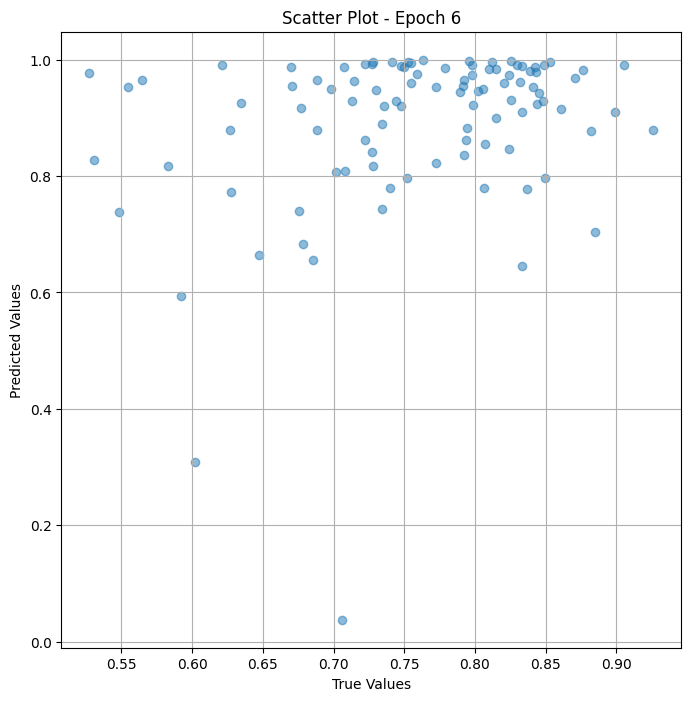


 Epoch: (7/50) Loss = 0.013459060341119766

 Epoch: (7/50) Loss_rmse = 0.11601319164037704

 Epoch: (7/50) R^2 = -4.222172737121582

 Epoch: (7/50) MAE = 0.09886617958545685

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0.7

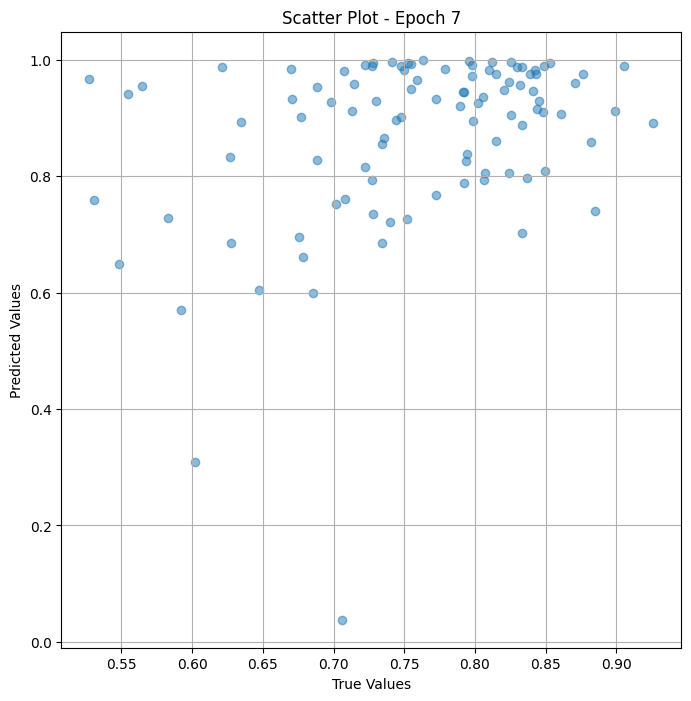


 Epoch: (8/50) Loss = 0.010126369073987007

 Epoch: (8/50) Loss_rmse = 0.10062985867261887

 Epoch: (8/50) R^2 = -2.929074287414551

 Epoch: (8/50) MAE = 0.08758647739887238

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0.7

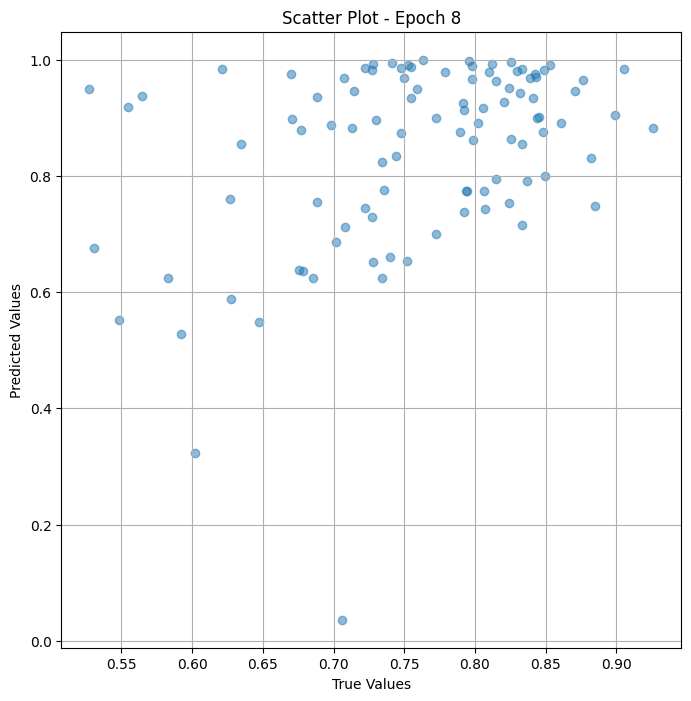


 Epoch: (9/50) Loss = 0.00972872693091631

 Epoch: (9/50) Loss_rmse = 0.09863431006669998

 Epoch: (9/50) R^2 = -2.774787425994873

 Epoch: (9/50) MAE = 0.07630030810832977

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0.71

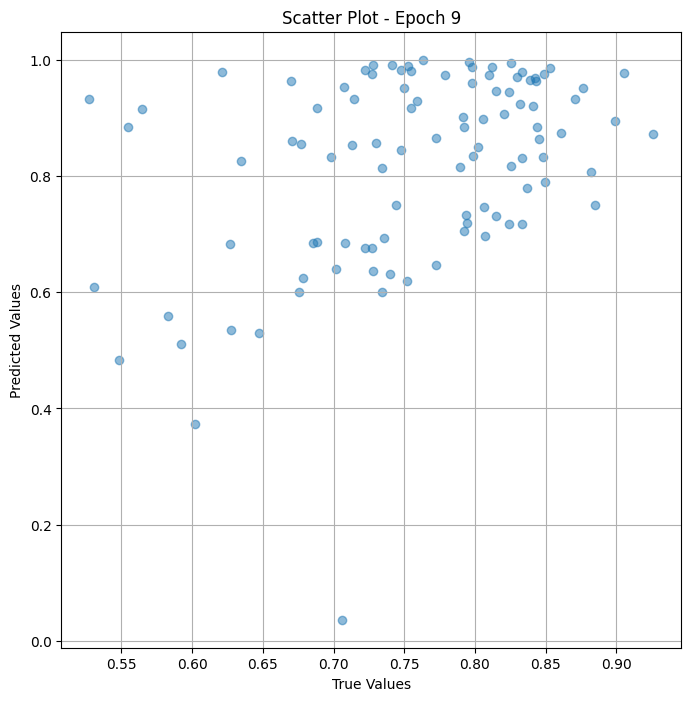


 Epoch: (10/50) Loss = 0.008333736099302769

 Epoch: (10/50) Loss_rmse = 0.09128929674625397

 Epoch: (10/50) R^2 = -2.233525037765503

 Epoch: (10/50) MAE = 0.07179726660251617

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256,

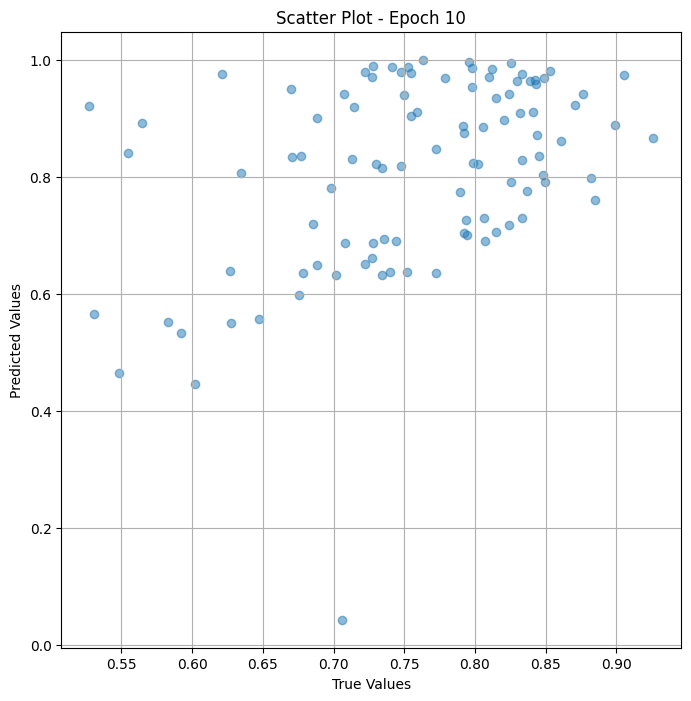


 Epoch: (11/50) Loss = 0.0074537331238389015

 Epoch: (11/50) Loss_rmse = 0.08633500337600708

 Epoch: (11/50) R^2 = -1.8920800685882568

 Epoch: (11/50) MAE = 0.05557866394519806

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274725

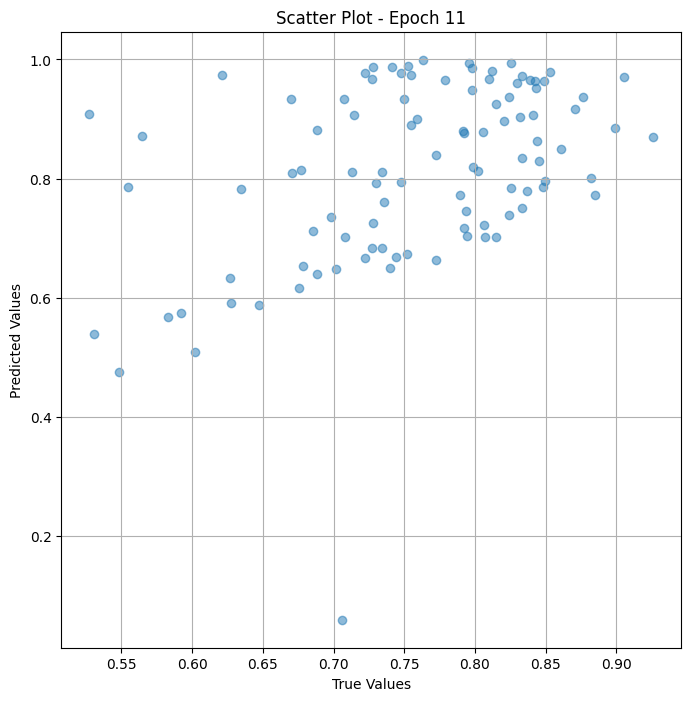


 Epoch: (12/50) Loss = 0.007206301670521498

 Epoch: (12/50) Loss_rmse = 0.08488994091749191

 Epoch: (12/50) R^2 = -1.7960755825042725

 Epoch: (12/50) MAE = 0.0498831570148468

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256,

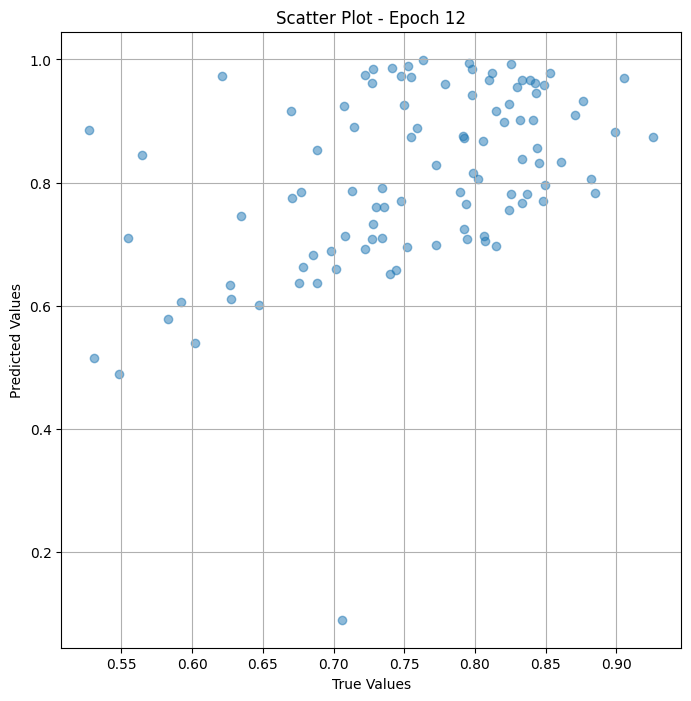


 Epoch: (13/50) Loss = 0.007076317444443703

 Epoch: (13/50) Loss_rmse = 0.08412084728479385

 Epoch: (13/50) R^2 = -1.7456412315368652

 Epoch: (13/50) MAE = 0.0487695038318634

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256,

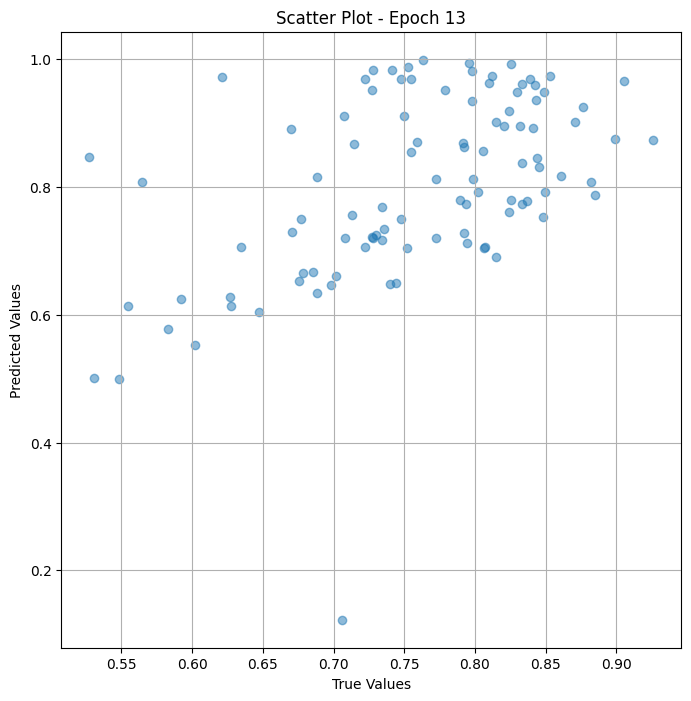


 Epoch: (14/50) Loss = 0.007087782956659794

 Epoch: (14/50) Loss_rmse = 0.08418897539377213

 Epoch: (14/50) R^2 = -1.7500898838043213

 Epoch: (14/50) MAE = 0.052929386496543884

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274725

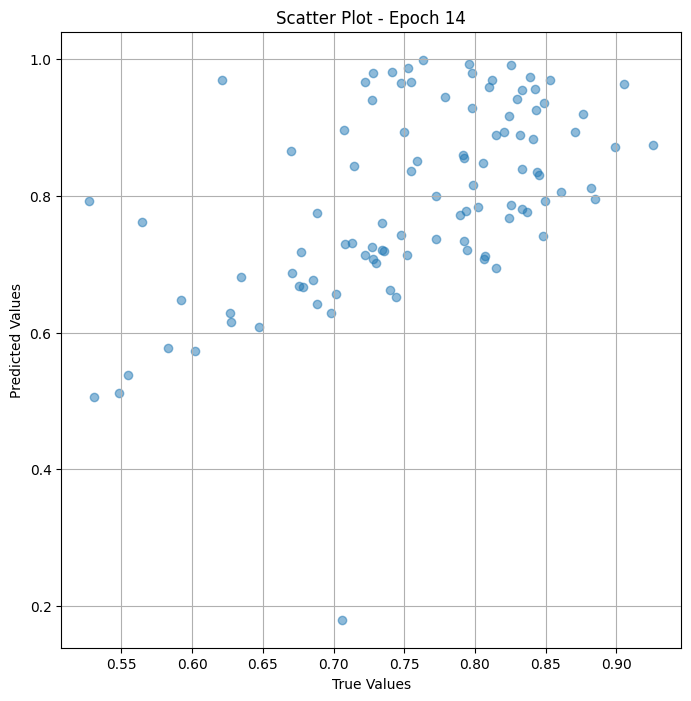


 Epoch: (15/50) Loss = 0.00698271207511425

 Epoch: (15/50) Loss_rmse = 0.08356261998414993

 Epoch: (15/50) R^2 = -1.7093219757080078

 Epoch: (15/50) MAE = 0.050257131457328796

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256

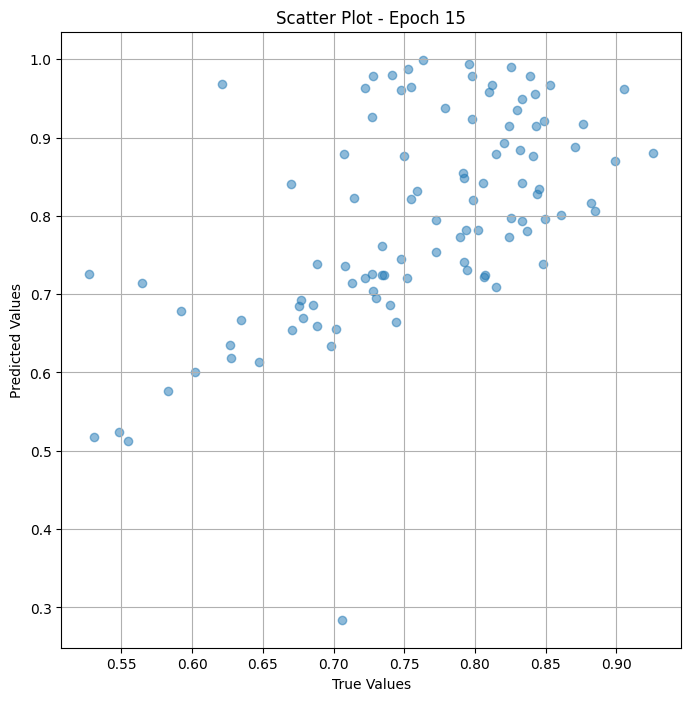


 Epoch: (16/50) Loss = 0.006813365034759045

 Epoch: (16/50) Loss_rmse = 0.08254311233758926

 Epoch: (16/50) R^2 = -1.6436145305633545

 Epoch: (16/50) MAE = 0.047909945249557495

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274725

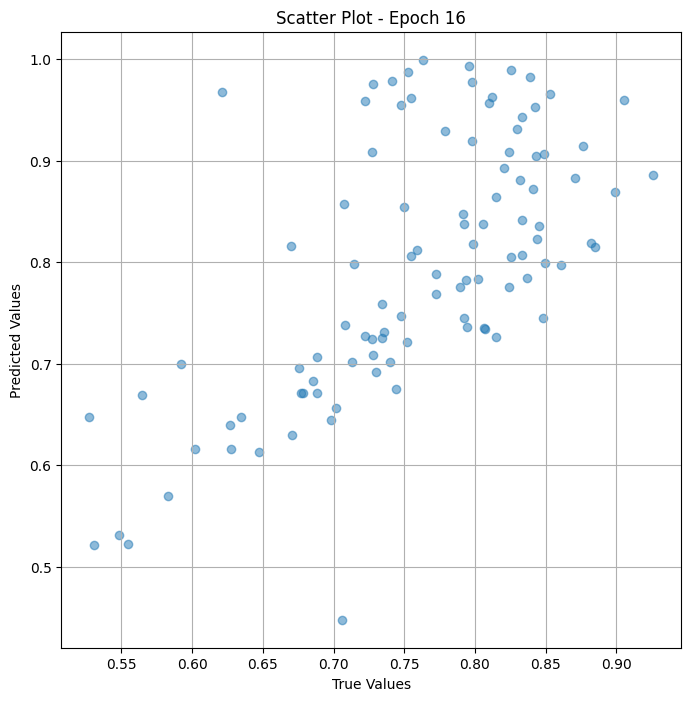


 Epoch: (17/50) Loss = 0.006643967237323523

 Epoch: (17/50) Loss_rmse = 0.08151053637266159

 Epoch: (17/50) R^2 = -1.5778875350952148

 Epoch: (17/50) MAE = 0.04656592011451721

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256

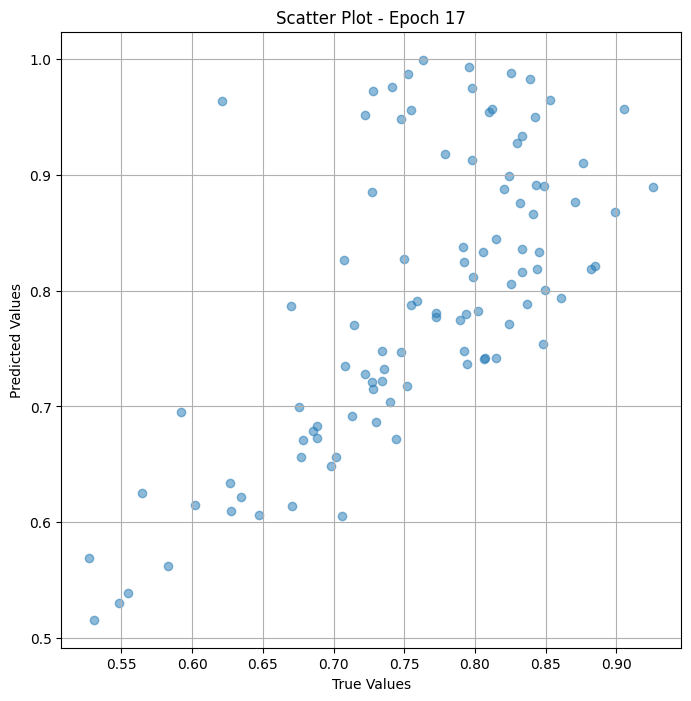


 Epoch: (18/50) Loss = 0.0064717503264546394

 Epoch: (18/50) Loss_rmse = 0.08044718950986862

 Epoch: (18/50) R^2 = -1.5110666751861572

 Epoch: (18/50) MAE = 0.041851624846458435

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527472

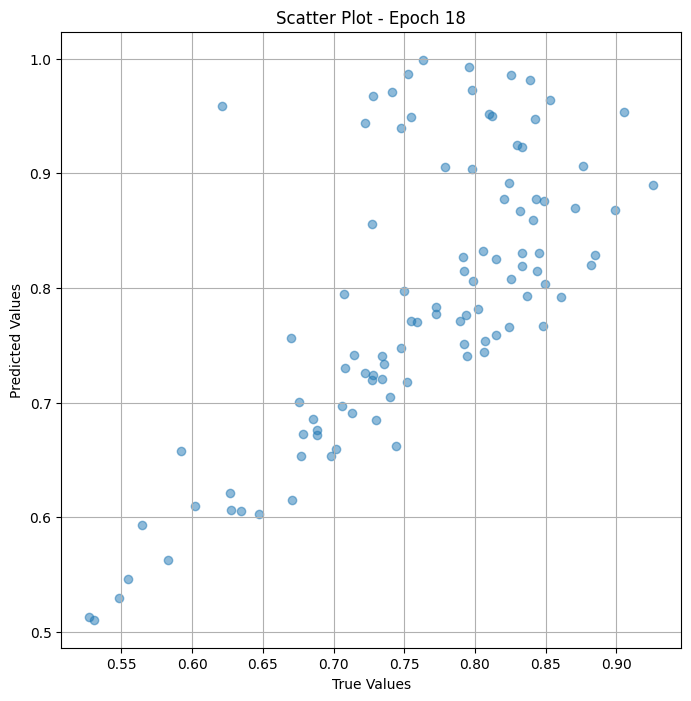


 Epoch: (19/50) Loss = 0.006361617241054773

 Epoch: (19/50) Loss_rmse = 0.07975974678993225

 Epoch: (19/50) R^2 = -1.468334436416626

 Epoch: (19/50) MAE = 0.04269111156463623

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256,

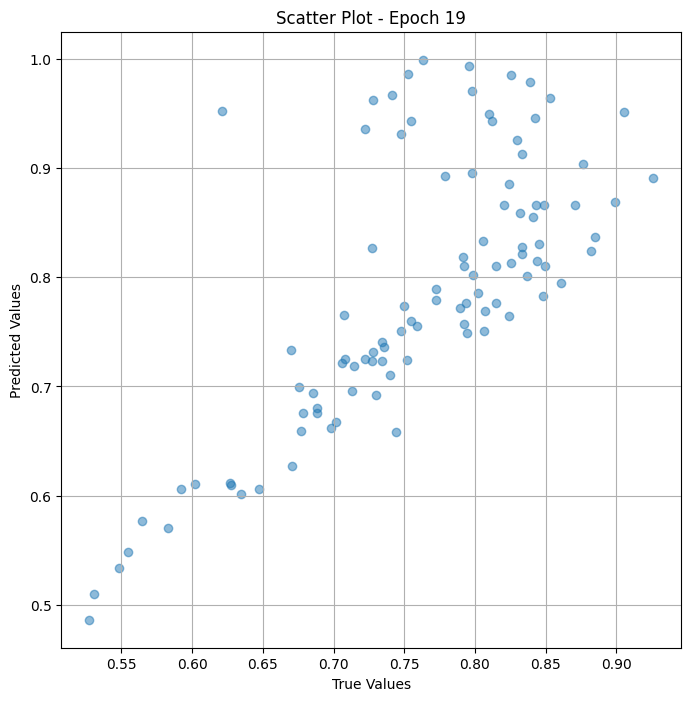


 Epoch: (20/50) Loss = 0.00620826194062829

 Epoch: (20/50) Loss_rmse = 0.0787925273180008

 Epoch: (20/50) R^2 = -1.40883207321167

 Epoch: (20/50) MAE = 0.042416468262672424

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 0

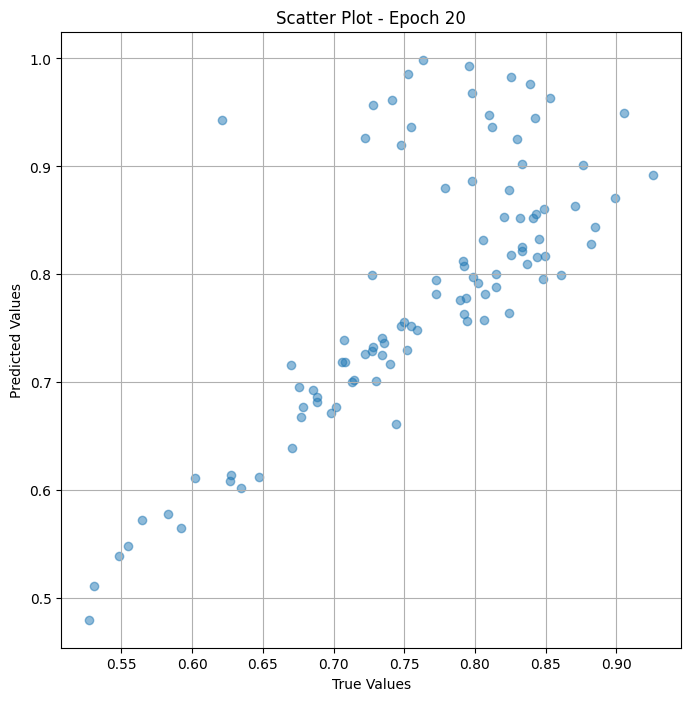


 Epoch: (21/50) Loss = 0.005994019098579884

 Epoch: (21/50) Loss_rmse = 0.07742105424404144

 Epoch: (21/50) R^2 = -1.32570481300354

 Epoch: (21/50) MAE = 0.03982669115066528

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256, 

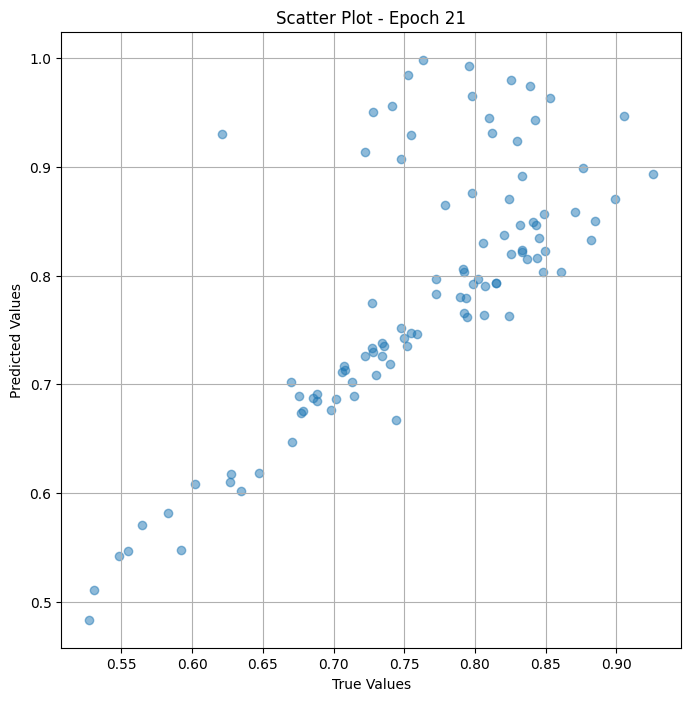


 Epoch: (22/50) Loss = 0.005746332462877035

 Epoch: (22/50) Loss_rmse = 0.07580456882715225

 Epoch: (22/50) R^2 = -1.2296013832092285

 Epoch: (22/50) MAE = 0.038818925619125366

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274725

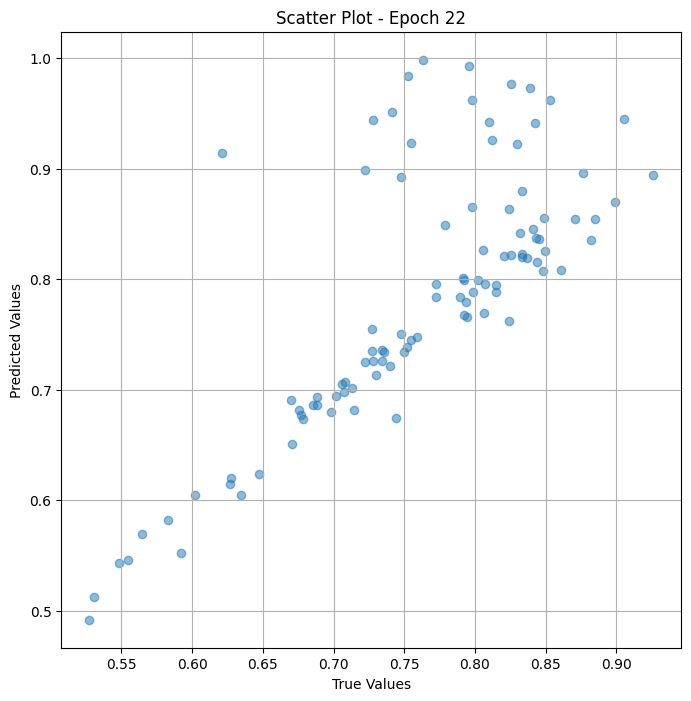


 Epoch: (23/50) Loss = 0.005439524073153734

 Epoch: (23/50) Loss_rmse = 0.07375312596559525

 Epoch: (23/50) R^2 = -1.1105585098266602

 Epoch: (23/50) MAE = 0.03830450773239136

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256

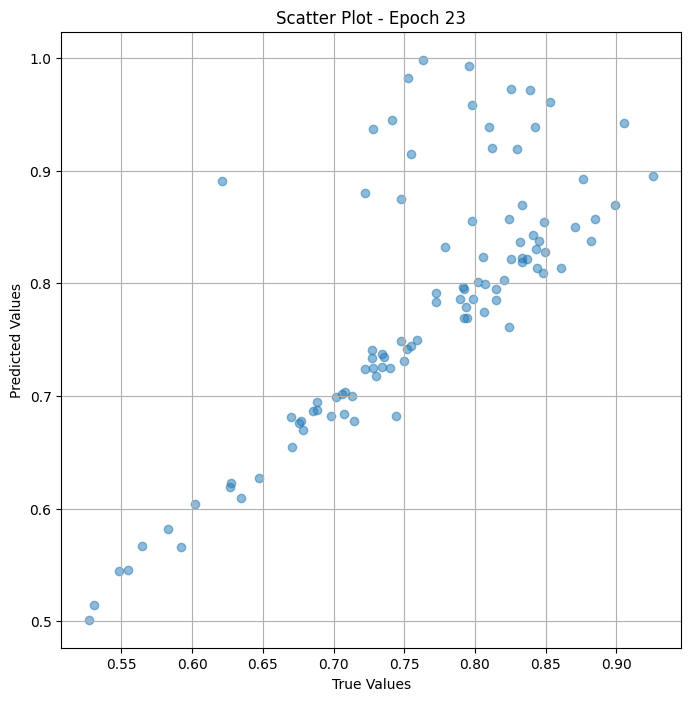


 Epoch: (24/50) Loss = 0.005054050590842962

 Epoch: (24/50) Loss_rmse = 0.07109184563159943

 Epoch: (24/50) R^2 = -0.9609931707382202

 Epoch: (24/50) MAE = 0.03688216209411621

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256

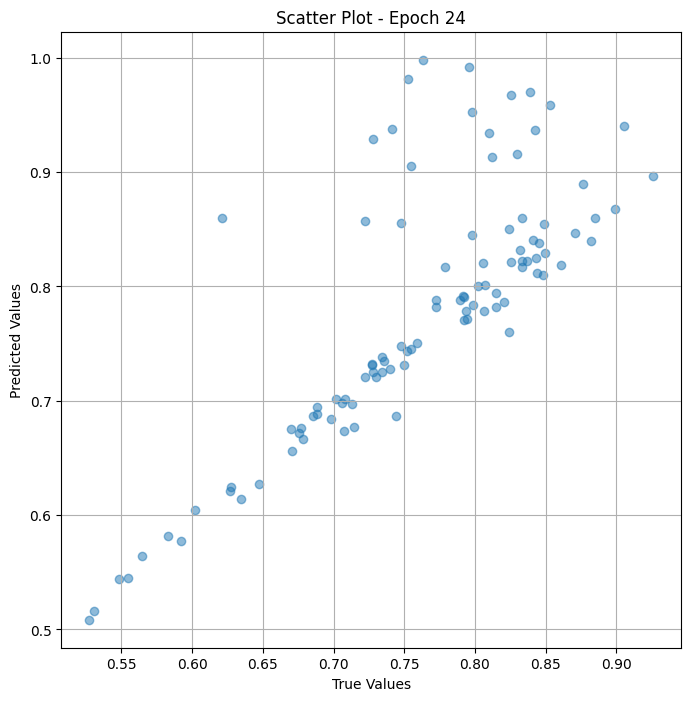


 Epoch: (25/50) Loss = 0.004575504455715418

 Epoch: (25/50) Loss_rmse = 0.06764247268438339

 Epoch: (25/50) R^2 = -0.7753151655197144

 Epoch: (25/50) MAE = 0.03467458486557007

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747256

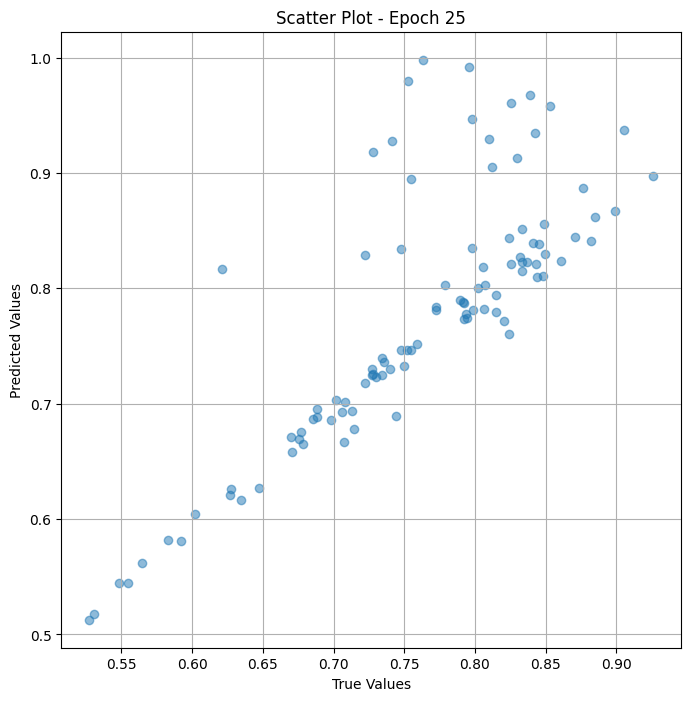


 Epoch: (26/50) Loss = 0.003984860610216856

 Epoch: (26/50) Loss_rmse = 0.06312575191259384

 Epoch: (26/50) R^2 = -0.5461428165435791

 Epoch: (26/50) MAE = 0.032188042998313904

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274725

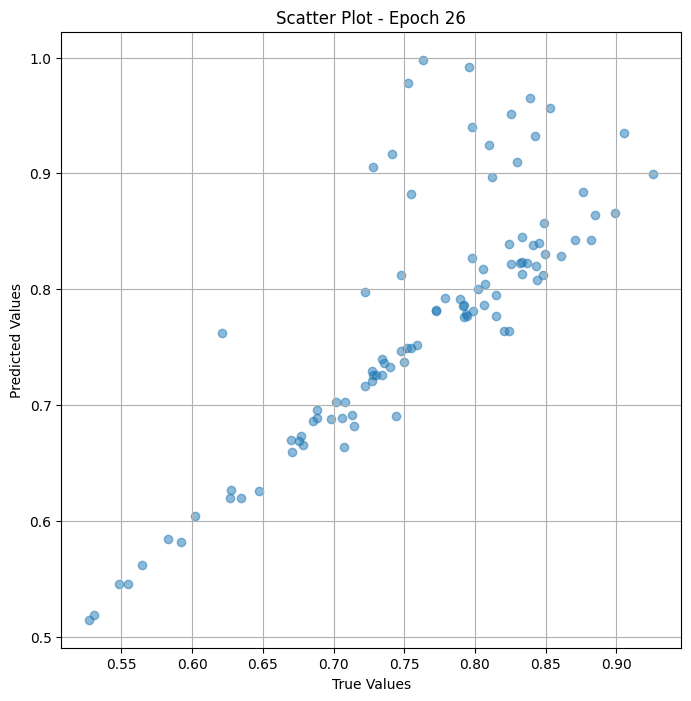


 Epoch: (27/50) Loss = 0.0032551272306591272

 Epoch: (27/50) Loss_rmse = 0.05705372244119644

 Epoch: (27/50) R^2 = -0.26300323009490967

 Epoch: (27/50) MAE = 0.02922855317592621

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527472

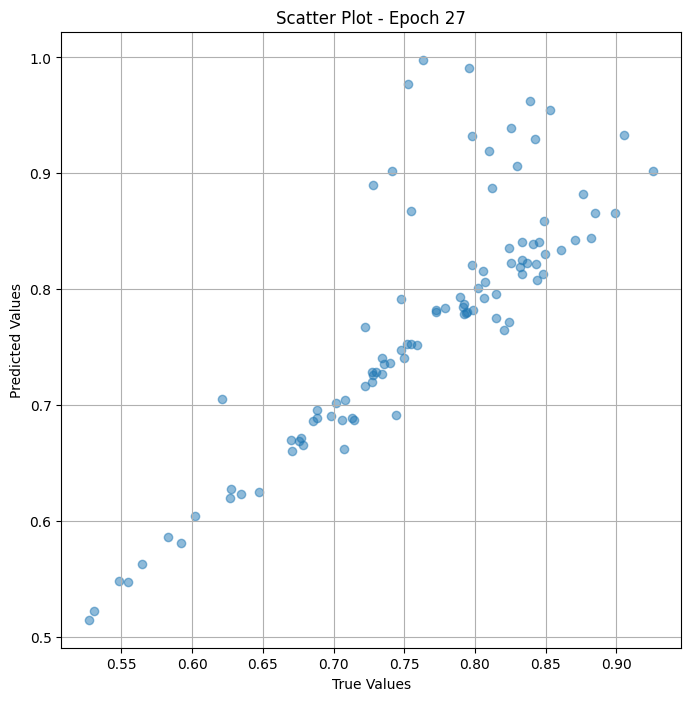


 Epoch: (28/50) Loss = 0.0023755591828376055

 Epoch: (28/50) Loss_rmse = 0.048739708960056305

 Epoch: (28/50) R^2 = 0.07827293872833252

 Epoch: (28/50) MAE = 0.025262460112571716

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747

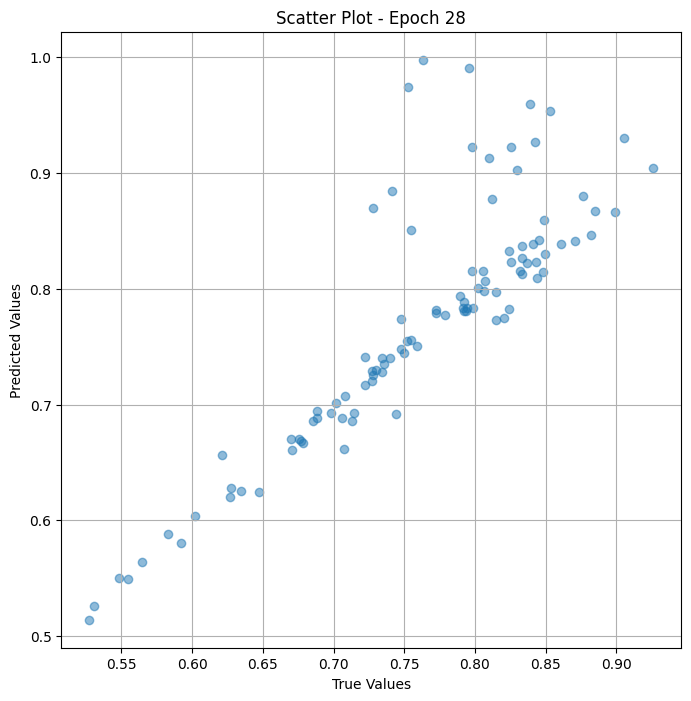


 Epoch: (29/50) Loss = 0.0014007601421326399

 Epoch: (29/50) Loss_rmse = 0.03742672875523567

 Epoch: (29/50) R^2 = 0.4564990997314453

 Epoch: (29/50) MAE = 0.019728943705558777

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274725

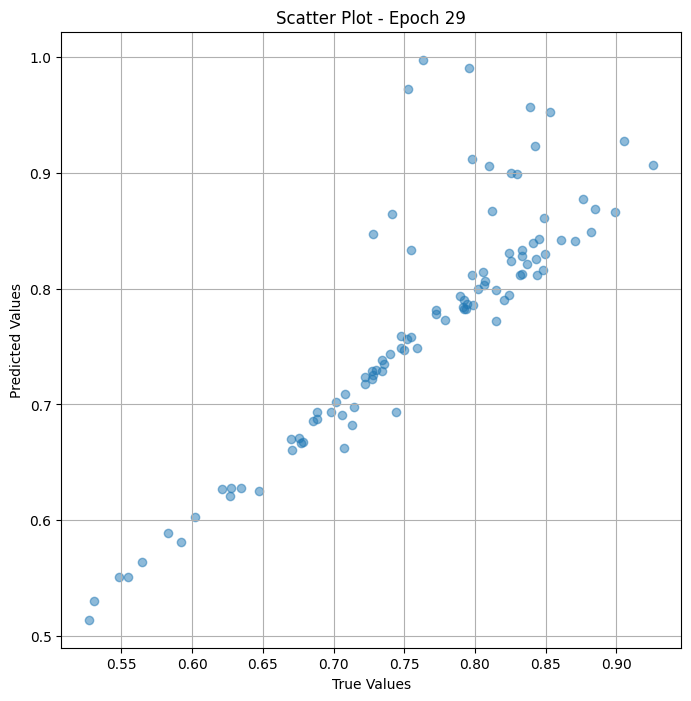


 Epoch: (30/50) Loss = 0.0005285434308461845

 Epoch: (30/50) Loss_rmse = 0.022990072146058083

 Epoch: (30/50) R^2 = 0.7949228882789612

 Epoch: (30/50) MAE = 0.012533023953437805

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527472

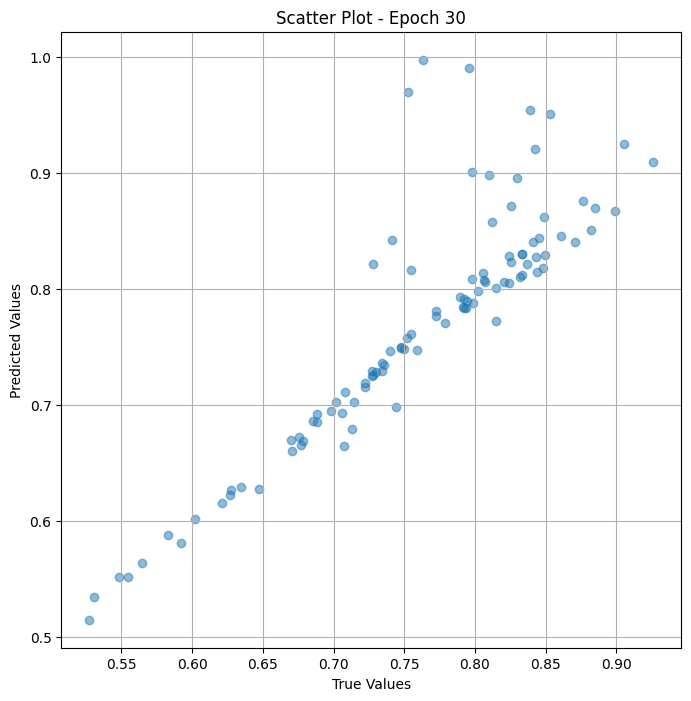


 Epoch: (31/50) Loss = 5.8963243645848706e-05

 Epoch: (31/50) Loss_rmse = 0.007678752765059471

 Epoch: (31/50) R^2 = 0.9771220088005066

 Epoch: (31/50) MAE = 0.004853144288063049

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747

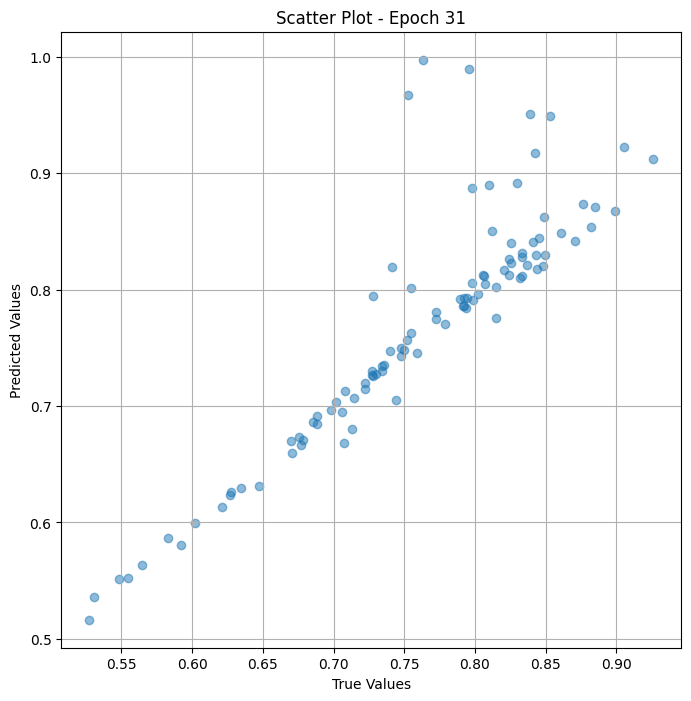


 Epoch: (32/50) Loss = 1.3644685168401338e-05

 Epoch: (32/50) Loss_rmse = 0.0036938712000846863

 Epoch: (32/50) R^2 = 0.9947057962417603

 Epoch: (32/50) MAE = 0.0028288811445236206

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527

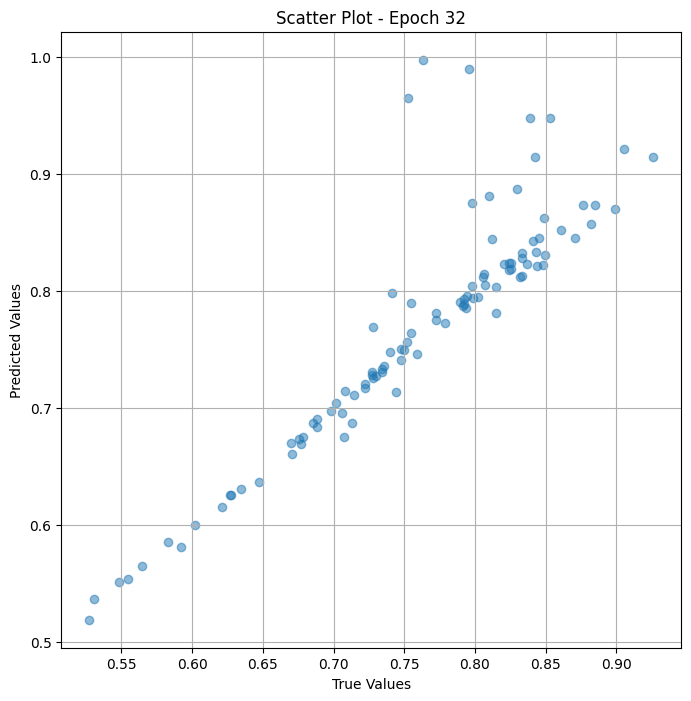


 Epoch: (33/50) Loss = 4.0768318285699934e-05

 Epoch: (33/50) Loss_rmse = 0.006385007407516241

 Epoch: (33/50) R^2 = 0.9841817021369934

 Epoch: (33/50) MAE = 0.0043618083000183105

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274

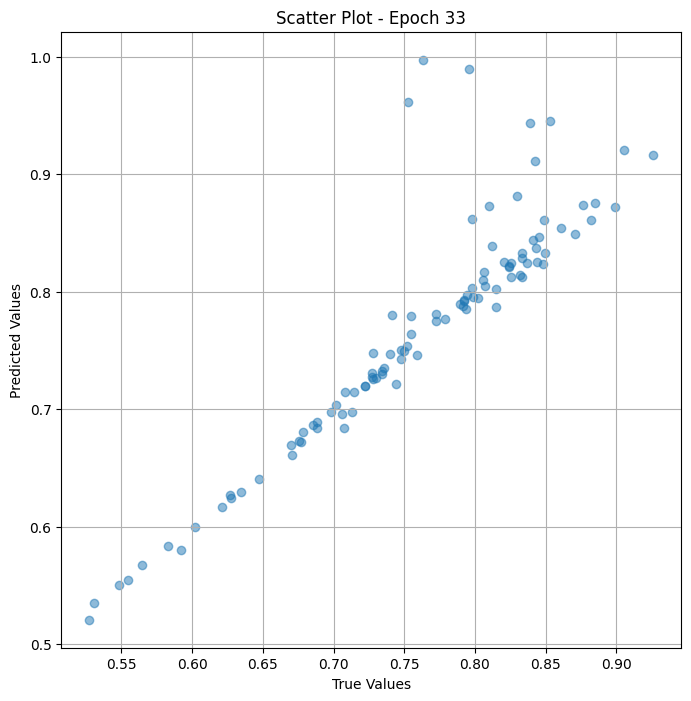


 Epoch: (34/50) Loss = 1.7194257452501915e-05

 Epoch: (34/50) Loss_rmse = 0.004146595951169729

 Epoch: (34/50) R^2 = 0.9933285713195801

 Epoch: (34/50) MAE = 0.0032908469438552856

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274

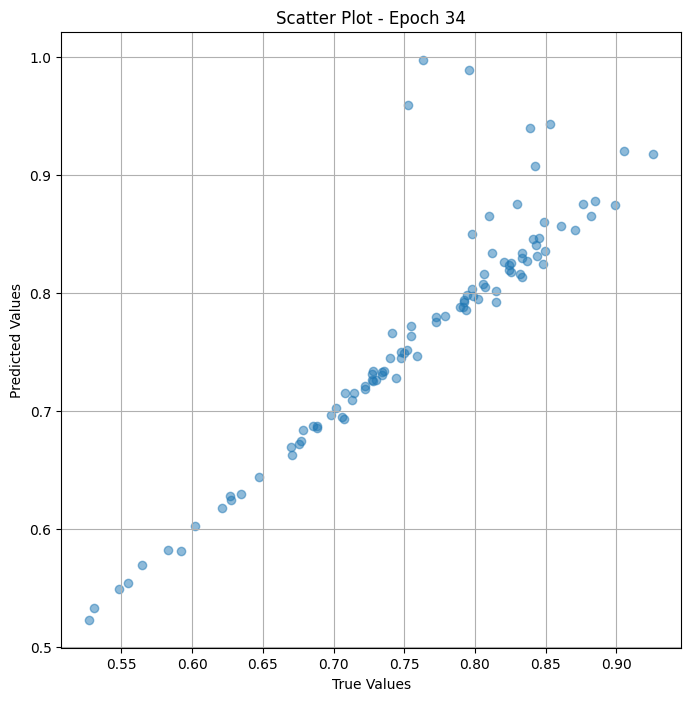


 Epoch: (35/50) Loss = 4.009903932455927e-06

 Epoch: (35/50) Loss_rmse = 0.0020024743862450123

 Epoch: (35/50) R^2 = 0.998444139957428

 Epoch: (35/50) MAE = 0.0018971115350723267

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52747

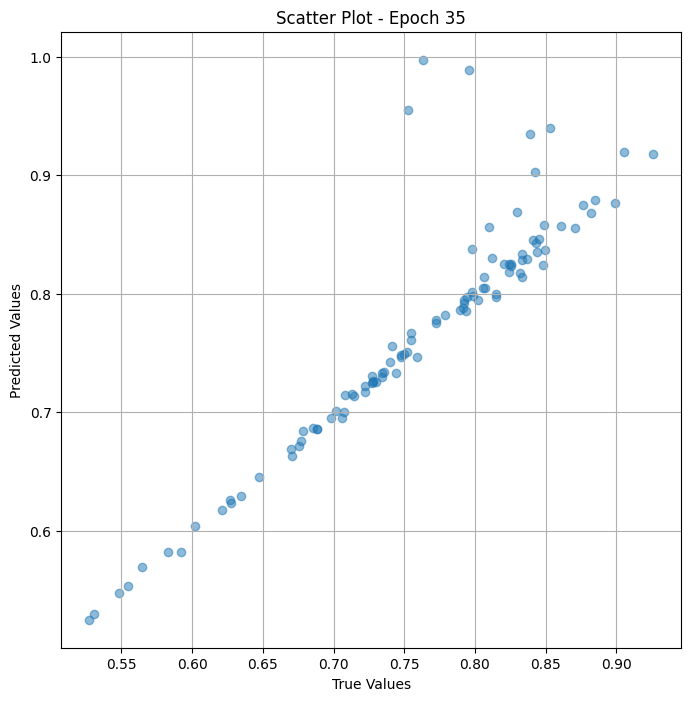


 Epoch: (36/50) Loss = 2.0843567654083017e-06

 Epoch: (36/50) Loss_rmse = 0.0014437302015721798

 Epoch: (36/50) R^2 = 0.9991912841796875

 Epoch: (36/50) MAE = 0.0012177824974060059

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527

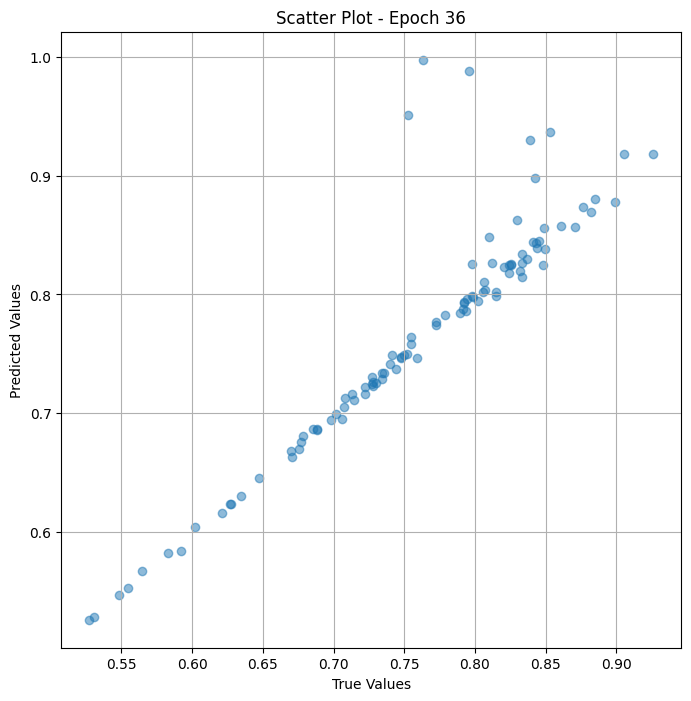


 Epoch: (37/50) Loss = 1.4783596498091356e-06

 Epoch: (37/50) Loss_rmse = 0.0012158781755715609

 Epoch: (37/50) R^2 = 0.9994263648986816

 Epoch: (37/50) MAE = 0.0010757595300674438

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527

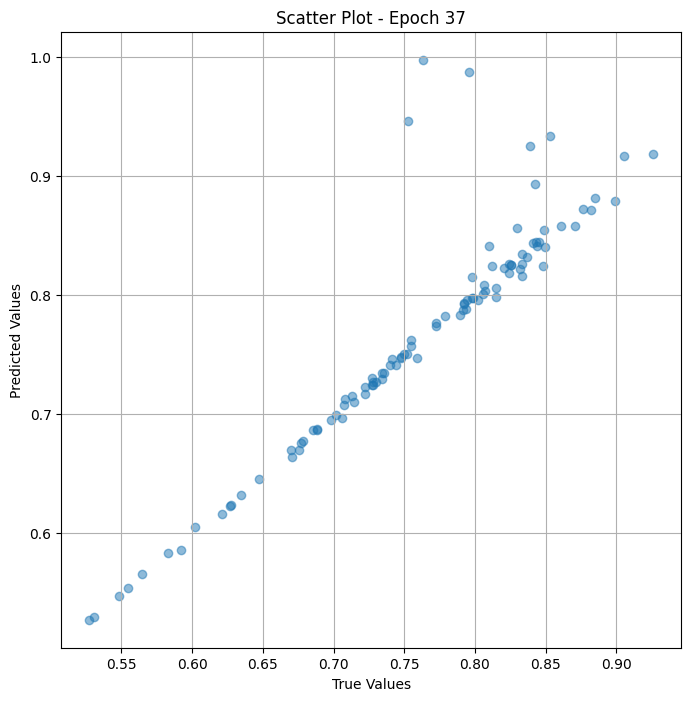


 Epoch: (38/50) Loss = 1.8181101495429175e-06

 Epoch: (38/50) Loss_rmse = 0.0013483731308951974

 Epoch: (38/50) R^2 = 0.9992945790290833

 Epoch: (38/50) MAE = 0.0012733787298202515

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527

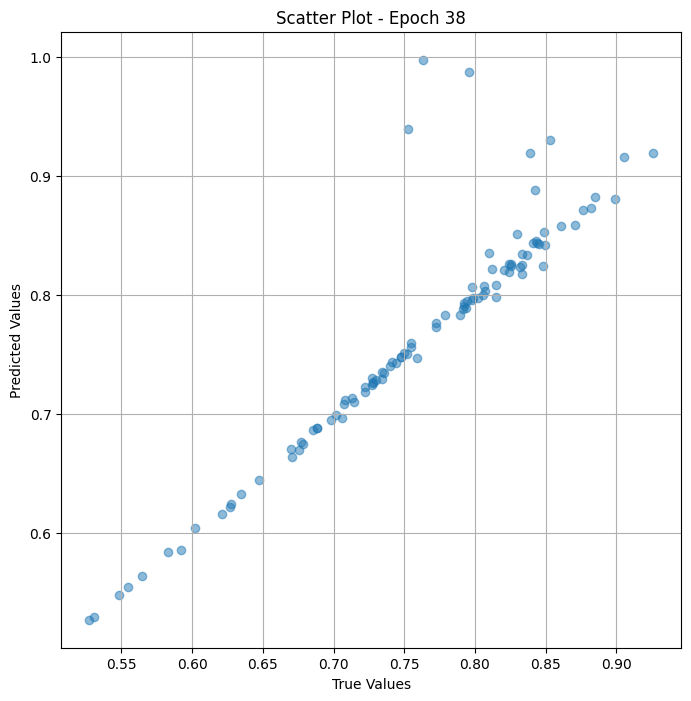


 Epoch: (39/50) Loss = 2.6643772343959427e-06

 Epoch: (39/50) Loss_rmse = 0.0016322920564562082

 Epoch: (39/50) R^2 = 0.9989662170410156

 Epoch: (39/50) MAE = 0.001516088843345642

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274

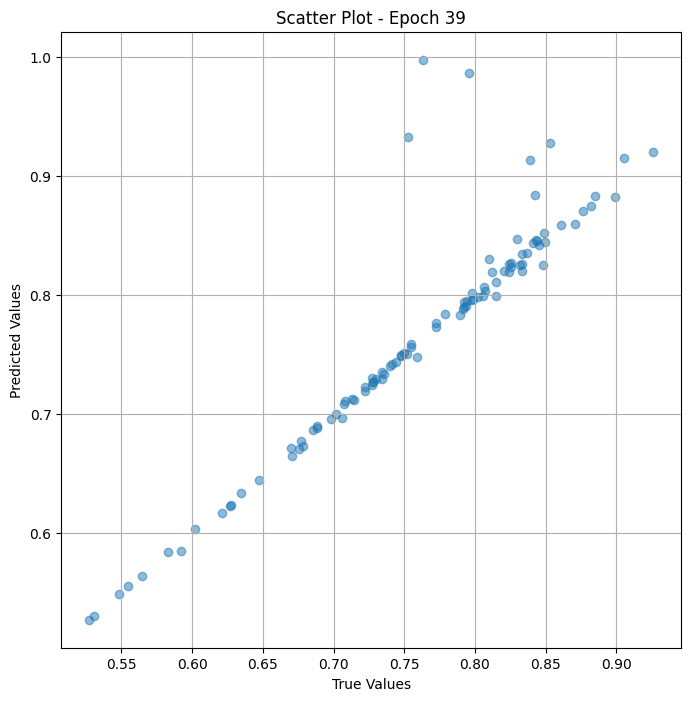


 Epoch: (40/50) Loss = 3.1930453587847296e-06

 Epoch: (40/50) Loss_rmse = 0.0017869094153866172

 Epoch: (40/50) R^2 = 0.9987610578536987

 Epoch: (40/50) MAE = 0.0016303956508636475

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527

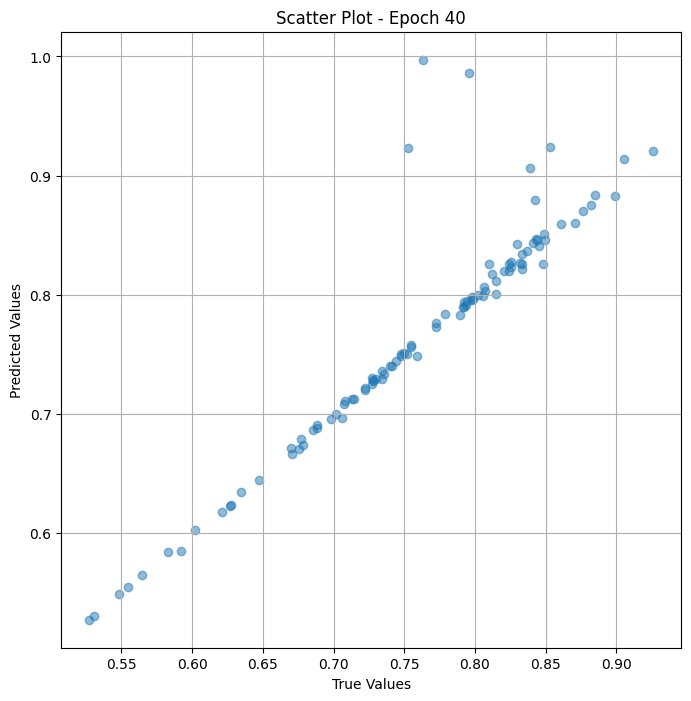


 Epoch: (41/50) Loss = 3.2840850963111734e-06

 Epoch: (41/50) Loss_rmse = 0.001812204485759139

 Epoch: (41/50) R^2 = 0.9987257719039917

 Epoch: (41/50) MAE = 0.0016492009162902832

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274

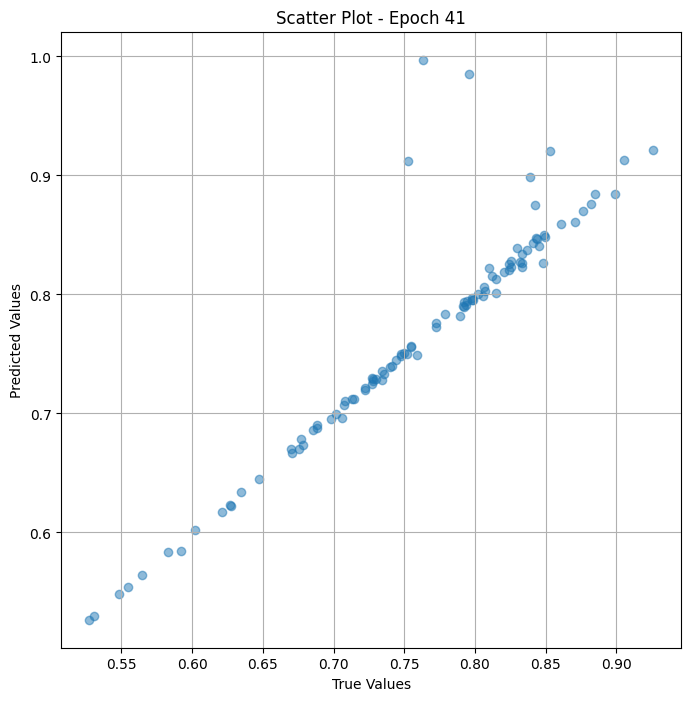


 Epoch: (42/50) Loss = 3.3655499009910272e-06

 Epoch: (42/50) Loss_rmse = 0.0018345435382798314

 Epoch: (42/50) R^2 = 0.9986941814422607

 Epoch: (42/50) MAE = 0.0016632527112960815

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527

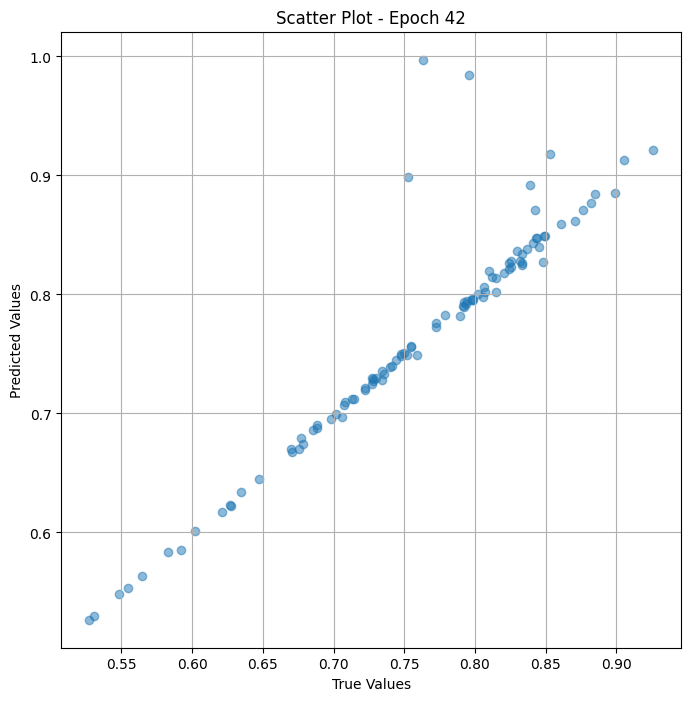


 Epoch: (43/50) Loss = 3.5181010389351286e-06

 Epoch: (43/50) Loss_rmse = 0.0018756601493805647

 Epoch: (43/50) R^2 = 0.998634934425354

 Epoch: (43/50) MAE = 0.0016756057739257812

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274

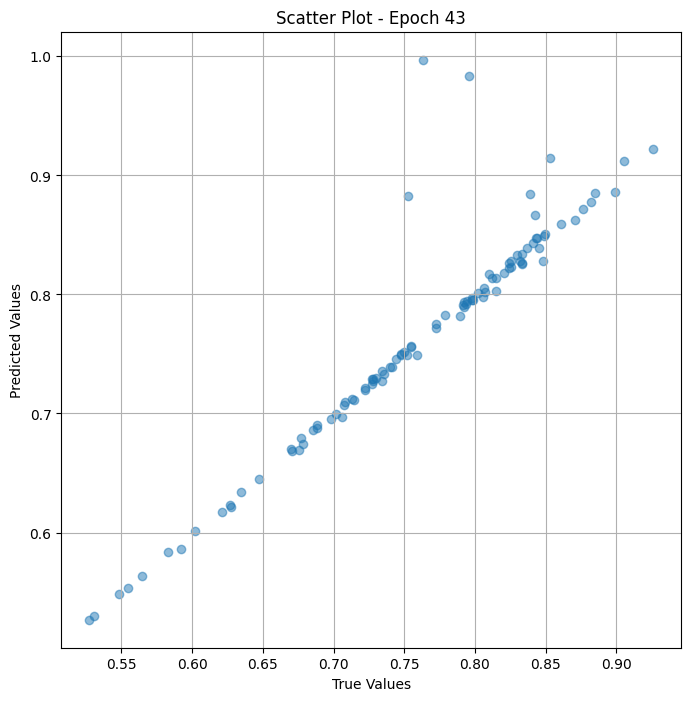


 Epoch: (44/50) Loss = 3.3747301131370477e-06

 Epoch: (44/50) Loss_rmse = 0.0018370439065620303

 Epoch: (44/50) R^2 = 0.9986906051635742

 Epoch: (44/50) MAE = 0.0016296952962875366

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527

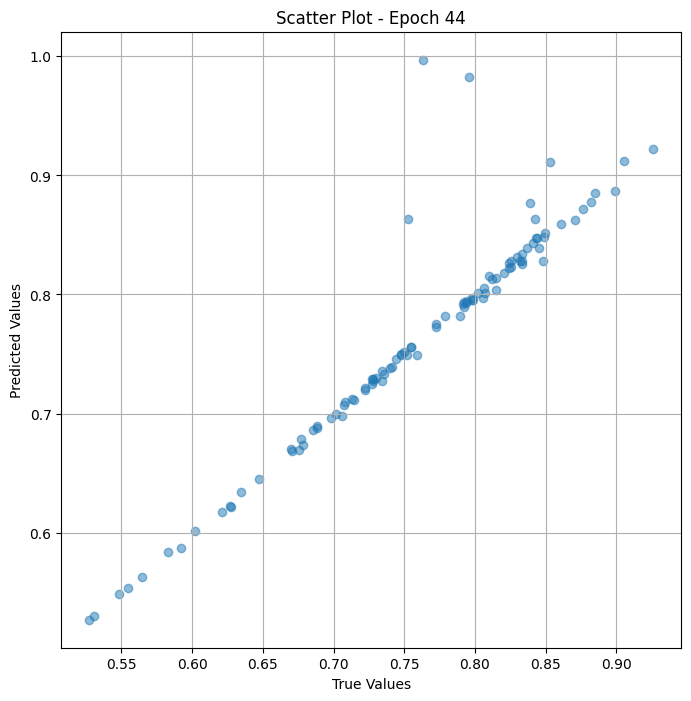


 Epoch: (45/50) Loss = 2.7037685867981054e-06

 Epoch: (45/50) Loss_rmse = 0.0016443140339106321

 Epoch: (45/50) R^2 = 0.9989508986473083

 Epoch: (45/50) MAE = 0.0014770925045013428

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.527

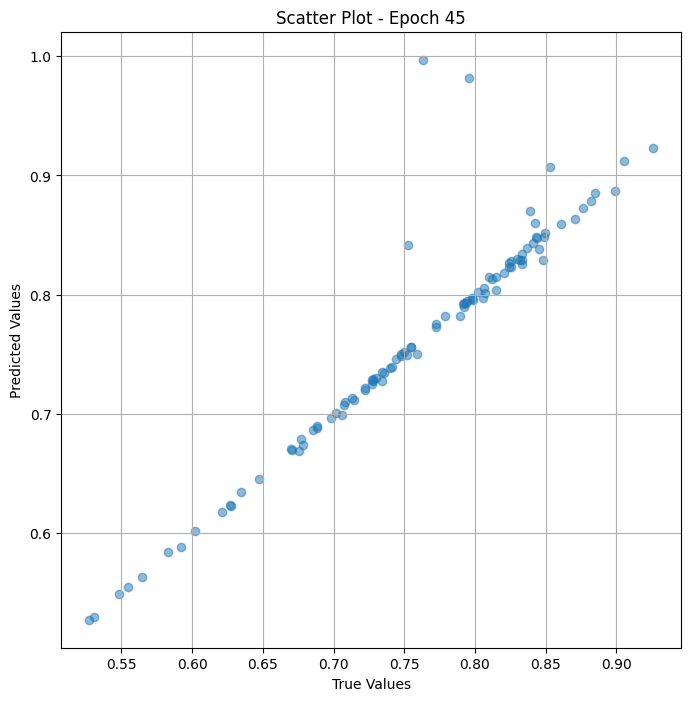


 Epoch: (46/50) Loss = 1.8404527963866713e-06

 Epoch: (46/50) Loss_rmse = 0.0013566329143941402

 Epoch: (46/50) R^2 = 0.999285876750946

 Epoch: (46/50) MAE = 0.0012516528367996216

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274

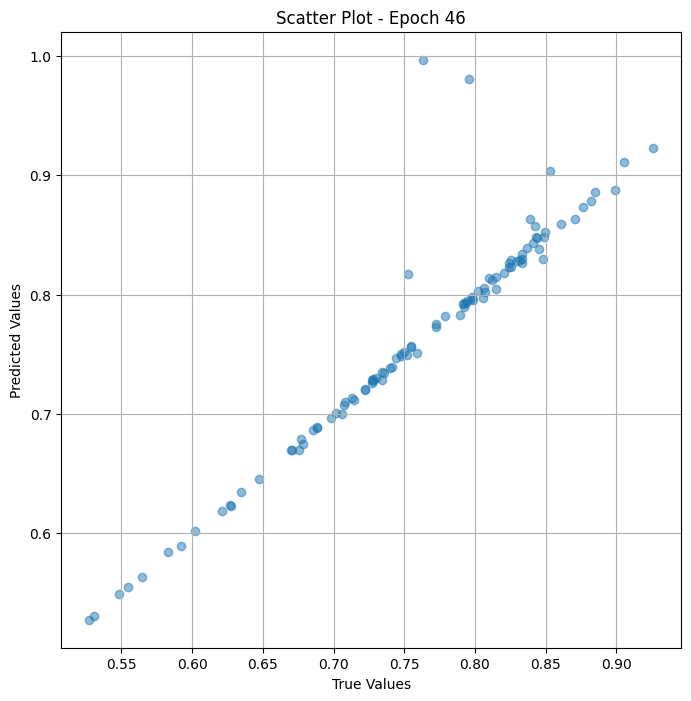


 Epoch: (47/50) Loss = 9.545400416755001e-07

 Epoch: (47/50) Loss_rmse = 0.0009770056931301951

 Epoch: (47/50) R^2 = 0.9996296167373657

 Epoch: (47/50) MAE = 0.0009200870990753174

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274

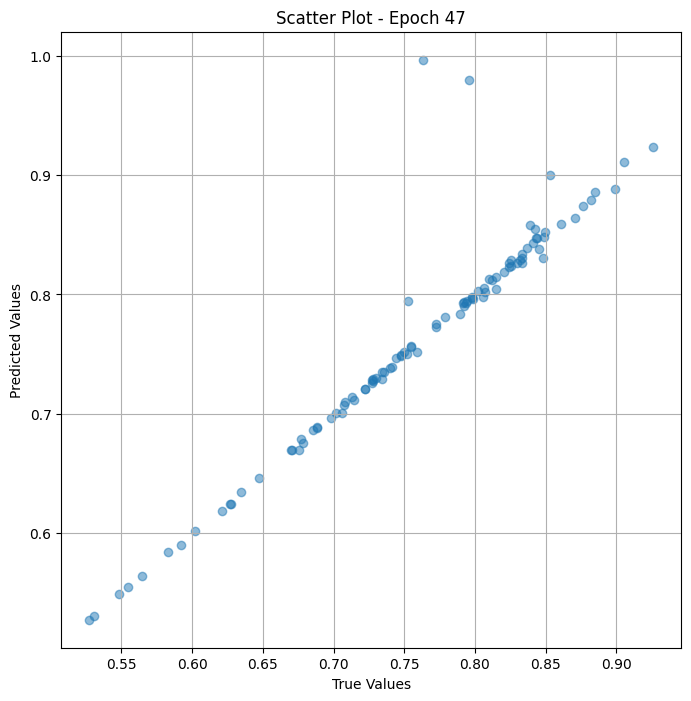


 Epoch: (48/50) Loss = 4.402483568810567e-07

 Epoch: (48/50) Loss_rmse = 0.0006635121535509825

 Epoch: (48/50) R^2 = 0.9998291730880737

 Epoch: (48/50) MAE = 0.0005655288696289062

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274

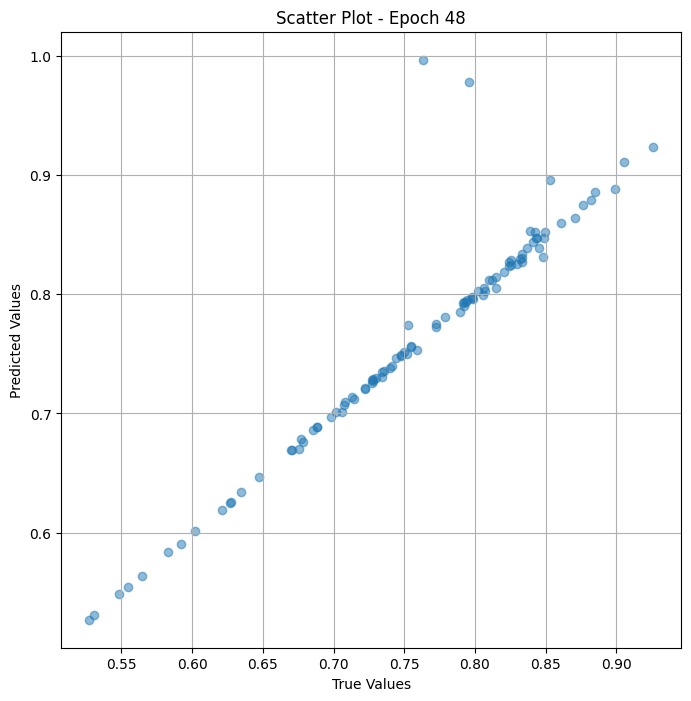


 Epoch: (49/50) Loss = 2.937781857781374e-07

 Epoch: (49/50) Loss_rmse = 0.0005420130910351872

 Epoch: (49/50) R^2 = 0.9998860359191895

 Epoch: (49/50) MAE = 0.0003959238529205322

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.5274

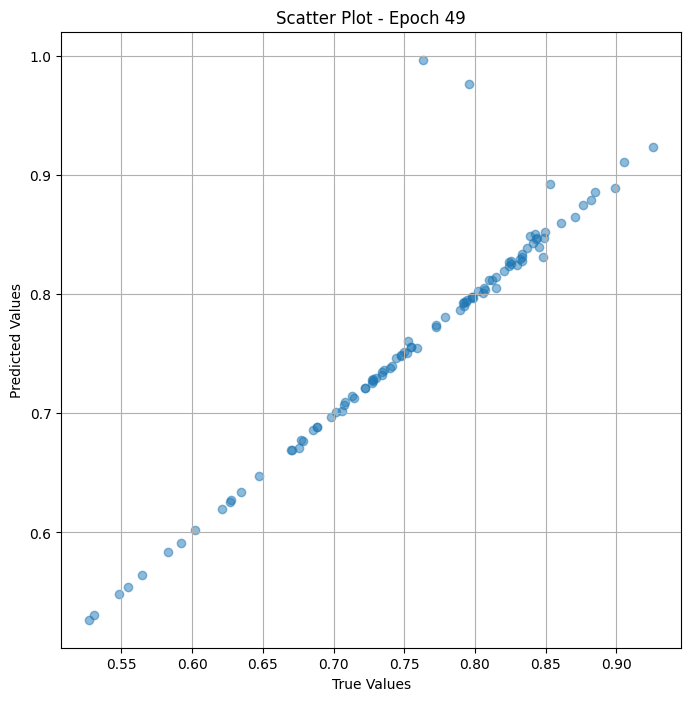


 Epoch: (50/50) Loss = 2.8050385481037665e-07

 Epoch: (50/50) Loss_rmse = 0.0005296261515468359

 Epoch: (50/50) R^2 = 0.9998911619186401

 Epoch: (50/50) MAE = 0.00039623677730560303

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.79569894, 0.8333333, 0.9052632, 0.7281553, 0.81, 0.72727275, 0.853211, 0.7894737, 0.84375, 0.77227724, 0.6698113, 0.83168316, 0.7222222, 0.74157304, 0.9259259, 0.6210526, 0.60215056, 0.8207547, 0.7058824, 0.73, 0.87628865, 0.84313726, 0.84070796, 0.8484849, 0.7979798, 0.68817204, 0.7916667, 0.56435645, 0.8452381, 0.8018868, 0.55454546, 0.79347825, 0.8064516, 0.7395833, 0.74444443, 0.8118812, 0.73394495, 0.62650603, 0.75, 0.7589286, 0.7980769, 0.83, 0.8367347, 0.84782606, 0.72727275, 0.7222222, 0.59210527, 0.6979167, 0.5308642, 0.82417583, 0.87096775, 0.7478992, 0.7473684, 0.77884614, 0.7019231, 0.76344085, 0.63461536, 0.75247526, 0.88235295, 0.89908254, 0.8495575, 0.70731705, 0.71428573, 0.5480769, 0.8252427, 0.52

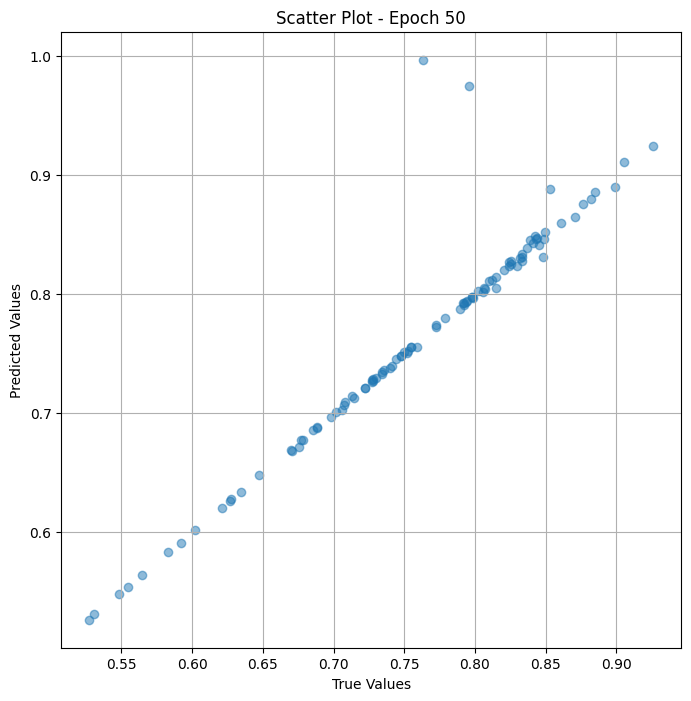

In [ ]:
# Training the model and save weights
fit(50, modelfine_val, train_dl_val)
torch.save(model.state_dict(), "model_weights_valr_fine")

## Test

In [ ]:
# Merge the two models
class model_merge_fine_test(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_fine_test = model_merge_fine_test(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_test = DeviceDataLoader(train_dl_test, device)
model_fine_test = to_device(model_fine_test, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_fine_test.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_fine_test , train_dl_test ):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_fine_test .eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_test :
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_fine_test (x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.07166774570941925

 Epoch: (1/50) Loss_rmse = 0.26770833134651184

 Epoch: (1/50) R^2 = -5.779791831970215

 Epoch: (1/50) MAE = 0.24874347448349

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0.76

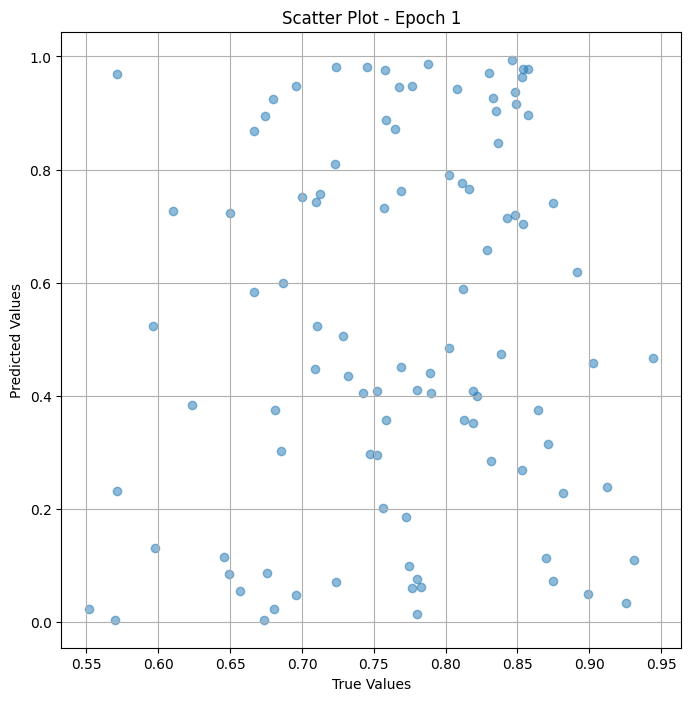


 Epoch: (2/50) Loss = 0.08423188328742981

 Epoch: (2/50) Loss_rmse = 0.2902272939682007

 Epoch: (2/50) R^2 = -6.968363285064697

 Epoch: (2/50) MAE = 0.27284175157546997

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0.

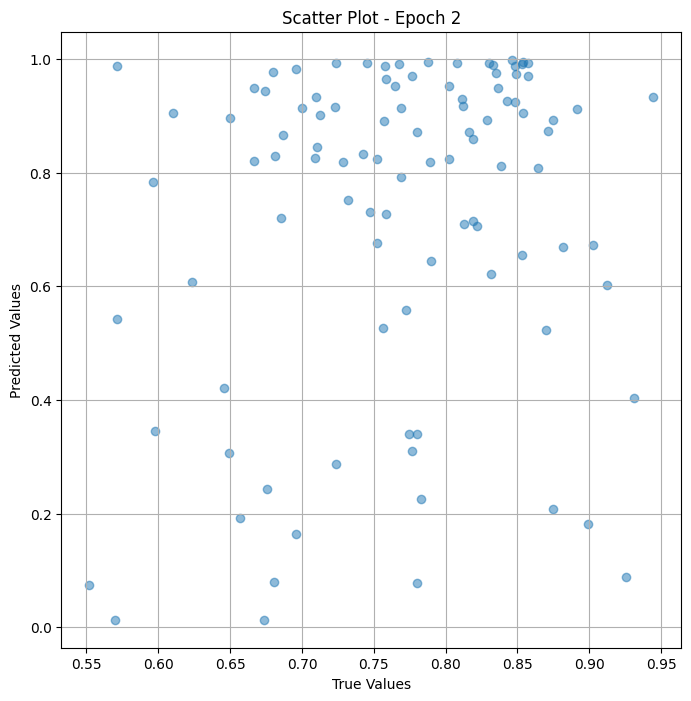


 Epoch: (3/50) Loss = 0.08859413117170334

 Epoch: (3/50) Loss_rmse = 0.2976476550102234

 Epoch: (3/50) R^2 = -7.381032943725586

 Epoch: (3/50) MAE = 0.28044721484184265

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0.

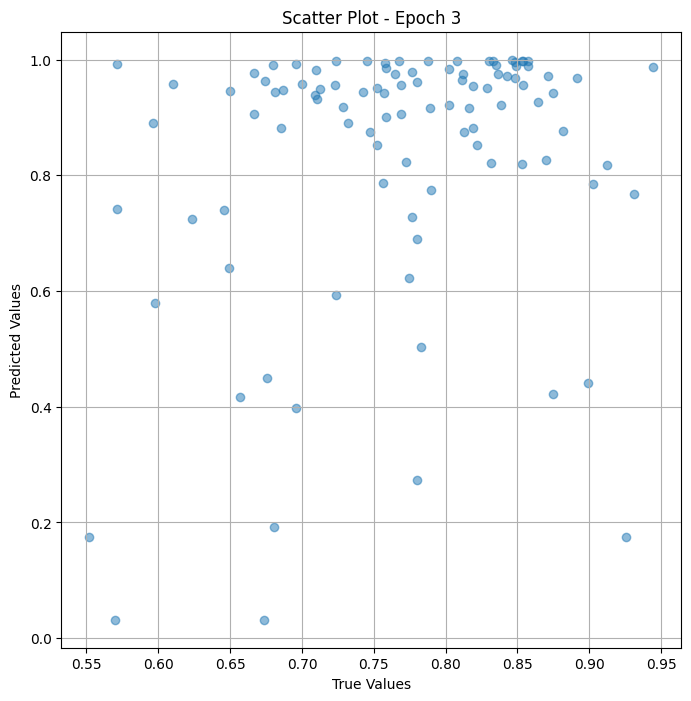


 Epoch: (4/50) Loss = 0.08956687152385712

 Epoch: (4/50) Loss_rmse = 0.29927724599838257

 Epoch: (4/50) R^2 = -7.473054885864258

 Epoch: (4/50) MAE = 0.282123327255249

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0.7

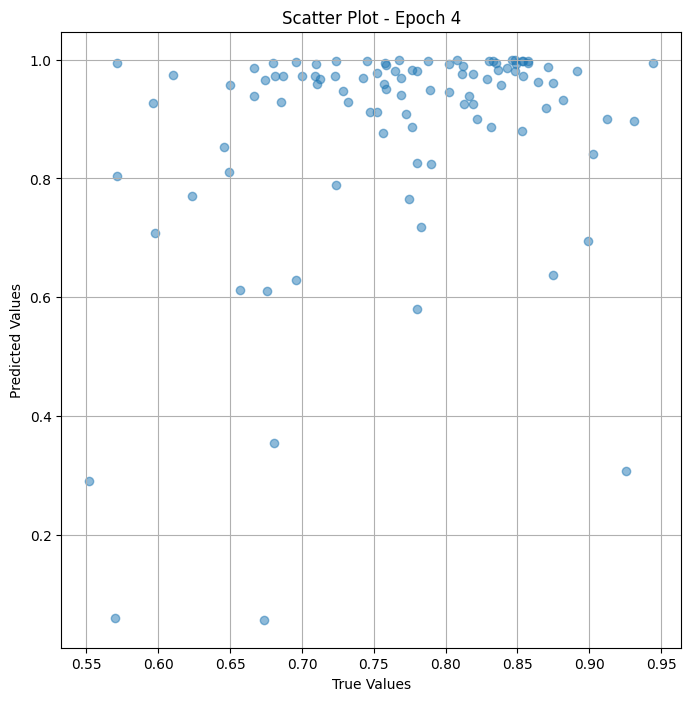


 Epoch: (5/50) Loss = 0.08861496299505234

 Epoch: (5/50) Loss_rmse = 0.29768264293670654

 Epoch: (5/50) R^2 = -7.383004188537598

 Epoch: (5/50) MAE = 0.28057342767715454

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0

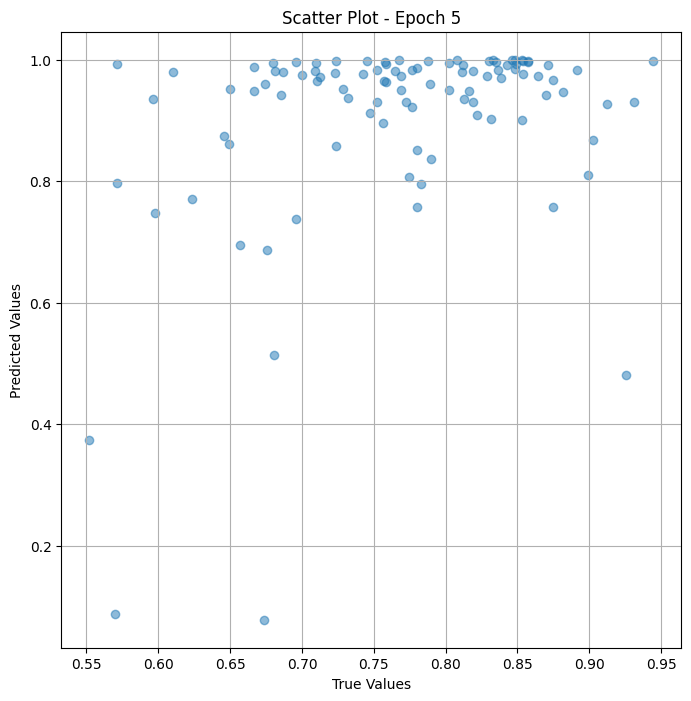


 Epoch: (6/50) Loss = 0.08571560680866241

 Epoch: (6/50) Loss_rmse = 0.2927722632884979

 Epoch: (6/50) R^2 = -7.1087236404418945

 Epoch: (6/50) MAE = 0.2756155729293823

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0.

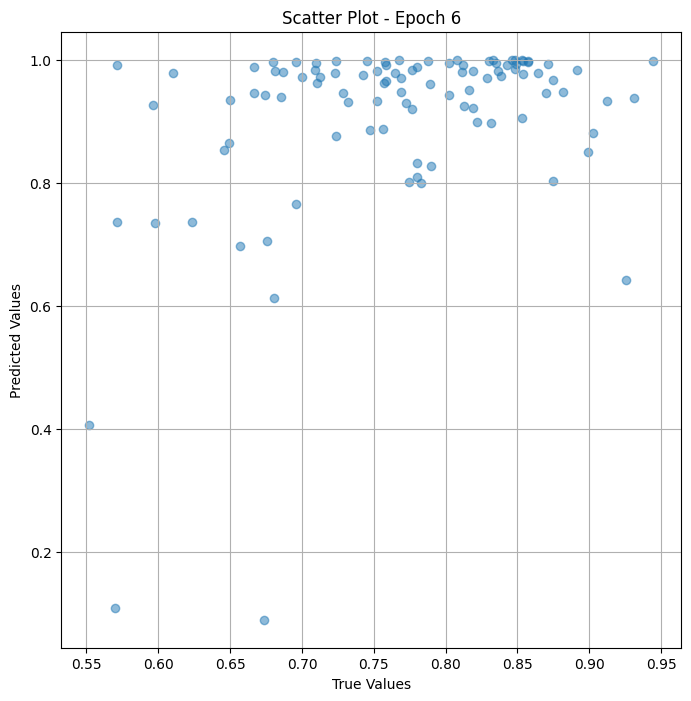


 Epoch: (7/50) Loss = 0.0800628513097763

 Epoch: (7/50) Loss_rmse = 0.28295379877090454

 Epoch: (7/50) R^2 = -6.573971271514893

 Epoch: (7/50) MAE = 0.26507848501205444

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0.

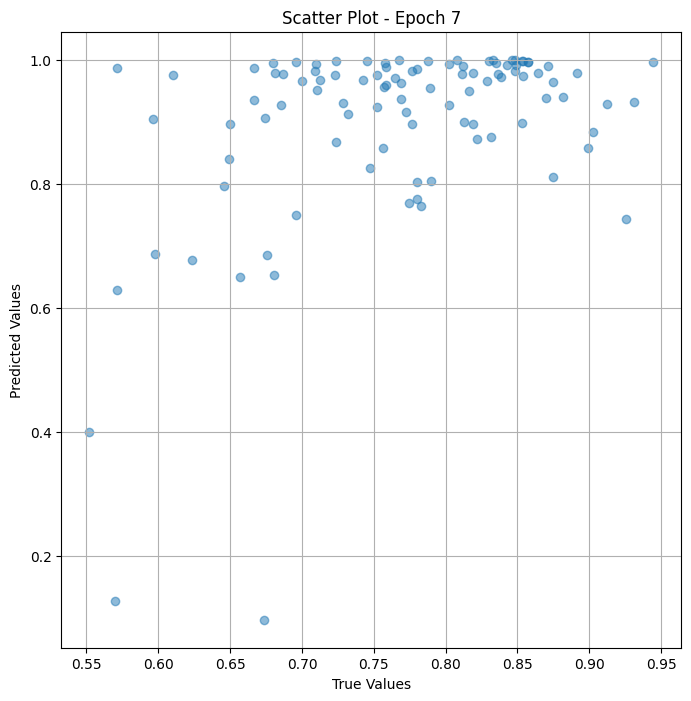


 Epoch: (8/50) Loss = 0.07148857414722443

 Epoch: (8/50) Loss_rmse = 0.2673734724521637

 Epoch: (8/50) R^2 = -5.762842178344727

 Epoch: (8/50) MAE = 0.24566899240016937

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0.

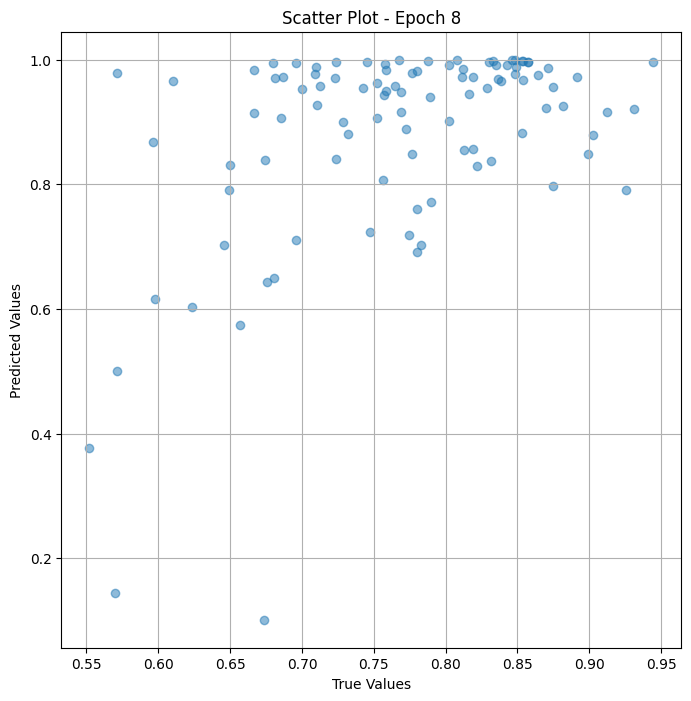


 Epoch: (9/50) Loss = 0.06353999674320221

 Epoch: (9/50) Loss_rmse = 0.25207141041755676

 Epoch: (9/50) R^2 = -5.010903835296631

 Epoch: (9/50) MAE = 0.21837960183620453

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856, 0

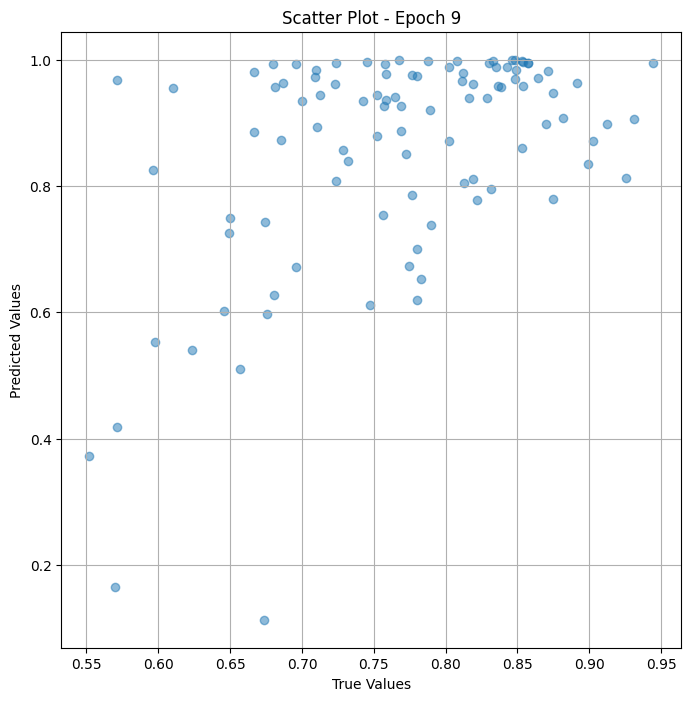


 Epoch: (10/50) Loss = 0.06019008904695511

 Epoch: (10/50) Loss_rmse = 0.24533668160438538

 Epoch: (10/50) R^2 = -4.6940016746521

 Epoch: (10/50) MAE = 0.19984105229377747

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856,

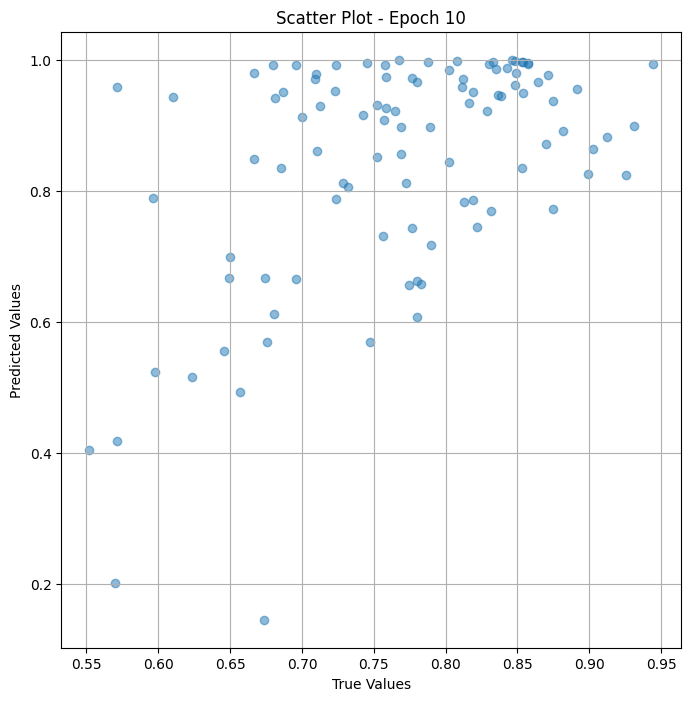


 Epoch: (11/50) Loss = 0.05797896906733513

 Epoch: (11/50) Loss_rmse = 0.24078822135925293

 Epoch: (11/50) R^2 = -4.484828948974609

 Epoch: (11/50) MAE = 0.20010079443454742

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8536585

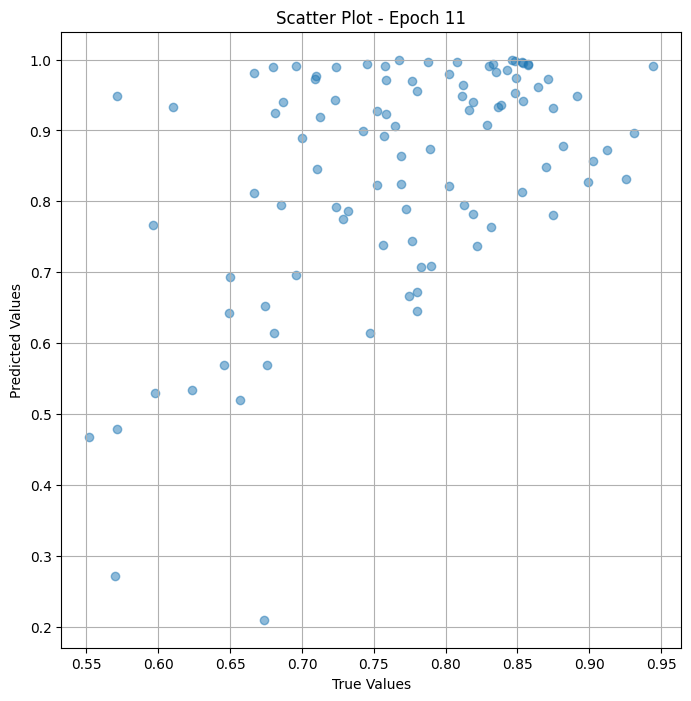


 Epoch: (12/50) Loss = 0.05356818437576294

 Epoch: (12/50) Loss_rmse = 0.2314480096101761

 Epoch: (12/50) R^2 = -4.067567348480225

 Epoch: (12/50) MAE = 0.19162343442440033

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856

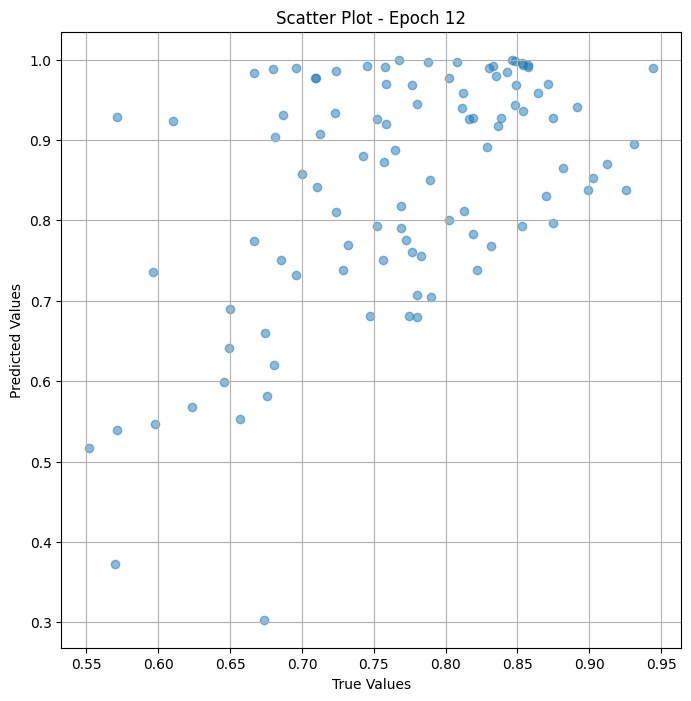


 Epoch: (13/50) Loss = 0.04432947561144829

 Epoch: (13/50) Loss_rmse = 0.21054565906524658

 Epoch: (13/50) R^2 = -3.193582534790039

 Epoch: (13/50) MAE = 0.17799140512943268

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8536585

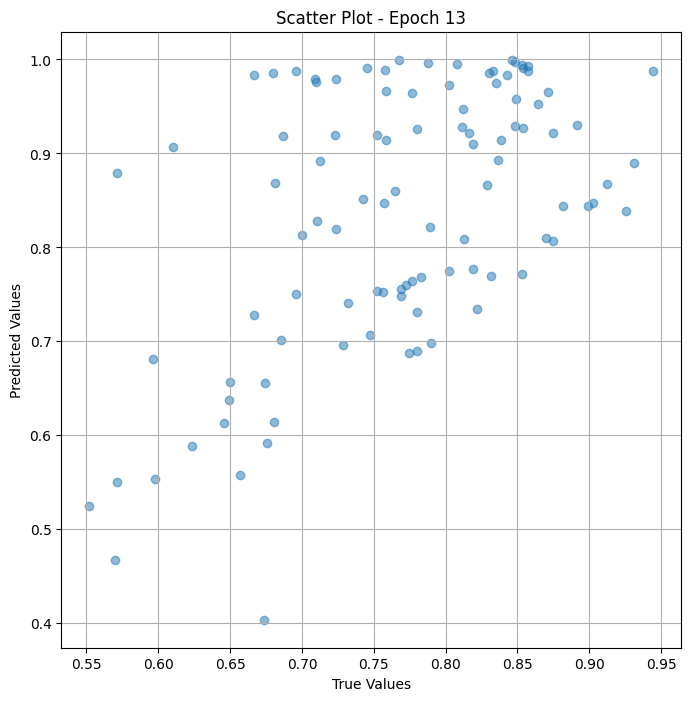


 Epoch: (14/50) Loss = 0.028649497777223587

 Epoch: (14/50) Loss_rmse = 0.1692616194486618

 Epoch: (14/50) R^2 = -1.7102515697479248

 Epoch: (14/50) MAE = 0.14825133979320526

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853658

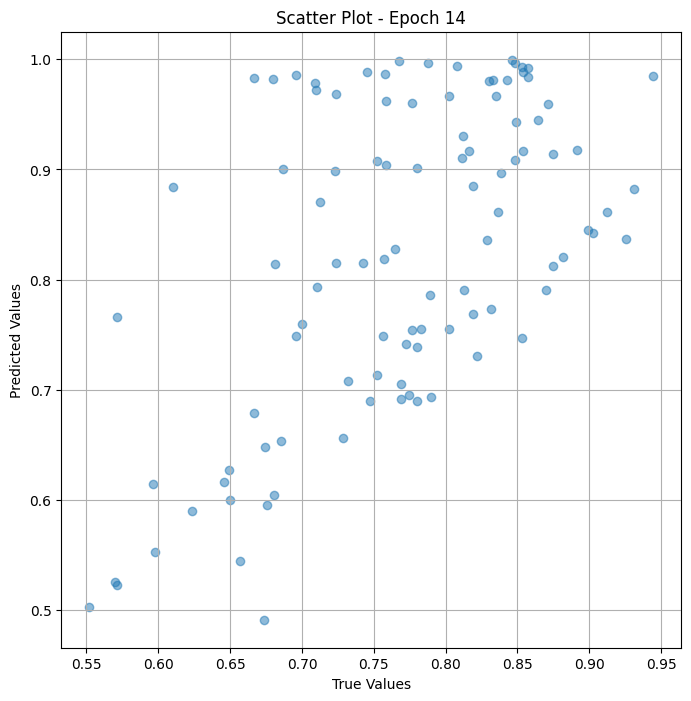


 Epoch: (15/50) Loss = 0.01730915531516075

 Epoch: (15/50) Loss_rmse = 0.13156425952911377

 Epoch: (15/50) R^2 = -0.6374516487121582

 Epoch: (15/50) MAE = 0.09649655222892761

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853658

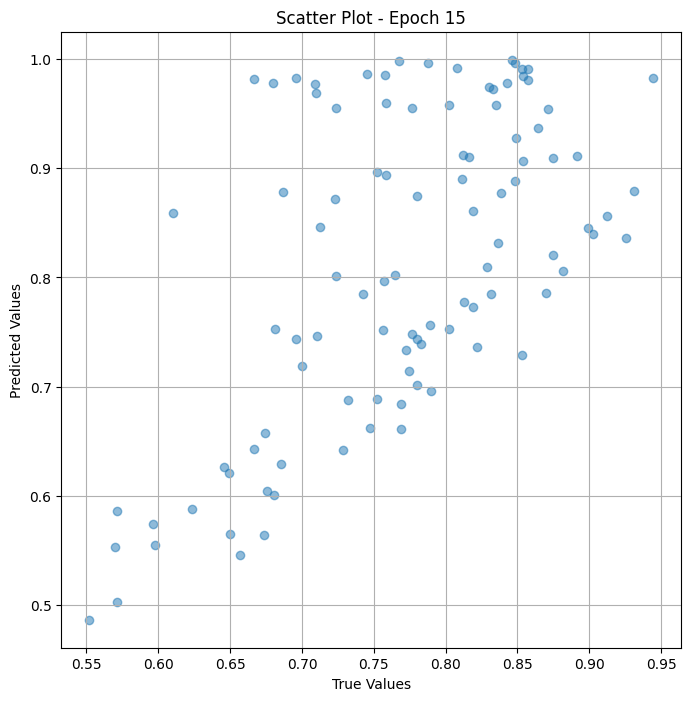


 Epoch: (16/50) Loss = 0.016003763303160667

 Epoch: (16/50) Loss_rmse = 0.1265059858560562

 Epoch: (16/50) R^2 = -0.5139610767364502

 Epoch: (16/50) MAE = 0.10294914245605469

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853658

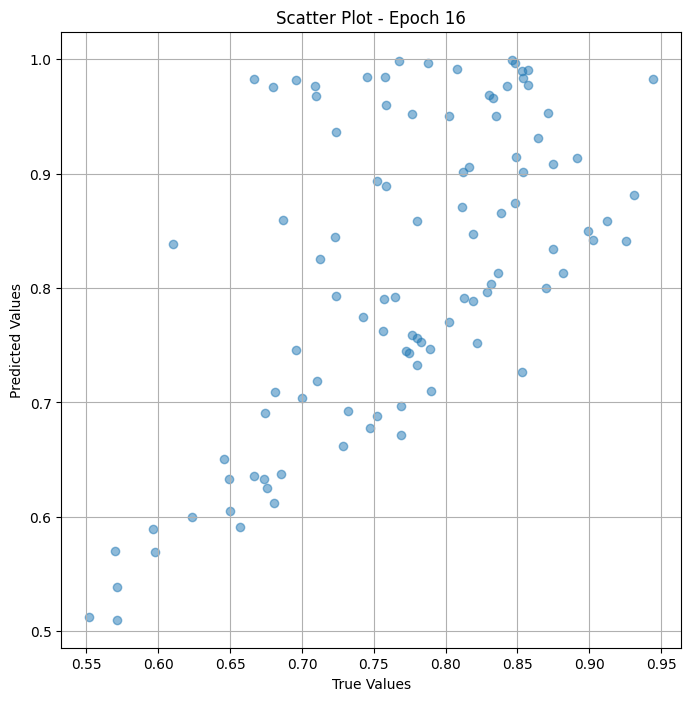


 Epoch: (17/50) Loss = 0.01173014659434557

 Epoch: (17/50) Loss_rmse = 0.10830580443143845

 Epoch: (17/50) R^2 = -0.10967564582824707

 Epoch: (17/50) MAE = 0.08768090605735779

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365

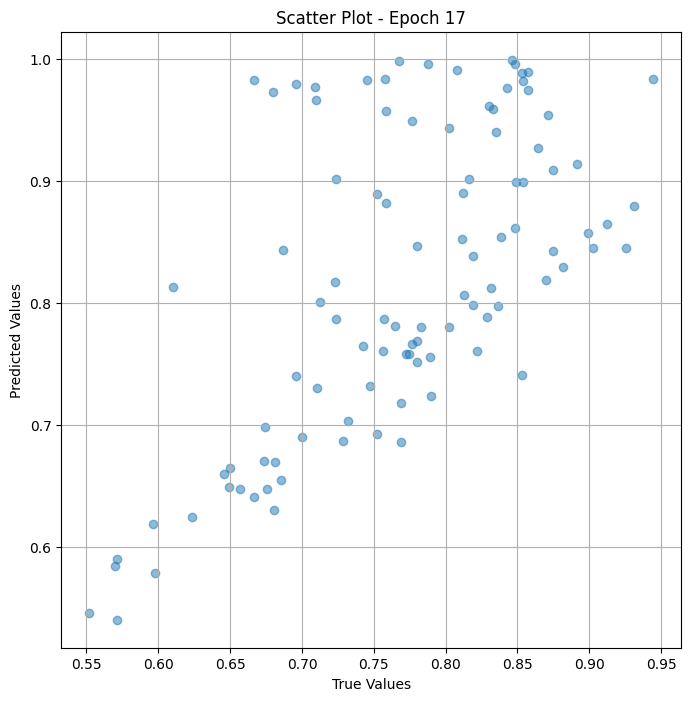


 Epoch: (18/50) Loss = 0.005950514227151871

 Epoch: (18/50) Loss_rmse = 0.07713957875967026

 Epoch: (18/50) R^2 = 0.43707942962646484

 Epoch: (18/50) MAE = 0.057151198387145996

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8536

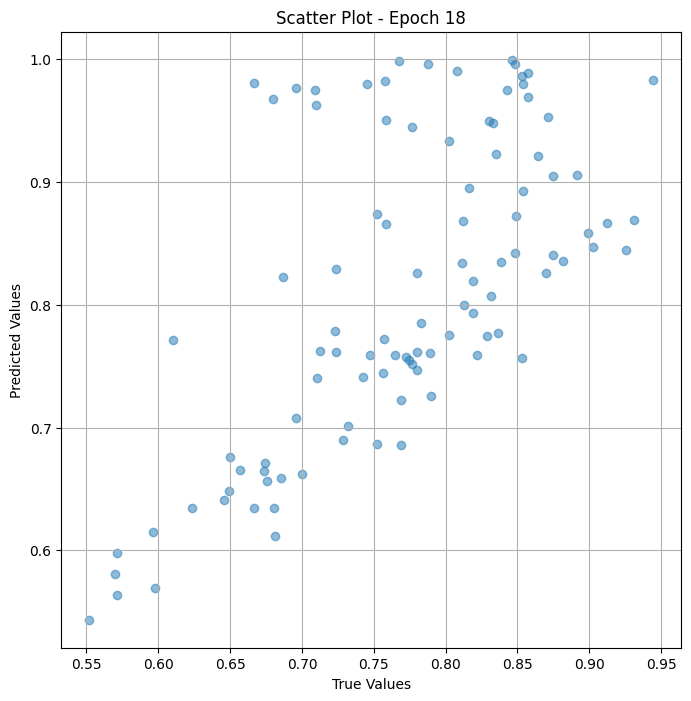


 Epoch: (19/50) Loss = 0.002991186920553446

 Epoch: (19/50) Loss_rmse = 0.05469174310564995

 Epoch: (19/50) R^2 = 0.717032790184021

 Epoch: (19/50) MAE = 0.0337839275598526

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365856

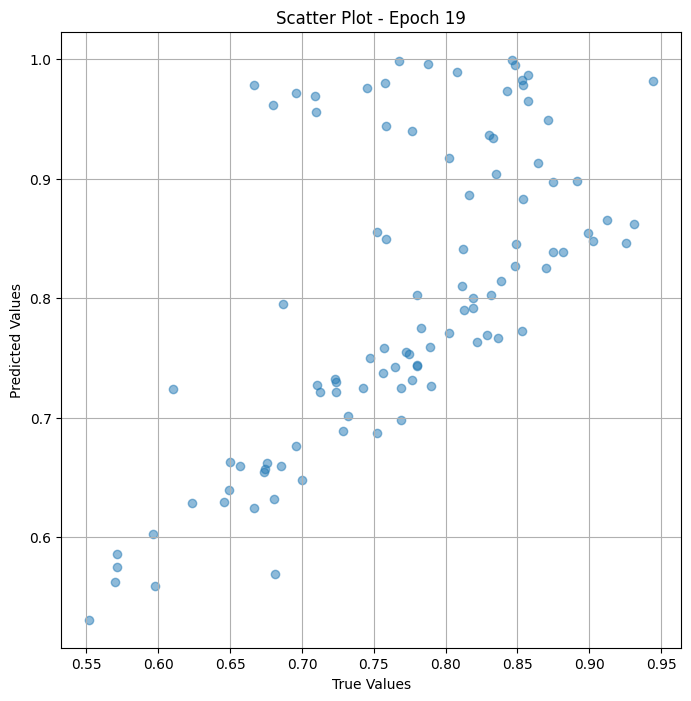


 Epoch: (20/50) Loss = 0.003005080623552203

 Epoch: (20/50) Loss_rmse = 0.054818615317344666

 Epoch: (20/50) R^2 = 0.7157183885574341

 Epoch: (20/50) MAE = 0.03772073984146118

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365

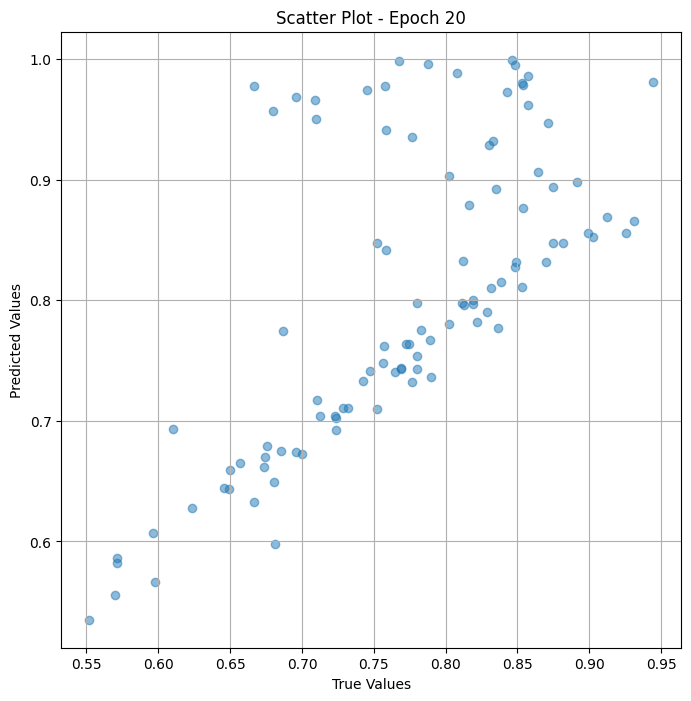


 Epoch: (21/50) Loss = 0.002418873365968466

 Epoch: (21/50) Loss_rmse = 0.049182042479515076

 Epoch: (21/50) R^2 = 0.7711738348007202

 Epoch: (21/50) MAE = 0.027693048119544983

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8536

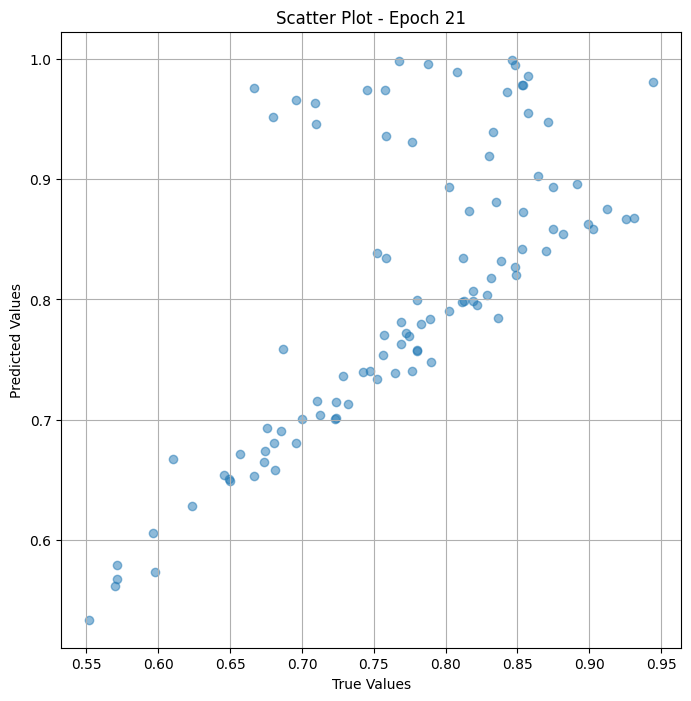


 Epoch: (22/50) Loss = 0.0019254774088039994

 Epoch: (22/50) Loss_rmse = 0.04388026148080826

 Epoch: (22/50) R^2 = 0.8178492188453674

 Epoch: (22/50) MAE = 0.02595961093902588

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365

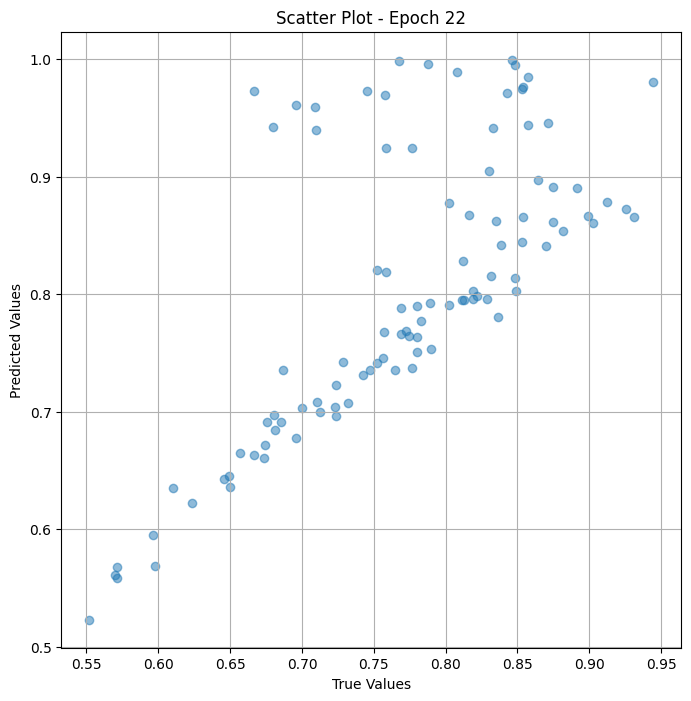


 Epoch: (23/50) Loss = 0.0013693302171304822

 Epoch: (23/50) Loss_rmse = 0.037004463374614716

 Epoch: (23/50) R^2 = 0.8704609274864197

 Epoch: (23/50) MAE = 0.020637184381484985

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

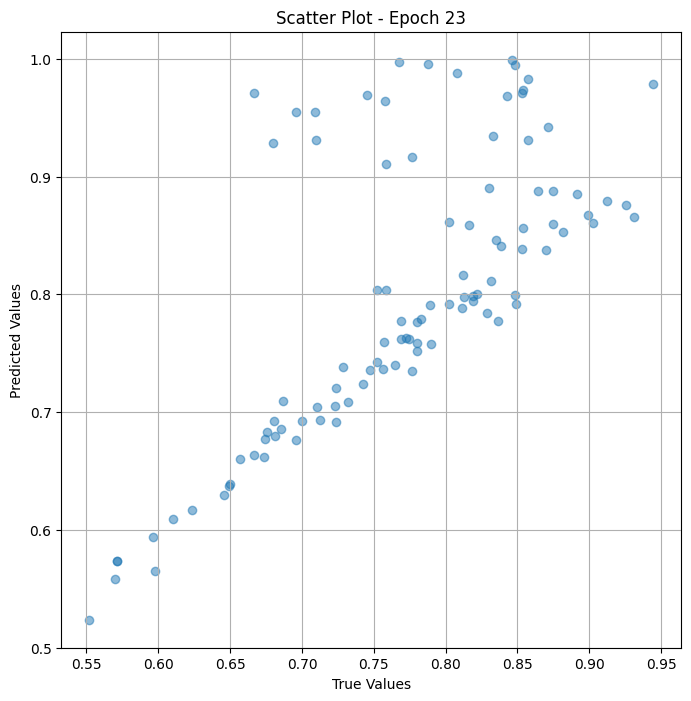


 Epoch: (24/50) Loss = 0.000922160514164716

 Epoch: (24/50) Loss_rmse = 0.03036709502339363

 Epoch: (24/50) R^2 = 0.9127632975578308

 Epoch: (24/50) MAE = 0.018348872661590576

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365

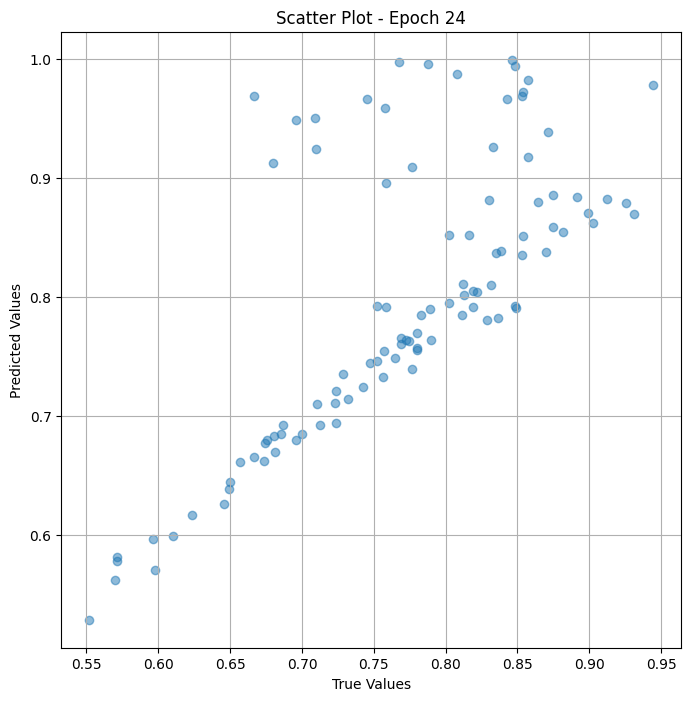


 Epoch: (25/50) Loss = 0.0005121536087244749

 Epoch: (25/50) Loss_rmse = 0.022630810737609863

 Epoch: (25/50) R^2 = 0.9515501260757446

 Epoch: (25/50) MAE = 0.012873739004135132

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

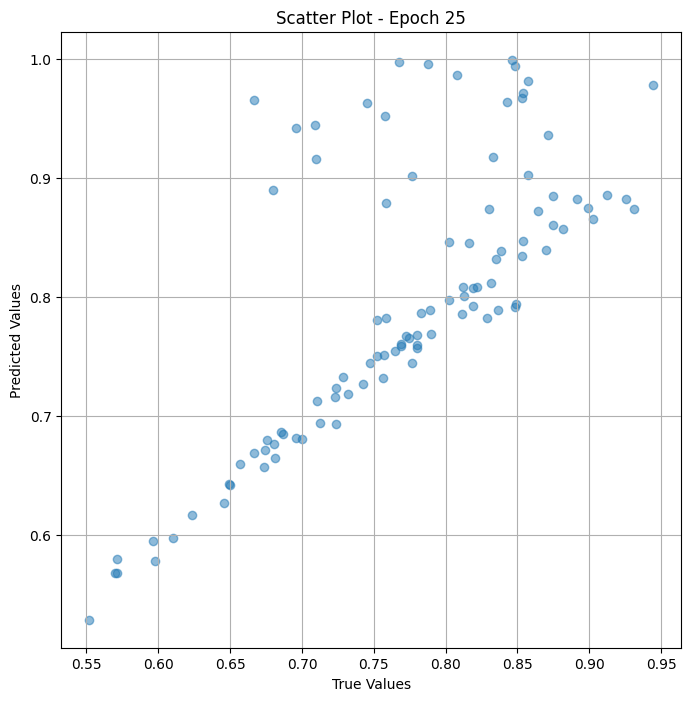


 Epoch: (26/50) Loss = 0.00022729128249920905

 Epoch: (26/50) Loss_rmse = 0.015076182782649994

 Epoch: (26/50) R^2 = 0.9784981608390808

 Epoch: (26/50) MAE = 0.009711429476737976

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

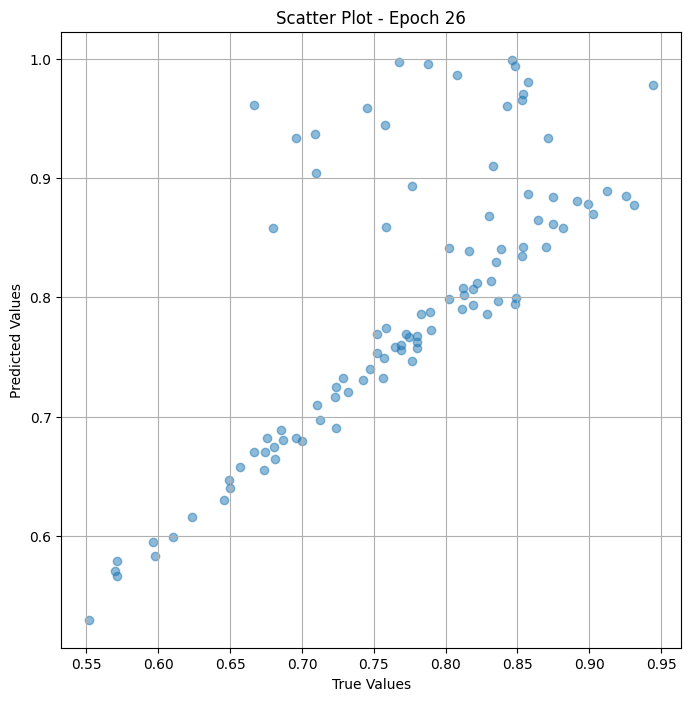


 Epoch: (27/50) Loss = 5.966560638626106e-05

 Epoch: (27/50) Loss_rmse = 0.007724351715296507

 Epoch: (27/50) R^2 = 0.9943556189537048

 Epoch: (27/50) MAE = 0.004546001553535461

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.853

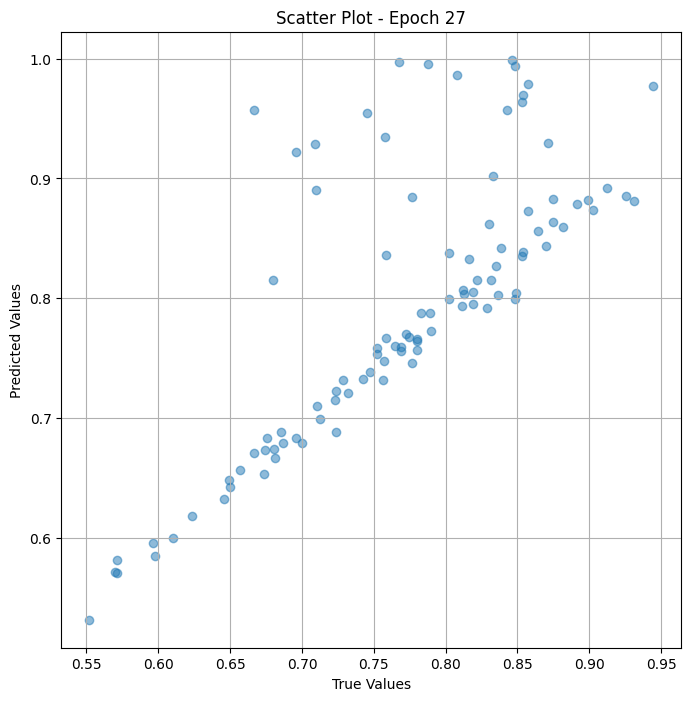


 Epoch: (28/50) Loss = 9.788102033780888e-06

 Epoch: (28/50) Loss_rmse = 0.0031285942532122135

 Epoch: (28/50) R^2 = 0.9990740418434143

 Epoch: (28/50) MAE = 0.0022729486227035522

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

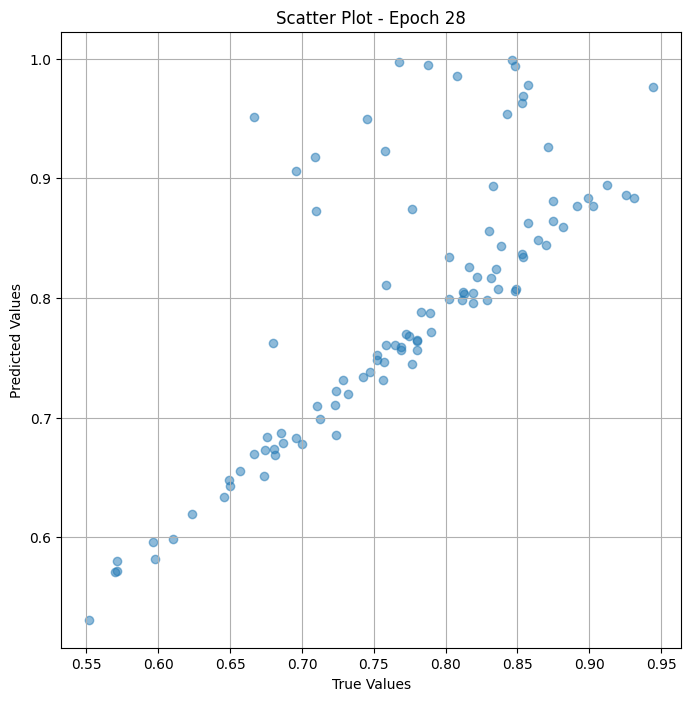


 Epoch: (29/50) Loss = 2.2198707938514417e-06

 Epoch: (29/50) Loss_rmse = 0.0014899231027811766

 Epoch: (29/50) R^2 = 0.9997900128364563

 Epoch: (29/50) MAE = 0.0012502968311309814

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.

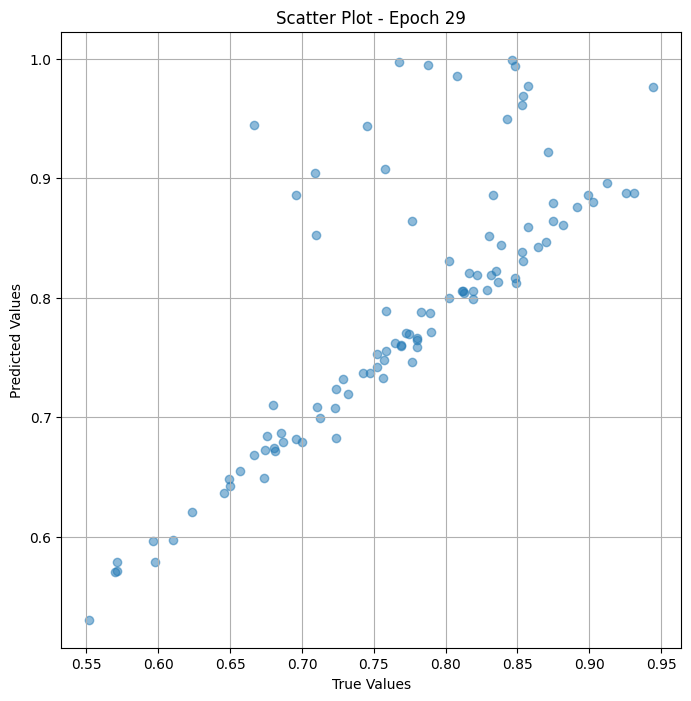


 Epoch: (30/50) Loss = 1.5504551811318379e-06

 Epoch: (30/50) Loss_rmse = 0.001245172694325447

 Epoch: (30/50) R^2 = 0.9998533129692078

 Epoch: (30/50) MAE = 0.0011846274137496948

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

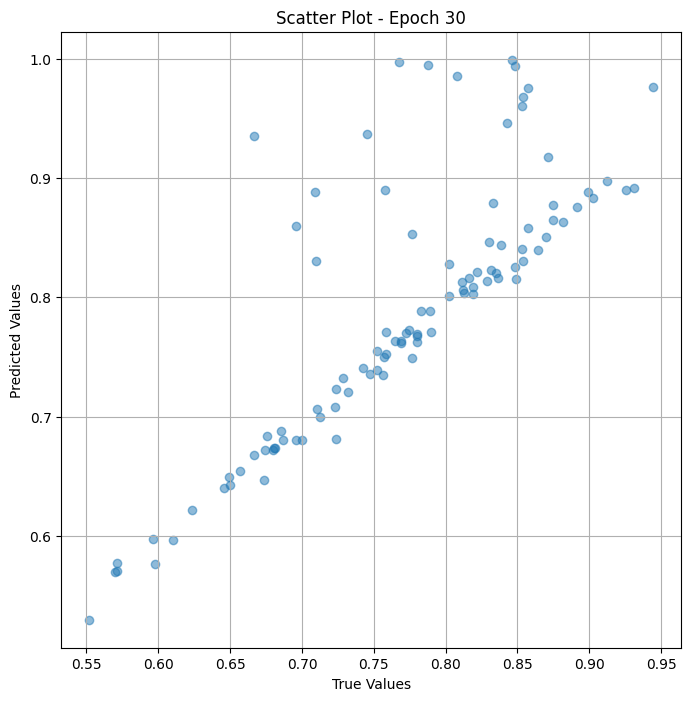


 Epoch: (31/50) Loss = 1.944289579114411e-06

 Epoch: (31/50) Loss_rmse = 0.0013943777885288

 Epoch: (31/50) R^2 = 0.9998160600662231

 Epoch: (31/50) MAE = 0.001145392656326294

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85365

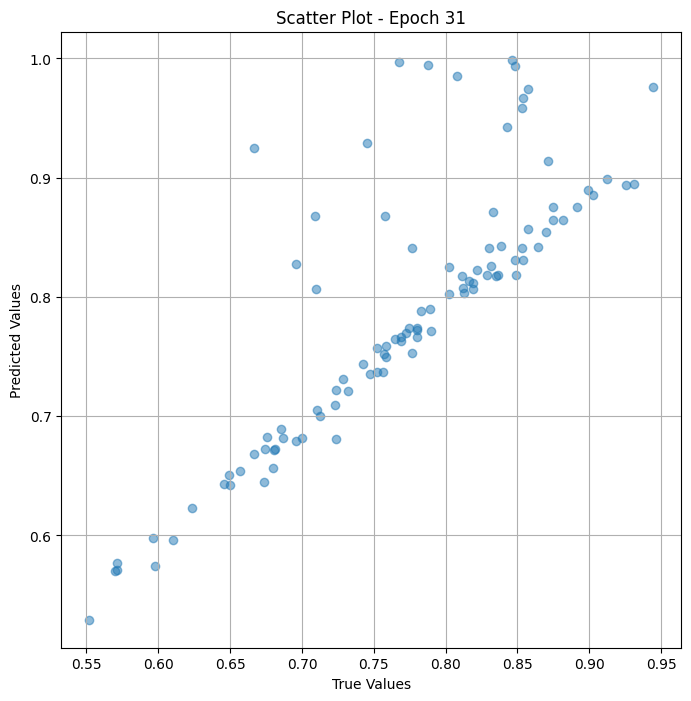


 Epoch: (32/50) Loss = 1.0396228162790067e-06

 Epoch: (32/50) Loss_rmse = 0.0010196189396083355

 Epoch: (32/50) R^2 = 0.9999016523361206

 Epoch: (32/50) MAE = 0.0008476823568344116

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.

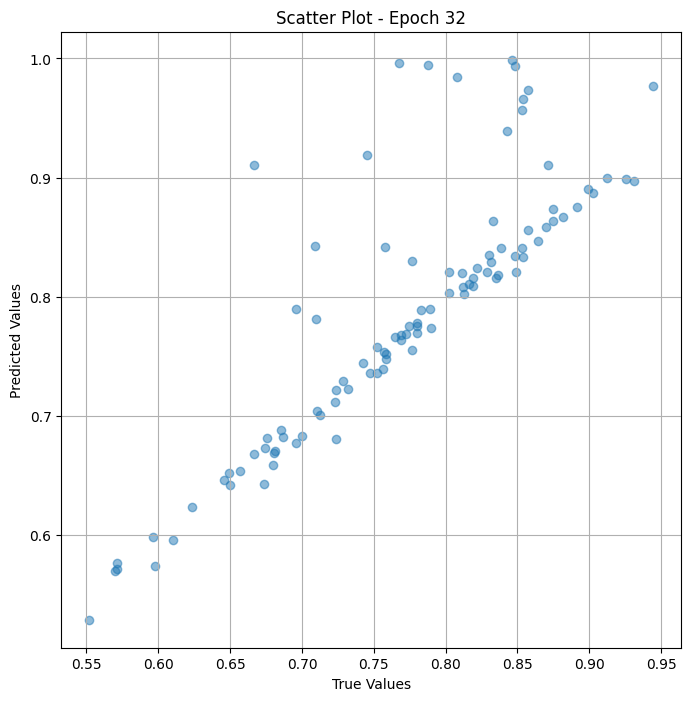


 Epoch: (33/50) Loss = 7.088635811669519e-07

 Epoch: (33/50) Loss_rmse = 0.0008419403457082808

 Epoch: (33/50) R^2 = 0.9999329447746277

 Epoch: (33/50) MAE = 0.0006255358457565308

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

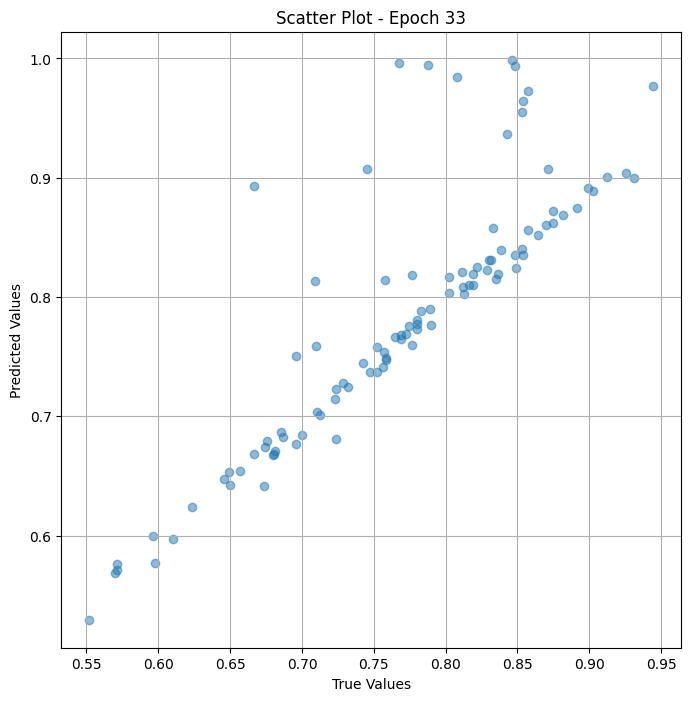


 Epoch: (34/50) Loss = 1.0575839723969693e-06

 Epoch: (34/50) Loss_rmse = 0.0010283889714628458

 Epoch: (34/50) R^2 = 0.9998999238014221

 Epoch: (34/50) MAE = 0.0008727163076400757

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.

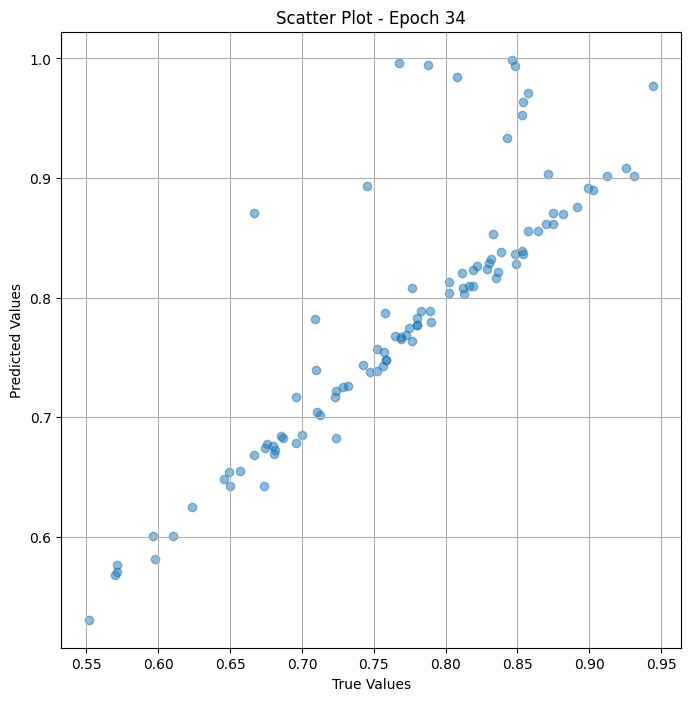


 Epoch: (35/50) Loss = 1.638665935388417e-06

 Epoch: (35/50) Loss_rmse = 0.0012801039265468717

 Epoch: (35/50) R^2 = 0.9998449683189392

 Epoch: (35/50) MAE = 0.0010677427053451538

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

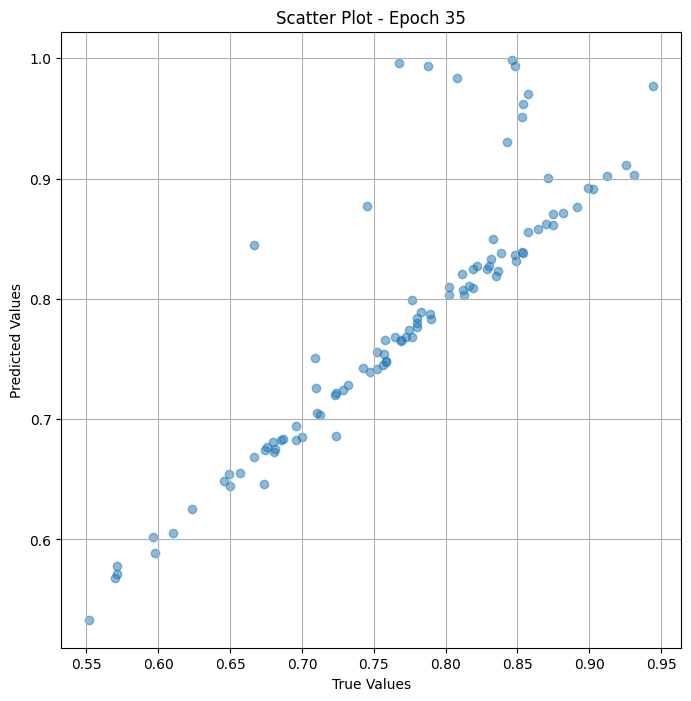


 Epoch: (36/50) Loss = 1.913160303956829e-06

 Epoch: (36/50) Loss_rmse = 0.0013831703690811992

 Epoch: (36/50) R^2 = 0.9998190402984619

 Epoch: (36/50) MAE = 0.001109778881072998

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

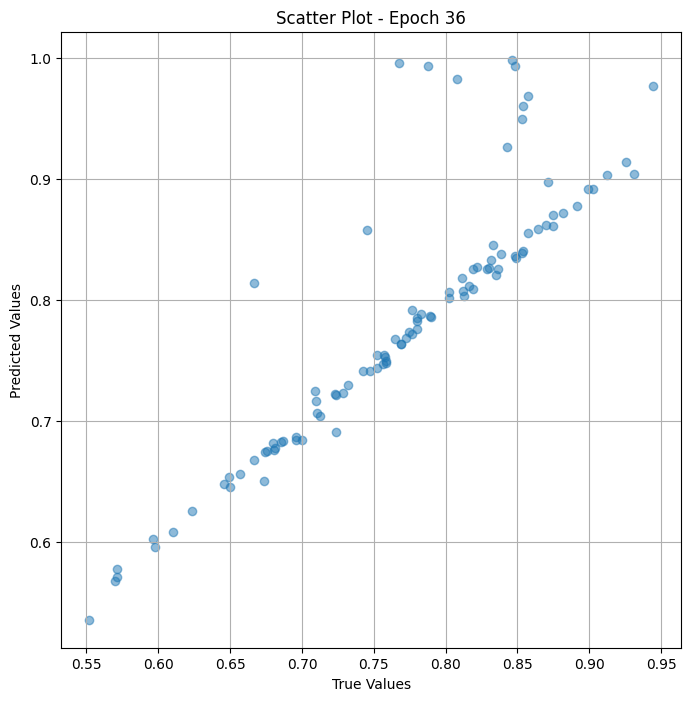


 Epoch: (37/50) Loss = 1.631753661968105e-06

 Epoch: (37/50) Loss_rmse = 0.0012774011120200157

 Epoch: (37/50) R^2 = 0.9998456239700317

 Epoch: (37/50) MAE = 0.0010409653186798096

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

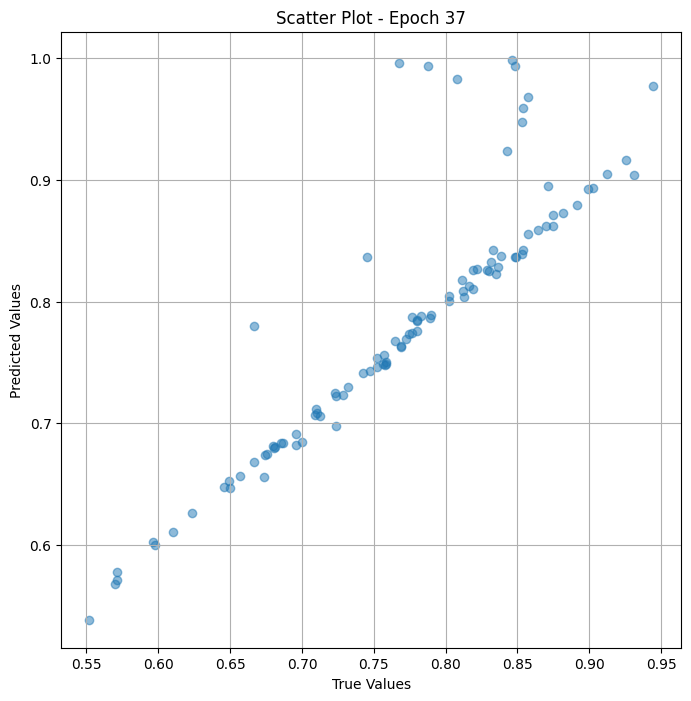


 Epoch: (38/50) Loss = 1.1519342706378666e-06

 Epoch: (38/50) Loss_rmse = 0.001073281979188323

 Epoch: (38/50) R^2 = 0.9998910427093506

 Epoch: (38/50) MAE = 0.0007913112640380859

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

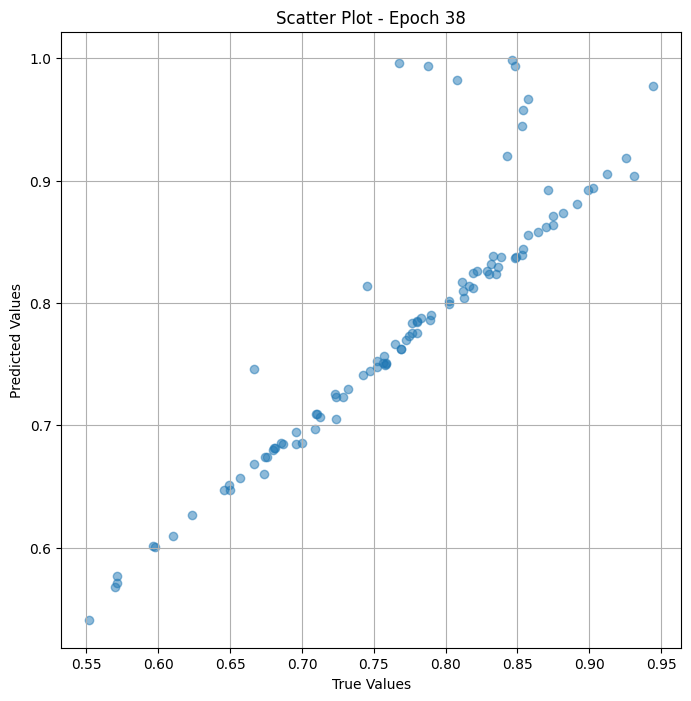


 Epoch: (39/50) Loss = 6.963872465348686e-07

 Epoch: (39/50) Loss_rmse = 0.0008344982052221894

 Epoch: (39/50) R^2 = 0.9999341368675232

 Epoch: (39/50) MAE = 0.0004942715167999268

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

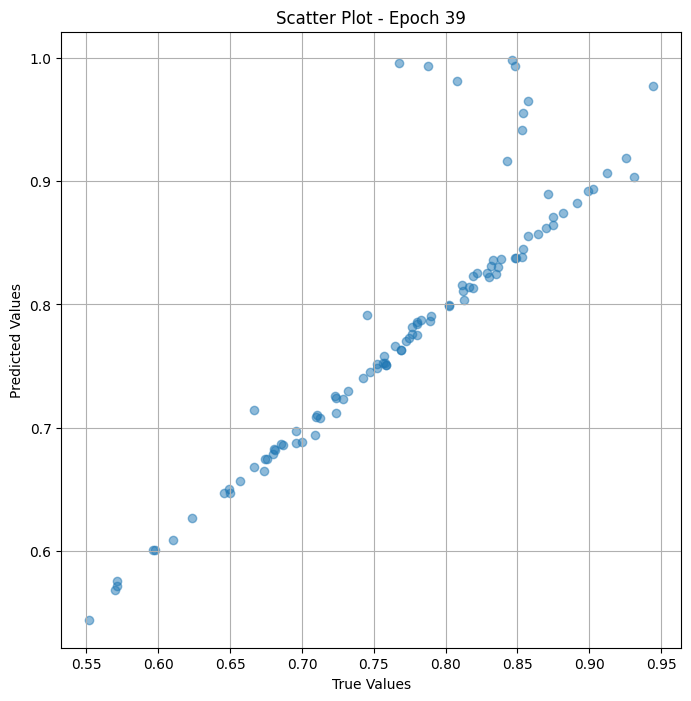


 Epoch: (40/50) Loss = 5.237523623691231e-07

 Epoch: (40/50) Loss_rmse = 0.0007237073732540011

 Epoch: (40/50) R^2 = 0.9999504685401917

 Epoch: (40/50) MAE = 0.000463828444480896

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

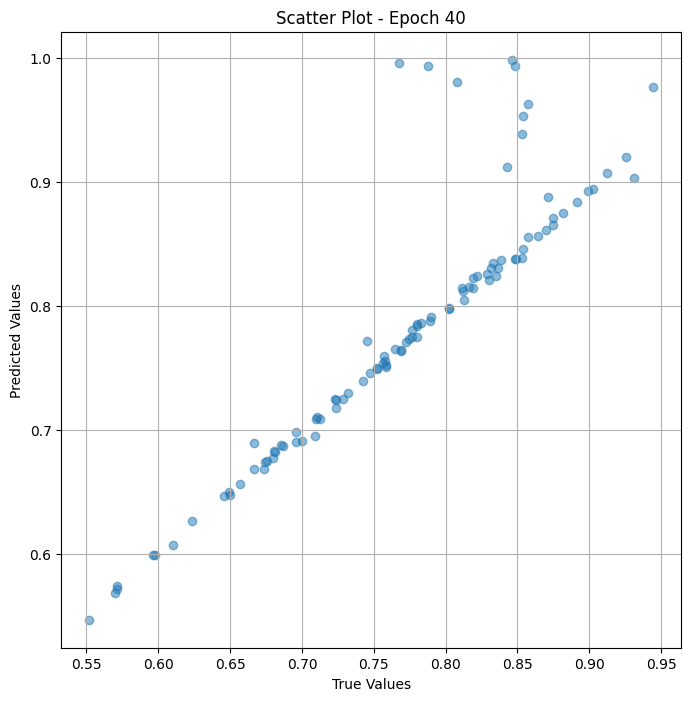


 Epoch: (41/50) Loss = 5.313697215569846e-07

 Epoch: (41/50) Loss_rmse = 0.0007289511268027127

 Epoch: (41/50) R^2 = 0.9999497532844543

 Epoch: (41/50) MAE = 0.0005384683609008789

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

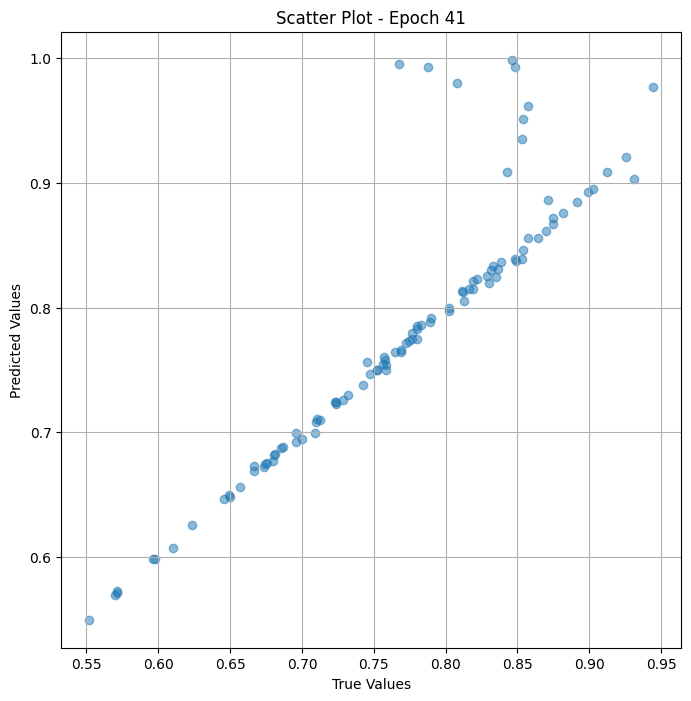


 Epoch: (42/50) Loss = 5.80889491175185e-07

 Epoch: (42/50) Loss_rmse = 0.0007621610420756042

 Epoch: (42/50) R^2 = 0.9999450445175171

 Epoch: (42/50) MAE = 0.0005630999803543091

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

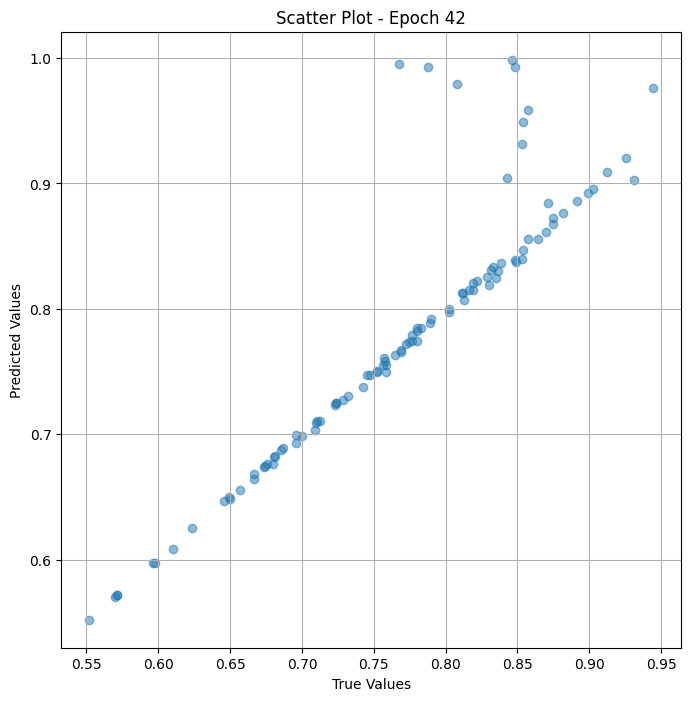


 Epoch: (43/50) Loss = 6.481527066171111e-07

 Epoch: (43/50) Loss_rmse = 0.0008050792966969311

 Epoch: (43/50) R^2 = 0.9999386668205261

 Epoch: (43/50) MAE = 0.0006180405616760254

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

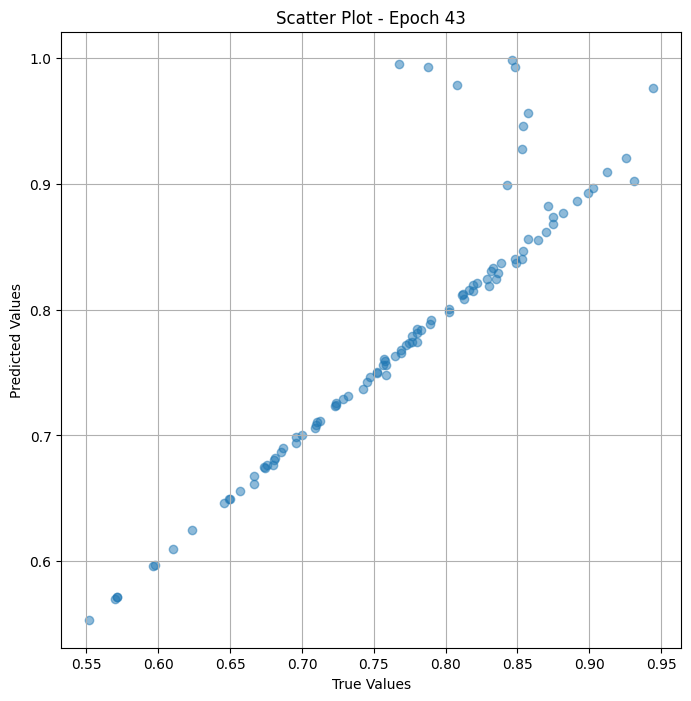


 Epoch: (44/50) Loss = 6.586166705346841e-07

 Epoch: (44/50) Loss_rmse = 0.0008115519885905087

 Epoch: (44/50) R^2 = 0.9999377131462097

 Epoch: (44/50) MAE = 0.0006246119737625122

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

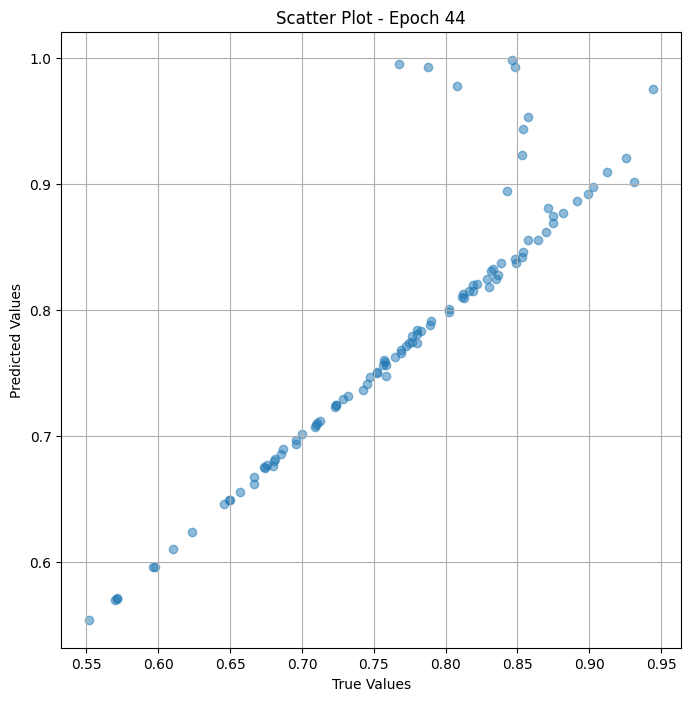


 Epoch: (45/50) Loss = 6.759073585271835e-07

 Epoch: (45/50) Loss_rmse = 0.0008221358293667436

 Epoch: (45/50) R^2 = 0.999936044216156

 Epoch: (45/50) MAE = 0.0006379783153533936

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

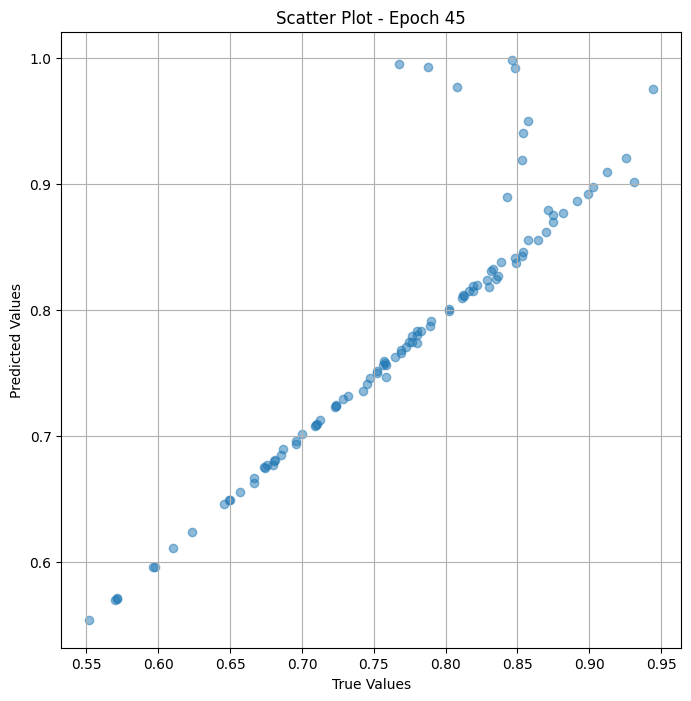


 Epoch: (46/50) Loss = 6.73603096856823e-07

 Epoch: (46/50) Loss_rmse = 0.0008207332575693727

 Epoch: (46/50) R^2 = 0.9999362826347351

 Epoch: (46/50) MAE = 0.0006327629089355469

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

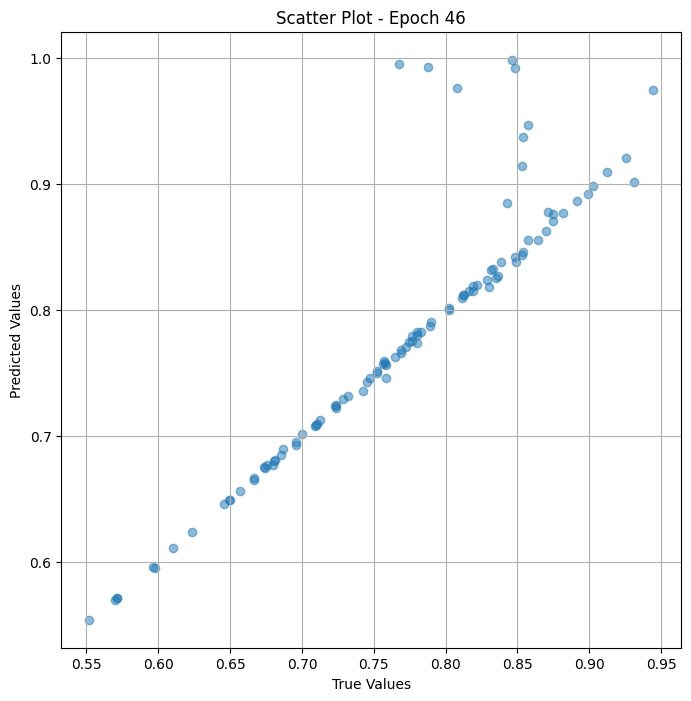


 Epoch: (47/50) Loss = 6.401227210517391e-07

 Epoch: (47/50) Loss_rmse = 0.0008000766974873841

 Epoch: (47/50) R^2 = 0.9999394416809082

 Epoch: (47/50) MAE = 0.0005873888731002808

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

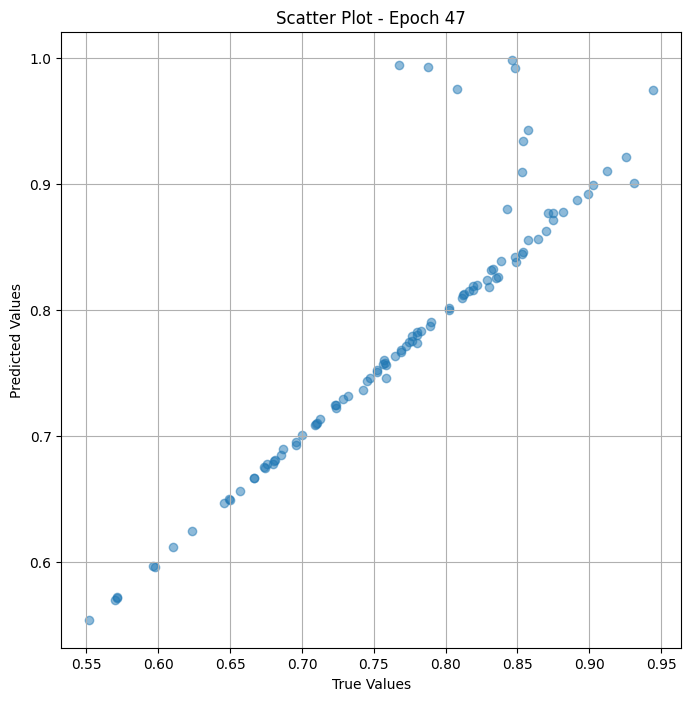


 Epoch: (48/50) Loss = 6.371469112309569e-07

 Epoch: (48/50) Loss_rmse = 0.000798214809037745

 Epoch: (48/50) R^2 = 0.9999397397041321

 Epoch: (48/50) MAE = 0.0005702227354049683

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

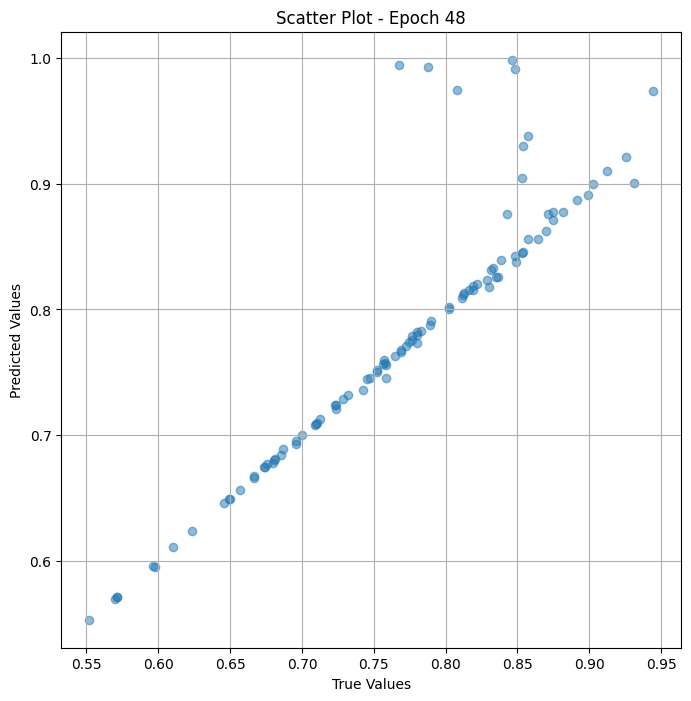


 Epoch: (49/50) Loss = 5.997986249894893e-07

 Epoch: (49/50) Loss_rmse = 0.0007744666654616594

 Epoch: (49/50) R^2 = 0.9999432563781738

 Epoch: (49/50) MAE = 0.000546187162399292

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.85

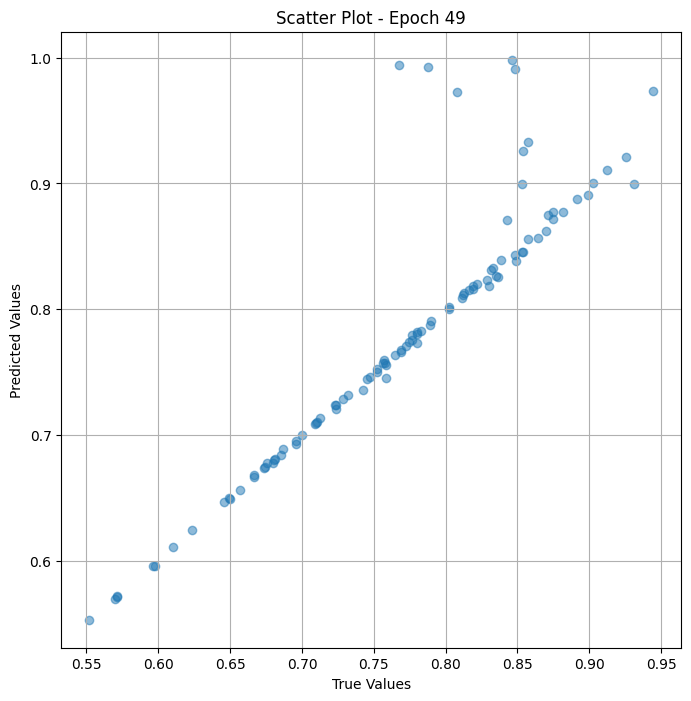


 Epoch: (50/50) Loss = 5.553507094191446e-07

 Epoch: (50/50) Loss_rmse = 0.0007452185382135212

 Epoch: (50/50) R^2 = 0.9999474883079529

 Epoch: (50/50) MAE = 0.0005294233560562134

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256, 0.81632656, 0.8989899, 0.8117647, 0.57, 0.78, 0.72321427, 0.68041235, 0.78899086, 0.8425926, 0.9444444, 0.83870965, 0.8541667, 0.8695652, 0.8484849, 0.62376237, 0.8333333, 0.6494845, 0.9027778, 0.6666667, 0.875, 0.7096774, 0.74757284, 0.7090909, 0.8080808, 0.7234042, 0.78, 0.8118812, 0.6571429, 0.6960784, 0.6853933, 0.776699, 0.6813187, 0.7128713, 0.77272725, 0.9255319, 0.6759259, 0.853211, 0.7830189, 0.7765958, 0.8192771, 0.875, 0.82857144, 0.6962025, 0.7875, 0.7692308, 0.7583333, 0.84821427, 0.61, 0.7570093, 0.75247526, 0.8817204, 0.85714287, 0.74545455, 0.7676768, 0.7282609, 0.75238097, 0.59782606, 0.742268, 0.83516484, 0.65, 0.68, 0.8

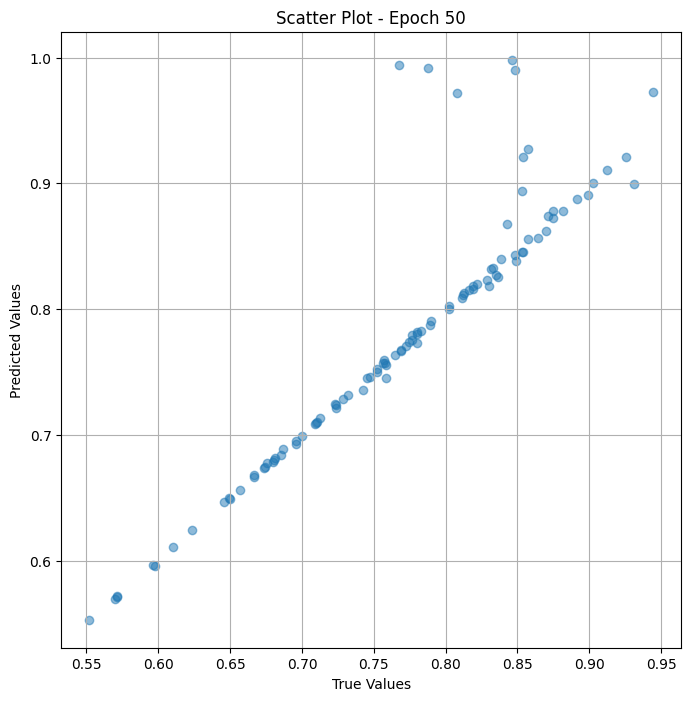

In [ ]:
# Training the model and save weights
fit(50, model_fine_test, train_dl_test)
torch.save(model_fine_test.state_dict(), "model_weights_vr_fine")

In [ ]:
 true_values_list = [0.85294116, 0.87096775, 0.8640777, 0.71028036, 0.68686867, 0.9126214, 0.8023256]

 predicted_values_list= [0.83895135, 0.94183075, 0.88764375, 0.70417595, 0.7093918, 0.87938774, 0.8617963]

import numpy as np
from scipy.stats import spearmanr


spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.8214285714285715 0.023448808345691505
